In [2]:
# Install a pip package in the current Jupyter kernel
import sys
#!{sys.executable} -m pip install mne-connectivity

In [3]:
import os
from glob import glob
import numpy as np
import scipy as sp
import random as rd
import pandas as pd
pd.options.display.float_format = '{:,.2f}'.format

from sklearn import metrics
from sklearn import decomposition, cluster
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

from scipy.spatial.distance import correlation
from IPython.display import display

In [4]:
import mne
#import mne_connectivity

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, annotate_muscle_zscore, 
                               find_eog_events, find_ecg_events, ica_find_ecg_events, find_bad_channels_maxwell)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch, csd_fourier, csd_multitaper, csd_morlet

from mne_connectivity import seed_target_indices, spectral_connectivity_epochs

print(mne.__file__)
print(mne.__version__)

C:\Users\Lenovo\anaconda3\lib\site-packages\mne\__init__.py
0.23.4


In [5]:
import plotly.graph_objects as go
from gtda.time_series import SingleTakensEmbedding, TakensEmbedding, takens_embedding_optimal_parameters
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import BettiCurve, Scaler, Filtering, Amplitude, PersistenceEntropy, NumberOfPoints
from gtda.plotting import plot_point_cloud


In [6]:
# Configure the graphics engine

import matplotlib.pyplot as plt
plt.rc('figure', max_open_warning=100)
%matplotlib notebook
#%matplotlib inline
#%matplotlib qt

In [7]:
import seaborn as sns
# Apply the default theme
sns.set_theme()

In [8]:
print(os.getcwd())

if not os.path.exists('work_data'):
    os.mkdir('work_data')

C:\Users\Lenovo\PycharmProjects\Tibet


# Loading data

Extracting EDF parameters from C:\Users\Lenovo\PycharmProjects\Tibet\work_data\m10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 491999  =      0.000 ...   983.998 secs...
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2', 'ecg']
<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, T3, C3, Cz, C4, T4, T5, P3, Pz, ...
 chs: 20 EEG
 custom_ref_applied: False
 highpass: 0.5 Hz
 lowpass: 70.0 Hz
 meas_date: 2020-03-01 06:31:33 UTC
 nchan: 20
 projs: []
 sfreq: 500.0 Hz
>


<IPython.core.display.Javascript object>


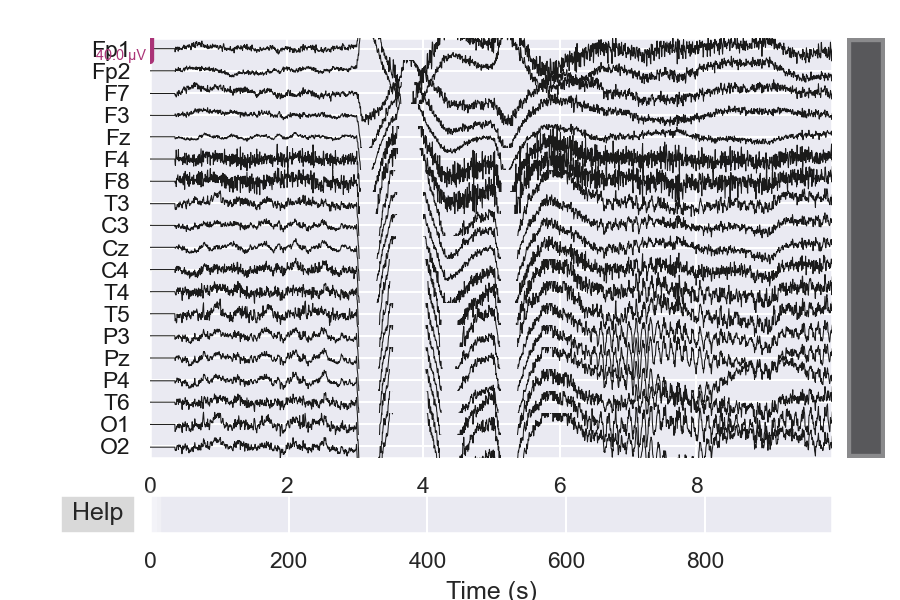

<RawEDF | m10.edf, 19 x 468751 (937.5 s), ~68.0 MB, data loaded>

In [9]:
#Fp_chan=['Fpz', 'Fp1', 'Fp2','Fz']
#C_chan=['Cz', 'C3','C4','C1', 'C2']
#P_chan=['Pz', 'P3', 'P4', 'P8', 'P7', 'P6', 'P5', 'P1', 'P2']
#PO_chan=['POz', 'PO3', 'PO7','PO4', 'PO8'] 
#O_chan= ['Oz', 'O1', 'O2']
#Cz_chan=['CPz','FCz']

ECG_ch =['ecg']

data_raw = mne.io.read_raw_edf(os.path.join('work_data', r"m10.edf"), preload=True)
#annot = mne.read_annotations(os.path.join('work_data', r'm10-annot.csv'))
#data.set_annotations(annot)

print(data_raw.info.ch_names)
print(data_raw.info)

#data_eog = data.copy().pick_channels(EOG_ch)
#data_ecg = data_raw.copy().pick_channels(ECG_ch)

data_raw.drop_channels('ecg').set_montage('standard_1020')
#data.set_channel_types(change_types)

#data.plot(scalings = dict(eeg=100e-6, eog=150e-6), duration=10)
data_raw.plot(duration=10)

data_raw.crop(tmin=7.5, tmax=945) #removing blink artifacts


<IPython.core.display.Javascript object>


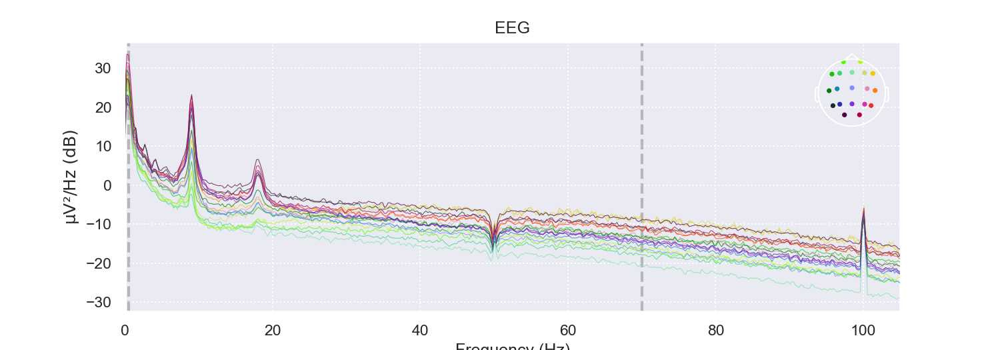

Effective window size : 4.096 (s)



In [10]:
data_raw.plot_psd(fmin=0, fmax=105)
print()

<IPython.core.display.Javascript object>


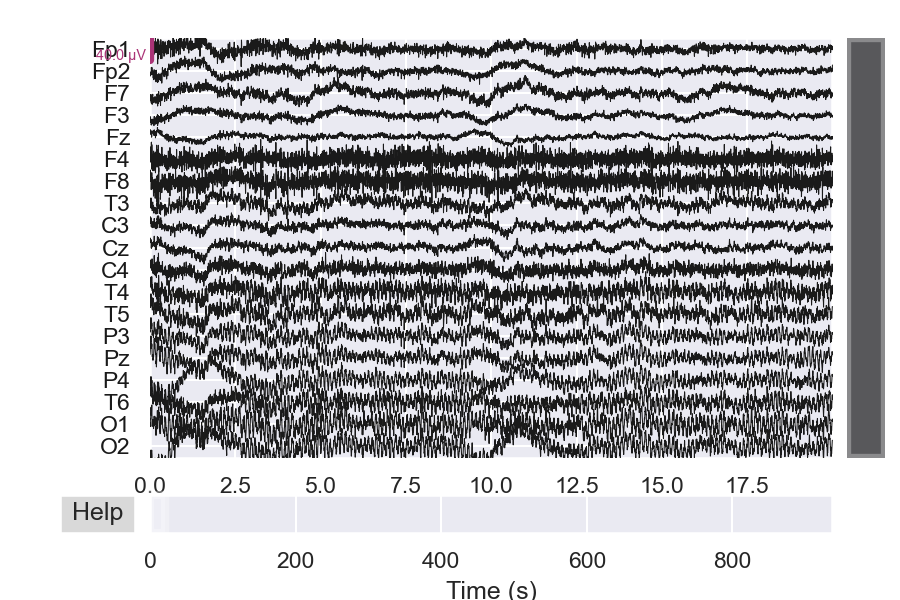

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom EEG reference.


<IPython.core.display.Javascript object>


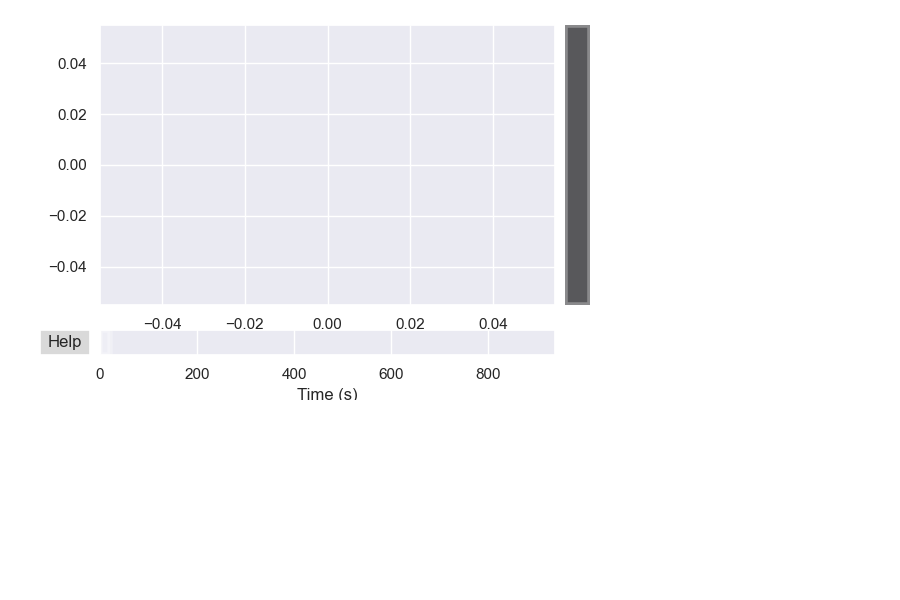

In [11]:
# Re-referencing raw data (common average reference)

fig_orig = data_raw.plot(duration=20)
rr_data_raw, ref_ch = mne.set_eeg_reference(data_raw, ref_channels='average', copy=True, projection=False, ch_type='auto')
fig_reref = rr_data_raw.plot(duration=20)

# Correlation matrix for raw filtered data
#matr_corr_ts_raw = np.corrcoef(data_raw.copy().crop(tmax=20).get_data())
#df_matr_corr_ts_raw = pd.DataFrame(matr_corr_ts_raw, index = data_raw.ch_names, columns = data_raw.ch_names)
#display_corr_matrix(df_matr_corr_ts_raw)
#matr_corr_ts_rr_raw = np.corrcoef(rr_data_raw.copy().crop(tmax=20).get_data())
#df_matr_corr_ts_rr_raw = pd.DataFrame(matr_corr_ts_rr_raw, index = data_raw.ch_names, columns = data_raw.ch_names)
#display_corr_matrix(df_matr_corr_ts_rr_raw)


<IPython.core.display.Javascript object>


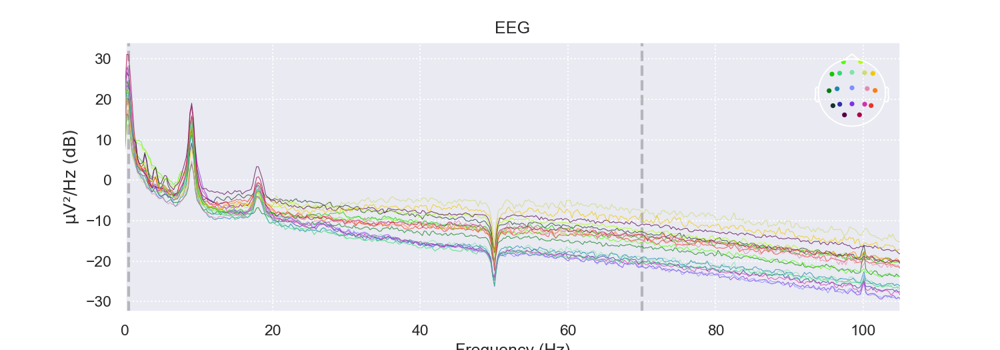

Effective window size : 4.096 (s)



In [12]:
rr_data_raw.plot_psd(fmin=0, fmax=105)
print()

# Preprocessing data

## ICA preparation 

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 13 components
Fitting ICA took 6.7s.
Creating RawArray with float64 data, n_channels=13, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


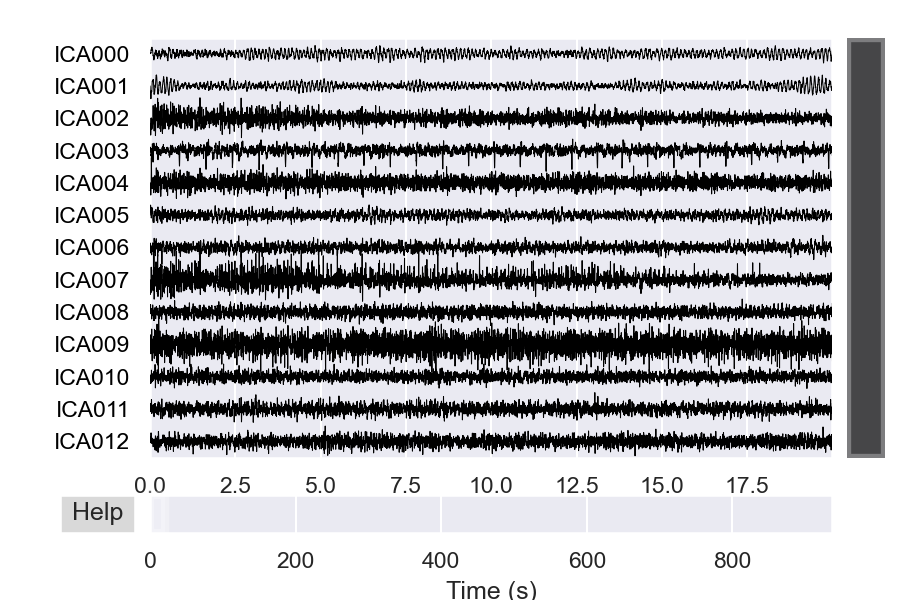

<IPython.core.display.Javascript object>


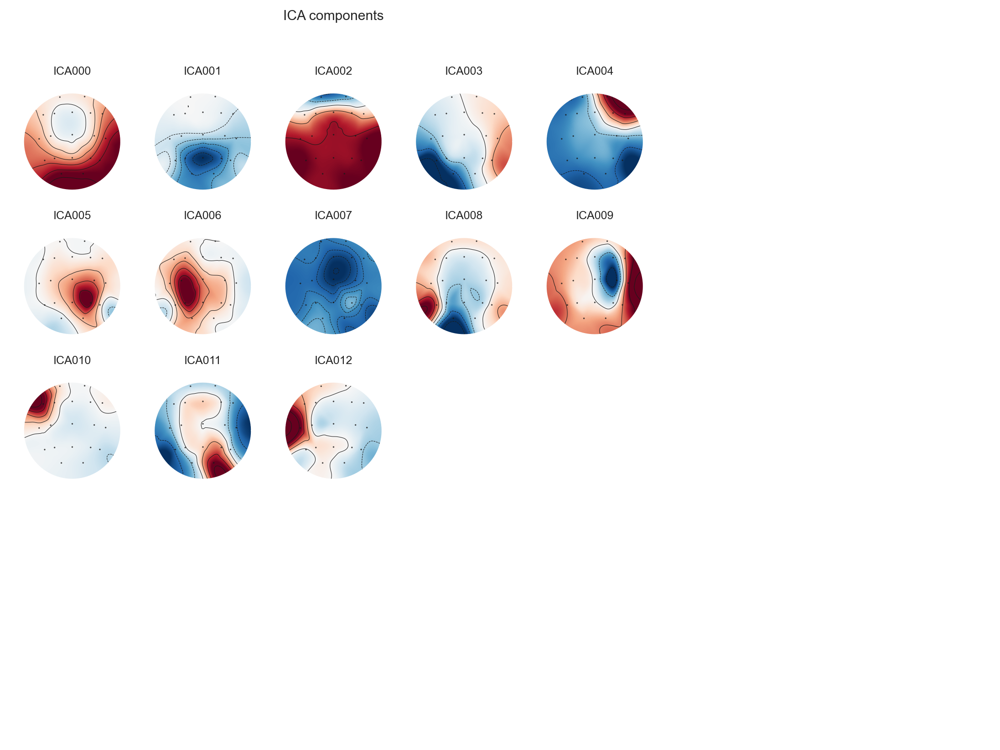

[<MNEFigure size 975x731.5 with 13 Axes>]

In [13]:
data_ica = data_raw.copy()
data_ica.info['bads']=["F4","F8"]
data_ica.interpolate_bads(reset_bads=True)

data_ica.filter(l_freq=4., h_freq=None)

ica = ICA(n_components=.99, max_iter='auto', random_state=97)
ica.fit(data_ica)

ica.plot_sources(data_ica)
ica.plot_components()

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 14 components
Fitting ICA took 7.5s.
Creating RawArray with float64 data, n_channels=14, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


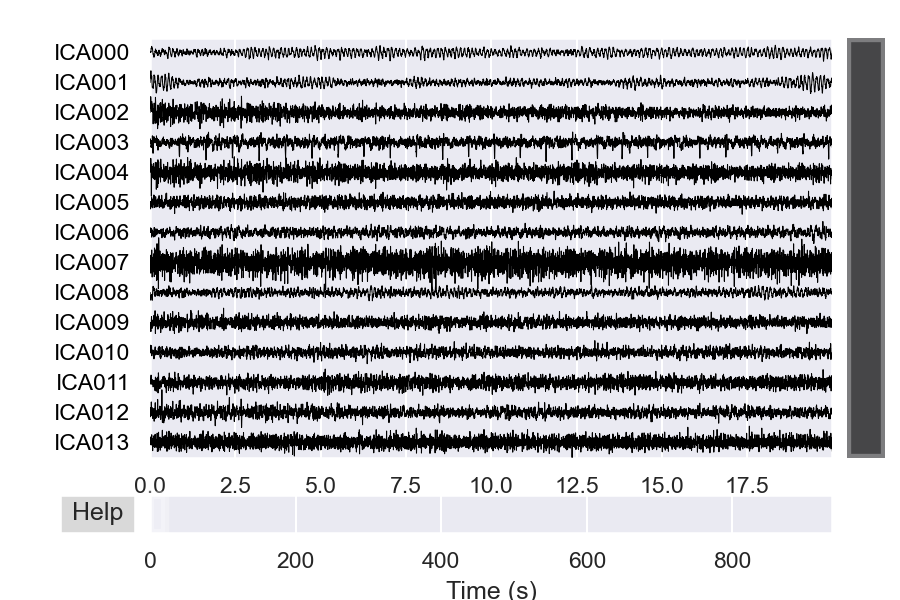

<IPython.core.display.Javascript object>


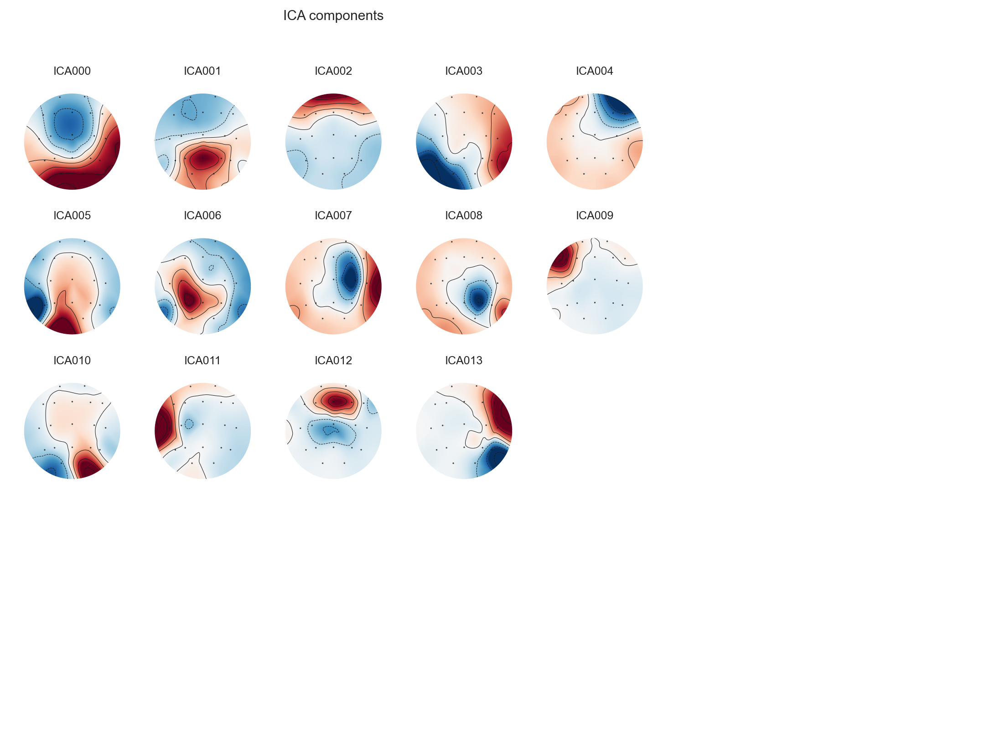

[<MNEFigure size 975x731.5 with 14 Axes>]

In [14]:
rr_data_ica = rr_data_raw.copy()
rr_data_ica.info['bads']=["F4","F8"]
rr_data_ica.interpolate_bads(reset_bads=True)

rr_data_ica.filter(l_freq=4., h_freq=None)

rr_ica = ICA(n_components=.99, max_iter='auto', random_state=97)
rr_ica.fit(rr_data_ica)

rr_ica.plot_sources(rr_data_ica)
rr_ica.plot_components()

Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1232 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1232 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


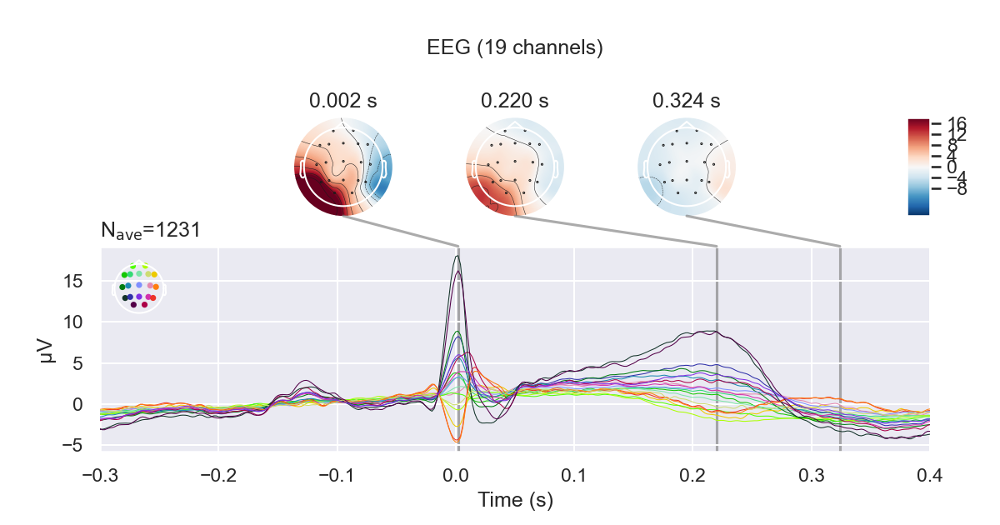

In [15]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
ecg_comps = ica.get_sources(data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

ecg_events = ica_find_ecg_events(data_ica, 
                             ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(ecg_events[:,2])
print(np.unique(ecg_events[:,0]))


evoked_ECG = mne.Epochs(data_raw, ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
evoked_ECG.plot_joint()
print()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1257 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1257 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


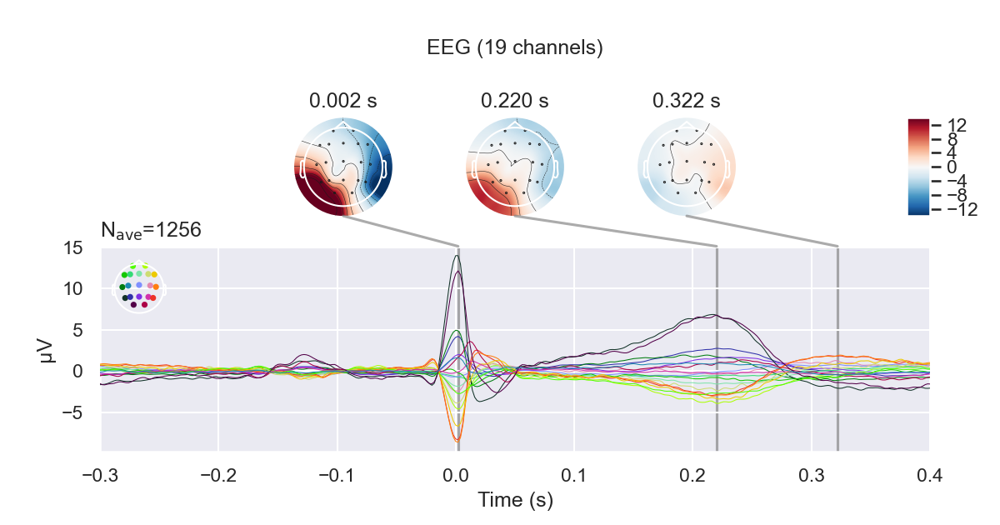

In [16]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
rr_ecg_comps = rr_ica.get_sources(rr_data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

rr_ecg_events = ica_find_ecg_events(rr_data_ica, 
                             rr_ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(rr_ecg_events[:,2])
print(np.unique(rr_ecg_events[:,0]))


rr_evoked_ECG = mne.Epochs(rr_data_raw, rr_ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
rr_evoked_ECG.plot_joint()
print()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Applying ICA to Evoked instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-17-737230a8df71>:1: RuntimeWarning: The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.
  ica.plot_overlay(evoked_ECG, exclude=[3])


<IPython.core.display.Javascript object>


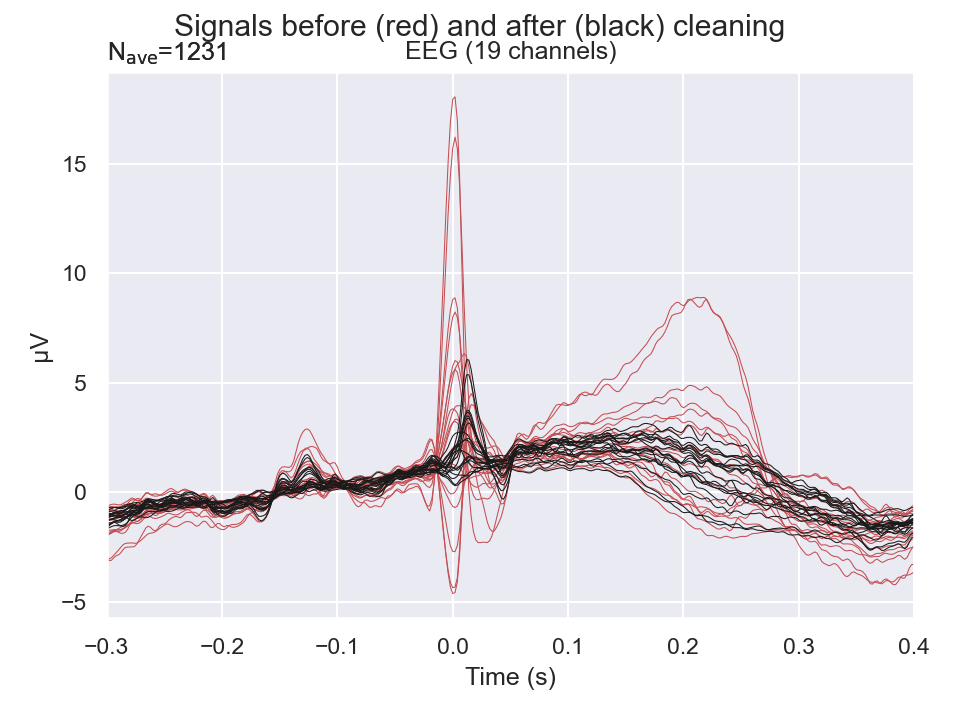

<IPython.core.display.Javascript object>


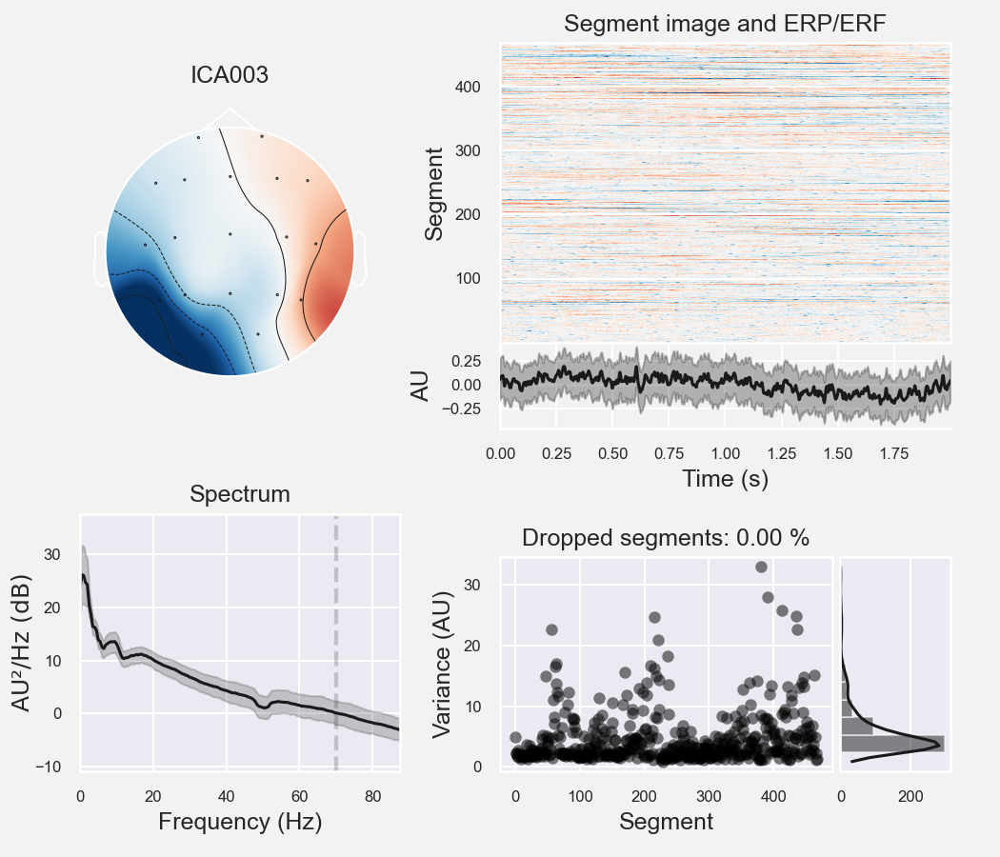

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [17]:
ica.plot_overlay(evoked_ECG, exclude=[3])
ica.plot_properties(data_raw, picks=[3])

Applying ICA to Evoked instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-18-944f4f25e7ca>:1: RuntimeWarning: The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.
  rr_ica.plot_overlay(rr_evoked_ECG, exclude=[3])


<IPython.core.display.Javascript object>


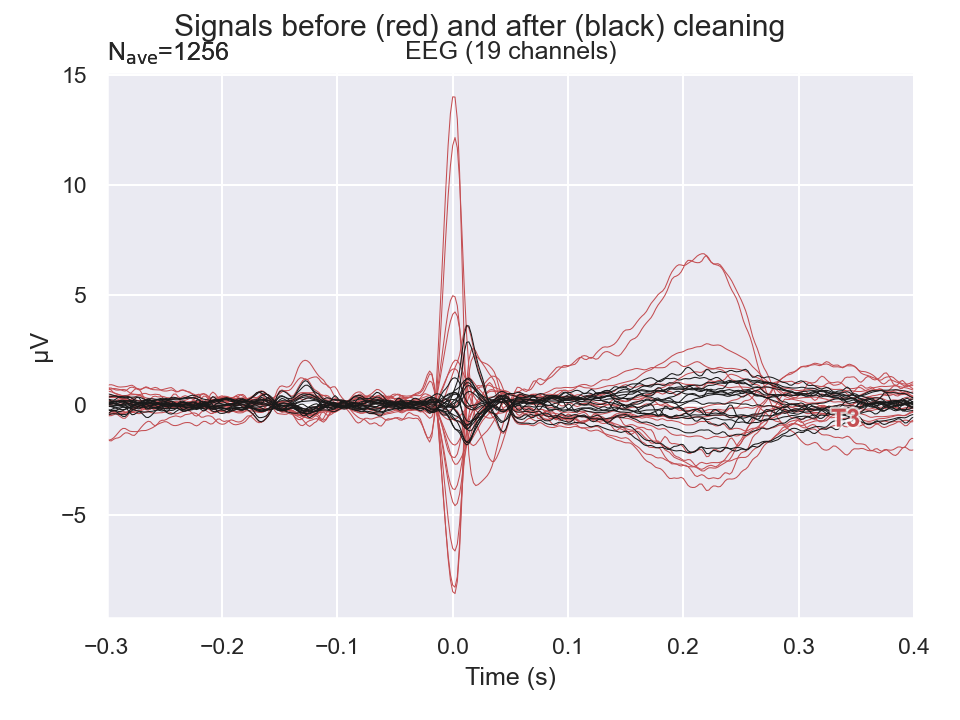

<IPython.core.display.Javascript object>


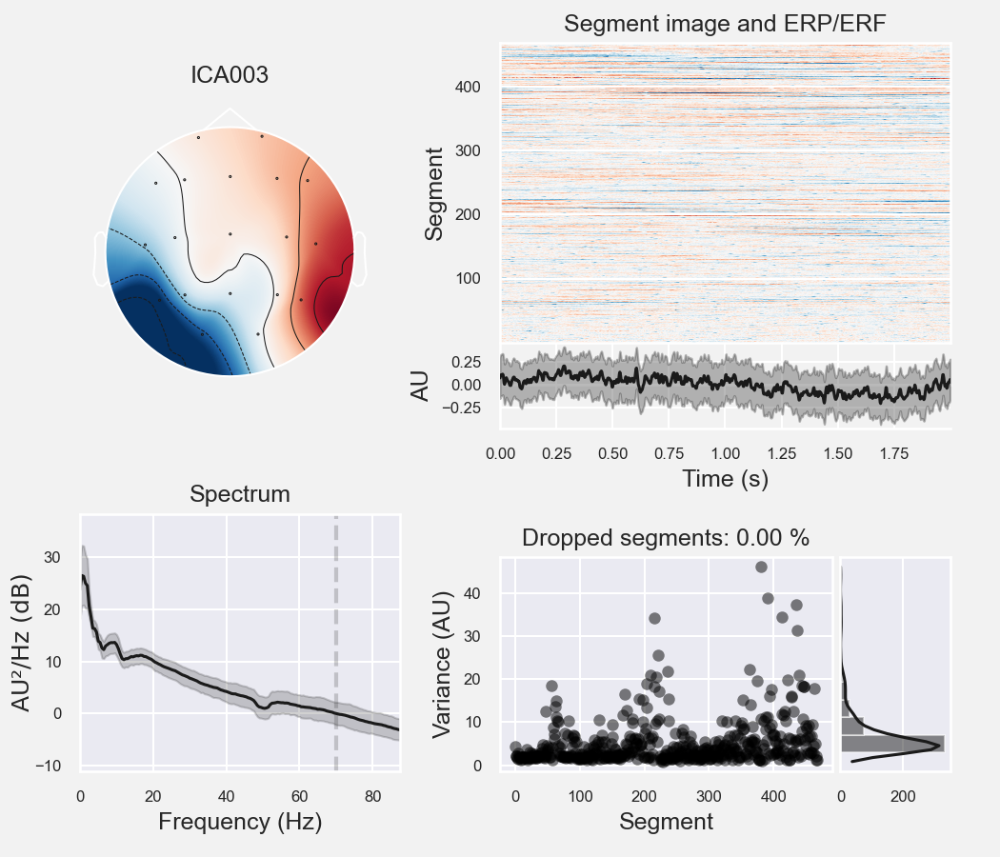

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [18]:
rr_ica.plot_overlay(rr_evoked_ECG, exclude=[3])
rr_ica.plot_properties(rr_data_raw, picks=[3])

Applying ICA to Raw instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


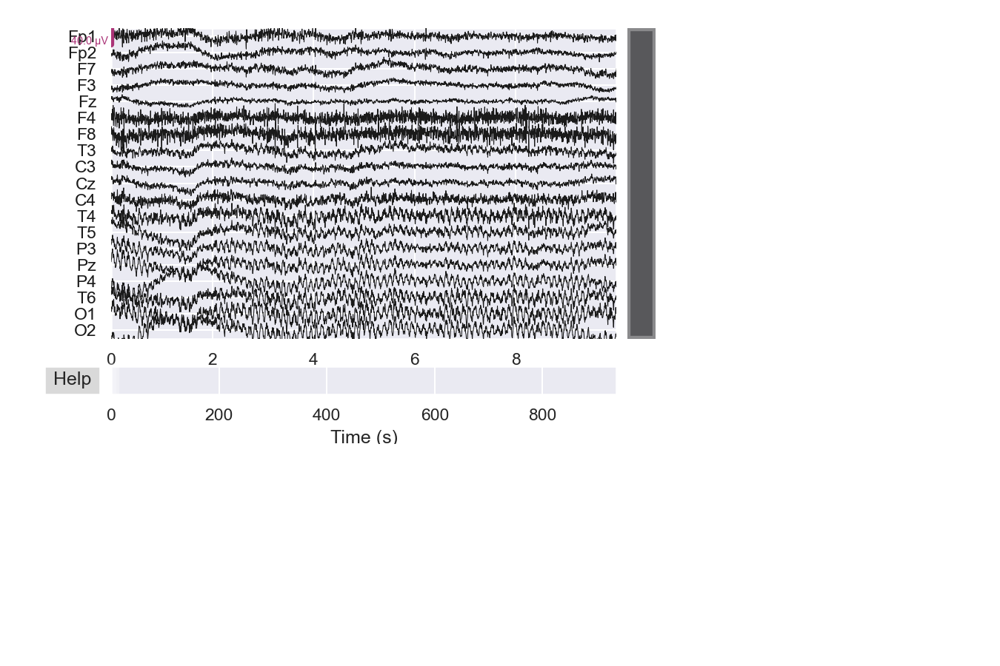

In [23]:
# Exclude ECG channel (original data)

ica.exclude = [3] 
data = data_raw.copy()
ica.apply(data)

#data_notch = data.copy().notch_filter([50,100])
#data_notch.plot_psd(fmin=0, fmax=105)

data.plot()
#data.plot_psd()
print()

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


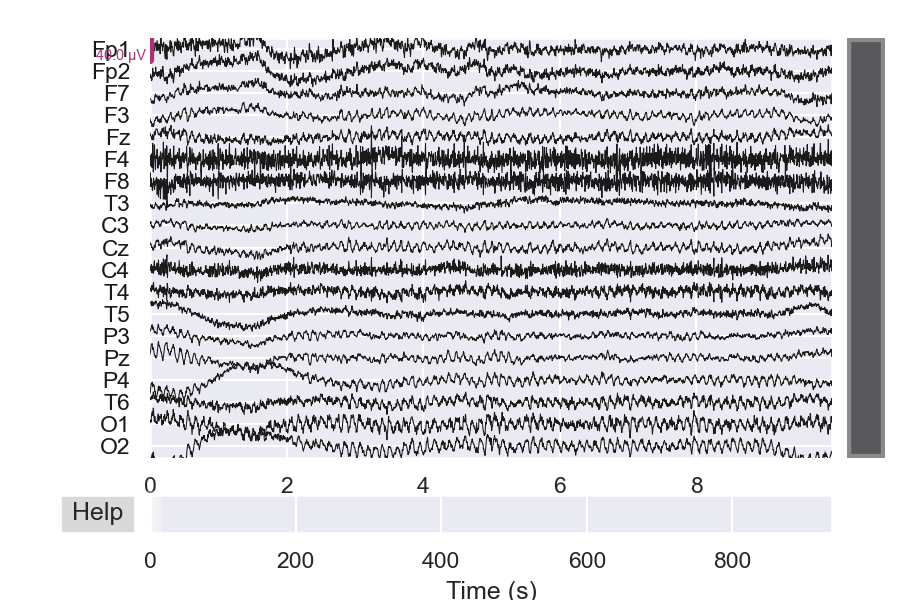

<IPython.core.display.Javascript object>


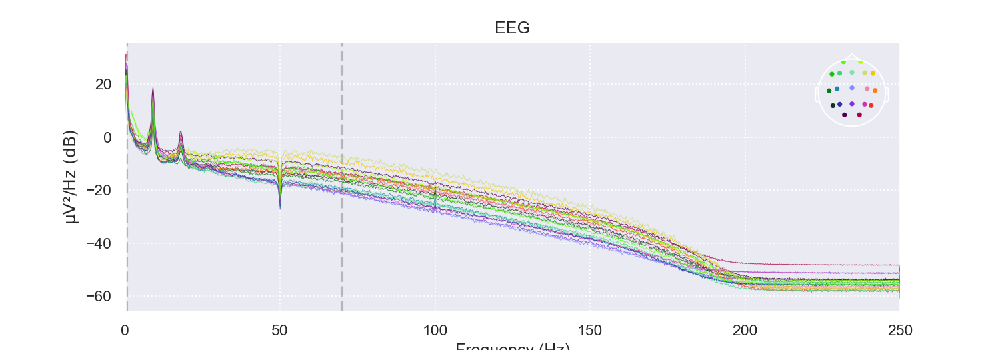

Effective window size : 4.096 (s)



In [20]:
# Exclude ECG channel (re-referenced data)
rr_ica.exclude = [3] 
reref_data = rr_data_raw.copy()
rr_ica.apply(reref_data)

reref_data.plot()
reref_data.plot_psd()

#rr_data_notch = reref_data.copy().notch_filter([50])
#rr_data_notch.plot_psd()#fmin=0, fmax=105)
print()

# Epoching data

In [24]:
# Filtering raw_data
bands = [(0.9, 4, 'Delta (0.9-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'), (8, 14, 'Alpha (8-14 Hz)'), 
         (14, 25, 'Beta (14-25 Hz)'), (25, 40, 'Gamma (25-40 Hz)')]

# Original data
data_filt = data.copy().filter(l_freq=bands[0][0], h_freq=bands[4][1])
data_filt_spectr = []
for i in range(len(bands)):
    data_filt_spectr.append(data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]))

# Re-referenced data
data_rr_filt = reref_data.copy().filter(l_freq=bands[0][0], h_freq=bands[4][1])
data_rr_filt_spectr = []
for i in range(len(bands)):
    data_rr_filt_spectr.append(reref_data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]))

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 1835 samples (3.670 sec)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband e

Not setting metadata
Not setting metadata
1232 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1232 events and 451 original time points ...
1 bad epochs dropped
(1232, 3)
<Epochs |  1227 events (all good), -0.4 - 0.5 sec, baseline off, ~80.2 MB, data loaded,
 '111': 1227>
(1227, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


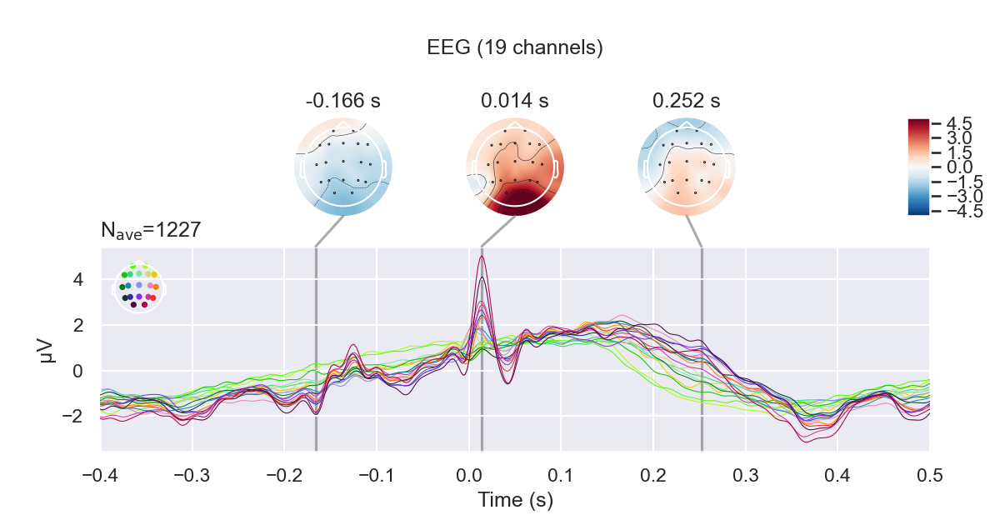

<IPython.core.display.Javascript object>


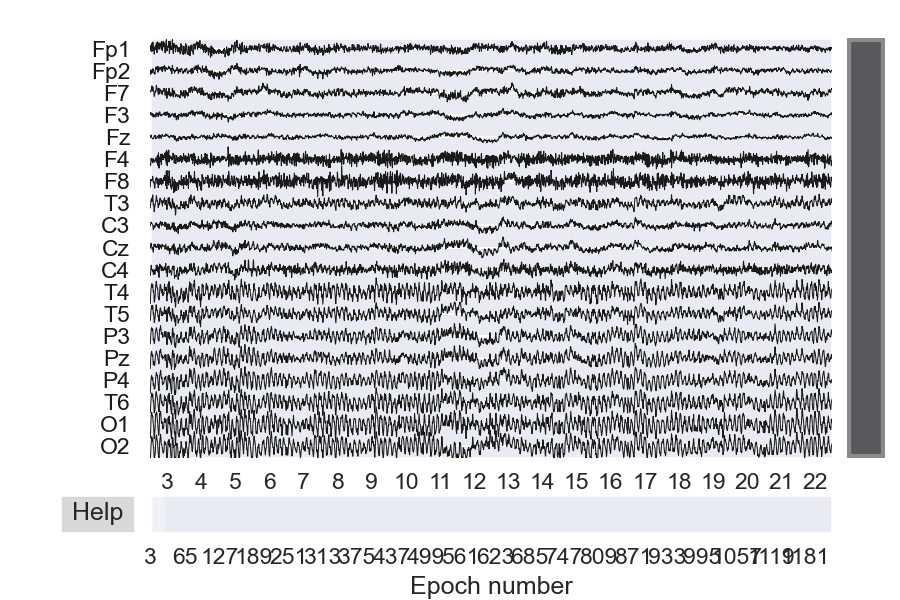

In [25]:
# Epoches, centered by ECG peaks
kwargs = dict(baseline=None, tmin=-0.4, tmax=0.5, preload=True)

epochs_ecg = mne.Epochs(data_filt, ecg_events.astype(int), **kwargs)
epochs_ecg = epochs_ecg[2:-2] # remove first and last 2 epoches due to possible filtering artefacts

print(ecg_events.shape)
print(epochs_ecg)
print(epochs_ecg.get_data().shape)
#print(epochs_ecg.events)

epochs_ecg.average().plot_joint()
epochs_ecg.plot()
print()

Not setting metadata
Not setting metadata
1257 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1257 events and 451 original time points ...
1 bad epochs dropped
(1257, 3)
<Epochs |  1252 events (all good), -0.4 - 0.5 sec, baseline off, ~81.9 MB, data loaded,
 '111': 1252>
(1252, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


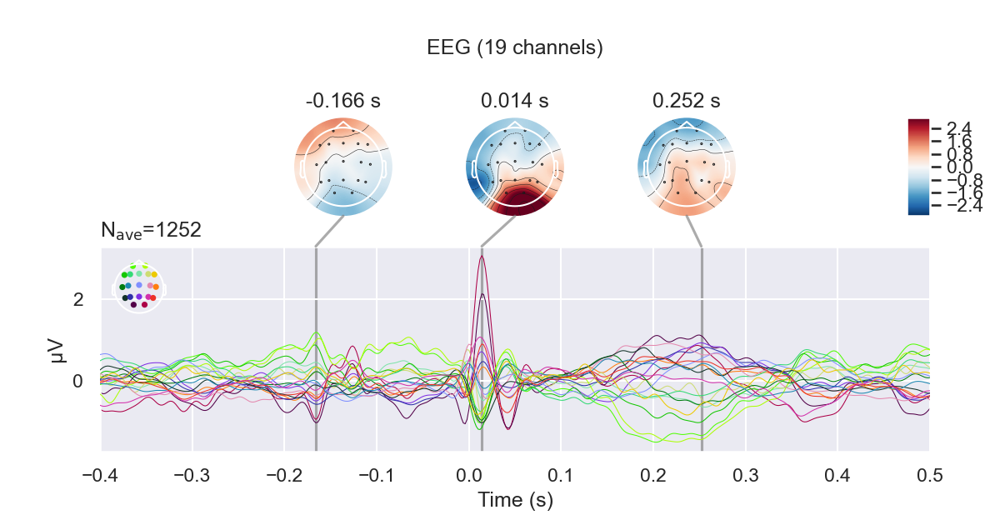

<IPython.core.display.Javascript object>


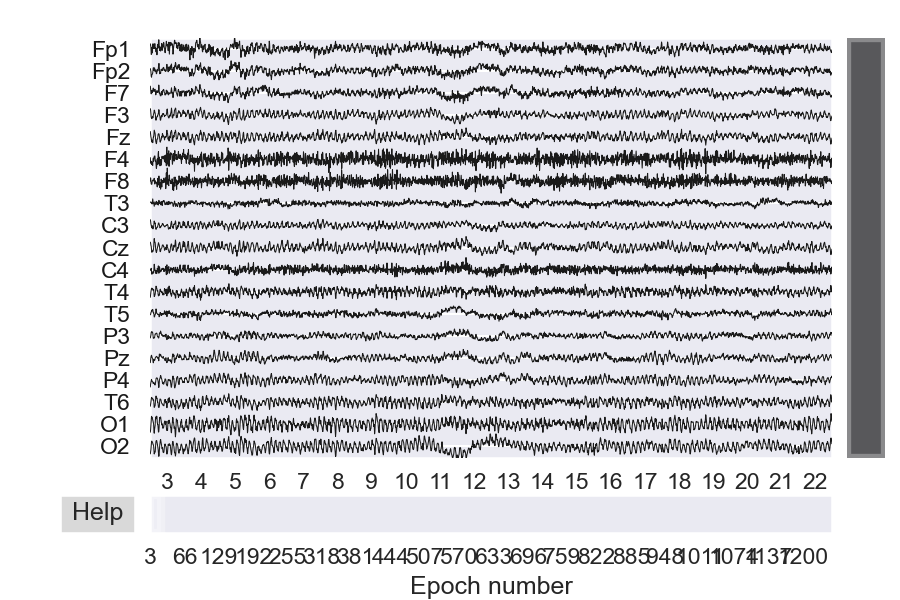

In [26]:
# Epoches, centered by ECG peaks (re-referenced)
kwargs = dict(baseline=None, tmin=-0.4, tmax=0.5, preload=True)

epochs_ecg_rr = mne.Epochs(data_rr_filt, rr_ecg_events.astype(int), **kwargs)
epochs_ecg_rr = epochs_ecg_rr[2:-2] # remove first and last 2 epoches due to possible filtering artefacts

print(rr_ecg_events.shape)
print(epochs_ecg_rr)
print(epochs_ecg_rr.get_data().shape)
#print(epochs_ecg_rr.events)

epochs_ecg_rr.average().plot_joint()
epochs_ecg_rr.plot()
print()

Not setting metadata
Not setting metadata
1874 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1874 events and 251 original time points ...
0 bad epochs dropped
<Epochs |  1866 events (all good), -0.2 - 0.3 sec, baseline off, ~67.9 MB, data loaded,
 '1': 1866>
(1874, 3)
(1866, 19, 251)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


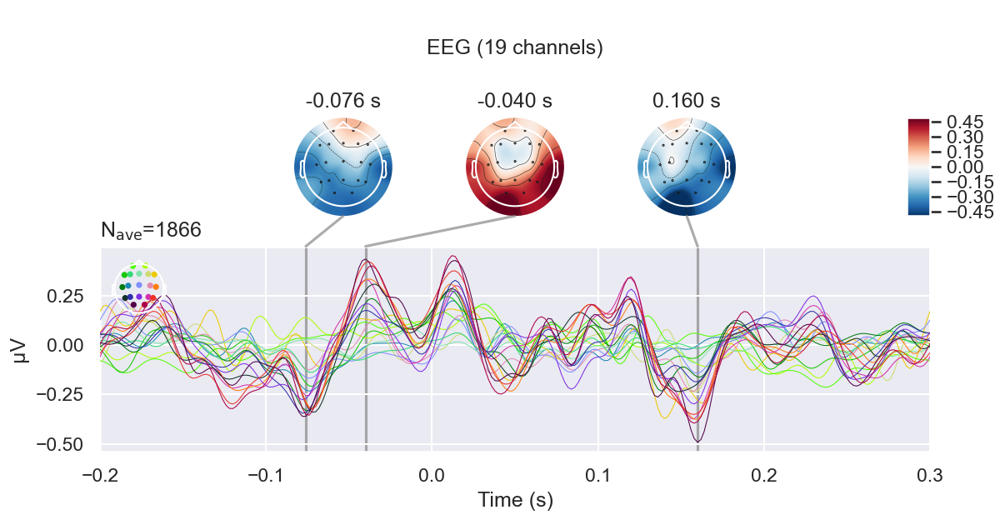

In [27]:
# Epochs by fixed length events, duration 0.5s, no overlap
fix_05s_events = mne.make_fixed_length_events(data_filt, start=0.2, duration=0.5)
kwargs = dict(baseline=None, tmin=-0.2, tmax=0.3, preload=True)

epochs_fix_05s = mne.Epochs(data_filt, fix_05s_events.astype(int), **kwargs)
epochs_fix_05s = epochs_fix_05s[4:-4] #remove first and last 2sec due to possible filtering artefacts

print(epochs_fix_05s)
print(fix_05s_events.shape)
print(epochs_fix_05s.get_data().shape)
epochs_fix_05s.average().plot_joint()
#epochs_fix_05s.plot()
print()

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
(1171, 3)
<Epochs |  1167 events (all good), -0.5 - 0.5 sec, baseline off, ~84.8 MB, data loaded,
 '1': 1167>
(1167, 19, 501)
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not s

<IPython.core.display.Javascript object>


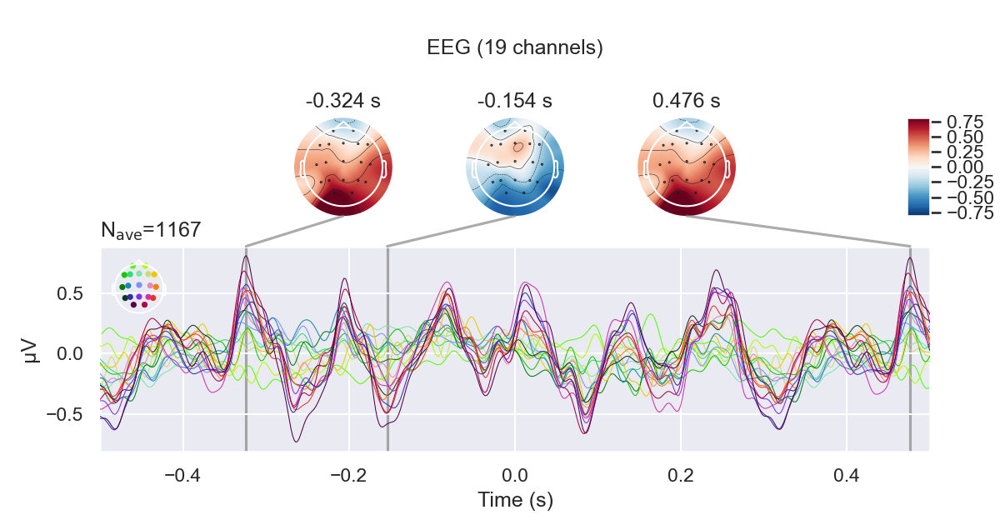

In [31]:
# Epochs by fixed length events, duration 1s, overlap 0.2s
fix_1s_events_ovl = mne.make_fixed_length_events(data_filt, start=0.5, duration=1., overlap=0.2)
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_1s_ovl = mne.Epochs(data_filt, fix_1s_events_ovl.astype(int), **kwargs)
epochs_fix_1s_ovl = epochs_fix_1s_ovl[2:-2] #remove first and last 2sec due to possible filtering artefacts

print(fix_1s_events_ovl.shape)
print(epochs_fix_1s_ovl)
print(epochs_fix_1s_ovl.get_data().shape)
#print(epochs_fix_1s_ovl.events)

epochs_fix_spectr = []
for i in range(len(bands)):   
    epochs_fix_spectr.append(mne.Epochs(data_filt_spectr[i], fix_1s_events_ovl.astype(int), **kwargs))
    epochs_fix_spectr[i] = epochs_fix_spectr[i][2:-2] 

epochs_fix_1s_ovl.average().plot_joint()
#for i in range(len(bands)):
#    print(bands[i][2])
#    epochs_fix_spectr[i].average().plot_joint()
#epochs_fix_1s_ovl.plot()
print()

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
(1171, 3)
<Epochs |  1167 events (all good), -0.5 - 0.5 sec, baseline off, ~84.8 MB, data loaded,
 '1': 1167>
(1167, 19, 501)
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not s

<IPython.core.display.Javascript object>


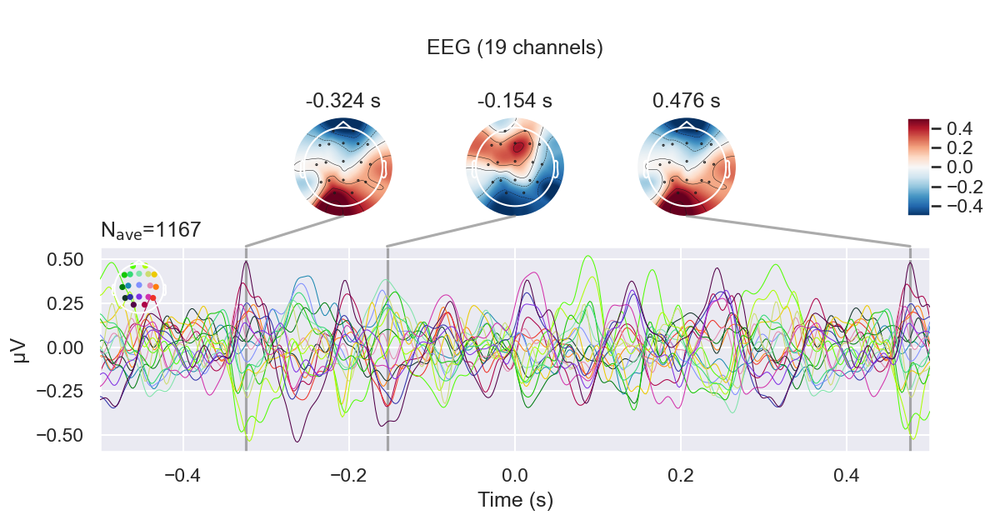

In [32]:
# Epochs by fixed length events, duration 1s, overlap 0.2s
fix_1s_events_rr = mne.make_fixed_length_events(data_rr_filt, start=0.5, duration=1., overlap=0.2)
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_1s_rr = mne.Epochs(data_rr_filt, fix_1s_events_rr.astype(int), **kwargs)
epochs_fix_1s_rr = epochs_fix_1s_rr[2:-2] #remove first and last 2sec due to possible filtering artefacts

print(fix_1s_events_rr.shape)
print(epochs_fix_1s_rr)
print(epochs_fix_1s_rr.get_data().shape)
#print(epochs_fix_1s_rr.events)

epochs_fix_rr_spectr = []
for i in range(len(bands)):   
    epochs_fix_rr_spectr.append(mne.Epochs(data_rr_filt_spectr[i], fix_1s_events_rr.astype(int), **kwargs))
    epochs_fix_rr_spectr[i] = epochs_fix_rr_spectr[i][2:-2] 

epochs_fix_1s_rr.average().plot_joint()
#for i in range(len(bands)):
#    print(bands[i][2])
#    epochs_fix_rr_spectr[i].average().plot_joint()
#epochs_fix_1s_rr.plot()
print()

# Extract features

In [33]:
# Global variables
str_freq = ['D', 'T', 'A', 'B', 'G']
str_freq_rr = ['rD', 'rT', 'rA', 'rB', 'rG']
ch_names = data.ch_names

n_freq = len(str_freq_rr)
n_channels = len(ch_names)
n_samples = epochs_fix_1s_rr.__len__()


In [34]:
def plot_ft_distr_hist(df_features, row_length=None, bins=10):
    n_features = len(df_features.columns)
    if (row_length == None) or (row_length <= 0) or (row_length > n_features): 
        row_length = n_features
    n_rows = n_features // row_length + bool(n_features % row_length)
    kwargs = dict(xlabelsize=7, ylabelsize=7, yrot=90, figsize=(1.5*row_length, 1.2*n_rows), layout=(n_rows, row_length))

    hist = df_features.hist(bins=bins, **kwargs)
    plt.tight_layout()
    
    return hist

In [36]:
# Standard amplitude features (re-referenced data)

df_ft_rr_ampl_stats = pd.DataFrame()

# Full frequency range features
ft_rr_epoches = epochs_fix_1s_rr.get_data()
mean_ampl = StandardScaler().fit_transform(np.mean(ft_rr_epoches, axis=2))
std_ampl = StandardScaler().fit_transform(np.std(ft_rr_epoches, axis=2))
median_ampl = StandardScaler().fit_transform(np.median(ft_rr_epoches, axis=2))
diff_ampl = StandardScaler().fit_transform(np.max(ft_rr_epoches, axis=2) - np.min(ft_rr_epoches, axis=2))

for j in range(n_channels):
    df_ft_rr_ampl_stats['rF'+'_mean_'+ch_names[j]] = mean_ampl[:, j]
    df_ft_rr_ampl_stats['rF'+'_std_'+ch_names[j]] = std_ampl[:, j]
    df_ft_rr_ampl_stats['rF'+'_med_'+ch_names[j]] = median_ampl[:, j]
    df_ft_rr_ampl_stats['rF'+'_diff_'+ch_names[j]] = diff_ampl[:, j]

# Features by spectrum
for i in range(n_freq):
    ft_rr_epoches = epochs_fix_rr_spectr[i].get_data()
    mean_ampl = StandardScaler().fit_transform(np.mean(ft_rr_epoches, axis=2))
    std_ampl = StandardScaler().fit_transform(np.std(ft_rr_epoches, axis=2))
    median_ampl = StandardScaler().fit_transform(np.median(ft_rr_epoches, axis=2))
    diff_ampl = StandardScaler().fit_transform(np.max(ft_rr_epoches, axis=2) - np.min(ft_rr_epoches, axis=2))

    for j in range(n_channels):
        df_ft_rr_ampl_stats[str_freq_rr[i]+'_mean_'+ch_names[j]] = mean_ampl[:, j]
        df_ft_rr_ampl_stats[str_freq_rr[i]+'_std_'+ch_names[j]] = std_ampl[:, j]
        df_ft_rr_ampl_stats[str_freq_rr[i]+'_med_'+ch_names[j]] = median_ampl[:, j]
        df_ft_rr_ampl_stats[str_freq_rr[i]+'_diff_'+ch_names[j]] = diff_ampl[:, j]

print(len(df_ft_rr_ampl_stats.columns))

display(df_ft_rr_ampl_stats.describe())

#hist = plot_ft_distr_hist(df_ft_rr_ampl_stats, row_length=19*4)

456


,rF_mean_Fp1,rF_std_Fp1,rF_med_Fp1,rF_diff_Fp1,rF_mean_Fp2,rF_std_Fp2,rF_med_Fp2,rF_diff_Fp2,rF_mean_F7,rF_std_F7,...,rG_med_T6,rG_diff_T6,rG_mean_O1,rG_std_O1,rG_med_O1,rG_diff_O1,rG_mean_O2,rG_std_O2,rG_med_O2,rG_diff_O2
count,"1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00",...,"1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00","1,167.00"
mean,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,...,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-5.54,-1.87,-4.66,-2.11,-4.61,-1.60,-4.23,-1.83,-5.10,-2.01,...,-3.30,-1.97,-3.39,-2.64,-3.29,-2.16,-2.83,-3.21,-4.08,-2.50
25%,-0.56,-0.66,-0.57,-0.70,-0.60,-0.71,-0.58,-0.76,-0.55,-0.70,...,-0.65,-0.71,-0.65,-0.67,-0.70,-0.73,-0.71,-0.67,-0.62,-0.68
50%,-0.04,-0.22,-0.02,-0.19,-0.00,-0.22,-0.01,-0.15,0.03,-0.18,...,0.01,-0.20,0.01,-0.10,0.01,-0.14,0.01,-0.01,-0.00,-0.11
75%,0.47,0.46,0.46,0.51,0.51,0.48,0.55,0.59,0.52,0.44,...,0.62,0.50,0.64,0.65,0.70,0.56,0.66,0.57,0.66,0.51
max,4.24,8.82,4.10,6.71,4.59,6.48,3.73,5.41,3.62,5.97,...,3.48,5.23,3.42,4.09,2.94,5.14,3.27,6.40,3.31,5.20


In [387]:
main_columns = [col for col in df_ft_rr_ampl_stats.columns if ('mean' in col) or ('std' in col)]
#print(main_columns)
display_corr_matrix(df_ft_rr_ampl_stats[main_columns].corr())

In [395]:
main_columns = [col for col in df_ft_rr_psd_raw.columns if ('All' in col)]
#print(main_columns)
display_corr_matrix(df_ft_rr_psd_raw[main_columns].corr())

,rD_All,rT_All,rA_All,rB_All,rG_All
rD_All,1.00,0.16,0.05,-0.01,-0.14
rT_All,0.16,1.00,0.94,0.63,0.14
rA_All,0.05,0.94,1.00,0.66,0.18
rB_All,-0.01,0.63,0.66,1.00,0.56
rG_All,-0.14,0.14,0.18,0.56,1.00


In [247]:
# Calculating PSD for original epochs (Welch)

kwargs = dict(fmin=bands[0][0], fmax=bands[4][1], n_jobs=1)
psd_w, freq_w = psd_welch(epochs_fix_1s_ovl, **kwargs)

freq_masks = [(fmin < freq_w) & (freq_w < fmax) for (fmin, fmax, _) in bands]
print(freq_w)
print(psd_w.shape)

ft_psd_w_spectr_raw = np.array([np.mean(psd_w[:,:, _freq_mask], axis=2) for _freq_mask in freq_masks]).transpose(1,2,0)
ft_psd_w_spectr_db = 10 * np.log10(ft_psd_w_spectr_raw) # Convert psd to dB format
print(ft_psd_w_spectr_db.shape)

Effective window size : 0.512 (s)
[ 1.953125  3.90625   5.859375  7.8125    9.765625 11.71875  13.671875
 15.625    17.578125 19.53125  21.484375 23.4375   25.390625 27.34375
 29.296875 31.25     33.203125 35.15625  37.109375 39.0625  ]
(1167, 19, 20)
(1167, 19, 5)


In [76]:
# Extract PSD features

kwargs = dict(fmin=bands[0][0], fmax=bands[4][1], bandwidth=None, adaptive=True, n_jobs=1)

# Calculating PSD for original epochs (Multitaper)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_fix_1s_ovl, **kwargs)
freq_masks = [(fmin <= freq_mtaper) & (freq_mtaper < fmax) for (fmin, fmax, _) in bands]
print(freq_mtaper)
print(psd_mtaper.shape)

ft_psd_spectr_raw = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2) for _freq_mask in freq_masks]).transpose(1,2,0)
ft_psd_sp_all_raw = np.mean(ft_psd_spectr_raw, axis=1)

ft_psd_spectr_db = 10 * np.log10(ft_psd_spectr_raw) # Convert psd to dB format
ft_psd_sp_all_db = 10 * np.log10(ft_psd_sp_all_raw) # Convert psd to dB format

df_ft_psd_raw = pd.DataFrame()
df_ft_psd_db = pd.DataFrame()
for i in range(n_freq):
    df_ft_psd_raw[str_freq[i]+'_All'] = ft_psd_sp_all_raw[:,i]
    df_ft_psd_db[str_freq[i]+'_All'] = ft_psd_sp_all_db[:,i]
    for j in range(n_channels):
        df_ft_psd_raw[str_freq[i]+'_'+ ch_names[j]] = ft_psd_spectr_raw[:,j,i]
        df_ft_psd_db[str_freq[i]+'_'+ ch_names[j]] = ft_psd_spectr_db[:,j,i]
#print(df_ft_psd_db.columns)

# Scaling raw data
ft_psd_raw_sc = StandardScaler().fit_transform(df_ft_psd_raw.to_numpy())
df_ft_psd_raw_sc = pd.DataFrame(ft_psd_raw_sc, columns=df_ft_psd_raw.columns)

# Calculating PSD for re-referenced epochs (Multitaper)
rr_psd_mtaper, rr_freq_mtaper = psd_multitaper(epochs_fix_1s_rr, **kwargs)
freq_masks = [(fmin < rr_freq_mtaper) & (rr_freq_mtaper < fmax) for (fmin, fmax, _) in bands]
#print(rr_freq_mtaper)
print(rr_psd_mtaper.shape)

ft_rr_psd_spectr_raw = np.array([np.mean(rr_psd_mtaper[:,:, _freq_mask], axis=2) for _freq_mask in freq_masks]).transpose(1,2,0)
ft_rr_psd_sp_all_raw = np.mean(ft_rr_psd_spectr_raw, axis=1)

ft_rr_psd_spectr_db = 10 * np.log10(ft_rr_psd_spectr_raw) # Convert psd to dB format
ft_rr_psd_sp_all_db = 10 * np.log10(ft_rr_psd_sp_all_raw) # Convert psd to dB format

df_ft_rr_psd_raw = pd.DataFrame()
df_ft_rr_psd_db = pd.DataFrame()
for i in range(n_freq):
    df_ft_rr_psd_raw[str_freq_rr[i]+'_All'] = ft_rr_psd_sp_all_raw[:,i]
    df_ft_rr_psd_db[str_freq_rr[i]+'_All'] = ft_rr_psd_sp_all_db[:,i]
    for j in range(n_channels):
        df_ft_rr_psd_raw[str_freq_rr[i]+'_'+ ch_names[j]] = ft_rr_psd_spectr_raw[:,j,i]
        df_ft_rr_psd_db[str_freq_rr[i]+'_'+ ch_names[j]] = ft_rr_psd_spectr_db[:,j,i]
#print(df_ft_rr_psd_db.columns)

# Scaling raw re-referenced data
ft_rr_psd_raw_sc = StandardScaler().fit_transform(df_ft_rr_psd_raw.to_numpy())
df_ft_rr_psd_raw_sc = pd.DataFrame(ft_rr_psd_raw_sc, columns=df_ft_rr_psd_raw.columns)


    Using multitaper spectrum estimation with 7 DPSS windows
[ 0.99800399  1.99600798  2.99401198  3.99201597  4.99001996  5.98802395
  6.98602794  7.98403194  8.98203593  9.98003992 10.97804391 11.9760479
 12.9740519  13.97205589 14.97005988 15.96806387 16.96606786 17.96407186
 18.96207585 19.96007984 20.95808383 21.95608782 22.95409182 23.95209581
 24.9500998  25.94810379 26.94610778 27.94411178 28.94211577 29.94011976
 30.93812375 31.93612774 32.93413174 33.93213573 34.93013972 35.92814371
 36.9261477  37.9241517  38.92215569 39.92015968]
(1167, 19, 40)
    Using multitaper spectrum estimation with 7 DPSS windows
(1167, 19, 40)


<IPython.core.display.Javascript object>


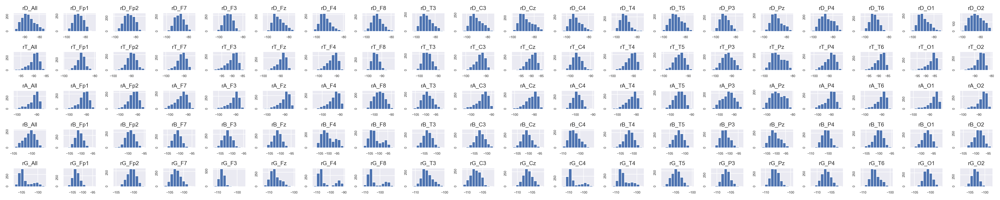

In [337]:
# PSD distribution

#hist = plot_ft_distr_hist(df_ft_psd_raw_sc, row_length=20)
#hist = plot_ft_distr_hist(df_ft_psd_db, row_length=20)
#hist = plot_ft_distr_hist(df_ft_rr_psd_raw_sc, row_length=20)
hist = plot_ft_distr_hist(df_ft_rr_psd_db, row_length=20)

In [77]:
# Relative PSD features

ft_rr_psd_spectr_rel = np.empty((n_samples, n_channels, n_freq))
ft_rr_psd_sp_all_rel = np.empty((n_samples, n_freq))
df_ft_rr_psd_rel = pd.DataFrame()
for i in range(n_freq):
    ft_rr_psd_spectr_rel[:,:,i] = ft_rr_psd_spectr_raw[:,:,i] / np.sum(ft_rr_psd_spectr_raw, axis=2)
    ft_rr_psd_sp_all_rel[:,i] = ft_rr_psd_sp_all_raw[:,i] / np.sum(ft_rr_psd_sp_all_raw, axis=1)

    df_ft_rr_psd_rel[str_freq_rr[i]+'_rel_All'] = ft_rr_psd_sp_all_rel[:,i]
    for j in range(n_channels):
        df_ft_rr_psd_rel[str_freq_rr[i]+'_rel_'+ ch_names[j]] = ft_rr_psd_spectr_rel[:,j,i]
    
#hist = plot_ft_distr_hist(df_ft_rr_psd_rel, row_length=20)

In [78]:
# Scaling
ft_rr_psd_rel_sc = StandardScaler().fit_transform(df_ft_rr_psd_rel.to_numpy())
df_ft_rr_psd_rel_sc = pd.DataFrame(ft_rr_psd_rel_sc, columns=df_ft_rr_psd_rel.columns)

display_corr_matrix(df_ft_rr_psd_db.corr())

,rD_All,rD_Fp1,rD_Fp2,rD_F7,rD_F3,rD_Fz,rD_F4,rD_F8,rD_T3,rD_C3,rD_Cz,rD_C4,rD_T4,rD_T5,rD_P3,rD_Pz,rD_P4,rD_T6,rD_O1,rD_O2,rT_All,rT_Fp1,rT_Fp2,rT_F7,rT_F3,rT_Fz,rT_F4,rT_F8,rT_T3,rT_C3,rT_Cz,rT_C4,rT_T4,rT_T5,rT_P3,rT_Pz,rT_P4,rT_T6,rT_O1,rT_O2,rA_All,rA_Fp1,rA_Fp2,rA_F7,rA_F3,rA_Fz,rA_F4,rA_F8,rA_T3,rA_C3,rA_Cz,rA_C4,rA_T4,rA_T5,rA_P3,rA_Pz,rA_P4,rA_T6,rA_O1,rA_O2,rB_All,rB_Fp1,rB_Fp2,rB_F7,rB_F3,rB_Fz,rB_F4,rB_F8,rB_T3,rB_C3,rB_Cz,rB_C4,rB_T4,rB_T5,rB_P3,rB_Pz,rB_P4,rB_T6,rB_O1,rB_O2,rG_All,rG_Fp1,rG_Fp2,rG_F7,rG_F3,rG_Fz,rG_F4,rG_F8,rG_T3,rG_C3,rG_Cz,rG_C4,rG_T4,rG_T5,rG_P3,rG_Pz,rG_P4,rG_T6,rG_O1,rG_O2
rD_All,1.00,0.65,0.76,0.68,0.53,0.83,0.63,0.51,0.77,0.83,0.86,0.80,0.66,0.87,0.80,0.85,0.86,0.62,0.80,0.92,0.16,0.22,0.23,0.12,0.06,0.11,0.05,0.12,0.32,0.13,0.18,0.26,0.19,0.38,-0.01,-0.07,0.09,0.13,0.07,0.20,0.01,0.04,0.05,-0.00,0.01,0.05,-0.03,-0.04,-0.02,0.02,0.09,-0.03,0.09,0.18,-0.09,-0.11,-0.01,0.08,0.02,0.06,-0.02,0.10,0.15,0.06,0.09,0.09,-0.16,-0.15,-0.01,0.03,-0.02,-0.16,-0.07,0.01,-0.01,-0.05,0.06,0.03,0.07,0.21,-0.19,-0.06,-0.01,-0.04,0.03,-0.11,-0.21,-0.21,-0.10,0.04,-0.10,-0.22,-0.18,-0.04,-0.04,-0.07,-0.02,-0.13,0.01,0.14
rD_Fp1,0.65,1.00,0.75,0.52,0.41,0.44,0.36,0.25,0.47,0.42,0.46,0.47,0.57,0.46,0.46,0.48,0.44,0.53,0.55,0.48,0.05,0.47,0.44,0.10,-0.12,-0.14,-0.19,-0.04,0.19,-0.13,-0.04,0.15,0.09,0.36,-0.11,-0.13,-0.08,0.02,-0.15,-0.02,-0.18,-0.02,-0.02,-0.16,-0.18,-0.18,-0.23,-0.17,-0.11,-0.20,-0.11,-0.13,-0.08,0.08,-0.21,-0.21,-0.16,-0.09,-0.19,-0.14,-0.14,0.11,0.13,-0.07,-0.02,-0.05,-0.24,-0.20,-0.14,-0.11,-0.08,-0.21,-0.09,-0.07,-0.15,-0.19,-0.08,0.01,-0.04,0.07,-0.22,-0.08,0.02,-0.01,-0.01,-0.20,-0.24,-0.22,-0.15,-0.15,-0.19,-0.23,-0.22,-0.15,-0.19,-0.17,-0.14,-0.17,-0.05,0.05
rD_Fp2,0.76,0.75,1.00,0.52,0.43,0.51,0.41,0.38,0.50,0.58,0.56,0.56,0.52,0.62,0.67,0.65,0.54,0.53,0.56,0.62,0.08,0.36,0.39,0.10,-0.06,-0.07,-0.11,0.00,0.21,-0.02,0.06,0.17,0.15,0.38,-0.09,-0.11,-0.02,0.08,-0.08,0.06,-0.11,-0.01,-0.00,-0.09,-0.11,-0.10,-0.16,-0.13,-0.10,-0.09,-0.02,-0.10,0.01,0.14,-0.18,-0.17,-0.10,-0.01,-0.11,-0.06,-0.09,0.09,0.12,0.00,0.01,0.01,-0.20,-0.16,-0.11,-0.06,-0.06,-0.17,-0.07,-0.01,-0.10,-0.13,-0.03,0.02,-0.01,0.12,-0.20,-0.04,-0.01,-0.01,0.01,-0.16,-0.21,-0.20,-0.17,-0.05,-0.13,-0.22,-0.20,-0.12,-0.14,-0.14,-0.10,-0.14,-0.02,0.11
rD_F7,0.68,0.52,0.52,1.00,0.46,0.52,0.38,0.31,0.51,0.49,0.54,0.55,0.40,0.57,0.54,0.60,0.49,0.58,0.50,0.54,0.13,0.25,0.26,0.27,0.02,0.04,-0.01,0.07,0.19,0.05,0.10,0.17,0.12,0.29,0.00,-0.01,0.06,0.09,0.02,0.12,-0.01,0.04,0.05,0.03,-0.02,-0.01,-0.06,-0.03,-0.01,-0.01,0.03,-0.05,0.03,0.11,-0.07,-0.06,-0.01,0.03,-0.02,0.02,0.00,0.11,0.11,0.12,0.07,0.06,-0.11,-0.10,-0.04,0.03,0.00,-0.11,-0.02,0.02,-0.00,-0.01,0.05,0.05,0.06,0.16,-0.12,-0.05,0.01,-0.02,0.01,-0.06,-0.13,-0.13,-0.09,0.02,-0.08,-0.16,-0.13,-0.05,-0.02,-0.05,-0.01,-0.09,0.01,0.13
rD_F3,0.53,0.41,0.43,0.46,1.00,0.40,0.31,0.26,0.34,0.36,0.35,0.33,0.41,0.47,0.44,0.42,0.39,0.56,0.45,0.45,0.11,0.23,0.23,0.15,0.06,0.03,-0.02,0.09,0.18,0.03,0.02,0.10,0.11,0.26,0.01,0.02,0.06,0.05,-0.00,0.08,-0.03,0.03,0.02,-0.01,-0.04,-0.03,-0.06,0.00,0.01,-0.03,-0.01,-0.07,0.00,0.06,-0.05,-0.02,-0.01,-0.02,-0.04,-0.02,0.02,0.10,0.08,0.04,0.05,0.01,-0.03,0.01,0.02,0.04,-0.03,-0.03,-0.02,0.02,0.01,-0.00,0.06,-0.03,0.04,0.08,-0.02,-0.01,-0.00,-0.01,0.06,0.00,-0.02,-0.02,0.01,0.09,-0.02,-0.04,-0.02,0.04,0.03,-0.00,0.01,-0.00,0.06,0.10
rD_Fz,0.83,0.44,0.51,0.52,0.40,1.00,0.58,0.40,0.72,0.76,0.79,0.70,0.57,0.70,0.61,0.71,0.70,0.46,0.69,0.79,0.13,0.07,0.07,0.06,0.08,0.20,0.11,0.09,0.32,0.15,0.19,0.24,0.17,0.28,0.01,-0.05,0.09,0.12,0.11,0.20,0.04,0.02,0.03,0.01,0.05,0.10,0.02,-0.02,0.01,0.06,0.11,0.01,0.10,0.14,-0.04,-0.07,0.01,0.10,0.07,0.09,-0.01,0.05,0.10,0.08,0.07,0.12,-0.13,-0.14,0.04,0.05,-0.01,-0.12,-0.04,0.01,0.01,-0.02,0.05,0.03,0.09,0.19,-0.16,-0.05,-0.04,-0.03,-0.01,-0.06,-0.18,-0.20,-0.05,0.03,-0.09,-0.18,-0.15,-0.01,-0.02,-0.04,-0.01,-0.09,0.01,0.10
rD_F4,0.63,0.36,0.41,0.38,0.31,0.58,1.00,0.32,0.57,0.54,0.56,0.50,0.52,0.48,0.50,0.53,0.51,0

<IPython.core.display.Javascript object>


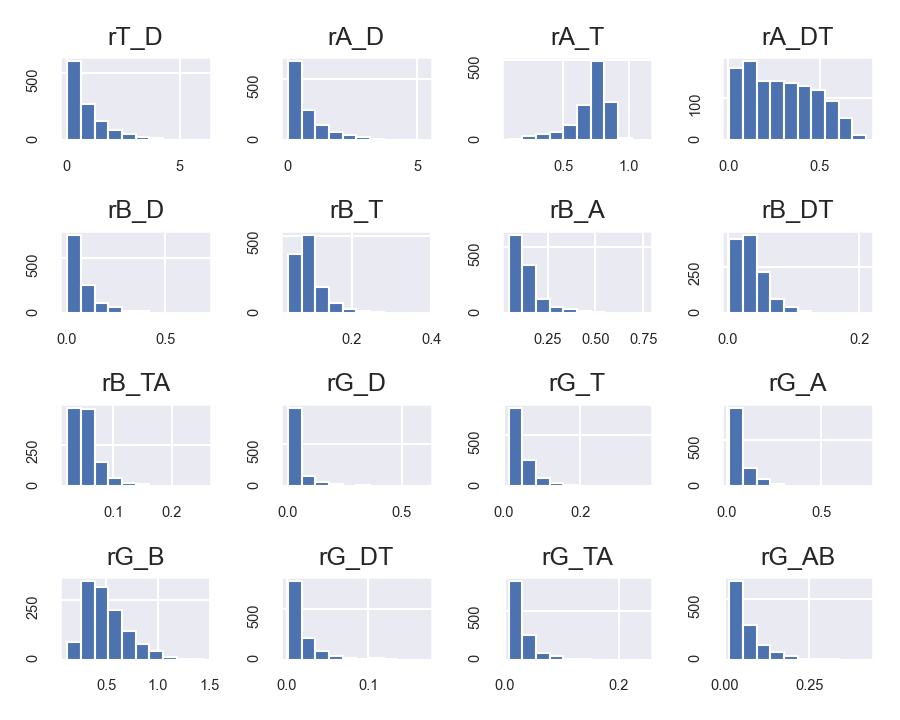

In [79]:
# PSD special features (EEG indices)
df_ft_rr_psd_ind = pd.DataFrame()

df_ft_rr_psd_ind['rT_D'] = df_ft_rr_psd_raw['rT_All'] / df_ft_rr_psd_raw['rD_All']
df_ft_rr_psd_ind['rA_D'] = df_ft_rr_psd_raw['rA_All'] / df_ft_rr_psd_raw['rD_All']
df_ft_rr_psd_ind['rA_T'] = df_ft_rr_psd_raw['rA_All'] / df_ft_rr_psd_raw['rT_All']
df_ft_rr_psd_ind['rA_DT'] = df_ft_rr_psd_raw['rA_All'] / (df_ft_rr_psd_raw['rD_All'] + df_ft_rr_psd_raw['rT_All'])
df_ft_rr_psd_ind['rB_D'] = df_ft_rr_psd_raw['rB_All'] / df_ft_rr_psd_raw['rD_All']
df_ft_rr_psd_ind['rB_T'] = df_ft_rr_psd_raw['rB_All'] / df_ft_rr_psd_raw['rT_All']
df_ft_rr_psd_ind['rB_A'] = df_ft_rr_psd_raw['rB_All'] / df_ft_rr_psd_raw['rA_All']
df_ft_rr_psd_ind['rB_DT'] = df_ft_rr_psd_raw['rB_All'] / (df_ft_rr_psd_raw['rD_All'] + df_ft_rr_psd_raw['rT_All'])
df_ft_rr_psd_ind['rB_TA'] = df_ft_rr_psd_raw['rB_All'] / (df_ft_rr_psd_raw['rT_All'] + df_ft_rr_psd_raw['rA_All'])
df_ft_rr_psd_ind['rG_D'] = df_ft_rr_psd_raw['rG_All'] / df_ft_rr_psd_raw['rD_All']
df_ft_rr_psd_ind['rG_T'] = df_ft_rr_psd_raw['rG_All'] / df_ft_rr_psd_raw['rT_All']
df_ft_rr_psd_ind['rG_A'] = df_ft_rr_psd_raw['rG_All'] / df_ft_rr_psd_raw['rA_All']
df_ft_rr_psd_ind['rG_B'] = df_ft_rr_psd_raw['rG_All'] / df_ft_rr_psd_raw['rB_All']
df_ft_rr_psd_ind['rG_DT'] = df_ft_rr_psd_raw['rG_All'] / (df_ft_rr_psd_raw['rD_All'] + df_ft_rr_psd_raw['rT_All'])
df_ft_rr_psd_ind['rG_TA'] = df_ft_rr_psd_raw['rG_All'] / (df_ft_rr_psd_raw['rT_All'] + df_ft_rr_psd_raw['rA_All'])
df_ft_rr_psd_ind['rG_AB'] = df_ft_rr_psd_raw['rG_All'] / (df_ft_rr_psd_raw['rA_All'] + df_ft_rr_psd_raw['rB_All'])

hist = plot_ft_distr_hist(df_ft_rr_psd_ind, row_length=4)

In [80]:
#display_corr_matrix(df_ft_rr_psd_ind.corr())

# Scaling
ft_rr_psd_ind_sc = StandardScaler().fit_transform(df_ft_rr_psd_ind.to_numpy())
df_ft_rr_psd_ind_sc = pd.DataFrame(ft_rr_psd_ind_sc, columns=df_ft_rr_psd_ind.columns)

display_corr_matrix(df_ft_rr_psd_ind_sc.corr())

,rT_D,rA_D,rA_T,rA_DT,rB_D,rB_T,rB_A,rB_DT,rB_TA,rG_D,rG_T,rG_A,rG_B,rG_DT,rG_TA,rG_AB
rT_D,1.00,0.99,0.42,0.90,0.88,-0.05,-0.25,0.67,-0.14,0.70,0.05,-0.11,0.12,0.50,-0.01,-0.09
rA_D,0.99,1.00,0.48,0.91,0.87,-0.05,-0.28,0.65,-0.15,0.69,0.04,-0.14,0.11,0.49,-0.03,-0.12
rA_T,0.42,0.48,1.00,0.65,0.37,-0.09,-0.65,0.35,-0.31,0.26,-0.10,-0.49,-0.11,0.20,-0.23,-0.47
rA_DT,0.90,0.91,0.65,1.00,0.80,-0.07,-0.38,0.72,-0.20,0.61,0.01,-0.23,0.06,0.50,-0.08,-0.21
rB_D,0.88,0.87,0.37,0.80,1.00,0.30,0.00,0.90,0.19,0.90,0.36,0.14,0.27,0.78,0.29,0.17
rB_T,-0.05,-0.05,-0.09,-0.07,0.30,1.00,0.76,0.54,0.97,0.36,0.81,0.72,0.32,0.55,0.81,0.71
rB_A,-0.25,-0.28,-0.65,-0.38,0.00,0.76,1.00,0.17,0.88,0.10,0.63,0.87,0.29,0.26,0.72,0.83
rB_DT,0.67,0.65,0.35,0.72,0.90,0.54,0.17,1.00,0.42,0.82,0.53,0.29,0.30,0.86,0.46,0.31
rB_TA,-0.14,-0.15,-0.31,-0.20,0.19,0.97,0.88,0.42,1.00,0.27,0.79,0.81,0.33,0.46,0.83,0.79
rG_D,0.70,0.69,0.26,0.61,0.90,0.36,0.10,0.82,0.27,1.00,0.57,0.34,0.55,0.92,0.50,0.39


In [ ]:
# Topological features


In [ ]:
# Calculating Covariance

In [ ]:
# Calculating PLV and Coherence


In [172]:
frequencies = np.array([16, 17, 18, 19, 20])
conn_matricies_delta = spectral_connectivity_epochs(epochs_fix_1s_rr, method=['coh', 'plv'], mode='cwt_morlet', cwt_freqs=frequencies,
                                                    mt_bandwidth=1, fmin=16, fmax=20, faverage=False, tmin=None, tmax=None)

Connectivity computation...
only using indices for lower-triangular matrix
    computing connectivity for 171 connections
    using t=-0.500s..0.500s for estimation (501 points)
    frequencies: 16.0Hz..20.0Hz (5 points)
    using CWT with Morlet wavelets to estimate spectra
    the following metrics will be computed: Coherence, PLV
    computing connectivity for epoch 1
    computing connectivity for epoch 2
    computing connectivity for epoch 3
    computing connectivity for epoch 4
    computing connectivity for epoch 5
    computing connectivity for epoch 6
    computing connectivity for epoch 7
    computing connectivity for epoch 8
    computing connectivity for epoch 9
    computing connectivity for epoch 10
    computing connectivity for epoch 11
    computing connectivity for epoch 12
    computing connectivity for epoch 13
    computing connectivity for epoch 14
    computing connectivity for epoch 15
    computing connectivity for epoch 16
    computing connectivity for epo

    computing connectivity for epoch 196
    computing connectivity for epoch 197
    computing connectivity for epoch 198
    computing connectivity for epoch 199
    computing connectivity for epoch 200
    computing connectivity for epoch 201
    computing connectivity for epoch 202
    computing connectivity for epoch 203
    computing connectivity for epoch 204
    computing connectivity for epoch 205
    computing connectivity for epoch 206
    computing connectivity for epoch 207
    computing connectivity for epoch 208
    computing connectivity for epoch 209
    computing connectivity for epoch 210
    computing connectivity for epoch 211
    computing connectivity for epoch 212
    computing connectivity for epoch 213
    computing connectivity for epoch 214
    computing connectivity for epoch 215
    computing connectivity for epoch 216
    computing connectivity for epoch 217
    computing connectivity for epoch 218
    computing connectivity for epoch 219
    computing co

    computing connectivity for epoch 396
    computing connectivity for epoch 397
    computing connectivity for epoch 398
    computing connectivity for epoch 399
    computing connectivity for epoch 400
    computing connectivity for epoch 401
    computing connectivity for epoch 402
    computing connectivity for epoch 403
    computing connectivity for epoch 404
    computing connectivity for epoch 405
    computing connectivity for epoch 406
    computing connectivity for epoch 407
    computing connectivity for epoch 408
    computing connectivity for epoch 409
    computing connectivity for epoch 410
    computing connectivity for epoch 411
    computing connectivity for epoch 412
    computing connectivity for epoch 413
    computing connectivity for epoch 414
    computing connectivity for epoch 415
    computing connectivity for epoch 416
    computing connectivity for epoch 417
    computing connectivity for epoch 418
    computing connectivity for epoch 419
    computing co

    computing connectivity for epoch 596
    computing connectivity for epoch 597
    computing connectivity for epoch 598
    computing connectivity for epoch 599
    computing connectivity for epoch 600
    computing connectivity for epoch 601
    computing connectivity for epoch 602
    computing connectivity for epoch 603
    computing connectivity for epoch 604
    computing connectivity for epoch 605
    computing connectivity for epoch 606
    computing connectivity for epoch 607
    computing connectivity for epoch 608
    computing connectivity for epoch 609
    computing connectivity for epoch 610
    computing connectivity for epoch 611
    computing connectivity for epoch 612
    computing connectivity for epoch 613
    computing connectivity for epoch 614
    computing connectivity for epoch 615
    computing connectivity for epoch 616
    computing connectivity for epoch 617
    computing connectivity for epoch 618
    computing connectivity for epoch 619
    computing co

    computing connectivity for epoch 796
    computing connectivity for epoch 797
    computing connectivity for epoch 798
    computing connectivity for epoch 799
    computing connectivity for epoch 800
    computing connectivity for epoch 801
    computing connectivity for epoch 802
    computing connectivity for epoch 803
    computing connectivity for epoch 804
    computing connectivity for epoch 805
    computing connectivity for epoch 806
    computing connectivity for epoch 807
    computing connectivity for epoch 808
    computing connectivity for epoch 809
    computing connectivity for epoch 810
    computing connectivity for epoch 811
    computing connectivity for epoch 812
    computing connectivity for epoch 813
    computing connectivity for epoch 814
    computing connectivity for epoch 815
    computing connectivity for epoch 816
    computing connectivity for epoch 817
    computing connectivity for epoch 818
    computing connectivity for epoch 819
    computing co

    computing connectivity for epoch 996
    computing connectivity for epoch 997
    computing connectivity for epoch 998
    computing connectivity for epoch 999
    computing connectivity for epoch 1000
    computing connectivity for epoch 1001
    computing connectivity for epoch 1002
    computing connectivity for epoch 1003
    computing connectivity for epoch 1004
    computing connectivity for epoch 1005
    computing connectivity for epoch 1006
    computing connectivity for epoch 1007
    computing connectivity for epoch 1008
    computing connectivity for epoch 1009
    computing connectivity for epoch 1010
    computing connectivity for epoch 1011
    computing connectivity for epoch 1012
    computing connectivity for epoch 1013
    computing connectivity for epoch 1014
    computing connectivity for epoch 1015
    computing connectivity for epoch 1016
    computing connectivity for epoch 1017
    computing connectivity for epoch 1018
    computing connectivity for epoch 1

In [173]:
print(conn_matricies_delta[1].shape)
print(conn_matricies_delta[0].get_data().flatten())
print(conn_matricies_delta[1].get_data().flatten())

(361, 5, 501)
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]


In [150]:
# Calculating CSD (Cross-spectral densities), re-referenced data
str_freq_rr = ['rD', 'rT', 'rA', 'rB', 'rG']
ch_names = data.ch_names

n_freq = len(str_freq_rr)
n_channels = len(ch_names)
n_samples = epochs_fix_1s_rr.__len__()

csd_matrix_rr_spectr = np.empty((n_samples, n_freq, n_channels, n_channels))

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'), (8, 14, 'Alpha (8-14 Hz)'), 
         (14, 25, 'Beta (14-25 Hz)'), (25, 40, 'Gamma (25-40 Hz)')]
kwargs = dict(fmin=0.1, fmax=40, n_jobs=1)

# Calculating PSD for each epoch (Multitaper)
for i in range(n_samples):
    csd_mtaper = csd_fourier(epochs_fix_1s_rr[i], **kwargs)
    csd_matrix_rr_spectr[i,:,:,:] = np.array([csd_mtaper.mean(fmin, fmax).get_data() for (fmin, fmax, _) in bands])

#print(csd_mtaper)

Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


<ipython-input-150-97f1dddcb458>:18: ComplexWarning: Casting complex values to real discards the imaginary part
  csd_matrix_rr_spectr[i,:,:,:] = np.array([csd_mtaper.mean(fmin, fmax).get_data() for (fmin, fmax, _) in bands])


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/1 [00:00<?,       ?it/s]

[done]


In [ ]:
# Calculating CSD (Cross-spectral densities), re-referenced data
df_test_psd_rr_spectr = pd.DataFrame()
df_csd_rr_spectr = pd.DataFrame()

for _freq in range(n_freq):
    for i in range(n_channels):
        df_test_psd_rr_spectr[str_freq_rr[_freq]+'_'+ch_names[i]+'_'+ch_names[i]] = csd_matrix_rr_spectr[:, _freq, i, i]
        for j in range(i, n_channels):
            df_csd_rr_spectr[str_freq_rr[_freq]+'_'+ch_names[i]+'_'+ch_names[j]] = csd_matrix_rr_spectr[:, _freq, i, j]

print(len(df_test_psd_rr_spectr.columns))
print(df_test_psd_rr_spectr.columns)
print(len(df_csd_rr_spectr.columns))
print(df_csd_rr_spectr.columns)
s = df_csd_rr_spectr.style.format('{:.1e}')
display(s)

95
Index(['rD_Fp1_Fp1', 'rD_Fp2_Fp2', 'rD_F7_F7', 'rD_F3_F3', 'rD_Fz_Fz',
       'rD_F4_F4', 'rD_F8_F8', 'rD_T3_T3', 'rD_C3_C3', 'rD_Cz_Cz', 'rD_C4_C4',
       'rD_T4_T4', 'rD_T5_T5', 'rD_P3_P3', 'rD_Pz_Pz', 'rD_P4_P4', 'rD_T6_T6',
       'rD_O1_O1', 'rD_O2_O2', 'rT_Fp1_Fp1', 'rT_Fp2_Fp2', 'rT_F7_F7',
       'rT_F3_F3', 'rT_Fz_Fz', 'rT_F4_F4', 'rT_F8_F8', 'rT_T3_T3', 'rT_C3_C3',
       'rT_Cz_Cz', 'rT_C4_C4', 'rT_T4_T4', 'rT_T5_T5', 'rT_P3_P3', 'rT_Pz_Pz',
       'rT_P4_P4', 'rT_T6_T6', 'rT_O1_O1', 'rT_O2_O2', 'rA_Fp1_Fp1',
       'rA_Fp2_Fp2', 'rA_F7_F7', 'rA_F3_F3', 'rA_Fz_Fz', 'rA_F4_F4',
       'rA_F8_F8', 'rA_T3_T3', 'rA_C3_C3', 'rA_Cz_Cz', 'rA_C4_C4', 'rA_T4_T4',
       'rA_T5_T5', 'rA_P3_P3', 'rA_Pz_Pz', 'rA_P4_P4', 'rA_T6_T6', 'rA_O1_O1',
       'rA_O2_O2', 'rB_Fp1_Fp1', 'rB_Fp2_Fp2', 'rB_F7_F7', 'rB_F3_F3',
       'rB_Fz_Fz', 'rB_F4_F4', 'rB_F8_F8', 'rB_T3_T3', 'rB_C3_C3', 'rB_Cz_Cz',
       'rB_C4_C4', 'rB_T4_T4', 'rB_T5_T5', 'rB_P3_P3', 'rB_Pz_Pz', 'rB_P4_P4',
       'rB_T6_

In [129]:
df_test_psd_rr_spectr_db = 10 * np.log10(df_test_psd_rr_spectr)
display(df_test_psd_rr_spectr_db)
df_psd_fix_1s_rr_spectr = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_fix_1s_rr_spectr[str_freq_rr[i] + ch_names[j]] = psd_fix_1s_rr_spectr[i,j,:]
display(df_psd_fix_1s_rr_spectr)
#display(df_psd_fix_1s_rr_spectr-df_test_psd_rr_spectr)

,rD_Fp1_Fp1,rD_Fp2_Fp2,rD_F7_F7,rD_F3_F3,rD_Fz_Fz,rD_F4_F4,rD_F8_F8,rD_T3_T3,rD_C3_C3,rD_Cz_Cz,...,rG_Cz_Cz,rG_C4_C4,rG_T4_T4,rG_T5_T5,rG_P3_P3,rG_Pz_Pz,rG_P4_P4,rG_T6_T6,rG_O1_O1,rG_O2_O2
0,-115.63,-107.03,-109.49,-110.63,-112.71,-124.42,-113.45,-119.89,-114.80,-110.97,...,-130.63,-121.81,-125.89,-129.02,-131.53,-131.63,-130.55,-128.88,-127.08,-130.45
1,-111.19,-111.30,-114.69,-118.71,-123.32,-124.12,-121.21,-119.95,-123.23,-117.43,...,-128.83,-122.67,-125.22,-129.61,-131.94,-131.17,-130.44,-127.94,-126.46,-130.28
2,-109.99,-108.59,-112.92,-114.66,-118.03,-123.40,-123.15,-121.10,-119.80,-115.06,...,-129.71,-123.34,-126.48,-130.08,-131.17,-131.38,-131.39,-128.65,-124.71,-128.99
3,-109.04,-109.27,-115.76,-118.25,-121.08,-117.04,-118.12,-125.58,-124.53,-123.92,...,-131.80,-123.17,-126.38,-129.51,-131.47,-131.70,-133.62,-128.42,-126.03,-130.95
4,-114.70,-116.55,-119.94,-120.16,-119.39,-116.00,-120.21,-122.26,-127.12,-123.10,...,-131.70,-124.61,-125.70,-128.56,-132.54,-130.87,-131.40,-128.10,-127.00,-130.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1166,-109.53,-110.00,-115.16,-122.19,-121.66,-128.39,-120.28,-117.16,-121.93,-116.71,...,-133.95,-136.20,-136.28,-130.61,-134.94,-134.60,-134.95,-133.55,-129.76,-131.04
1167,-106.27,-107.38,-113.62,-117.41,-119.52,-123.34,-118.28,-117.18,-120.72,-117.60,...,-133.76,-135.86,-133.93,-133.71,-133.99,-133.59,-133.35,-134.65,-126.41,-129.83
1168,-109.58,-111.12,-113.34,-119.20,-119.27,-123.28,-120.72,-114.52,-119.89,-116.09,...,-136.20,-137.75,-136.25,-133.02,-132.34,-133.29,-134.60,-133.90,-128.10,-132.07
1169,-107.61,-108.89,-114.23,-119.61,-120.58,-124.86,-116.13,-116.88,-118.19,-116.60,...,-133.97,-136.04,-134.35,-132.38,-136.57,-136.90,-135.09,-133.03,-128.42,-129.17


,rDFp1,rDFp2,rDF7,rDF3,rDFz,rDF4,rDF8,rDT3,rDC3,rDCz,...,rGCz,rGC4,rGT4,rGT5,rGP3,rGPz,rGP4,rGT6,rGO1,rGO2
0,-88.64,-80.04,-82.50,-83.64,-85.72,-97.43,-86.46,-92.90,-87.81,-83.98,...,-103.61,-94.67,-98.73,-101.95,-104.78,-104.72,-103.60,-101.77,-100.22,-103.48
1,-84.20,-84.31,-87.70,-91.72,-96.33,-97.13,-94.22,-92.96,-96.25,-90.44,...,-102.46,-95.69,-98.28,-102.81,-105.08,-104.38,-103.57,-101.05,-99.60,-103.66
2,-83.00,-81.60,-85.93,-87.67,-91.04,-96.41,-96.16,-94.11,-92.81,-88.07,...,-103.09,-96.23,-99.50,-103.07,-104.25,-104.42,-104.31,-101.70,-97.80,-102.13
3,-82.05,-82.28,-88.77,-91.26,-94.09,-90.05,-91.13,-98.59,-97.54,-96.93,...,-105.00,-96.09,-99.21,-102.46,-104.82,-104.77,-106.64,-101.32,-99.12,-104.02
4,-87.71,-89.56,-92.95,-93.17,-92.40,-89.01,-93.22,-95.27,-100.13,-96.11,...,-105.04,-97.49,-98.60,-101.57,-105.78,-103.95,-104.37,-101.22,-100.17,-103.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1166,-82.54,-83.01,-88.17,-95.20,-94.67,-101.40,-93.29,-90.17,-94.94,-89.72,...,-107.58,-109.55,-109.31,-103.63,-108.44,-107.90,-108.33,-106.54,-102.81,-104.07
1167,-79.28,-80.39,-86.63,-90.42,-92.53,-96.35,-91.29,-90.19,-93.73,-90.61,...,-107.14,-109.22,-106.83,-106.73,-107.18,-106.69,-106.46,-107.64,-99.33,-102.82
1168,-82.59,-84.13,-86.35,-92.21,-92.28,-96.29,-93.73,-87.53,-92.90,-89.10,...,-109.62,-111.12,-109.26,-106.04,-105.55,-106.54,-107.93,-106.97,-101.26,-105.11
1169,-80.62,-81.90,-87.24,-92.62,-93.59,-97.87,-89.14,-89.89,-91.20,-89.61,...,-107.27,-109.45,-107.38,-105.43,-109.80,-110.33,-108.31,-106.21,-101.47,-102.28


# PSD features exploration

In [81]:
# Display highlighted correlation matrix function

def highlight(x, corr_bounds=[0.5, 0.65, 0.8]):
    color1 = 'background-color: red'
    color2 = 'background-color: orange'
    color3 = 'background-color: yellow'
    color4 = ''

    mask1 = (abs(x) >= corr_bounds[2])
    mask2 = (abs(x) >= corr_bounds[1]) & (abs(x) < corr_bounds[2])
    mask3 = (abs(x) >= corr_bounds[0]) & (abs(x) < corr_bounds[1])

    df1 = pd.DataFrame(color4, index=x.index, columns=x.columns)
    return df1.mask(mask1, color1).mask(mask2, color2).mask(mask3, color3)

def display_corr_matrix(df_corr, corr_bounds=[0.5, 0.65, 0.8]):
    s = df_corr.style.apply(highlight, corr_bounds=corr_bounds, axis=None)
    s = s.format('{:.2f}')
    display(s)
#    return s

In [82]:
# Global variables
print(ft_rr_psd_spectr_db.shape)

n_samples = len(ft_rr_psd_spectr_db[:,0,0])
n_channels = len(ft_rr_psd_spectr_db[0,:,0])
n_freq = len(ft_rr_psd_spectr_db[0,0,:])


(1167, 19, 5)


## Explore correlations of raw data and PSD

In [83]:
# Correlation matrix for raw filtered data
matr_corr_ts_raw = np.corrcoef(data.copy().get_data())
df_matr_corr_ts_raw = pd.DataFrame(matr_corr_ts_raw, index = data.ch_names, columns = data.ch_names)
display_corr_matrix(df_matr_corr_ts_raw)
matr_corr_ts_rr_raw = np.corrcoef(reref_data.copy().get_data())
df_matr_corr_ts_rr_raw = pd.DataFrame(matr_corr_ts_rr_raw, index = reref_data.ch_names, columns = reref_data.ch_names)
display_corr_matrix(df_matr_corr_ts_rr_raw)

matr_corr_ts = np.empty((n_freq, n_channels, n_channels))
matr_corr_ts_rr = np.empty((n_freq, n_channels, n_channels))
matr_corr_psd_mt = np.empty((n_freq, n_channels, n_channels))
matr_corr_psd_rr = np.empty((n_freq, n_channels, n_channels))

for i in range(n_freq):
    print(bands[i][2])
    print("Time Series filtered data")
    matr_corr_ts[i] = np.corrcoef(data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]).get_data())
    df_matr_corr_ts = pd.DataFrame(matr_corr_ts[i], index = data.ch_names, columns = data.ch_names)
    display_corr_matrix(df_matr_corr_ts)
    print("Time Series filtered re-referenced data")
    matr_corr_ts_rr[i] = np.corrcoef(reref_data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]).get_data())
    df_matr_corr_ts_rr = pd.DataFrame(matr_corr_ts_rr[i], index = data.ch_names, columns = data.ch_names)
    display_corr_matrix(df_matr_corr_ts_rr)    
    print("PSD Multitaper (epochs)")
    matr_corr_psd_mt[i] = np.corrcoef(ft_psd_spectr_db[i,:,:])
    df_matr_corr_psd_mt = pd.DataFrame(matr_corr_psd_mt[i], index = data.ch_names, columns = data.ch_names)
    display_corr_matrix(df_matr_corr_psd_mt)
    print("PSD Multitaper (re-referenced epochs)")
    matr_corr_psd_rr[i] = np.corrcoef(ft_rr_psd_spectr_db[i,:,:])
    df_matr_corr_psd_rr = pd.DataFrame(matr_corr_psd_rr[i], index = data.ch_names, columns = data.ch_names)
    display_corr_matrix(df_matr_corr_psd_rr)

print('Averaged correlation matrix')
print("Time Series filtered data")
matr_corr_ts_avg = np.mean(matr_corr_ts, axis=0)
df_matr_corr_ts_avg = pd.DataFrame(matr_corr_ts_avg, index = data.ch_names, columns = data.ch_names)
display_corr_matrix(df_matr_corr_ts_avg)
print("Time Series filtered re-referenced data")
matr_corr_ts_rr_avg = np.mean(matr_corr_ts_rr, axis=0)
df_matr_corr_ts_rr_avg = pd.DataFrame(matr_corr_ts_rr_avg, index = data.ch_names, columns = data.ch_names)
display_corr_matrix(df_matr_corr_ts_rr_avg)
print("PSD Multitaper (epochs)")
matr_corr_psd_mt_avg = np.mean(matr_corr_psd_mt, axis=0)
df_matr_corr_psd_mt_avg = pd.DataFrame(matr_corr_psd_mt_avg, index = data.ch_names, columns = data.ch_names)
display_corr_matrix(df_matr_corr_psd_mt_avg)
print("PSD Multitaper (re-referenced epochs)")
matr_corr_psd_rr_avg = np.mean(matr_corr_psd_rr, axis=0)
df_matr_corr_psd_rr_avg = pd.DataFrame(matr_corr_psd_rr_avg, index = data.ch_names, columns = data.ch_names)
display_corr_matrix(df_matr_corr_psd_rr_avg)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.80,0.78,0.60,-0.15,0.37,0.50,0.63,0.02,-0.62,0.04,0.48,-0.28,0.15,-0.14,0.59,0.28,0.48,0.69
Fp2,0.80,1.00,0.76,0.54,-0.22,0.52,0.61,0.65,-0.11,-0.76,0.04,0.55,-0.39,0.09,-0.22,0.72,0.33,0.49,0.84
F7,0.78,0.76,1.00,0.88,0.13,0.66,0.79,0.89,0.33,-0.60,0.38,0.73,-0.08,0.45,0.10,0.85,0.50,0.73,0.85
F3,0.60,0.54,0.88,1.00,0.44,0.72,0.79,0.87,0.60,-0.39,0.60,0.73,0.08,0.61,0.31,0.83,0.50,0.73,0.73
Fz,-0.15,-0.22,0.13,0.44,1.00,0.46,0.35,0.29,0.83,0.38,0.74,0.40,0.58,0.66,0.65,0.25,0.35,0.38,0.02
F4,0.37,0.52,0.66,0.72,0.46,1.00,0.73,0.74,0.52,-0.25,0.65,0.75,0.22,0.60,0.36,0.77,0.60,0.72,0.69
F8,0.50,0.61,0.79,0.79,0.35,0.73,1.00,0.87,0.50,-0.44,0.60,0.88,0.22,0.63,0.32,0.85,0.69,0.81,0.80
T3,0.63,0.65,0.89,0.87,0.29,0.74,0.87,1.00,0.50,-0.50,0.54,0.88,0.19,0.66,0.30,0.86,0.65,0.88,0.83
C3,0.02,-0.11,0.33,0.60,0.83,0.52,0.50,0.50,1.00,0.32,0.84,0.59,0.68,0.85,0.80,0.43,0.56,0.61,0.21
Cz,-0.62,-0.76,-0.60,-0.39,0.38,-0.25,-0.44,-0.50,0.32,1.00,0.21,-0.31,0.51,0.13,0.49,-0.48,-0.03,-0.30,-0.60


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.71,0.30,0.36,0.28,0.48,-0.12,-0.32,0.01,0.39,-0.02,-0.59,-0.03,-0.47,-0.11,-0.43,-0.09,-0.62,-0.22
Fp2,0.71,1.00,0.49,0.18,-0.18,0.32,0.18,0.01,-0.50,-0.10,-0.41,-0.23,-0.50,-0.78,-0.55,0.09,-0.23,-0.35,0.33
F7,0.30,0.49,1.00,0.53,-0.49,-0.18,0.26,0.59,-0.52,-0.54,-0.64,-0.07,-0.73,-0.63,-0.74,0.45,-0.62,0.07,0.54
F3,0.36,0.18,0.53,1.00,0.22,0.20,0.08,0.16,0.18,0.01,-0.00,-0.54,-0.31,-0.28,-0.26,-0.02,-0.68,-0.37,-0.09
Fz,0.28,-0.18,-0.49,0.22,1.00,0.62,-0.26,-0.70,0.81,0.83,0.77,-0.59,0.65,0.32,0.62,-0.77,0.11,-0.66,-0.87
F4,0.48,0.32,-0.18,0.20,0.62,1.00,-0.16,-0.54,0.31,0.61,0.44,-0.59,0.25,-0.19,0.18,-0.53,-0.00,-0.68,-0.48
F8,-0.12,0.18,0.26,0.08,-0.26,-0.16,1.00,0.36,-0.33,-0.41,-0.34,0.25,-0.31,-0.34,-0.50,0.29,-0.28,0.10,0.30
T3,-0.32,0.01,0.59,0.16,-0.70,-0.54,0.36,1.00,-0.57,-0.84,-0.72,0.49,-0.57,-0.20,-0.68,0.60,-0.53,0.64,0.63
C3,0.01,-0.50,-0.52,0.18,0.81,0.31,-0.33,-0.57,1.00,0.73,0.76,-0.47,0.70,0.60,0.74,-0.69,0.10,-0.42,-0.86
Cz,0.39,-0.10,-0.54,0.01,0.83,0.61,-0.41,-0.84,0.73,1.00,0.75,-0.63,0.71,0.28,0.73,-0.84,0.40,-0.72,-0.84


Delta (0.9-4 Hz)
Time Series filtered data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1835 samples (3.670 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.78,0.64,0.42,-0.16,0.24,0.36,0.48,-0.11,-0.54,-0.10,0.30,-0.33,-0.01,-0.26,0.41,0.11,0.32,0.53
Fp2,0.78,1.00,0.68,0.44,-0.19,0.43,0.56,0.59,-0.16,-0.64,-0.03,0.47,-0.39,0.00,-0.29,0.62,0.26,0.43,0.78
F7,0.64,0.68,1.00,0.84,0.18,0.66,0.76,0.87,0.31,-0.36,0.37,0.71,0.00,0.45,0.14,0.81,0.53,0.73,0.82
F3,0.42,0.44,0.84,1.00,0.50,0.76,0.75,0.82,0.61,-0.06,0.63,0.76,0.20,0.68,0.43,0.84,0.62,0.77,0.72
Fz,-0.16,-0.19,0.18,0.50,1.00,0.57,0.38,0.28,0.82,0.58,0.77,0.48,0.63,0.74,0.76,0.34,0.53,0.46,0.09
F4,0.24,0.43,0.66,0.76,0.57,1.00,0.81,0.75,0.62,0.13,0.73,0.84,0.40,0.71,0.54,0.80,0.78,0.80,0.70
F8,0.36,0.56,0.76,0.75,0.38,0.81,1.00,0.83,0.46,-0.15,0.58,0.86,0.27,0.59,0.33,0.83,0.74,0.79,0.78
T3,0.48,0.59,0.87,0.82,0.28,0.75,0.83,1.00,0.42,-0.23,0.49,0.87,0.24,0.63,0.30,0.84,0.71,0.89,0.83
C3,-0.11,-0.16,0.31,0.61,0.82,0.62,0.46,0.42,1.00,0.60,0.85,0.58,0.72,0.87,0.87,0.44,0.64,0.59,0.19
Cz,-0.54,-0.64,-0.36,-0.06,0.58,0.13,-0.15,-0.23,0.60,1.00,0.54,0.00,0.66,0.44,0.73,-0.18,0.28,-0.00,-0.36


Time Series filtered re-referenced data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1835 samples (3.670 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.74,0.32,0.33,0.17,0.40,-0.02,-0.23,-0.12,0.19,-0.14,-0.57,-0.09,-0.43,-0.17,-0.40,-0.16,-0.52,-0.19
Fp2,0.74,1.00,0.46,0.12,-0.24,0.24,0.25,0.08,-0.55,-0.25,-0.48,-0.23,-0.50,-0.74,-0.59,0.05,-0.28,-0.28,0.33
F7,0.32,0.46,1.00,0.44,-0.51,-0.27,0.23,0.55,-0.54,-0.60,-0.62,-0.06,-0.64,-0.56,-0.70,0.37,-0.60,0.11,0.49
F3,0.33,0.12,0.44,1.00,0.15,0.10,-0.08,0.02,0.12,-0.01,-0.02,-0.50,-0.27,-0.13,-0.12,0.01,-0.56,-0.30,-0.09
Fz,0.17,-0.24,-0.51,0.15,1.00,0.55,-0.29,-0.75,0.74,0.80,0.70,-0.53,0.62,0.43,0.69,-0.68,0.21,-0.56,-0.83
F4,0.40,0.24,-0.27,0.10,0.55,1.00,-0.01,-0.60,0.27,0.59,0.39,-0.54,0.31,-0.08,0.27,-0.53,0.17,-0.63,-0.49
F8,-0.02,0.25,0.23,-0.08,-0.29,-0.01,1.00,0.24,-0.39,-0.38,-0.30,0.20,-0.25,-0.41,-0.46,0.22,-0.13,0.03,0.28
T3,-0.23,0.08,0.55,0.02,-0.75,-0.60,0.24,1.00,-0.62,-0.81,-0.72,0.50,-0.52,-0.27,-0.68,0.55,-0.42,0.65,0.65
C3,-0.12,-0.55,-0.54,0.12,0.74,0.27,-0.39,-0.62,1.00,0.73,0.74,-0.40,0.69,0.68,0.81,-0.58,0.20,-0.34,-0.80
Cz,0.19,-0.25,-0.60,-0.01,0.80,0.59,-0.38,-0.81,0.73,1.00,0.76,-0.57,0.73,0.43,0.81,-0.78,0.49,-0.63,-0.83


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.88,0.87,0.65,0.77,0.64,0.69,0.35,0.23,0.62,0.79,0.12,0.39,-0.23,0.09,0.29,0.08,-0.38,-0.15
Fp2,0.88,1.00,0.94,0.79,0.97,0.22,0.28,0.73,0.58,0.90,0.93,0.50,0.73,0.23,0.53,0.69,0.48,0.07,0.30
F7,0.87,0.94,1.00,0.88,0.94,0.27,0.36,0.73,0.66,0.88,0.90,0.59,0.77,0.24,0.52,0.66,0.54,0.10,0.32
F3,0.65,0.79,0.88,1.00,0.80,0.08,0.06,0.74,0.84,0.81,0.65,0.69,0.81,0.40,0.58,0.67,0.61,0.27,0.42
Fz,0.77,0.97,0.94,0.80,1.00,0.02,0.13,0.86,0.71,0.97,0.96,0.68,0.86,0.43,0.70,0.83,0.67,0.28,0.51
F4,0.64,0.22,0.27,0.08,0.02,1.00,0.95,-0.46,-0.47,-0.19,0.10,-0.58,-0.39,-0.86,-0.68,-0.54,-0.65,-0.91,-0.82
F8,0.69,0.28,0.36,0.06,0.13,0.95,1.00,-0.35,-0.44,-0.07,0.28,-0.46,-0.29,-0.77,-0.57,-0.42,-0.53,-0.82,-0.70
T3,0.35,0.73,0.73,0.74,0.86,-0.46,-0.35,1.00,0.92,0.95,0.77,0.94,0.99,0.83,0.96,0.99,0.95,0.73,0.87
C3,0.23,0.58,0.66,0.84,0.71,-0.47,-0.44,0.92,1.00,0.83,0.55,0.95,0.95,0.83,0.90,0.90,0.93,0.76,0.84
Cz,0.62,0.90,0.88,0.81,0.97,-0.19,-0.07,0.95,0.83,1.00,0.91,0.82,0.95,0.62,0.84,0.93,0.82,0.49,0.68


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.98,0.94,0.70,0.50,-0.86,-0.71,0.94,0.58,0.67,0.09,0.72,0.99,0.49,0.74,0.88,0.73,0.13,0.53
Fp2,0.98,1.00,0.94,0.81,0.63,-0.89,-0.68,0.99,0.72,0.81,0.07,0.80,0.99,0.64,0.86,0.96,0.82,0.27,0.67
F7,0.94,0.94,1.00,0.85,0.71,-0.70,-0.87,0.88,0.75,0.76,-0.24,0.82,0.92,0.69,0.84,0.90,0.84,0.43,0.72
F3,0.70,0.81,0.85,1.00,0.96,-0.57,-0.65,0.79,0.99,0.96,-0.37,0.93,0.73,0.96,0.98,0.92,0.98,0.77,0.98
Fz,0.50,0.63,0.71,0.96,1.00,-0.35,-0.57,0.60,0.99,0.92,-0.54,0.88,0.53,0.99,0.92,0.78,0.94,0.91,1.00
F4,-0.86,-0.89,-0.70,-0.57,-0.35,1.00,0.32,-0.95,-0.48,-0.67,-0.50,-0.58,-0.90,-0.39,-0.69,-0.85,-0.60,0.06,-0.42
F8,-0.71,-0.68,-0.87,-0.65,-0.57,0.32,1.00,-0.56,-0.56,-0.45,0.53,-0.53,-0.64,-0.54,-0.57,-0.61,-0.59,-0.46,-0.55
T3,0.94,0.99,0.88,0.79,0.60,-0.95,-0.56,1.00,0.70,0.82,0.20,0.76,0.97,0.62,0.86,0.97,0.80,0.22,0.65
C3,0.58,0.72,0.75,0.99,0.99,-0.48,-0.56,0.70,1.00,0.96,-0.42,0.91,0.62,0.99,0.97,0.86,0.97,0.84,1.00
Cz,0.67,0.81,0.76,0.96,0.92,-0.67,-0.45,0.82,0.96,1.00,-0.17,0.93,0.73,0.93,0.99,0.93,0.97,0.68,0.94


Theta (4-8 Hz)
Time Series filtered data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 9.00 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.71,0.32,-0.12,-0.42,-0.31,-0.04,-0.03,-0.24,-0.44,-0.24,-0.01,-0.03,-0.07,-0.11,-0.06,0.01,0.02,0.02
Fp2,0.71,1.00,0.22,-0.30,-0.43,-0.04,0.24,0.05,-0.24,-0.42,-0.05,0.20,0.14,0.04,0.01,0.11,0.21,0.20,0.20
F7,0.32,0.22,1.00,0.43,-0.00,0.24,0.45,0.68,0.44,0.11,0.34,0.50,0.58,0.45,0.34,0.38,0.49,0.46,0.46
F3,-0.12,-0.30,0.43,1.00,0.54,0.33,0.15,0.41,0.64,0.58,0.35,0.17,0.25,0.33,0.29,0.22,0.16,0.15,0.14
Fz,-0.42,-0.43,-0.00,0.54,1.00,0.45,0.09,0.16,0.49,0.68,0.36,0.04,0.07,0.19,0.22,0.14,0.02,0.01,0.02
F4,-0.31,-0.04,0.24,0.33,0.45,1.00,0.64,0.56,0.55,0.55,0.72,0.58,0.60,0.54,0.52,0.56,0.55,0.51,0.53
F8,-0.04,0.24,0.45,0.15,0.09,0.64,1.00,0.73,0.44,0.25,0.66,0.81,0.80,0.61,0.54,0.65,0.78,0.71,0.73
T3,-0.03,0.05,0.68,0.41,0.16,0.56,0.73,1.00,0.71,0.39,0.73,0.85,0.92,0.80,0.68,0.73,0.84,0.81,0.80
C3,-0.24,-0.24,0.44,0.64,0.49,0.55,0.44,0.71,1.00,0.79,0.75,0.55,0.61,0.77,0.73,0.64,0.54,0.57,0.55
Cz,-0.44,-0.42,0.11,0.58,0.68,0.55,0.25,0.39,0.79,1.00,0.68,0.28,0.31,0.54,0.61,0.48,0.27,0.28,0.28


Time Series filtered re-referenced data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 9.00 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.92,0.75,0.71,0.60,0.56,0.31,-0.01,0.28,0.28,-0.18,-0.63,-0.54,-0.65,-0.54,-0.69,-0.65,-0.69,-0.69
Fp2,0.92,1.00,0.66,0.63,0.58,0.62,0.43,-0.09,0.18,0.24,-0.14,-0.56,-0.51,-0.69,-0.56,-0.67,-0.60,-0.66,-0.65
F7,0.75,0.66,1.00,0.72,0.54,0.48,0.31,0.35,0.39,0.29,-0.21,-0.55,-0.30,-0.61,-0.59,-0.75,-0.60,-0.68,-0.68
F3,0.71,0.63,0.72,1.00,0.87,0.73,0.25,0.13,0.70,0.71,0.13,-0.81,-0.63,-0.59,-0.47,-0.76,-0.85,-0.89,-0.89
Fz,0.60,0.58,0.54,0.87,1.00,0.81,0.27,-0.02,0.66,0.78,0.29,-0.79,-0.67,-0.58,-0.40,-0.68,-0.84,-0.88,-0.87
F4,0.56,0.62,0.48,0.73,0.81,1.00,0.47,-0.03,0.47,0.64,0.31,-0.65,-0.51,-0.67,-0.49,-0.67,-0.73,-0.81,-0.78
F8,0.31,0.43,0.31,0.25,0.27,0.47,1.00,0.14,-0.03,0.05,-0.07,-0.06,0.03,-0.61,-0.55,-0.50,-0.19,-0.37,-0.33
T3,-0.01,-0.09,0.35,0.13,-0.02,-0.03,0.14,1.00,0.18,-0.08,-0.28,0.06,0.45,-0.12,-0.35,-0.38,0.01,-0.09,-0.14
C3,0.28,0.18,0.39,0.70,0.66,0.47,-0.03,0.18,1.00,0.80,0.31,-0.75,-0.52,-0.12,-0.08,-0.48,-0.76,-0.67,-0.74
Cz,0.28,0.24,0.29,0.71,0.78,0.64,0.05,-0.08,0.80,1.00,0.55,-0.78,-0.68,-0.24,-0.02,-0.41,-0.81,-0.77,-0.77


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.58,0.17,0.24,0.19,0.93,0.27,-0.62,-0.20,0.09,0.28,-0.79,-0.65,-0.69,-0.55,-0.68,-0.72,-0.76,-0.78
Fp2,0.58,1.00,0.85,0.81,0.90,0.51,0.47,0.22,0.66,0.85,0.91,-0.01,0.21,0.14,0.33,0.15,0.10,0.03,0.00
F7,0.17,0.85,1.00,0.95,0.98,0.24,0.69,0.61,0.92,0.98,0.99,0.38,0.57,0.48,0.59,0.46,0.45,0.38,0.34
F3,0.24,0.81,0.95,1.00,0.89,0.39,0.72,0.42,0.82,0.90,0.93,0.19,0.38,0.29,0.40,0.26,0.25,0.18,0.15
Fz,0.19,0.90,0.98,0.89,1.00,0.18,0.57,0.62,0.92,0.99,0.99,0.41,0.60,0.53,0.66,0.52,0.49,0.43,0.39
F4,0.93,0.51,0.24,0.39,0.18,1.00,0.50,-0.59,-0.15,0.11,0.31,-0.79,-0.66,-0.73,-0.62,-0.75,-0.75,-0.80,-0.83
F8,0.27,0.47,0.69,0.72,0.57,0.50,1.00,0.30,0.50,0.54,0.67,0.05,0.16,0.06,0.05,-0.04,0.04,-0.03,-0.09
T3,-0.62,0.22,0.61,0.42,0.62,-0.59,0.30,1.00,0.84,0.67,0.54,0.96,0.99,0.97,0.93,0.93,0.97,0.94,0.92
C3,-0.20,0.66,0.92,0.82,0.92,-0.15,0.50,0.84,1.00,0.96,0.88,0.69,0.83,0.77,0.84,0.75,0.75,0.69,0.67
Cz,0.09,0.85,0.98,0.90,0.99,0.11,0.54,0.67,0.96,1.00,0.97,0.47,0.66,0.59,0.71,0.58,0.56,0.49,0.46


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.92,0.97,0.72,0.47,0.54,0.11,0.90,0.51,0.57,0.49,0.58,0.95,0.74,0.78,0.55,0.68,0.45,0.44
Fp2,0.92,1.00,0.96,0.89,0.64,0.25,-0.25,0.82,0.74,0.75,0.11,0.71,0.98,0.90,0.96,0.80,0.83,0.63,0.67
F7,0.97,0.96,1.00,0.78,0.49,0.35,0.01,0.94,0.57,0.61,0.27,0.59,0.98,0.78,0.86,0.63,0.71,0.47,0.50
F3,0.72,0.89,0.78,1.00,0.91,0.24,-0.58,0.56,0.96,0.97,-0.10,0.93,0.87,1.00,0.95,0.97,0.99,0.90,0.93
Fz,0.47,0.64,0.49,0.91,1.00,0.35,-0.70,0.26,0.97,0.99,-0.11,0.99,0.64,0.91,0.75,0.92,0.96,1.00,0.98
F4,0.54,0.25,0.35,0.24,0.35,1.00,0.36,0.40,0.18,0.30,0.84,0.45,0.40,0.28,0.09,0.06,0.35,0.33,0.16
F8,0.11,-0.25,0.01,-0.58,-0.70,0.36,1.00,0.30,-0.75,-0.68,0.68,-0.58,-0.13,-0.57,-0.50,-0.76,-0.59,-0.72,-0.79
T3,0.90,0.82,0.94,0.56,0.26,0.40,0.30,1.00,0.33,0.37,0.35,0.39,0.88,0.56,0.66,0.38,0.50,0.24,0.25
C3,0.51,0.74,0.57,0.96,0.97,0.18,-0.75,0.33,1.00,0.99,-0.24,0.96,0.71,0.96,0.86,0.98,0.97,0.97,1.00
Cz,0.57,0.75,0.61,0.97,0.99,0.30,-0.68,0.37,0.99,1.00,-0.12,0.98,0.74,0.97,0.85,0.96,0.99,0.98,0.99


Alpha (8-14 Hz)
Time Series filtered data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 8 - 14 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 14.00 Hz
- Upper transition bandwidth: 3.50 Hz (-6 dB cutoff frequency: 15.75 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.68,0.56,-0.08,-0.53,-0.03,0.37,0.40,0.07,-0.31,0.14,0.40,0.40,0.26,0.15,0.25,0.39,0.37,0.36
Fp2,0.68,1.00,0.52,-0.32,-0.60,0.34,0.68,0.57,0.13,-0.28,0.42,0.67,0.64,0.47,0.35,0.51,0.66,0.63,0.63
F7,0.56,0.52,1.00,0.27,-0.31,0.38,0.68,0.82,0.54,0.04,0.54,0.70,0.76,0.62,0.47,0.57,0.70,0.67,0.66
F3,-0.08,-0.32,0.27,1.00,0.49,0.07,-0.07,0.15,0.50,0.50,0.12,-0.06,-0.00,0.14,0.15,0.04,-0.06,-0.03,-0.05
Fz,-0.53,-0.60,-0.31,0.49,1.00,0.08,-0.36,-0.29,0.20,0.59,-0.03,-0.39,-0.37,-0.14,-0.01,-0.17,-0.38,-0.34,-0.35
F4,-0.03,0.34,0.38,0.07,0.08,1.00,0.64,0.61,0.53,0.36,0.76,0.65,0.65,0.63,0.59,0.68,0.64,0.64,0.65
F8,0.37,0.68,0.68,-0.07,-0.36,0.64,1.00,0.86,0.49,0.05,0.75,0.92,0.91,0.75,0.62,0.78,0.91,0.87,0.88
T3,0.40,0.57,0.82,0.15,-0.29,0.61,0.86,1.00,0.71,0.18,0.80,0.92,0.96,0.87,0.72,0.83,0.92,0.91,0.90
C3,0.07,0.13,0.54,0.50,0.20,0.53,0.49,0.71,1.00,0.72,0.77,0.57,0.62,0.83,0.80,0.72,0.57,0.64,0.60
Cz,-0.31,-0.28,0.04,0.50,0.59,0.36,0.05,0.18,0.72,1.00,0.51,0.09,0.11,0.45,0.60,0.39,0.09,0.17,0.15


Time Series filtered re-referenced data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 8 - 14 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 14.00 Hz
- Upper transition bandwidth: 3.50 Hz (-6 dB cutoff frequency: 15.75 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.96,0.92,0.91,0.88,0.86,0.69,0.40,0.69,0.69,0.16,-0.72,-0.54,-0.81,-0.63,-0.88,-0.79,-0.87,-0.87
Fp2,0.96,1.00,0.88,0.87,0.86,0.88,0.75,0.35,0.62,0.65,0.17,-0.67,-0.52,-0.83,-0.66,-0.87,-0.75,-0.85,-0.83
F7,0.92,0.88,1.00,0.90,0.84,0.82,0.68,0.58,0.72,0.66,0.12,-0.68,-0.43,-0.79,-0.67,-0.90,-0.75,-0.85,-0.85
F3,0.91,0.87,0.90,1.00,0.97,0.91,0.61,0.38,0.86,0.86,0.34,-0.85,-0.67,-0.73,-0.52,-0.86,-0.90,-0.95,-0.95
Fz,0.88,0.86,0.84,0.97,1.00,0.94,0.60,0.28,0.85,0.89,0.43,-0.87,-0.73,-0.73,-0.47,-0.82,-0.92,-0.96,-0.95
F4,0.86,0.88,0.82,0.91,0.94,1.00,0.67,0.28,0.74,0.80,0.44,-0.78,-0.63,-0.79,-0.56,-0.82,-0.84,-0.91,-0.89
F8,0.69,0.75,0.68,0.61,0.60,0.67,1.00,0.44,0.32,0.35,0.00,-0.29,-0.12,-0.81,-0.75,-0.76,-0.41,-0.59,-0.56
T3,0.40,0.35,0.58,0.38,0.28,0.28,0.44,1.00,0.31,0.10,-0.28,-0.11,0.26,-0.40,-0.61,-0.61,-0.19,-0.30,-0.35
C3,0.69,0.62,0.72,0.86,0.85,0.74,0.32,0.31,1.00,0.91,0.44,-0.91,-0.72,-0.39,-0.21,-0.68,-0.92,-0.85,-0.91
Cz,0.69,0.65,0.66,0.86,0.89,0.80,0.35,0.10,0.91,1.00,0.60,-0.94,-0.83,-0.46,-0.14,-0.62,-0.95,-0.91,-0.92


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.18,0.63,0.42,0.17,0.74,0.44,0.13,0.46,0.21,-0.25,-0.26,-0.14,-0.32,-0.41,-0.36,-0.30,-0.36,-0.35
Fp2,0.18,1.00,0.83,0.84,0.95,0.26,0.92,0.94,0.84,0.90,0.89,0.83,0.87,0.77,0.71,0.75,0.76,0.68,0.70
F7,0.63,0.83,1.00,0.92,0.85,0.56,0.89,0.80,0.96,0.88,0.51,0.48,0.58,0.41,0.31,0.36,0.41,0.32,0.34
F3,0.42,0.84,0.92,1.00,0.94,0.62,0.92,0.73,0.99,0.93,0.56,0.46,0.54,0.37,0.29,0.34,0.37,0.26,0.28
Fz,0.17,0.95,0.85,0.94,1.00,0.36,0.91,0.88,0.93,0.97,0.81,0.72,0.77,0.65,0.59,0.63,0.65,0.55,0.57
F4,0.74,0.26,0.56,0.62,0.36,1.00,0.62,0.01,0.57,0.30,-0.15,-0.32,-0.24,-0.42,-0.49,-0.44,-0.43,-0.53,-0.51
F8,0.44,0.92,0.89,0.92,0.91,0.62,1.00,0.75,0.90,0.83,0.67,0.54,0.60,0.45,0.38,0.43,0.44,0.33,0.35
T3,0.13,0.94,0.80,0.73,0.88,0.01,0.75,1.00,0.77,0.89,0.88,0.91,0.96,0.88,0.82,0.85,0.88,0.83,0.84
C3,0.46,0.84,0.96,0.99,0.93,0.57,0.90,0.77,1.00,0.95,0.55,0.49,0.58,0.41,0.32,0.37,0.41,0.31,0.33
Cz,0.21,0.90,0.88,0.93,0.97,0.30,0.83,0.89,0.95,1.00,0.73,0.70,0.77,0.65,0.58,0.61,0.64,0.57,0.58


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.99,0.94,0.85,0.87,0.84,0.06,0.84,0.65,0.73,-0.23,0.91,0.98,0.89,0.95,0.85,0.87,0.77,0.81
Fp2,0.99,1.00,0.94,0.85,0.86,0.86,0.15,0.78,0.65,0.71,-0.23,0.92,0.97,0.88,0.93,0.84,0.86,0.76,0.79
F7,0.94,0.94,1.00,0.97,0.97,0.77,-0.01,0.67,0.85,0.87,0.02,0.99,0.86,0.97,0.99,0.97,0.97,0.92,0.93
F3,0.85,0.85,0.97,1.00,1.00,0.60,-0.17,0.55,0.95,0.96,0.08,0.96,0.74,0.99,0.97,1.00,1.00,0.98,0.99
Fz,0.87,0.86,0.97,1.00,1.00,0.60,-0.24,0.61,0.94,0.97,0.04,0.95,0.77,1.00,0.98,1.00,1.00,0.98,0.99
F4,0.84,0.86,0.77,0.60,0.60,1.00,0.48,0.74,0.34,0.37,0.04,0.76,0.86,0.59,0.71,0.59,0.60,0.46,0.50
F8,0.06,0.15,-0.01,-0.17,-0.24,0.48,1.00,-0.13,-0.33,-0.44,0.02,0.09,0.11,-0.26,-0.14,-0.20,-0.21,-0.33,-0.31
T3,0.84,0.78,0.67,0.55,0.61,0.74,-0.13,1.00,0.30,0.47,-0.25,0.57,0.89,0.64,0.73,0.55,0.59,0.48,0.53
C3,0.65,0.65,0.85,0.95,0.94,0.34,-0.33,0.30,1.00,0.98,0.18,0.86,0.50,0.92,0.85,0.95,0.94,0.98,0.97
Cz,0.73,0.71,0.87,0.96,0.97,0.37,-0.44,0.47,0.98,1.00,0.07,0.85,0.60,0.96,0.90,0.96,0.96,0.99,0.99


Beta (14-25 Hz)
Time Series filtered data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 14 - 25 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 14.00
- Lower transition bandwidth: 3.50 Hz (-6 dB cutoff frequency: 12.25 Hz)
- Upper passband edge: 25.00 Hz
- Upper transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 28.12 Hz)
- Filter length: 473 samples (0.946 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.10,0.57,0.22,-0.22,-0.32,0.20,0.35,0.06,-0.19,-0.15,0.24,0.27,0.09,0.03,0.02,0.22,0.14,0.16
Fp2,0.10,1.00,-0.06,-0.37,-0.37,-0.03,0.28,-0.04,-0.32,-0.38,-0.18,0.11,0.06,-0.11,-0.10,-0.07,0.09,0.04,0.05
F7,0.57,-0.06,1.00,0.52,-0.03,-0.21,0.22,0.63,0.37,0.02,0.04,0.37,0.47,0.32,0.22,0.19,0.36,0.29,0.31
F3,0.22,-0.37,0.52,1.00,0.44,-0.09,0.07,0.40,0.66,0.48,0.23,0.17,0.20,0.36,0.29,0.23,0.16,0.16,0.16
Fz,-0.22,-0.37,-0.03,0.44,1.00,0.35,-0.07,0.05,0.48,0.67,0.48,-0.01,-0.01,0.23,0.26,0.24,-0.00,0.04,0.04
F4,-0.32,-0.03,-0.21,-0.09,0.35,1.00,-0.22,-0.04,0.03,0.21,0.43,-0.00,0.06,0.08,0.12,0.18,0.02,0.09,0.08
F8,0.20,0.28,0.22,0.07,-0.07,-0.22,1.00,0.40,0.16,0.04,0.18,0.63,0.51,0.32,0.30,0.36,0.55,0.41,0.46
T3,0.35,-0.04,0.63,0.40,0.05,-0.04,0.40,1.00,0.52,0.20,0.34,0.71,0.81,0.66,0.53,0.53,0.71,0.64,0.65
C3,0.06,-0.32,0.37,0.66,0.48,0.03,0.16,0.52,1.00,0.69,0.48,0.35,0.39,0.72,0.62,0.52,0.36,0.44,0.40
Cz,-0.19,-0.38,0.02,0.48,0.67,0.21,0.04,0.20,0.69,1.00,0.66,0.17,0.12,0.49,0.54,0.50,0.17,0.21,0.23


Time Series filtered re-referenced data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 14 - 25 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 14.00
- Lower transition bandwidth: 3.50 Hz (-6 dB cutoff frequency: 12.25 Hz)
- Upper passband edge: 25.00 Hz
- Upper transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 28.12 Hz)
- Filter length: 473 samples (0.946 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.58,0.66,0.59,0.44,0.20,0.23,0.18,0.14,0.07,-0.17,-0.35,-0.15,-0.49,-0.53,-0.59,-0.44,-0.53,-0.55
Fp2,0.58,1.00,0.29,0.33,0.43,0.41,0.38,-0.08,-0.05,0.03,-0.05,-0.28,-0.22,-0.51,-0.49,-0.49,-0.38,-0.46,-0.48
F7,0.66,0.29,1.00,0.59,0.26,0.02,0.10,0.44,0.24,-0.01,-0.27,-0.29,0.00,-0.35,-0.47,-0.56,-0.35,-0.43,-0.46
F3,0.59,0.33,0.59,1.00,0.73,0.31,0.05,0.10,0.60,0.52,0.08,-0.62,-0.41,-0.33,-0.40,-0.52,-0.69,-0.66,-0.72
Fz,0.44,0.43,0.26,0.73,1.00,0.61,0.03,-0.17,0.48,0.68,0.38,-0.68,-0.53,-0.39,-0.34,-0.40,-0.75,-0.69,-0.74
F4,0.20,0.41,0.02,0.31,0.61,1.00,-0.15,-0.23,0.10,0.35,0.46,-0.50,-0.31,-0.37,-0.29,-0.23,-0.51,-0.43,-0.47
F8,0.23,0.38,0.10,0.05,0.03,-0.15,1.00,0.00,-0.17,-0.14,-0.23,0.20,0.09,-0.37,-0.35,-0.29,0.00,-0.20,-0.17
T3,0.18,-0.08,0.44,0.10,-0.17,-0.23,0.00,1.00,0.04,-0.27,-0.38,0.11,0.45,-0.03,-0.28,-0.37,0.07,-0.05,-0.11
C3,0.14,-0.05,0.24,0.60,0.48,0.10,-0.17,0.04,1.00,0.63,0.14,-0.62,-0.39,0.20,0.01,-0.23,-0.62,-0.40,-0.54
Cz,0.07,0.03,-0.01,0.52,0.68,0.35,-0.14,-0.27,0.63,1.00,0.55,-0.64,-0.60,-0.05,0.06,-0.04,-0.66,-0.54,-0.57


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.81,0.83,0.77,0.63,-0.15,-0.79,0.32,0.79,0.63,0.55,-0.15,0.03,0.10,0.02,0.01,-0.11,-0.17,-0.21
Fp2,0.81,1.00,0.97,0.96,0.94,-0.56,-0.78,0.72,0.89,0.91,0.89,0.30,0.45,0.49,0.43,0.41,0.29,0.23,0.20
F7,0.83,0.97,1.00,0.99,0.96,-0.63,-0.78,0.73,0.95,0.95,0.90,0.31,0.47,0.53,0.46,0.45,0.33,0.27,0.23
F3,0.77,0.96,0.99,1.00,0.98,-0.71,-0.71,0.79,0.95,0.98,0.93,0.40,0.55,0.61,0.55,0.54,0.43,0.37,0.33
Fz,0.63,0.94,0.96,0.98,1.00,-0.80,-0.65,0.86,0.90,0.99,0.97,0.53,0.66,0.70,0.65,0.63,0.53,0.48,0.45
F4,-0.15,-0.56,-0.63,-0.71,-0.80,1.00,0.09,-0.94,-0.56,-0.82,-0.87,-0.88,-0.93,-0.95,-0.94,-0.94,-0.90,-0.88,-0.87
F8,-0.79,-0.78,-0.78,-0.71,-0.65,0.09,1.00,-0.18,-0.85,-0.64,-0.46,0.30,0.15,0.10,0.16,0.18,0.30,0.36,0.39
T3,0.32,0.72,0.73,0.79,0.86,-0.94,-0.18,1.00,0.58,0.85,0.95,0.87,0.94,0.96,0.94,0.93,0.88,0.84,0.83
C3,0.79,0.89,0.95,0.95,0.90,-0.56,-0.85,0.58,1.00,0.92,0.78,0.15,0.31,0.38,0.31,0.30,0.18,0.13,0.09
Cz,0.63,0.91,0.95,0.98,0.99,-0.82,-0.64,0.85,0.92,1.00,0.96,0.51,0.65,0.70,0.65,0.63,0.53,0.48,0.45


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.99,0.99,0.76,0.51,-0.41,0.47,0.97,0.63,0.70,0.76,0.62,0.91,0.90,0.78,0.80,0.67,0.57,0.54
Fp2,0.99,1.00,0.96,0.68,0.40,-0.51,0.46,0.97,0.53,0.61,0.79,0.53,0.85,0.84,0.70,0.73,0.57,0.47,0.44
F7,0.99,0.96,1.00,0.83,0.62,-0.27,0.37,0.95,0.71,0.78,0.67,0.73,0.95,0.92,0.85,0.86,0.75,0.67,0.64
F3,0.76,0.68,0.83,1.00,0.91,0.09,0.32,0.79,0.98,0.99,0.31,0.96,0.96,0.96,1.00,1.00,0.99,0.95,0.95
Fz,0.51,0.40,0.62,0.91,1.00,0.49,-0.04,0.50,0.97,0.95,-0.08,0.99,0.80,0.76,0.92,0.89,0.96,0.99,0.98
F4,-0.41,-0.51,-0.27,0.09,0.49,1.00,-0.67,-0.49,0.27,0.22,-0.78,0.37,-0.10,-0.18,0.10,0.05,0.24,0.39,0.37
F8,0.47,0.46,0.37,0.32,-0.04,-0.67,1.00,0.55,0.20,0.22,0.80,0.05,0.39,0.49,0.28,0.34,0.21,0.06,0.11
T3,0.97,0.97,0.95,0.79,0.50,-0.49,0.55,1.00,0.66,0.72,0.74,0.62,0.91,0.93,0.80,0.83,0.69,0.58,0.57
C3,0.63,0.53,0.71,0.98,0.97,0.27,0.20,0.66,1.00,0.99,0.12,0.98,0.89,0.88,0.98,0.97,1.00,0.99,0.99
Cz,0.70,0.61,0.78,0.99,0.95,0.22,0.22,0.72,0.99,1.00,0.20,0.98,0.93,0.92,0.99,0.98,1.00,0.98,0.98


Gamma (25-40 Hz)
Time Series filtered data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 25 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 25.00
- Lower transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 21.88 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 265 samples (0.530 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,-0.02,0.57,0.25,-0.23,-0.40,0.19,0.28,0.02,-0.20,-0.24,0.15,0.16,-0.02,-0.08,-0.09,0.12,-0.00,0.02
Fp2,-0.02,1.00,-0.19,-0.44,-0.41,-0.09,0.14,-0.28,-0.42,-0.44,-0.33,-0.16,-0.24,-0.35,-0.34,-0.32,-0.20,-0.22,-0.23
F7,0.57,-0.19,1.00,0.60,0.03,-0.29,0.19,0.56,0.33,0.07,-0.03,0.28,0.37,0.25,0.17,0.14,0.28,0.18,0.20
F3,0.25,-0.44,0.60,1.00,0.50,-0.14,0.23,0.57,0.73,0.55,0.31,0.43,0.43,0.57,0.51,0.46,0.44,0.37,0.40
Fz,-0.23,-0.41,0.03,0.50,1.00,0.39,0.00,0.28,0.58,0.74,0.64,0.26,0.28,0.51,0.53,0.53,0.30,0.32,0.35
F4,-0.40,-0.09,-0.29,-0.14,0.39,1.00,-0.48,-0.15,-0.04,0.17,0.42,-0.25,-0.05,-0.01,0.04,0.08,-0.18,-0.00,-0.04
F8,0.19,0.14,0.19,0.23,0.00,-0.48,1.00,0.35,0.25,0.15,-0.03,0.64,0.41,0.30,0.29,0.30,0.52,0.28,0.36
T3,0.28,-0.28,0.56,0.57,0.28,-0.15,0.35,1.00,0.55,0.39,0.28,0.62,0.70,0.62,0.55,0.53,0.64,0.49,0.54
C3,0.02,-0.42,0.33,0.73,0.58,-0.04,0.25,0.55,1.00,0.75,0.49,0.52,0.49,0.82,0.75,0.67,0.54,0.56,0.55
Cz,-0.20,-0.44,0.07,0.55,0.74,0.17,0.15,0.39,0.75,1.00,0.72,0.43,0.37,0.71,0.76,0.74,0.48,0.46,0.51


Time Series filtered re-referenced data
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 25 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 25.00
- Lower transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 21.88 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 265 samples (0.530 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.46,0.61,0.45,0.17,-0.01,0.11,0.18,-0.13,-0.31,-0.29,-0.18,0.00,-0.48,-0.57,-0.58,-0.30,-0.37,-0.42
Fp2,0.46,1.00,0.15,0.13,0.30,0.28,0.21,-0.14,-0.29,-0.23,-0.12,-0.21,-0.16,-0.51,-0.51,-0.48,-0.32,-0.35,-0.40
F7,0.61,0.15,1.00,0.56,0.01,-0.15,0.02,0.40,0.04,-0.30,-0.34,-0.16,0.09,-0.30,-0.45,-0.52,-0.24,-0.28,-0.34
F3,0.45,0.13,0.56,1.00,0.45,0.06,-0.10,0.12,0.38,0.16,-0.10,-0.36,-0.13,-0.22,-0.35,-0.45,-0.45,-0.38,-0.50
Fz,0.17,0.30,0.01,0.45,1.00,0.60,-0.28,-0.24,0.17,0.47,0.37,-0.54,-0.28,-0.29,-0.25,-0.25,-0.58,-0.41,-0.51
F4,-0.01,0.28,-0.15,0.06,0.60,1.00,-0.50,-0.26,-0.11,0.21,0.49,-0.53,-0.18,-0.25,-0.18,-0.10,-0.49,-0.23,-0.30
F8,0.11,0.21,0.02,-0.10,-0.28,-0.50,1.00,0.02,-0.20,-0.30,-0.47,0.45,0.16,-0.22,-0.24,-0.23,0.20,-0.09,-0.05
T3,0.18,-0.14,0.40,0.12,-0.24,-0.26,0.02,1.00,-0.05,-0.29,-0.32,0.10,0.37,-0.03,-0.20,-0.28,0.06,-0.08,-0.12
C3,-0.13,-0.29,0.04,0.38,0.17,-0.11,-0.20,-0.05,1.00,0.44,0.02,-0.27,-0.16,0.44,0.24,0.01,-0.29,-0.02,-0.20
Cz,-0.31,-0.23,-0.30,0.16,0.47,0.21,-0.30,-0.29,0.44,1.00,0.51,-0.35,-0.31,0.21,0.34,0.28,-0.32,-0.16,-0.20


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,-0.19,-0.04,0.26,-0.28,0.63,-0.41,-0.43,-0.32,-0.40,-0.62,-0.55,-0.45,-0.62,-0.59,-0.59,-0.51,-0.66,-0.54
Fp2,-0.19,1.00,0.86,0.72,0.84,-0.45,0.43,0.56,0.69,0.84,0.65,0.48,0.51,0.39,0.48,0.33,0.36,0.31,0.36
F7,-0.04,0.86,1.00,0.93,0.96,-0.63,-0.09,0.78,0.92,0.93,0.70,0.65,0.73,0.55,0.63,0.53,0.61,0.46,0.59
F3,0.26,0.72,0.93,1.00,0.85,-0.38,-0.24,0.57,0.79,0.76,0.41,0.38,0.51,0.26,0.35,0.27,0.38,0.17,0.34
Fz,-0.28,0.84,0.96,0.85,1.00,-0.72,0.00,0.81,0.96,0.98,0.77,0.70,0.77,0.62,0.68,0.60,0.66,0.55,0.64
F4,0.63,-0.45,-0.63,-0.38,-0.72,1.00,0.20,-0.97,-0.85,-0.82,-0.95,-0.99,-0.98,-0.98,-0.99,-0.98,-0.98,-0.97,-0.98
F8,-0.41,0.43,-0.09,-0.24,0.00,0.20,1.00,-0.27,-0.22,0.04,0.04,-0.20,-0.29,-0.19,-0.16,-0.28,-0.35,-0.19,-0.32
T3,-0.43,0.56,0.78,0.57,0.81,-0.97,-0.27,1.00,0.92,0.89,0.94,0.98,1.00,0.94,0.97,0.94,0.97,0.91,0.96
C3,-0.32,0.69,0.92,0.79,0.96,-0.85,-0.22,0.92,1.00,0.96,0.84,0.83,0.90,0.77,0.81,0.77,0.83,0.71,0.81
Cz,-0.40,0.84,0.93,0.76,0.98,-0.82,0.04,0.89,0.96,1.00,0.88,0.81,0.85,0.75,0.80,0.73,0.76,0.69,0.75


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.95,0.92,0.95,0.90,-0.13,0.19,0.63,0.74,0.92,-0.44,1.00,0.90,0.98,1.00,0.94,0.93,0.88,0.95
Fp2,0.95,1.00,0.96,0.81,0.73,-0.30,0.47,0.70,0.51,0.77,-0.26,0.92,0.92,0.87,0.93,0.79,0.77,0.73,0.79
F7,0.92,0.96,1.00,0.79,0.68,-0.48,0.33,0.86,0.45,0.70,-0.45,0.90,0.99,0.83,0.91,0.77,0.79,0.63,0.79
F3,0.95,0.81,0.79,1.00,0.98,0.08,-0.08,0.49,0.90,0.98,-0.54,0.97,0.78,0.99,0.97,1.00,0.99,0.94,1.00
Fz,0.90,0.73,0.68,0.98,1.00,0.26,-0.10,0.32,0.96,1.00,-0.43,0.93,0.66,0.97,0.93,0.99,0.96,0.99,0.97
F4,-0.13,-0.30,-0.48,0.08,0.26,1.00,-0.25,-0.79,0.49,0.26,0.37,-0.08,-0.51,0.05,-0.09,0.12,0.01,0.36,0.05
F8,0.19,0.47,0.33,-0.08,-0.10,-0.25,1.00,0.22,-0.28,-0.03,0.65,0.11,0.29,0.06,0.14,-0.10,-0.17,-0.00,-0.12
T3,0.63,0.70,0.86,0.49,0.32,-0.79,0.22,1.00,0.09,0.33,-0.55,0.60,0.90,0.50,0.62,0.46,0.54,0.22,0.51
C3,0.74,0.51,0.45,0.90,0.96,0.49,-0.28,0.09,1.00,0.94,-0.38,0.79,0.44,0.86,0.78,0.92,0.87,0.95,0.89
Cz,0.92,0.77,0.70,0.98,1.00,0.26,-0.03,0.33,0.94,1.00,-0.38,0.94,0.68,0.98,0.94,0.98,0.95,0.99,0.97


Averaged correlation matrix
Time Series filtered data


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.45,0.53,0.14,-0.31,-0.16,0.22,0.30,-0.04,-0.34,-0.12,0.21,0.10,0.05,-0.05,0.11,0.17,0.17,0.22
Fp2,0.45,1.00,0.23,-0.20,-0.40,0.12,0.38,0.18,-0.20,-0.43,-0.04,0.26,0.04,0.01,-0.08,0.17,0.20,0.22,0.29
F7,0.53,0.23,1.00,0.53,-0.03,0.15,0.46,0.71,0.40,-0.02,0.25,0.51,0.44,0.41,0.27,0.42,0.47,0.47,0.49
F3,0.14,-0.20,0.53,1.00,0.49,0.19,0.23,0.47,0.63,0.41,0.33,0.29,0.21,0.42,0.34,0.36,0.26,0.28,0.27
Fz,-0.31,-0.40,-0.03,0.49,1.00,0.37,0.01,0.10,0.51,0.65,0.44,0.08,0.12,0.30,0.35,0.22,0.09,0.10,0.03
F4,-0.16,0.12,0.15,0.19,0.37,1.00,0.28,0.35,0.34,0.28,0.61,0.36,0.33,0.39,0.36,0.46,0.36,0.41,0.38
F8,0.22,0.38,0.46,0.23,0.01,0.28,1.00,0.63,0.36,0.07,0.43,0.77,0.58,0.51,0.42,0.58,0.70,0.61,0.64
T3,0.30,0.18,0.71,0.47,0.10,0.35,0.63,1.00,0.58,0.19,0.53,0.80,0.73,0.71,0.56,0.69,0.76,0.75,0.74
C3,-0.04,-0.20,0.40,0.63,0.51,0.34,0.36,0.58,1.00,0.71,0.67,0.51,0.57,0.80,0.75,0.60,0.53,0.56,0.46
Cz,-0.34,-0.43,-0.02,0.41,0.65,0.28,0.07,0.19,0.71,1.00,0.62,0.19,0.31,0.52,0.65,0.39,0.26,0.22,0.16


Time Series filtered re-referenced data


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.73,0.65,0.60,0.46,0.40,0.27,0.10,0.17,0.19,-0.12,-0.49,-0.26,-0.57,-0.49,-0.63,-0.47,-0.59,-0.54
Fp2,0.73,1.00,0.49,0.42,0.38,0.48,0.40,0.02,-0.02,0.09,-0.12,-0.39,-0.38,-0.66,-0.56,-0.49,-0.46,-0.52,-0.40
F7,0.65,0.49,1.00,0.64,0.23,0.18,0.27,0.46,0.17,0.01,-0.26,-0.35,-0.25,-0.52,-0.57,-0.47,-0.51,-0.43,-0.37
F3,0.60,0.42,0.64,1.00,0.63,0.42,0.15,0.15,0.53,0.45,0.09,-0.63,-0.42,-0.40,-0.37,-0.52,-0.69,-0.64,-0.63
Fz,0.46,0.38,0.23,0.63,1.00,0.70,0.07,-0.18,0.58,0.73,0.43,-0.68,-0.32,-0.31,-0.16,-0.57,-0.57,-0.70,-0.78
F4,0.40,0.48,0.18,0.42,0.70,1.00,0.10,-0.17,0.29,0.52,0.42,-0.60,-0.27,-0.43,-0.25,-0.47,-0.48,-0.60,-0.59
F8,0.27,0.40,0.27,0.15,0.07,0.10,1.00,0.17,-0.10,-0.09,-0.21,0.10,-0.02,-0.48,-0.47,-0.31,-0.10,-0.24,-0.17
T3,0.10,0.02,0.46,0.15,-0.18,-0.17,0.17,1.00,-0.03,-0.27,-0.39,0.13,0.20,-0.17,-0.42,-0.22,-0.09,0.03,-0.01
C3,0.17,-0.02,0.17,0.53,0.58,0.29,-0.10,-0.03,1.00,0.70,0.33,-0.59,-0.22,0.16,0.15,-0.39,-0.48,-0.46,-0.64
Cz,0.19,0.09,0.01,0.45,0.73,0.52,-0.09,-0.27,0.70,1.00,0.60,-0.66,-0.34,-0.02,0.21,-0.31,-0.45,-0.60,-0.66


PSD Multitaper (epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.45,0.49,0.47,0.30,0.56,0.04,-0.05,0.19,0.23,0.15,-0.33,-0.16,-0.35,-0.29,-0.27,-0.31,-0.47,-0.41
Fp2,0.45,1.00,0.89,0.82,0.92,-0.00,0.26,0.63,0.73,0.88,0.86,0.42,0.56,0.40,0.49,0.47,0.40,0.26,0.31
F7,0.49,0.89,1.00,0.94,0.94,-0.04,0.21,0.73,0.88,0.93,0.80,0.48,0.63,0.44,0.50,0.49,0.47,0.31,0.36
F3,0.47,0.82,0.94,1.00,0.89,0.00,0.15,0.65,0.88,0.87,0.70,0.42,0.56,0.39,0.43,0.42,0.41,0.25,0.30
Fz,0.30,0.92,0.94,0.89,1.00,-0.19,0.20,0.81,0.88,0.98,0.90,0.61,0.73,0.59,0.66,0.64,0.60,0.46,0.51
F4,0.56,-0.00,-0.04,0.00,-0.19,1.00,0.47,-0.59,-0.29,-0.29,-0.31,-0.71,-0.64,-0.79,-0.74,-0.73,-0.74,-0.82,-0.80
F8,0.04,0.26,0.21,0.15,0.20,0.47,1.00,0.05,-0.02,0.14,0.24,0.05,0.07,-0.07,-0.03,-0.03,-0.02,-0.07,-0.07
T3,-0.05,0.63,0.73,0.65,0.81,-0.59,0.05,1.00,0.81,0.85,0.82,0.93,0.97,0.91,0.92,0.93,0.93,0.85,0.88
C3,0.19,0.73,0.88,0.88,0.88,-0.29,-0.02,0.81,1.00,0.93,0.72,0.62,0.71,0.63,0.64,0.62,0.62,0.52,0.55
Cz,0.23,0.88,0.93,0.87,0.98,-0.29,0.14,0.85,0.93,1.00,0.89,0.66,0.78,0.66,0.71,0.70,0.66,0.54,0.59


PSD Multitaper (re-referenced epochs)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.96,0.95,0.80,0.65,-0.00,0.02,0.86,0.62,0.72,0.14,0.77,0.95,0.80,0.85,0.80,0.77,0.56,0.65
Fp2,0.96,1.00,0.96,0.81,0.65,-0.12,0.03,0.85,0.63,0.73,0.10,0.77,0.94,0.83,0.88,0.82,0.77,0.57,0.67
F7,0.95,0.96,1.00,0.84,0.69,-0.07,-0.03,0.86,0.67,0.74,0.05,0.80,0.94,0.84,0.89,0.83,0.81,0.62,0.72
F3,0.80,0.81,0.84,1.00,0.95,0.09,-0.23,0.64,0.95,0.97,-0.12,0.95,0.82,0.98,0.98,0.98,0.99,0.91,0.97
Fz,0.65,0.65,0.69,0.95,1.00,0.27,-0.33,0.46,0.96,0.96,-0.22,0.95,0.68,0.93,0.90,0.92,0.96,0.97,0.98
F4,-0.00,-0.12,-0.07,0.09,0.27,1.00,0.05,-0.22,0.16,0.09,-0.01,0.18,-0.05,0.07,0.02,-0.01,0.12,0.32,0.13
F8,0.02,0.03,-0.03,-0.23,-0.33,0.05,1.00,0.07,-0.34,-0.28,0.54,-0.17,0.01,-0.16,-0.16,-0.26,-0.27,-0.29,-0.33
T3,0.86,0.85,0.86,0.64,0.46,-0.22,0.07,1.00,0.42,0.54,0.10,0.59,0.91,0.65,0.73,0.64,0.62,0.35,0.50
C3,0.62,0.63,0.67,0.95,0.96,0.16,-0.34,0.42,1.00,0.97,-0.15,0.90,0.63,0.92,0.89,0.93,0.95,0.95,0.97
Cz,0.72,0.73,0.74,0.97,0.96,0.09,-0.28,0.54,0.97,1.00,-0.08,0.94,0.74,0.95,0.93,0.97,0.97,0.93,0.97


# Dimesion reduction

In [84]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_max_sum(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    df_clusters = pd.DataFrame(columns = ['Name', 'Cluster', 'Correlations'])
    df_matr_corr = abs(df_features.corr())
    
    while len(df_matr_corr.columns) > 0:
        df_sum = df_matr_corr.sum(axis=1)
        curr_var = df_sum[df_sum==max(df_sum)].index.to_list()[0]
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else: 
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)
        corr_list = [round(x,2) for x in corr_list]
        new_row = {'Name': curr_var, 'Cluster': cluster_list, 'Correlations': corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        
    df_features_cl_avg = pd.DataFrame()
    for i in range(len(best_feature_list)):
        var_list = df_clusters.loc[df_clusters['Name']==best_feature_list[i], ['Cluster']].values[0,0]
        df_features_cl_avg[best_feature_list[i]+'_avg'] = df_features[var_list].mean(axis=1)
    #display(df_feature_cl_avg)
        
    return best_feature_list, df_clusters, df_features_cl_avg


In [85]:
def subspace_corr_min_sum(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    df_clusters = pd.DataFrame(columns = ['Name', 'Cluster', 'Correlations'])
    df_matr_corr = abs(df_features.corr())
    
    while len(df_matr_corr.columns) > 0:
        df_sum = df_matr_corr.sum(axis=1)
        curr_var = df_sum[df_sum==min(df_sum)].index.to_list()[0]
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else: 
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)
        corr_list = [round(x,2) for x in corr_list]
        new_row = {'Name': curr_var, 'Cluster': cluster_list, 'Correlations': corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        
    df_features_cl_avg = pd.DataFrame()
    for i in range(len(best_feature_list)):
        var_list = df_clusters.loc[df_clusters['Name']==best_feature_list[i], ['Cluster']].values[0,0]
        df_features_cl_avg[best_feature_list[i]+'_avg'] = df_features[var_list].mean(axis=1)
    #display(df_feature_cl_avg)
        
    return best_feature_list, df_clusters, df_features_cl_avg


In [86]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_max1_least(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    df_clusters = pd.DataFrame(columns = ['Name', 'Cluster', 'Correlations'])
    df_matr_corr = abs(df_features.corr())

    df_sum = df_matr_corr.sum(axis=1)
    curr_var = df_sum[df_sum==max(df_sum)].index.to_list()[0]
    
    while len(df_matr_corr.columns) > 0:
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else:
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)
        corr_list = [round(x,2) for x in corr_list]
        new_row = {'Name': curr_var, 'Cluster': cluster_list, 'Correlations': corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
        
    df_features_cl_avg = pd.DataFrame()
    for i in range(len(best_feature_list)):
        var_list = df_clusters.loc[df_clusters['Name']==best_feature_list[i], ['Cluster']].values[0,0]
        df_features_cl_avg[best_feature_list[i]+'_avg'] = df_features[var_list].mean(axis=1)
    #display(df_feature_cl_avg)
        
    return best_feature_list, df_clusters, df_features_cl_avg


In [87]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_min1_least(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    df_clusters = pd.DataFrame(columns = ['Name', 'Cluster', 'Correlations'])
    df_matr_corr = abs(df_features.corr())

    df_sum = df_matr_corr.sum(axis=1)
    curr_var = df_sum[df_sum==min(df_sum)].index.to_list()[0]
    
    while len(df_matr_corr.columns) > 0:
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else:
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)
        corr_list = [round(x,2) for x in corr_list]
        new_row = {'Name': curr_var, 'Cluster': cluster_list, 'Correlations': corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
       
    df_features_cl_avg = pd.DataFrame()
    for i in range(len(best_feature_list)):
        var_list = df_clusters.loc[df_clusters['Name']==best_feature_list[i], ['Cluster']].values[0,0]
        df_features_cl_avg[best_feature_list[i]+'_avg'] = df_features[var_list].mean(axis=1)
    #display(df_feature_cl_avg)
        
    return best_feature_list, df_clusters, df_features_cl_avg


In [88]:
# Calculate R2, MSE, correlation distance to the subspace for each feature
def dim_reduct_quality(features, subspace):
    features_sc = StandardScaler().fit_transform(features)
    subspace_sc = StandardScaler().fit_transform(subspace)
    
    n_features = len(features[0,:])
    n_basis = len(subspace[0,:])
    ev_score = np.empty(n_features) # explained variance
    r2_score = np.empty(n_features) # R-square (measure of determination)
    mse_score = np.empty(n_features) # mean squared error
    corr_dist = [] # pairwise correlation distance vector (lenth n*(n-1)/2)
    
    for i in range(n_features):
        y_true = features_sc[:,i]
        reg = LinearRegression().fit(subspace_sc, y_true)
        y_pred = reg.predict(subspace_sc)
        ev_score[i] = metrics.explained_variance_score(y_true, y_pred) 
        r2_score[i] = metrics.r2_score(y_true, y_pred)
        mse_score[i] = metrics.mean_squared_error(y_true, y_pred)
    
    df_subsp_matr_corr = abs(pd.DataFrame(subspace).corr())
    for i in range(n_basis):
        for j in range(i+1, n_basis):
            corr_dist.append(1 - df_subsp_matr_corr.loc[i,j])
            
    return ev_score, r2_score, mse_score, np.array(corr_dist)

In [89]:
# Form the table with dimension reduction quality metrics for different methods
def calc_dim_red_qlty_metrics(features, subspace, method_name, df_metrics, print_raw = False):
    expl_var, r2, mse, corr_dist = dim_reduct_quality(features, subspace)
    n_basis = len(subspace[0,:])
    if print_raw:
        print(method_name)
        #print('Explained variance:', [round(x,2) for x in r2])
        print('R-square:', [round(x,2) for x in r2])
        print('Mean squared error:', [round(x,2) for x in mse])
        print('Correlation distance:', [round(x,2) for x in corr_dist])
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==method_name].index, errors='ignore')
    #'EV_mean': [np.mean(expl_var)], 'EV_std': [np.std(expl_var)], 'EV_min': [np.min(expl_var)], 
    new_row = {'Method': [method_name], 'N_var': n_basis, 'R2_mean': [np.mean(r2)], 'R2_std': [np.std(r2)], 
               'R2_min': [np.min(r2)], 'MSE_mean': [np.mean(mse)], 'MSE_std': [np.std(mse)], 'MSE_max': [np.max(mse)], 
               'CorrD_mean': [np.mean(corr_dist)], 'CorrD_std': [np.std(corr_dist)], 'CorrD_min': [np.min(corr_dist)], 
               'R2_Corr_Ind': [np.mean(r2)*np.mean(corr_dist)]}
    df_new_row = pd.DataFrame(data=new_row)
    df_metrics = pd.concat([df_metrics, df_new_row], ignore_index = True)
    
    return df_metrics


In [90]:
# Delta range

# Building subspaces 
df_psd_delta = pd.DataFrame(ft_psd_spectr_db[:,:,0], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_delta, corr_threshold=0.75)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_delta, corr_threshold=0.75)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_delta, corr_threshold=0.75)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_delta, corr_threshold=0.75)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_delta.to_numpy()

subspace = df_psd_delta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_delta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_delta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_delta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_list_delta = best_ft_list_min
df_ft_cl_avg_delta = df_ft_cl_avg_min
df_clusters_delta = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_delta[best_ft_list_delta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_cl_avg_delta.corr())
print('Clusters structure')
display(df_clusters_delta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,7,0.85,0.12,0.70,0.15,0.12,0.30,0.38,0.06,0.29,0.33
1,Corr_min_sum,9,0.89,0.11,0.73,0.11,0.11,0.27,0.39,0.08,0.26,0.35
2,Corr_max1_least,7,0.86,0.11,0.67,0.14,0.11,0.33,0.39,0.08,0.25,0.34
3,Corr_min1_least,8,0.87,0.12,0.67,0.13,0.12,0.33,0.40,0.09,0.25,0.35
4,Corr_max_sum_avg,7,0.88,0.07,0.77,0.12,0.07,0.23,0.34,0.09,0.18,0.30
5,Corr_min_sum_avg,9,0.92,0.04,0.85,0.08,0.04,0.15,0.28,0.10,0.13,0.26
6,Corr_max1_lst_avg,7,0.88,0.07,0.77,0.12,0.07,0.23,0.34,0.09,0.18,0.30
7,Corr_min1_lst_avg,8,0.90,0.06,0.75,0.10,0.06,0.25,0.31,0.10,0.10,0.28


Main features by cluster


,Fp1,Cz,Fp2,F7,T5,Fz,T6,P3,F4
Fp1,1.00,0.54,0.71,0.59,0.54,0.51,0.52,0.52,0.58
Cz,0.54,1.00,0.60,0.49,0.70,0.67,0.57,0.67,0.57
Fp2,0.71,0.60,1.00,0.70,0.56,0.61,0.47,0.55,0.65
F7,0.59,0.49,0.70,1.00,0.48,0.60,0.47,0.59,0.63
T5,0.54,0.70,0.56,0.48,1.00,0.63,0.73,0.74,0.61
Fz,0.51,0.67,0.61,0.60,0.63,1.00,0.53,0.71,0.69
T6,0.52,0.57,0.47,0.47,0.73,0.53,1.00,0.74,0.70
P3,0.52,0.67,0.55,0.59,0.74,0.71,0.74,1.00,0.71
F4,0.58,0.57,0.65,0.63,0.61,0.69,0.70,0.71,1.00


Averaged features by cluster


,Fp1_avg,Cz_avg,Fp2_avg,F7_avg,T5_avg,Fz_avg,T6_avg,P3_avg,F4_avg
Fp1_avg,1.00,0.54,0.71,0.65,0.54,0.56,0.58,0.52,0.63
Cz_avg,0.54,1.00,0.66,0.63,0.77,0.85,0.72,0.81,0.70
Fp2_avg,0.71,0.66,1.00,0.83,0.64,0.72,0.74,0.65,0.87
F7_avg,0.65,0.63,0.83,1.00,0.60,0.76,0.78,0.73,0.87
T5_avg,0.54,0.77,0.64,0.60,1.00,0.74,0.72,0.74,0.66
Fz_avg,0.56,0.85,0.72,0.76,0.74,1.00,0.79,0.85,0.82
T6_avg,0.58,0.72,0.74,0.78,0.72,0.79,1.00,0.84,0.86
P3_avg,0.52,0.81,0.65,0.73,0.74,0.85,0.84,1.00,0.76
F4_avg,0.63,0.70,0.87,0.87,0.66,0.82,0.86,0.76,1.00


Clusters structure


,Name,Cluster,Correlations
0,Fp1,[Fp1],[1.0]
1,Cz,"[Cz, Pz]","[1.0, 0.76]"
2,Fp2,"[Fp2, O2]","[1.0, 0.8]"
3,F7,"[F7, F3, T3]","[1.0, 0.82, 0.78]"
4,T5,[T5],[1.0]
5,Fz,"[Fz, C3, C4]","[1.0, 0.8, 0.75]"
6,T6,"[T6, T4, O1]","[1.0, 0.86, 0.79]"
7,P3,[P3],[1.0]
8,F4,"[F4, F8, P4]","[1.0, 0.78, 0.75]"


In [91]:
# Delta range re-referenced data

# Building subspaces
df_psd_rr_delta = pd.DataFrame(ft_rr_psd_spectr_db[:,:,0], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_delta, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_delta, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_delta, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_delta, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_delta.to_numpy()

subspace = df_psd_rr_delta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_delta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_delta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_delta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_rr_list_delta = best_ft_list_min1
df_ft_rr_cl_avg_delta = df_ft_cl_avg_min1
df_rr_clusters_delta = df_clusters_min1

print('Main features by cluster')
display_corr_matrix(df_psd_rr_delta[best_ft_rr_list_delta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_rr_cl_avg_delta.corr())
print('Clusters structure')
display(df_rr_clusters_delta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,10,0.87,0.15,0.64,0.13,0.15,0.36,0.52,0.11,0.31,0.45
1,Corr_min_sum_rr,11,0.88,0.14,0.66,0.12,0.14,0.34,0.52,0.11,0.30,0.46
2,Corr_max1_least_rr,10,0.86,0.15,0.60,0.14,0.15,0.40,0.53,0.11,0.31,0.46
3,Corr_min1_least_rr,11,0.89,0.14,0.64,0.11,0.14,0.36,0.53,0.11,0.32,0.47
4,Corr_max_sum_rr_avg,10,0.89,0.10,0.71,0.11,0.10,0.29,0.51,0.12,0.24,0.45
5,Corr_min_sum_rr_avg,11,0.91,0.07,0.80,0.09,0.07,0.20,0.47,0.15,0.11,0.43
6,Corr_max1_lst_rr_avg,10,0.89,0.10,0.71,0.11,0.10,0.29,0.51,0.12,0.24,0.45
7,Corr_min1_lst_rr_avg,11,0.92,0.08,0.77,0.08,0.08,0.23,0.49,0.13,0.16,0.45


Main features by cluster


,F8,Fp1,F4,F3,C4,T6,P4,T4,F7,O1,P3
F8,1.00,0.25,0.32,0.26,0.41,0.30,0.44,0.30,0.31,0.37,0.46
Fp1,0.25,1.00,0.36,0.41,0.47,0.53,0.44,0.57,0.52,0.55,0.46
F4,0.32,0.36,1.00,0.31,0.50,0.38,0.51,0.52,0.38,0.62,0.50
F3,0.26,0.41,0.31,1.00,0.33,0.56,0.39,0.41,0.46,0.45,0.44
C4,0.41,0.47,0.50,0.33,1.00,0.42,0.62,0.57,0.55,0.64,0.62
T6,0.30,0.53,0.38,0.56,0.42,1.00,0.43,0.52,0.58,0.54,0.45
P4,0.44,0.44,0.51,0.39,0.62,0.43,1.00,0.46,0.49,0.65,0.68
T4,0.30,0.57,0.52,0.41,0.57,0.52,0.46,1.00,0.40,0.65,0.44
F7,0.31,0.52,0.38,0.46,0.55,0.58,0.49,0.40,1.00,0.50,0.54
O1,0.37,0.55,0.62,0.45,0.64,0.54,0.65,0.65,0.50,1.00,0.61


Averaged features by cluster


,F8_avg,Fp1_avg,F4_avg,F3_avg,C4_avg,T6_avg,P4_avg,T4_avg,F7_avg,O1_avg,P3_avg
F8_avg,1.00,0.33,0.32,0.26,0.48,0.30,0.44,0.30,0.31,0.37,0.46
Fp1_avg,0.33,1.00,0.41,0.45,0.62,0.57,0.58,0.58,0.56,0.59,0.60
F4_avg,0.32,0.41,1.00,0.31,0.61,0.38,0.52,0.52,0.38,0.62,0.50
F3_avg,0.26,0.45,0.31,1.00,0.43,0.56,0.45,0.41,0.46,0.45,0.44
C4_avg,0.48,0.62,0.61,0.43,1.00,0.51,0.84,0.63,0.60,0.76,0.76
T6_avg,0.30,0.57,0.38,0.56,0.51,1.00,0.54,0.52,0.58,0.54,0.45
P4_avg,0.44,0.58,0.52,0.45,0.84,0.54,1.00,0.49,0.56,0.68,0.72
T4_avg,0.30,0.58,0.52,0.41,0.63,0.52,0.49,1.00,0.40,0.65,0.44
F7_avg,0.31,0.56,0.38,0.46,0.60,0.58,0.56,0.40,1.00,0.50,0.54
O1_avg,0.37,0.59,0.62,0.45,0.76,0.54,0.68,0.65,0.50,1.00,0.61


Clusters structure


,Name,Cluster,Correlations
0,F8,[F8],[1.0]
1,Fp1,"[Fp1, Fp2]","[1.0, 0.75]"
2,F4,[F4],[1.0]
3,F3,[F3],[1.0]
4,C4,"[C4, Cz, C3, Pz, T3, O2, Fz]","[1.0, 0.79, 0.76, 0.74, 0.73, 0.71, 0.7]"
5,T6,[T6],[1.0]
6,P4,"[P4, T5]","[1.0, 0.8]"
7,T4,[T4],[1.0]
8,F7,[F7],[1.0]
9,O1,[O1],[1.0]


In [93]:
# Theta range

# Building subspaces 
df_psd_theta = pd.DataFrame(ft_psd_spectr_db[:,:,1], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_theta, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_theta, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_theta, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_theta, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_theta.to_numpy()

subspace = df_psd_theta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_theta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_theta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_theta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_list_theta = best_ft_list_min1
df_ft_cl_avg_theta = df_ft_cl_avg_min1
df_clusters_theta = df_clusters_min1

print('Main features by cluster')
display_corr_matrix(df_psd_theta[best_ft_list_theta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_cl_avg_theta.corr())
print('Clusters structure')
display(df_clusters_theta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,9,0.92,0.11,0.63,0.08,0.11,0.37,0.59,0.15,0.31,0.54
1,Corr_min_sum,10,0.92,0.11,0.65,0.08,0.11,0.35,0.58,0.16,0.32,0.54
2,Corr_max1_least,9,0.91,0.11,0.65,0.09,0.11,0.35,0.63,0.18,0.31,0.57
3,Corr_min1_least,10,0.93,0.10,0.64,0.07,0.10,0.36,0.62,0.18,0.31,0.58
4,Corr_max_sum_avg,9,0.94,0.06,0.80,0.06,0.06,0.20,0.61,0.18,0.22,0.57
5,Corr_min_sum_avg,10,0.95,0.04,0.86,0.05,0.04,0.14,0.60,0.19,0.14,0.57
6,Corr_max1_lst_avg,9,0.94,0.06,0.80,0.06,0.06,0.20,0.61,0.18,0.22,0.57
7,Corr_min1_lst_avg,10,0.96,0.04,0.86,0.04,0.04,0.14,0.59,0.17,0.22,0.56


Main features by cluster


,F7,Pz,Fp2,O1,Fz,C3,F8,F3,T3,F4
F7,1.00,0.04,0.41,0.29,0.35,0.22,0.37,0.45,0.54,0.31
Pz,0.04,1.00,-0.03,0.69,-0.08,0.55,0.13,0.09,0.25,0.13
Fp2,0.41,-0.03,1.00,0.13,0.57,0.34,0.57,0.53,0.52,0.57
O1,0.29,0.69,0.13,1.00,0.05,0.32,0.44,0.11,0.56,0.18
Fz,0.35,-0.08,0.57,0.05,1.00,0.36,0.40,0.56,0.40,0.60
C3,0.22,0.55,0.34,0.32,0.36,1.00,0.31,0.48,0.53,0.49
F8,0.37,0.13,0.57,0.44,0.40,0.31,1.00,0.41,0.68,0.59
F3,0.45,0.09,0.53,0.11,0.56,0.48,0.41,1.00,0.45,0.49
T3,0.54,0.25,0.52,0.56,0.40,0.53,0.68,0.45,1.00,0.50
F4,0.31,0.13,0.57,0.18,0.60,0.49,0.59,0.49,0.50,1.00


Averaged features by cluster


,F7_avg,Pz_avg,Fp2_avg,O1_avg,Fz_avg,C3_avg,F8_avg,F3_avg,T3_avg,F4_avg
F7_avg,1.00,0.17,0.39,0.34,0.35,0.14,0.37,0.45,0.54,0.31
Pz_avg,0.17,1.00,0.07,0.78,0.05,0.60,0.33,0.19,0.45,0.28
Fp2_avg,0.39,0.07,1.00,0.21,0.61,0.41,0.54,0.56,0.52,0.60
O1_avg,0.34,0.78,0.21,1.00,0.16,0.28,0.60,0.19,0.69,0.32
Fz_avg,0.35,0.05,0.61,0.16,1.00,0.39,0.40,0.56,0.40,0.60
C3_avg,0.14,0.60,0.41,0.28,0.39,1.00,0.25,0.46,0.42,0.50
F8_avg,0.37,0.33,0.54,0.60,0.40,0.25,1.00,0.41,0.68,0.59
F3_avg,0.45,0.19,0.56,0.19,0.56,0.46,0.41,1.00,0.45,0.49
T3_avg,0.54,0.45,0.52,0.69,0.40,0.42,0.68,0.45,1.00,0.50
F4_avg,0.31,0.28,0.60,0.32,0.60,0.50,0.59,0.49,0.50,1.00


Clusters structure


,Name,Cluster,Correlations
0,F7,[F7],[1.0]
1,Pz,"[Pz, P3, P4, C4]","[1.0, 0.92, 0.85, 0.71]"
2,Fp2,"[Fp2, Fp1]","[1.0, 0.74]"
3,O1,"[O1, O2, T6, T4, T5]","[1.0, 0.96, 0.93, 0.89, 0.8]"
4,Fz,[Fz],[1.0]
5,C3,"[C3, Cz]","[1.0, 0.77]"
6,F8,[F8],[1.0]
7,F3,[F3],[1.0]
8,T3,[T3],[1.0]
9,F4,[F4],[1.0]


In [95]:
# Theta range re-referenced data

# Building subspaces
df_psd_rr_theta = pd.DataFrame(ft_rr_psd_spectr_db[:,:,1], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_theta, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_theta, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_theta, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_theta, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_theta.to_numpy()

subspace = df_psd_rr_theta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_theta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_theta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_theta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_rr_list_theta = best_ft_list_min
df_ft_rr_cl_avg_theta = df_ft_cl_avg_min
df_rr_clusters_theta = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_rr_theta[best_ft_rr_list_theta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_rr_cl_avg_theta.corr())
print('Clusters structure')
display(df_rr_clusters_theta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,7,0.86,0.12,0.63,0.14,0.12,0.37,0.68,0.16,0.31,0.58
1,Corr_min_sum_rr,9,0.91,0.09,0.80,0.09,0.09,0.20,0.67,0.16,0.33,0.61
2,Corr_max1_least_rr,7,0.88,0.11,0.63,0.12,0.11,0.37,0.69,0.15,0.35,0.60
3,Corr_min1_least_rr,8,0.90,0.10,0.71,0.10,0.10,0.29,0.68,0.17,0.31,0.61
4,Corr_max_sum_rr_avg,7,0.91,0.07,0.75,0.09,0.07,0.25,0.67,0.15,0.38,0.61
5,Corr_min_sum_rr_avg,9,0.94,0.03,0.88,0.06,0.03,0.12,0.60,0.21,0.15,0.57
6,Corr_max1_lst_rr_avg,7,0.91,0.07,0.75,0.09,0.07,0.25,0.67,0.15,0.38,0.61
7,Corr_min1_lst_rr_avg,8,0.93,0.06,0.79,0.07,0.06,0.21,0.64,0.17,0.26,0.60


Main features by cluster


,T3,C4,T5,F8,Fp2,Pz,F7,F4,C3
T3,1.00,0.34,0.17,0.29,0.22,0.29,0.34,0.19,0.20
C4,0.34,1.00,0.32,0.28,0.23,0.23,0.29,0.33,0.23
T5,0.17,0.32,1.00,0.05,0.42,-0.05,0.24,0.19,0.33
F8,0.29,0.28,0.05,1.00,0.34,0.56,0.44,0.47,0.23
Fp2,0.22,0.23,0.42,0.34,1.00,0.42,0.67,0.30,0.15
Pz,0.29,0.23,-0.05,0.56,0.42,1.00,0.66,0.59,0.33
F7,0.34,0.29,0.24,0.44,0.67,0.66,1.00,0.57,0.44
F4,0.19,0.33,0.19,0.47,0.30,0.59,0.57,1.00,0.64
C3,0.20,0.23,0.33,0.23,0.15,0.33,0.44,0.64,1.00


Averaged features by cluster


,T3_avg,C4_avg,T5_avg,F8_avg,Fp2_avg,Pz_avg,F7_avg,F4_avg,C3_avg
T3_avg,1.00,0.34,0.14,0.29,0.22,0.30,0.30,0.20,0.15
C4_avg,0.34,1.00,0.31,0.28,0.24,0.30,0.32,0.33,0.31
T5_avg,0.14,0.31,1.00,0.06,0.40,0.13,0.47,0.56,0.78
F8_avg,0.29,0.28,0.06,1.00,0.32,0.61,0.48,0.40,0.20
Fp2_avg,0.22,0.24,0.40,0.32,1.00,0.50,0.61,0.34,0.25
Pz_avg,0.30,0.30,0.13,0.61,0.50,1.00,0.81,0.69,0.41
F7_avg,0.30,0.32,0.47,0.48,0.61,0.81,1.00,0.84,0.68
F4_avg,0.20,0.33,0.56,0.40,0.34,0.69,0.84,1.00,0.85
C3_avg,0.15,0.31,0.78,0.20,0.25,0.41,0.68,0.85,1.00


Clusters structure


,Name,Cluster,Correlations
0,T3,[T3],[1.0]
1,C4,[C4],[1.0]
2,T5,"[T5, T4]","[1.0, 0.7]"
3,F8,[F8],[1.0]
4,Fp2,"[Fp2, Fp1]","[1.0, 0.94]"
5,Pz,"[Pz, P3, P4]","[1.0, 0.85, 0.75]"
6,F7,"[F7, F3]","[1.0, 0.71]"
7,F4,"[F4, Fz, O1, O2]","[1.0, 0.88, 0.86, 0.76]"
8,C3,"[C3, Cz, T6]","[1.0, 0.81, 0.78]"


In [98]:
# Alpha range

# Building subspaces 
df_psd_alpha = pd.DataFrame(ft_psd_spectr_db[:,:,2], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_alpha, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_alpha, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_alpha, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_alpha, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_alpha.to_numpy()

subspace = df_psd_alpha[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_alpha[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_alpha[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_alpha[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_list_alpha = best_ft_list_min1
df_ft_cl_avg_alpha = df_ft_cl_avg_min
df_clusters_alpha = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_alpha[best_ft_list_alpha].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_cl_avg_alpha.corr())
print('Clusters structure')
display(df_clusters_alpha)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,8,0.91,0.11,0.63,0.09,0.11,0.37,0.70,0.15,0.40,0.64
1,Corr_min_sum,9,0.90,0.10,0.73,0.10,0.10,0.27,0.71,0.17,0.34,0.64
2,Corr_max1_least,8,0.91,0.11,0.63,0.09,0.11,0.37,0.70,0.15,0.40,0.64
3,Corr_min1_least,9,0.94,0.08,0.68,0.06,0.08,0.32,0.69,0.17,0.32,0.64
4,Corr_max_sum_avg,8,0.94,0.06,0.78,0.06,0.06,0.22,0.70,0.15,0.40,0.66
5,Corr_min_sum_avg,9,0.96,0.04,0.88,0.04,0.04,0.12,0.68,0.18,0.18,0.66
6,Corr_max1_lst_avg,8,0.94,0.06,0.78,0.06,0.06,0.22,0.70,0.15,0.40,0.66
7,Corr_min1_lst_avg,9,0.96,0.04,0.88,0.04,0.04,0.12,0.68,0.17,0.20,0.65


Main features by cluster


,Fp1,P4,Fz,C3,Fp2,F3,T3,F4,F7
Fp1,1.00,0.01,0.49,0.01,0.60,0.26,0.20,0.23,0.32
P4,0.01,1.00,0.09,0.63,0.25,0.24,0.66,0.52,0.34
Fz,0.49,0.09,1.00,0.05,0.55,0.30,0.20,0.27,0.27
C3,0.01,0.63,0.05,1.00,0.04,0.36,0.51,0.31,0.29
Fp2,0.60,0.25,0.55,0.04,1.00,0.24,0.40,0.36,0.38
F3,0.26,0.24,0.30,0.36,0.24,1.00,0.17,0.26,0.26
T3,0.20,0.66,0.20,0.51,0.40,0.17,1.00,0.32,0.68
F4,0.23,0.52,0.27,0.31,0.36,0.26,0.32,1.00,0.19
F7,0.32,0.34,0.27,0.29,0.38,0.26,0.68,0.19,1.00


Averaged features by cluster


,Fp1_avg,Fz_avg,F3_avg,Fp2_avg,Cz_avg,F7_avg,F4_avg,Pz_avg,F8_avg
Fp1_avg,1.00,0.49,0.26,0.60,0.04,0.32,0.23,-0.01,0.17
Fz_avg,0.49,1.00,0.30,0.55,0.13,0.27,0.27,0.09,0.23
F3_avg,0.26,0.30,1.00,0.24,0.37,0.26,0.26,0.25,0.18
Fp2_avg,0.60,0.55,0.24,1.00,0.04,0.38,0.36,0.25,0.48
Cz_avg,0.04,0.13,0.37,0.04,1.00,0.18,0.33,0.64,0.32
F7_avg,0.32,0.27,0.26,0.38,0.18,1.00,0.19,0.37,0.56
F4_avg,0.23,0.27,0.26,0.36,0.33,0.19,1.00,0.51,0.47
Pz_avg,-0.01,0.09,0.25,0.25,0.64,0.37,0.51,1.00,0.82
F8_avg,0.17,0.23,0.18,0.48,0.32,0.56,0.47,0.82,1.00


Clusters structure


,Name,Cluster,Correlations
0,Fp1,[Fp1],[1.0]
1,Fz,[Fz],[1.0]
2,F3,[F3],[1.0]
3,Fp2,[Fp2],[1.0]
4,Cz,"[Cz, C3]","[1.0, 0.74]"
5,F7,[F7],[1.0]
6,F4,[F4],[1.0]
7,Pz,"[Pz, P3, P4, C4, O1, O2]","[1.0, 0.93, 0.88, 0.81, 0.75, 0.71]"
8,F8,"[F8, T4, T5, T6, T3]","[1.0, 0.85, 0.83, 0.82, 0.75]"


In [100]:
# Alpha range re-referenced data

# Building subspaces
df_psd_rr_alpha = pd.DataFrame(ft_rr_psd_spectr_db[:,:,2], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_alpha, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_alpha, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_alpha, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_alpha, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_alpha.to_numpy()

subspace = df_psd_rr_alpha[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_alpha[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_alpha[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_alpha[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_rr_list_alpha = best_ft_list_min
df_ft_rr_cl_avg_alpha = df_ft_cl_avg_min
df_rr_clusters_alpha = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_rr_alpha[best_ft_rr_list_alpha].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_rr_cl_avg_alpha.corr())
print('Clusters structure')
display(df_rr_clusters_alpha)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,5,0.86,0.11,0.69,0.14,0.11,0.31,0.62,0.19,0.38,0.53
1,Corr_min_sum_rr,6,0.89,0.09,0.73,0.11,0.09,0.27,0.61,0.17,0.33,0.55
2,Corr_max1_least_rr,5,0.86,0.11,0.69,0.14,0.11,0.31,0.62,0.19,0.38,0.53
3,Corr_min1_least_rr,6,0.89,0.09,0.71,0.11,0.09,0.29,0.61,0.17,0.33,0.54
4,Corr_max_sum_rr_avg,5,0.89,0.07,0.75,0.11,0.07,0.25,0.60,0.20,0.32,0.54
5,Corr_min_sum_rr_avg,6,0.93,0.05,0.83,0.07,0.05,0.17,0.48,0.21,0.13,0.45
6,Corr_max1_lst_rr_avg,5,0.89,0.07,0.75,0.11,0.07,0.25,0.60,0.20,0.32,0.54
7,Corr_min1_lst_rr_avg,6,0.92,0.05,0.81,0.08,0.05,0.19,0.46,0.22,0.09,0.42


Main features by cluster


,T3,T5,C4,C3,F8,Fp1
T3,1.00,0.04,0.38,0.28,0.55,0.43
T5,0.04,1.00,0.29,0.50,0.07,0.37
C4,0.38,0.29,1.00,0.36,0.48,0.41
C3,0.28,0.50,0.36,1.00,0.37,0.58
F8,0.55,0.07,0.48,0.37,1.00,0.67
Fp1,0.43,0.37,0.41,0.58,0.67,1.00


Averaged features by cluster


,T3_avg,T5_avg,C4_avg,C3_avg,F8_avg,Fp1_avg
T3_avg,1.00,0.10,0.38,0.33,0.57,0.43
T5_avg,0.10,1.00,0.36,0.85,0.44,0.53
C4_avg,0.38,0.36,1.00,0.46,0.53,0.41
C3_avg,0.33,0.85,0.46,1.00,0.77,0.77
F8_avg,0.57,0.44,0.53,0.77,1.00,0.87
Fp1_avg,0.43,0.53,0.41,0.77,0.87,1.00


Clusters structure


,Name,Cluster,Correlations
0,T3,[T3],[1.0]
1,T5,"[T5, T4, T6, Cz]","[1.0, 0.78, 0.74, 0.71]"
2,C4,[C4],[1.0]
3,C3,"[C3, O2, F3, O1, Fz]","[1.0, 0.88, 0.83, 0.8, 0.8]"
4,F8,"[F8, P3, Pz, P4, Fp2, F7, F4]","[1.0, 0.82, 0.81, 0.75, 0.74, 0.72, 0.7]"
5,Fp1,[Fp1],[1.0]


In [102]:
# Beta range

# Building subspaces 
df_psd_beta = pd.DataFrame(ft_psd_spectr_db[:,:,3], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_beta, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_beta, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_beta, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_beta, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_beta.to_numpy()

subspace = df_psd_beta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_beta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_beta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_beta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_list_beta = best_ft_list_max1
df_ft_cl_avg_beta = df_ft_cl_avg_min
df_clusters_beta = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_beta[best_ft_list_beta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_cl_avg_beta.corr())
print('Clusters structure')
display(df_clusters_beta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,12,0.94,0.08,0.77,0.06,0.08,0.23,0.66,0.15,0.33,0.62
1,Corr_min_sum,12,0.93,0.10,0.70,0.07,0.10,0.30,0.67,0.15,0.33,0.62
2,Corr_max1_least,12,0.94,0.08,0.78,0.06,0.08,0.22,0.67,0.15,0.33,0.63
3,Corr_min1_least,11,0.89,0.14,0.65,0.11,0.14,0.35,0.68,0.14,0.33,0.60
4,Corr_max_sum_avg,12,0.96,0.05,0.85,0.04,0.05,0.15,0.66,0.15,0.23,0.63
5,Corr_min_sum_avg,12,0.96,0.04,0.86,0.04,0.04,0.14,0.66,0.16,0.21,0.63
6,Corr_max1_lst_avg,12,0.96,0.05,0.85,0.04,0.05,0.15,0.66,0.15,0.23,0.63
7,Corr_min1_lst_avg,11,0.92,0.08,0.77,0.08,0.08,0.23,0.66,0.14,0.33,0.61


Main features by cluster


,P3,Fp2,F8,Fz,T6,F3,C4,F7,Cz,Fp1,C3,T3
P3,1.00,0.15,0.26,0.18,0.60,0.24,0.54,0.31,0.51,0.22,0.64,0.61
Fp2,0.15,1.00,-0.03,0.26,0.14,0.25,0.09,0.16,0.19,0.14,0.19,0.18
F8,0.26,-0.03,1.00,0.16,0.26,0.21,0.54,0.30,0.36,0.48,0.30,0.34
Fz,0.18,0.26,0.16,1.00,0.14,0.36,0.30,0.24,0.44,0.33,0.37,0.20
T6,0.60,0.14,0.26,0.14,1.00,0.15,0.41,0.26,0.23,0.22,0.32,0.58
F3,0.24,0.25,0.21,0.36,0.15,1.00,0.24,0.43,0.32,0.33,0.49,0.29
C4,0.54,0.09,0.54,0.30,0.41,0.24,1.00,0.29,0.66,0.43,0.51,0.43
F7,0.31,0.16,0.30,0.24,0.26,0.43,0.29,1.00,0.27,0.47,0.37,0.49
Cz,0.51,0.19,0.36,0.44,0.23,0.32,0.66,0.27,1.00,0.34,0.67,0.36
Fp1,0.22,0.14,0.48,0.33,0.22,0.33,0.43,0.47,0.34,1.00,0.30,0.32


Averaged features by cluster


,Fp2_avg,Fz_avg,F3_avg,Fp1_avg,F4_avg,F7_avg,Cz_avg,C3_avg,C4_avg,T3_avg,Pz_avg,O2_avg
Fp2_avg,1.00,0.26,0.25,0.14,-0.05,0.16,0.19,0.19,0.09,0.17,0.14,0.15
Fz_avg,0.26,1.00,0.36,0.33,0.22,0.24,0.44,0.37,0.30,0.20,0.18,0.16
F3_avg,0.25,0.36,1.00,0.33,0.23,0.43,0.32,0.49,0.24,0.25,0.22,0.17
Fp1_avg,0.14,0.33,0.33,1.00,0.51,0.47,0.34,0.30,0.43,0.30,0.23,0.25
F4_avg,-0.05,0.22,0.23,0.51,1.00,0.31,0.38,0.32,0.57,0.29,0.25,0.24
F7_avg,0.16,0.24,0.43,0.47,0.31,1.00,0.27,0.37,0.29,0.44,0.31,0.28
Cz_avg,0.19,0.44,0.32,0.34,0.38,0.27,1.00,0.67,0.66,0.35,0.50,0.26
C3_avg,0.19,0.37,0.49,0.30,0.32,0.37,0.67,1.00,0.51,0.45,0.58,0.35
C4_avg,0.09,0.30,0.24,0.43,0.57,0.29,0.66,0.51,1.00,0.46,0.58,0.45
T3_avg,0.17,0.20,0.25,0.30,0.29,0.44,0.35,0.45,0.46,1.00,0.69,0.79


Clusters structure


,Name,Cluster,Correlations
0,Fp2,[Fp2],[1.0]
1,Fz,[Fz],[1.0]
2,F3,[F3],[1.0]
3,Fp1,[Fp1],[1.0]
4,F4,"[F4, F8]","[1.0, 0.88]"
5,F7,[F7],[1.0]
6,Cz,[Cz],[1.0]
7,C3,[C3],[1.0]
8,C4,[C4],[1.0]
9,T3,"[T3, T5]","[1.0, 0.71]"


In [104]:
# Beta range re-referenced data

# Building subspaces
df_psd_rr_beta = pd.DataFrame(ft_rr_psd_spectr_db[:,:,3], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_beta, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_beta, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_beta, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_beta, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_beta.to_numpy()

subspace = df_psd_rr_beta[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_beta[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_beta[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_beta[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_rr_list_beta = best_ft_list_min1
df_ft_rr_cl_avg_beta = df_ft_cl_avg_min
df_rr_clusters_beta = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_rr_beta[best_ft_rr_list_beta].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_rr_cl_avg_beta.corr())
print('Clusters structure')
display(df_rr_clusters_beta)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,13,0.91,0.14,0.61,0.09,0.14,0.39,0.60,0.15,0.30,0.55
1,Corr_min_sum_rr,14,0.94,0.11,0.64,0.06,0.11,0.36,0.59,0.15,0.30,0.55
2,Corr_max1_least_rr,14,0.94,0.10,0.66,0.06,0.10,0.34,0.60,0.15,0.30,0.56
3,Corr_min1_least_rr,14,0.94,0.11,0.68,0.06,0.11,0.32,0.60,0.15,0.30,0.56
4,Corr_max_sum_rr_avg,13,0.94,0.07,0.79,0.06,0.07,0.21,0.59,0.16,0.16,0.55
5,Corr_min_sum_rr_avg,14,0.96,0.05,0.83,0.04,0.05,0.17,0.57,0.15,0.24,0.55
6,Corr_max1_lst_rr_avg,14,0.96,0.05,0.83,0.04,0.05,0.17,0.57,0.15,0.24,0.55
7,Corr_min1_lst_rr_avg,14,0.95,0.06,0.81,0.05,0.06,0.19,0.57,0.15,0.24,0.55


Main features by cluster


,Fp2,T3,O2,F8,F3,C4,F7,T5,Fp1,C3,P3,T4,P4,Cz
Fp2,1.00,0.08,0.35,0.08,0.30,0.10,0.23,0.15,0.46,0.15,0.40,0.16,0.40,0.26
T3,0.08,1.00,0.18,0.38,0.22,0.51,0.37,0.40,0.23,0.31,0.31,0.33,0.34,0.39
O2,0.35,0.18,1.00,0.14,0.70,0.25,0.42,0.35,0.49,0.54,0.38,0.62,0.59,0.53
F8,0.08,0.38,0.14,1.00,0.13,0.70,0.24,0.33,0.29,0.29,0.40,0.45,0.31,0.35
F3,0.30,0.22,0.70,0.13,1.00,0.23,0.50,0.40,0.52,0.58,0.46,0.54,0.58,0.52
C4,0.10,0.51,0.25,0.70,0.23,1.00,0.31,0.46,0.34,0.40,0.46,0.53,0.42,0.60
F7,0.23,0.37,0.42,0.24,0.50,0.31,1.00,0.27,0.56,0.38,0.42,0.38,0.54,0.35
T5,0.15,0.40,0.35,0.33,0.40,0.46,0.27,1.00,0.29,0.43,0.35,0.65,0.38,0.59
Fp1,0.46,0.23,0.49,0.29,0.52,0.34,0.56,0.29,1.00,0.30,0.45,0.41,0.57,0.38
C3,0.15,0.31,0.54,0.29,0.58,0.40,0.38,0.43,0.30,1.00,0.47,0.61,0.51,0.66


Averaged features by cluster


,Fp2_avg,T3_avg,F8_avg,C4_avg,F7_avg,Fp1_avg,T5_avg,P3_avg,P4_avg,C3_avg,Cz_avg,T4_avg,F3_avg,Fz_avg
Fp2_avg,1.00,0.08,0.11,0.10,0.23,0.46,0.15,0.37,0.40,0.15,0.26,0.22,0.30,0.39
T3_avg,0.08,1.00,0.41,0.51,0.37,0.23,0.40,0.36,0.34,0.31,0.39,0.29,0.22,0.25
F8_avg,0.11,0.41,1.00,0.76,0.26,0.32,0.39,0.49,0.36,0.33,0.42,0.42,0.20,0.33
C4_avg,0.10,0.51,0.76,1.00,0.31,0.34,0.46,0.51,0.42,0.40,0.60,0.45,0.23,0.37
F7_avg,0.23,0.37,0.26,0.31,1.00,0.56,0.27,0.47,0.54,0.38,0.35,0.39,0.50,0.44
Fp1_avg,0.46,0.23,0.32,0.34,0.56,1.00,0.29,0.47,0.57,0.30,0.38,0.43,0.52,0.52
T5_avg,0.15,0.40,0.39,0.46,0.27,0.29,1.00,0.37,0.38,0.43,0.59,0.65,0.40,0.46
P3_avg,0.37,0.36,0.49,0.51,0.47,0.47,0.37,1.00,0.72,0.50,0.59,0.37,0.49,0.56
P4_avg,0.40,0.34,0.36,0.42,0.54,0.57,0.38,0.72,1.00,0.51,0.53,0.48,0.58,0.62
C3_avg,0.15,0.31,0.33,0.40,0.38,0.30,0.43,0.50,0.51,1.00,0.66,0.62,0.58,0.58


Clusters structure


,Name,Cluster,Correlations
0,Fp2,[Fp2],[1.0]
1,T3,[T3],[1.0]
2,F8,"[F8, F4]","[1.0, 0.86]"
3,C4,[C4],[1.0]
4,F7,[F7],[1.0]
5,Fp1,[Fp1],[1.0]
6,T5,[T5],[1.0]
7,P3,"[P3, Pz]","[1.0, 0.85]"
8,P4,[P4],[1.0]
9,C3,[C3],[1.0]


In [107]:
# Gamma range

# Building subspaces 
df_psd_gamma = pd.DataFrame(ft_rr_psd_spectr_db[:,:,4], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_gamma, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_gamma, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_gamma, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_gamma, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_gamma.to_numpy()

subspace = df_psd_gamma[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_gamma[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_gamma[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_gamma[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_list_gamma = best_ft_list_min
df_ft_cl_avg_gamma = df_ft_cl_avg_min
df_clusters_gamma = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_gamma[best_ft_list_gamma].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_cl_avg_gamma.corr())
print('Clusters structure')
display(df_clusters_gamma)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,13,0.92,0.12,0.63,0.08,0.12,0.37,0.65,0.14,0.33,0.60
1,Corr_min_sum,14,0.93,0.11,0.69,0.07,0.11,0.31,0.64,0.14,0.30,0.60
2,Corr_max1_least,12,0.90,0.15,0.62,0.10,0.15,0.38,0.66,0.14,0.33,0.59
3,Corr_min1_least,12,0.91,0.14,0.62,0.09,0.14,0.38,0.67,0.14,0.34,0.60
4,Corr_max_sum_avg,13,0.95,0.09,0.71,0.05,0.09,0.29,0.64,0.15,0.32,0.61
5,Corr_min_sum_avg,14,0.96,0.07,0.71,0.04,0.07,0.29,0.62,0.15,0.20,0.60
6,Corr_max1_lst_avg,12,0.93,0.10,0.70,0.07,0.10,0.30,0.65,0.15,0.32,0.60
7,Corr_min1_lst_avg,12,0.93,0.10,0.70,0.07,0.10,0.30,0.65,0.15,0.32,0.60


Main features by cluster


,Fp2,F3,O2,O1,F7,Fp1,C3,P3,P4,Cz,T5,T3,Fz,T6
Fp2,1.00,0.04,0.23,0.20,0.20,0.30,0.06,0.32,0.29,0.19,0.15,0.14,0.15,0.18
F3,0.04,1.00,0.29,0.24,0.37,0.34,0.25,0.18,0.29,0.18,0.21,0.19,0.25,0.29
O2,0.23,0.29,1.00,0.35,0.25,0.28,0.22,0.26,0.36,0.21,0.21,0.19,0.29,0.36
O1,0.20,0.24,0.35,1.00,0.29,0.34,0.33,0.49,0.32,0.30,0.50,0.35,0.38,0.41
F7,0.20,0.37,0.25,0.29,1.00,0.66,0.22,0.39,0.48,0.43,0.28,0.44,0.32,0.43
Fp1,0.30,0.34,0.28,0.34,0.66,1.00,0.29,0.49,0.55,0.47,0.31,0.40,0.41,0.45
C3,0.06,0.25,0.22,0.33,0.22,0.29,1.00,0.48,0.41,0.44,0.44,0.42,0.49,0.49
P3,0.32,0.18,0.26,0.49,0.39,0.49,0.48,1.00,0.55,0.49,0.41,0.42,0.48,0.43
P4,0.29,0.29,0.36,0.32,0.48,0.55,0.41,0.55,1.00,0.52,0.40,0.46,0.47,0.49
Cz,0.19,0.18,0.21,0.30,0.43,0.47,0.44,0.49,0.52,1.00,0.42,0.47,0.57,0.52


Averaged features by cluster


,Fp2_avg,F3_avg,O2_avg,O1_avg,F7_avg,Fp1_avg,C3_avg,P3_avg,P4_avg,Cz_avg,T5_avg,T3_avg,Fz_avg,T6_avg
Fp2_avg,1.00,0.04,0.23,0.20,0.20,0.30,0.06,0.36,0.29,0.19,0.15,0.14,0.17,0.18
F3_avg,0.04,1.00,0.29,0.24,0.37,0.34,0.25,0.21,0.29,0.18,0.21,0.19,0.20,0.29
O2_avg,0.23,0.29,1.00,0.35,0.25,0.28,0.22,0.28,0.36,0.21,0.21,0.19,0.22,0.36
O1_avg,0.20,0.24,0.35,1.00,0.29,0.34,0.33,0.44,0.32,0.30,0.50,0.35,0.42,0.41
F7_avg,0.20,0.37,0.25,0.29,1.00,0.66,0.22,0.47,0.48,0.43,0.28,0.44,0.42,0.43
Fp1_avg,0.30,0.34,0.28,0.34,0.66,1.00,0.29,0.56,0.55,0.47,0.31,0.40,0.47,0.45
C3_avg,0.06,0.25,0.22,0.33,0.22,0.29,1.00,0.45,0.41,0.44,0.44,0.42,0.56,0.49
P3_avg,0.36,0.21,0.28,0.44,0.47,0.56,0.45,1.00,0.69,0.56,0.44,0.46,0.56,0.47
P4_avg,0.29,0.29,0.36,0.32,0.48,0.55,0.41,0.69,1.00,0.52,0.40,0.46,0.55,0.49
Cz_avg,0.19,0.18,0.21,0.30,0.43,0.47,0.44,0.56,0.52,1.00,0.42,0.47,0.61,0.52


Clusters structure


,Name,Cluster,Correlations
0,Fp2,[Fp2],[1.0]
1,F3,[F3],[1.0]
2,O2,[O2],[1.0]
3,O1,[O1],[1.0]
4,F7,[F7],[1.0]
5,Fp1,[Fp1],[1.0]
6,C3,[C3],[1.0]
7,P3,"[P3, Pz]","[1.0, 0.71]"
8,P4,[P4],[1.0]
9,Cz,[Cz],[1.0]


In [108]:
# Gamma range re-referenced data

# Building subspaces
df_psd_rr_gamma = pd.DataFrame(ft_rr_psd_spectr_db[:,:,4], columns = data.ch_names)

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_gamma, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_gamma, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_gamma, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_gamma, corr_threshold=0.7)

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_gamma.to_numpy()

subspace = df_psd_rr_gamma[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_gamma[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_gamma[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_gamma[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
best_ft_rr_list_gamma = best_ft_list_min
df_ft_rr_cl_avg_gamma = df_ft_cl_avg_min
df_rr_clusters_gamma = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_rr_gamma[best_ft_rr_list_gamma].corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_rr_cl_avg_gamma.corr())
print('Clusters structure')
display(df_rr_clusters_gamma)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,13,0.92,0.12,0.63,0.08,0.12,0.37,0.65,0.14,0.33,0.60
1,Corr_min_sum_rr,14,0.93,0.11,0.69,0.07,0.11,0.31,0.64,0.14,0.30,0.60
2,Corr_max1_least_rr,12,0.90,0.15,0.62,0.10,0.15,0.38,0.66,0.14,0.33,0.59
3,Corr_min1_least_rr,12,0.91,0.14,0.62,0.09,0.14,0.38,0.67,0.14,0.34,0.60
4,Corr_max_sum_rr_avg,13,0.95,0.09,0.71,0.05,0.09,0.29,0.64,0.15,0.32,0.61
5,Corr_min_sum_rr_avg,14,0.96,0.07,0.71,0.04,0.07,0.29,0.62,0.15,0.20,0.60
6,Corr_max1_lst_rr_avg,12,0.93,0.10,0.70,0.07,0.10,0.30,0.65,0.15,0.32,0.60
7,Corr_min1_lst_rr_avg,12,0.93,0.10,0.70,0.07,0.10,0.30,0.65,0.15,0.32,0.60


Main features by cluster


,Fp2,F3,O2,O1,F7,Fp1,C3,P3,P4,Cz,T5,T3,Fz,T6
Fp2,1.00,0.04,0.23,0.20,0.20,0.30,0.06,0.32,0.29,0.19,0.15,0.14,0.15,0.18
F3,0.04,1.00,0.29,0.24,0.37,0.34,0.25,0.18,0.29,0.18,0.21,0.19,0.25,0.29
O2,0.23,0.29,1.00,0.35,0.25,0.28,0.22,0.26,0.36,0.21,0.21,0.19,0.29,0.36
O1,0.20,0.24,0.35,1.00,0.29,0.34,0.33,0.49,0.32,0.30,0.50,0.35,0.38,0.41
F7,0.20,0.37,0.25,0.29,1.00,0.66,0.22,0.39,0.48,0.43,0.28,0.44,0.32,0.43
Fp1,0.30,0.34,0.28,0.34,0.66,1.00,0.29,0.49,0.55,0.47,0.31,0.40,0.41,0.45
C3,0.06,0.25,0.22,0.33,0.22,0.29,1.00,0.48,0.41,0.44,0.44,0.42,0.49,0.49
P3,0.32,0.18,0.26,0.49,0.39,0.49,0.48,1.00,0.55,0.49,0.41,0.42,0.48,0.43
P4,0.29,0.29,0.36,0.32,0.48,0.55,0.41,0.55,1.00,0.52,0.40,0.46,0.47,0.49
Cz,0.19,0.18,0.21,0.30,0.43,0.47,0.44,0.49,0.52,1.00,0.42,0.47,0.57,0.52


Averaged features by cluster


,Fp2_avg,F3_avg,O2_avg,O1_avg,F7_avg,Fp1_avg,C3_avg,P3_avg,P4_avg,Cz_avg,T5_avg,T3_avg,Fz_avg,T6_avg
Fp2_avg,1.00,0.04,0.23,0.20,0.20,0.30,0.06,0.36,0.29,0.19,0.15,0.14,0.17,0.18
F3_avg,0.04,1.00,0.29,0.24,0.37,0.34,0.25,0.21,0.29,0.18,0.21,0.19,0.20,0.29
O2_avg,0.23,0.29,1.00,0.35,0.25,0.28,0.22,0.28,0.36,0.21,0.21,0.19,0.22,0.36
O1_avg,0.20,0.24,0.35,1.00,0.29,0.34,0.33,0.44,0.32,0.30,0.50,0.35,0.42,0.41
F7_avg,0.20,0.37,0.25,0.29,1.00,0.66,0.22,0.47,0.48,0.43,0.28,0.44,0.42,0.43
Fp1_avg,0.30,0.34,0.28,0.34,0.66,1.00,0.29,0.56,0.55,0.47,0.31,0.40,0.47,0.45
C3_avg,0.06,0.25,0.22,0.33,0.22,0.29,1.00,0.45,0.41,0.44,0.44,0.42,0.56,0.49
P3_avg,0.36,0.21,0.28,0.44,0.47,0.56,0.45,1.00,0.69,0.56,0.44,0.46,0.56,0.47
P4_avg,0.29,0.29,0.36,0.32,0.48,0.55,0.41,0.69,1.00,0.52,0.40,0.46,0.55,0.49
Cz_avg,0.19,0.18,0.21,0.30,0.43,0.47,0.44,0.56,0.52,1.00,0.42,0.47,0.61,0.52


Clusters structure


,Name,Cluster,Correlations
0,Fp2,[Fp2],[1.0]
1,F3,[F3],[1.0]
2,O2,[O2],[1.0]
3,O1,[O1],[1.0]
4,F7,[F7],[1.0]
5,Fp1,[Fp1],[1.0]
6,C3,[C3],[1.0]
7,P3,"[P3, Pz]","[1.0, 0.71]"
8,P4,[P4],[1.0]
9,Cz,[Cz],[1.0]


## Full spectrum features

In [110]:
# Merge and name features (best algorithm by spectrum)
df_delta = df_ft_psd_db[['D_'+str for str in best_ft_list_delta]]
df_theta = df_ft_psd_db[['T_'+str for str in best_ft_list_theta]]
df_alpha = df_ft_psd_db[['A_'+str for str in best_ft_list_alpha]]
df_beta = df_ft_psd_db[['B_'+str for str in best_ft_list_beta]]
df_gamma = df_ft_psd_db[['G_'+str for str in best_ft_list_gamma]]

df_psd_sp_alg = pd.concat([df_delta, df_theta, df_alpha, df_beta, df_gamma], axis=1)
print(len(df_psd_sp_alg.columns))
display_corr_matrix(df_psd_sp_alg.corr())

# Merge and name averaged features
df_delta = df_ft_cl_avg_delta.rename(columns={str: 'D_'+str for str in df_ft_cl_avg_delta.columns})
df_theta = df_ft_cl_avg_theta.rename(columns={str: 'T_'+str for str in df_ft_cl_avg_theta.columns})
df_alpha = df_ft_cl_avg_alpha.rename(columns={str: 'A_'+str for str in df_ft_cl_avg_alpha.columns})
df_beta = df_ft_cl_avg_beta.rename(columns={str: 'B_'+str for str in df_ft_cl_avg_beta.columns})
df_gamma = df_ft_cl_avg_gamma.rename(columns={str: 'G_'+str for str in df_ft_cl_avg_gamma.columns})

df_psd_sp_alg_avg = pd.concat([df_delta, df_theta, df_alpha, df_beta, df_gamma], axis=1)
print(len(df_psd_sp_alg_avg.columns))
display_corr_matrix(df_psd_sp_alg_avg.corr())

54


,D_Fp1,D_Cz,D_Fp2,D_F7,D_T5,D_Fz,D_T6,D_P3,D_F4,T_F7,T_Pz,T_Fp2,T_O1,T_Fz,T_C3,T_F8,T_F3,T_T3,T_F4,A_Fp1,A_P4,A_Fz,A_C3,A_Fp2,A_F3,A_T3,A_F4,A_F7,B_P3,B_Fp2,B_F8,B_Fz,B_T6,B_F3,B_C4,B_F7,B_Cz,B_Fp1,B_C3,B_T3,G_Fp2,G_F3,G_O2,G_O1,G_F7,G_Fp1,G_C3,G_P3,G_P4,G_Cz,G_T5,G_T3,G_Fz,G_T6
D_Fp1,1.00,0.54,0.71,0.59,0.54,0.51,0.52,0.52,0.58,0.34,-0.12,0.54,0.01,0.43,0.24,0.37,0.46,0.39,0.40,0.37,-0.11,0.26,-0.08,0.26,0.17,0.05,0.05,0.13,-0.05,0.16,-0.12,0.09,0.01,0.09,-0.10,0.05,-0.09,0.02,-0.03,0.03,0.09,0.02,0.02,-0.02,-0.01,-0.08,-0.07,-0.11,-0.07,-0.11,-0.07,-0.05,-0.01,-0.11
D_Cz,0.54,1.00,0.60,0.49,0.70,0.67,0.57,0.67,0.57,0.29,-0.04,0.46,-0.01,0.47,0.35,0.31,0.44,0.36,0.39,0.25,-0.10,0.22,-0.02,0.20,0.11,0.03,0.02,0.09,-0.02,0.10,-0.12,0.07,0.04,0.03,-0.07,0.02,-0.06,-0.04,-0.02,0.03,0.05,-0.02,-0.01,-0.04,-0.03,-0.12,-0.09,-0.12,-0.07,-0.10,-0.11,-0.11,-0.03,-0.14
D_Fp2,0.71,0.60,1.00,0.70,0.56,0.61,0.47,0.55,0.65,0.37,-0.08,0.52,0.08,0.37,0.18,0.32,0.38,0.34,0.29,0.24,-0.00,0.29,-0.02,0.30,0.15,0.13,0.05,0.17,0.04,0.24,-0.17,0.14,0.05,0.11,-0.11,0.09,-0.10,0.01,0.03,0.07,0.08,-0.03,0.02,-0.04,-0.05,-0.08,-0.08,-0.11,-0.05,-0.11,-0.10,-0.11,0.03,-0.14
D_F7,0.59,0.49,0.70,1.00,0.48,0.60,0.47,0.59,0.63,0.52,-0.04,0.34,0.12,0.28,0.14,0.27,0.36,0.31,0.21,0.18,0.05,0.21,0.03,0.21,0.16,0.17,0.06,0.25,0.08,0.19,-0.14,0.13,0.06,0.15,-0.07,0.15,-0.06,-0.00,0.06,0.11,0.08,0.00,0.01,-0.01,-0.02,-0.08,-0.05,-0.06,-0.01,-0.06,-0.08,-0.07,0.04,-0.13
D_T5,0.54,0.70,0.56,0.48,1.00,0.63,0.73,0.74,0.61,0.30,-0.06,0.50,0.01,0.45,0.32,0.38,0.46,0.41,0.43,0.31,-0.09,0.25,-0.04,0.24,0.15,0.03,0.07,0.09,-0.02,0.10,-0.08,0.10,0.05,0.07,-0.04,0.03,-0.03,-0.00,0.00,0.07,0.07,0.03,0.01,-0.00,0.02,-0.08,-0.06,-0.06,-0.05,-0.06,-0.04,-0.05,-0.01,-0.09
D_Fz,0.51,0.67,0.61,0.60,0.63,1.00,0.53,0.71,0.69,0.39,-0.09,0.41,0.08,0.58,0.22,0.33,0.44,0.38,0.35,0.24,-0.02,0.36,-0.03,0.25,0.14,0.14,0.05,0.19,-0.01,0.19,-0.18,0.20,0.05,0.08,-0.09,0.05,-0.10,-0.03,-0.01,0.03,0.06,-0.05,-0.07,-0.07,-0.09,-0.14,-0.12,-0.15,-0.11,-0.14,-0.13,-0.15,0.05,-0.18
D_T6,0.52,0.57,0.47,0.47,0.73,0.53,1.00,0.74,0.70,0.27,-0.01,0.46,0.01,0.38,0.37,0.36,0.40,0.43,0.42,0.25,-0.10,0.13,-0.01,0.15,0.07,0.04,0.01,0.09,-0.02,0.08,-0.12,-0.02,0.06,-0.02,-0.06,-0.01,-0.05,-0.08,-0.01,0.06,0.05,-0.05,0.00,-0.03,0.02,-0.11,-0.12,-0.10,-0.06,-0.08,-0.08,-0.09,-0.06,-0.12
D_P3,0.52,0.67,0.55,0.59,0.74,0.71,0.74,1.00,0.71,0.32,-0.03,0.42,0.04,0.39,0.34,0.32,0.42,0.42,0.34,0.24,-0.05,0.19,0.01,0.17,0.11,0.10,-0.01,0.13,0.02,0.13,-0.19,0.04,0.06,0.03,-0.08,0.02,-0.05,-0.09,-0.00,0.07,0.07,-0.07,-0.04,-0.06,-0.03,-0.15,-0.14,-0.13,-0.08,-0.12,-0.13,-0.13,-0.06,-0.18
D_F4,0.58,0.57,0.65,0.63,0.61,0.69,0.70,0.71,1.00,0.36,-0.08,0.47,0.05,0.44,0.27,0.37,0.41,0.40,0.50,0.23,-0.07,0.25,-0.03,0.23,0.11,0.11,0.06,0.17,-0.02,0.17,-0.20,0.09,0.05,0.05,-0.12,0.05,-0.10,-0.07,0.01,0.04,0.06,-0.08,-0.02,-0.08,-0.07,-0.17,-0.13,-0.14,-0.10,-0.15,-0.13,-0.12,-0.04,-0.18
T_F7,0.34,0.29,0.37,0.52,0.30,0.39,0.27,0.32,0.36,1.00,0.04,0.41,0.29,0.35,0.22,0.37,0.45,0.54,0.31,0.32,0.17,0.31,0.12,0.35,0.25,0.40,0.14,0.68,0.09,0.16,-0.13,0.16,0.19,0.15,-0.04,0.25,-0.05,0.06,0.04,0.09,-0.04,-0.02,-0.04,-0.05,-0.03,-0.12,-0.09,-0.12,-0.09,-0.13,-0.13,-0.15,-0.03,-0.17


54


,D_Fp1_avg,D_Cz_avg,D_Fp2_avg,D_F7_avg,D_T5_avg,D_Fz_avg,D_T6_avg,D_P3_avg,D_F4_avg,T_F7_avg,T_Pz_avg,T_Fp2_avg,T_O1_avg,T_Fz_avg,T_C3_avg,T_F8_avg,T_F3_avg,T_T3_avg,T_F4_avg,A_Fp1_avg,A_Fz_avg,A_F3_avg,A_Fp2_avg,A_Cz_avg,A_F7_avg,A_F4_avg,A_Pz_avg,A_F8_avg,B_Fp2_avg,B_Fz_avg,B_F3_avg,B_Fp1_avg,B_F4_avg,B_F7_avg,B_Cz_avg,B_C3_avg,B_C4_avg,B_T3_avg,B_Pz_avg,B_O2_avg,G_Fp2_avg,G_F3_avg,G_O2_avg,G_O1_avg,G_F7_avg,G_Fp1_avg,G_C3_avg,G_P3_avg,G_P4_avg,G_Cz_avg,G_T5_avg,G_T3_avg,G_Fz_avg,G_T6_avg
D_Fp1_avg,1.00,0.54,0.71,0.65,0.54,0.56,0.58,0.52,0.63,0.34,-0.00,0.62,0.12,0.43,0.20,0.37,0.46,0.39,0.40,0.37,0.26,0.17,0.26,-0.11,0.13,0.05,-0.12,0.01,0.16,0.09,0.09,0.02,-0.14,0.05,-0.09,-0.03,-0.10,0.02,-0.04,0.03,0.02,0.03,0.11,0.01,-0.06,-0.07,-0.01,-0.15,-0.13,-0.16,-0.06,-0.09,-0.18,-0.11
D_Cz_avg,0.54,1.00,0.66,0.63,0.77,0.85,0.72,0.81,0.70,0.31,0.10,0.48,0.11,0.47,0.41,0.33,0.47,0.39,0.41,0.26,0.22,0.14,0.19,0.01,0.10,0.02,-0.09,-0.02,0.11,0.06,0.03,-0.05,-0.16,0.02,-0.05,-0.00,-0.06,0.05,0.03,0.07,-0.01,-0.00,0.10,-0.01,-0.03,-0.07,-0.05,-0.11,-0.08,-0.12,-0.09,-0.13,-0.22,-0.14
D_Fp2_avg,0.71,0.66,1.00,0.83,0.64,0.72,0.74,0.65,0.87,0.38,0.06,0.44,0.17,0.38,0.16,0.35,0.41,0.38,0.32,0.23,0.26,0.15,0.28,-0.04,0.18,0.05,-0.00,0.11,0.22,0.12,0.12,-0.02,-0.17,0.09,-0.09,0.05,-0.10,0.08,0.07,0.10,0.01,0.01,0.14,0.00,-0.03,-0.04,0.02,-0.06,-0.04,-0.10,-0.05,-0.09,-0.21,-0.11
D_F7_avg,0.65,0.63,0.83,1.00,0.60,0.76,0.78,0.73,0.87,0.47,0.02,0.39,0.14,0.37,0.14,0.33,0.45,0.39,0.29,0.22,0.23,0.15,0.23,-0.05,0.22,0.03,-0.02,0.10,0.19,0.11,0.12,-0.06,-0.21,0.07,-0.09,0.03,-0.10,0.07,0.05,0.08,-0.02,-0.01,0.08,-0.02,-0.05,-0.09,-0.03,-0.09,-0.08,-0.12,-0.08,-0.11,-0.27,-0.18
D_T5_avg,0.54,0.77,0.64,0.60,1.00,0.74,0.72,0.74,0.66,0.30,0.05,0.51,0.13,0.45,0.32,0.38,0.46,0.41,0.43,0.31,0.25,0.15,0.24,-0.04,0.09,0.07,-0.11,-0.00,0.10,0.10,0.07,-0.00,-0.09,0.03,-0.03,0.00,-0.04,0.07,-0.00,0.06,0.02,0.04,0.10,0.03,-0.01,-0.04,-0.02,-0.07,-0.08,-0.10,-0.02,-0.08,-0.15,-0.10
D_Fz_avg,0.56,0.85,0.72,0.76,0.74,1.00,0.79,0.85,0.82,0.39,0.05,0.48,0.15,0.53,0.28,0.38,0.49,0.44,0.40,0.28,0.30,0.14,0.25,-0.06,0.17,0.01,-0.07,0.07,0.17,0.12,0.07,-0.06,-0.22,0.03,-0.09,-0.01,-0.09,0.04,0.01,0.07,-0.03,-0.03,0.06,-0.04,-0.07,-0.10,-0.08,-0.17,-0.13,-0.18,-0.12,-0.17,-0.28,-0.19
D_T6_avg,0.58,0.72,0.74,0.78,0.72,0.79,1.00,0.84,0.86,0.33,0.04,0.45,0.13,0.38,0.27,0.35,0.40,0.44,0.37,0.23,0.17,0.06,0.18,-0.05,0.13,-0.03,-0.10,0.01,0.14,0.02,-0.00,-0.12,-0.25,-0.00,-0.10,-0.02,-0.11,0.06,0.00,0.07,0.00,-0.02,0.07,-0.06,-0.02,-0.08,-0.16,-0.16,-0.13,-0.16,-0.14,-0.16,-0.31,-0.21
D_P3_avg,0.52,0.81,0.65,0.73,0.74,0.85,0.84,1.00,0.76,0.32,0.08,0.43,0.12,0.39,0.31,0.32,0.42,0.42,0.34,0.24,0.19,0.11,0.17,-0.02,0.13,-0.01,-0.07,0.03,0.13,0.04,0.03,-0.09,-0.22,0.02,-0.05,-0.00,-0.08,0.06,0.03,0.07,-0.01,0.01,0.06,-0.03,0.00,-0.08,-0.11,-0.12,-0.10,-0.15,-0.13,-0.14,-0.27,-0.17
D_F4_avg,0.63,0.70,0.87,0.87,0.66,0.82,0.86,0.76,1.00,0.39,0.06,0.46,0.16,0.43,0.22,0.43,0.44,0.43,0.43,0.24,0.25,0.15,0.25,-0.05,0.19,0.06,-0.04,0.08,0.19,0.09,0.10,-0.07,-0.19,0.06,-0.10,0.03,-0.11,0.07,0.04,0.09,-0.02,-0.03,0.10,-0.03,-0.08,-0.10,-0.04,-0.12,-0.09,-0.15,-0.08,-0.13,-0.26,-0.16
T_F7_avg,0.34,0.31,0.38,0.47,0.30,0.39,0.33,0.32,0.39,1.00,0.17,0.39,0.34,0.35,0.14,0.37,0.45,0.54,0.31,0.32,0.31,0.25,0.35,0.04,0.68,0.14,0.18,0.34,0.16,0.16,0.15,0.06,-0.12,0.25,-0.05,0.04,-0.04,0.11,0.13,0.20,-0.11,-0.01,0.07,0.00,-0.04,-0.11,-0.02,-0.08,-0.07,-0.12,-0.06,-0.15,-0.19,-0.14


In [111]:
# Merge and name re-referenced features (best algorithm by spectrum)
df_delta = df_ft_rr_psd_db[['rD_'+str for str in best_ft_rr_list_delta]]
df_theta = df_ft_rr_psd_db[['rT_'+str for str in best_ft_rr_list_theta]]
df_alpha = df_ft_rr_psd_db[['rA_'+str for str in best_ft_rr_list_alpha]]
df_beta = df_ft_rr_psd_db[['rB_'+str for str in best_ft_rr_list_beta]]
df_gamma = df_ft_rr_psd_db[['rG_'+str for str in best_ft_rr_list_gamma]]

df_psd_rr_sp_alg = pd.concat([df_delta, df_theta, df_alpha, df_beta, df_gamma], axis=1)
print(len(df_psd_rr_sp_alg.columns))
display_corr_matrix(df_psd_rr_sp_alg.corr())

# Merge and name averaged re-referenced features
df_delta = df_ft_rr_cl_avg_delta.rename(columns={str: 'rD_'+str for str in df_ft_rr_cl_avg_delta.columns})
df_theta = df_ft_rr_cl_avg_theta.rename(columns={str: 'rT_'+str for str in df_ft_rr_cl_avg_theta.columns})
df_alpha = df_ft_rr_cl_avg_alpha.rename(columns={str: 'rA_'+str for str in df_ft_rr_cl_avg_alpha.columns})
df_beta = df_ft_rr_cl_avg_beta.rename(columns={str: 'rB_'+str for str in df_ft_rr_cl_avg_beta.columns})
df_gamma = df_ft_rr_cl_avg_gamma.rename(columns={str: 'rG_'+str for str in df_ft_rr_cl_avg_gamma.columns})

df_psd_rr_sp_alg_avg = pd.concat([df_delta, df_theta, df_alpha, df_beta, df_gamma], axis=1)
print(len(df_psd_rr_sp_alg_avg.columns))
display_corr_matrix(df_psd_rr_sp_alg_avg.corr())

54


,rD_F8,rD_Fp1,rD_F4,rD_F3,rD_C4,rD_T6,rD_P4,rD_T4,rD_F7,rD_O1,rD_P3,rT_T3,rT_C4,rT_T5,rT_F8,rT_Fp2,rT_Pz,rT_F7,rT_F4,rT_C3,rA_T3,rA_T5,rA_C4,rA_C3,rA_F8,rA_Fp1,rB_Fp2,rB_T3,rB_O2,rB_F8,rB_F3,rB_C4,rB_F7,rB_T5,rB_Fp1,rB_C3,rB_P3,rB_T4,rB_P4,rB_Cz,rG_Fp2,rG_F3,rG_O2,rG_O1,rG_F7,rG_Fp1,rG_C3,rG_P3,rG_P4,rG_Cz,rG_T5,rG_T3,rG_Fz,rG_T6
rD_F8,1.00,0.25,0.32,0.26,0.41,0.30,0.44,0.30,0.31,0.37,0.46,0.20,0.15,0.19,0.40,0.07,-0.06,0.06,0.04,0.13,-0.03,0.09,-0.05,0.05,0.05,0.03,0.01,0.04,0.14,-0.07,0.09,-0.14,0.07,0.02,0.00,0.08,-0.03,-0.01,0.03,-0.04,-0.10,0.05,0.07,0.03,-0.03,-0.05,0.09,-0.05,-0.04,-0.10,-0.05,-0.09,-0.04,-0.09
rD_Fp1,0.25,1.00,0.36,0.41,0.47,0.53,0.44,0.57,0.52,0.55,0.46,0.19,0.15,0.36,-0.04,0.44,-0.13,0.10,-0.19,-0.13,-0.11,0.08,-0.13,-0.20,-0.17,-0.02,0.13,-0.14,0.07,-0.20,-0.02,-0.21,-0.07,-0.07,0.11,-0.11,-0.15,-0.09,-0.08,-0.08,0.02,-0.01,0.05,-0.05,-0.01,-0.08,-0.15,-0.19,-0.14,-0.19,-0.15,-0.15,-0.20,-0.17
rD_F4,0.32,0.36,1.00,0.31,0.50,0.38,0.51,0.52,0.38,0.62,0.50,0.24,0.20,0.25,0.11,0.08,-0.04,0.07,0.21,0.20,-0.01,0.18,0.02,0.12,0.00,0.06,0.09,0.08,0.16,-0.13,0.09,-0.07,0.09,0.02,0.07,0.06,0.01,-0.01,0.06,-0.02,-0.02,0.05,0.12,0.02,-0.00,-0.03,0.06,0.02,0.03,-0.05,-0.01,-0.02,-0.05,-0.09
rD_F3,0.26,0.41,0.31,1.00,0.33,0.56,0.39,0.41,0.46,0.45,0.44,0.18,0.10,0.26,0.09,0.23,0.02,0.15,-0.02,0.03,0.01,0.06,-0.07,-0.03,0.00,0.03,0.08,0.02,0.08,0.01,0.05,-0.03,0.04,0.02,0.10,0.04,0.01,-0.02,0.06,-0.03,-0.00,0.06,0.10,0.06,-0.01,-0.01,0.09,0.03,0.01,-0.02,0.04,0.01,0.00,-0.00
rD_C4,0.41,0.47,0.50,0.33,1.00,0.42,0.62,0.57,0.55,0.64,0.62,0.33,0.41,0.25,0.10,0.06,-0.11,0.02,0.03,0.10,0.01,0.15,0.03,0.01,-0.05,-0.01,0.12,-0.00,0.13,-0.22,0.04,-0.14,0.01,-0.03,0.03,0.02,-0.03,-0.10,0.02,-0.03,-0.01,0.01,0.10,-0.02,-0.05,-0.06,-0.07,-0.09,-0.06,-0.13,-0.08,-0.12,-0.16,-0.19
rD_T6,0.30,0.53,0.38,0.56,0.42,1.00,0.43,0.52,0.58,0.54,0.45,0.21,0.14,0.38,0.06,0.29,-0.06,0.16,-0.01,0.05,-0.06,0.10,-0.08,-0.03,-0.07,0.02,0.07,-0.03,0.13,-0.10,0.05,-0.14,0.03,0.02,0.08,0.00,-0.06,-0.02,0.01,-0.06,-0.07,0.07,0.16,0.04,-0.01,-0.06,0.02,-0.08,-0.05,-0.10,-0.02,-0.07,-0.06,-0.09
rD_P4,0.44,0.44,0.51,0.39,0.62,0.43,1.00,0.46,0.49,0.65,0.68,0.25,0.23,0.26,0.17,0.17,0.04,0.14,0.14,0.17,0.04,0.15,0.04,0.09,0.06,0.11,0.16,0.04,0.21,-0.02,0.13,-0.04,0.08,0.07,0.11,0.08,0.10,-0.02,0.16,0.04,0.02,0.03,0.14,0.06,-0.04,-0.02,0.13,0.07,0.09,-0.01,0.07,-0.02,-0.00,-0.01
rD_T4,0.30,0.57,0.52,0.41,0.57,0.52,0.46,1.00,0.40,0.65,0.44,0.27,0.22,0.33,0.01,0.14,-0.17,0.00,-0.05,0.06,-0.05,0.14,-0.07,-0.05,-0.14,-0.05,0.12,-0.03,0.10,-0.27,0.00,-0.22,-0.04,-0.06,0.02,-0.03,-0.14,-0.08,-0.04,-0.08,0.00,0.00,0.05,-0.06,-0.04,-0.08,-0.13,-0.16,-0.13,-0.18,-0.12,-0.15,-0.20,-0.23
rD_F7,0.31,0.52,0.38,0.46,0.55,0.58,0.49,0.40,1.00,0.50,0.54,0.19,0.17,0.29,0.07,0.26,-0.01,0.27,-0.01,0.05,-0.01,0.11,-0.05,-0.01,-0.03,0.04,0.11,-0.04,0.16,-0.10,0.07,-0.11,0.12,0.02,0.11,0.03,-0.00,-0.02,0.05,0.00,0.01,0.01,0.13,0.01,-0.02,-0.05,0.02,-0.02,-0.01,-0.08,-0.05,-0.09,-0.06,-0.09
rD_O1,0.37,0.55,0.62,0.45,0.64,0.54,0.65,0.65,0.50,1.00,0.61,0.35,0.23,0.29,0.14,0.18,-0.01,0.12,0.09,0.11,0.06,0.13,0.00,0.02,0.02,0.07,0.11,0.06,0.17,-0.13,0.06,-0.09,0.08,0.02,0.10,0.05,0.03,-0.04,0.07,0.02,-0.01,0.01,0.11,-0.02,0.03,-0.02,-0.04,-0.04,-0.01,-0.08,-0.06,-0.04,-0.11,-0.11


54


,rD_F8_avg,rD_Fp1_avg,rD_F4_avg,rD_F3_avg,rD_C4_avg,rD_T6_avg,rD_P4_avg,rD_T4_avg,rD_F7_avg,rD_O1_avg,rD_P3_avg,rT_T3_avg,rT_C4_avg,rT_T5_avg,rT_F8_avg,rT_Fp2_avg,rT_Pz_avg,rT_F7_avg,rT_F4_avg,rT_C3_avg,rA_T3_avg,rA_T5_avg,rA_C4_avg,rA_C3_avg,rA_F8_avg,rA_Fp1_avg,rB_Fp2_avg,rB_T3_avg,rB_F8_avg,rB_C4_avg,rB_F7_avg,rB_Fp1_avg,rB_T5_avg,rB_P3_avg,rB_P4_avg,rB_C3_avg,rB_Cz_avg,rB_T4_avg,rB_F3_avg,rB_Fz_avg,rG_Fp2_avg,rG_F3_avg,rG_O2_avg,rG_O1_avg,rG_F7_avg,rG_Fp1_avg,rG_C3_avg,rG_P3_avg,rG_P4_avg,rG_Cz_avg,rG_T5_avg,rG_T3_avg,rG_Fz_avg,rG_T6_avg
rD_F8_avg,1.00,0.33,0.32,0.26,0.48,0.30,0.44,0.30,0.31,0.37,0.46,0.20,0.15,0.17,0.40,0.07,-0.00,0.07,0.08,0.14,-0.03,0.10,-0.05,0.05,-0.00,0.03,0.01,0.04,-0.10,-0.14,0.07,0.00,0.02,-0.04,0.03,0.08,-0.04,0.03,0.09,0.08,-0.10,0.05,0.07,0.03,-0.03,-0.05,0.09,-0.09,-0.04,-0.10,-0.05,-0.09,-0.14,-0.09
rD_Fp1_avg,0.33,1.00,0.41,0.45,0.62,0.57,0.58,0.58,0.56,0.59,0.60,0.22,0.17,0.28,-0.02,0.45,-0.11,0.00,-0.10,-0.01,-0.12,-0.02,-0.12,-0.15,-0.18,-0.01,0.13,-0.13,-0.22,-0.20,-0.04,0.11,-0.05,-0.16,-0.06,-0.09,-0.08,-0.04,-0.00,0.02,0.01,-0.00,0.08,-0.04,-0.01,-0.06,-0.10,-0.18,-0.13,-0.17,-0.14,-0.17,-0.24,-0.16
rD_F4_avg,0.32,0.41,1.00,0.31,0.61,0.38,0.52,0.52,0.38,0.62,0.50,0.24,0.20,0.26,0.11,0.07,0.03,0.10,0.21,0.22,-0.01,0.20,0.02,0.14,0.03,0.06,0.09,0.08,-0.11,-0.07,0.09,0.07,0.02,-0.01,0.06,0.06,-0.02,0.02,0.09,0.12,-0.02,0.05,0.12,0.02,-0.00,-0.03,0.06,0.00,0.03,-0.05,-0.01,-0.02,-0.14,-0.09
rD_F3_avg,0.26,0.45,0.31,1.00,0.43,0.56,0.45,0.41,0.46,0.45,0.44,0.18,0.10,0.20,0.09,0.23,0.03,0.11,0.02,0.04,0.01,0.00,-0.07,-0.03,-0.02,0.03,0.08,0.02,-0.01,-0.03,0.04,0.10,0.02,0.01,0.06,0.04,-0.03,-0.03,0.05,0.05,-0.00,0.06,0.10,0.06,-0.01,-0.01,0.09,0.01,0.01,-0.02,0.04,0.01,-0.02,-0.00
rD_C4_avg,0.48,0.62,0.61,0.43,1.00,0.51,0.84,0.63,0.60,0.76,0.76,0.35,0.29,0.25,0.12,0.09,0.00,0.07,0.14,0.18,0.01,0.12,0.00,0.06,-0.03,0.02,0.13,0.02,-0.21,-0.17,0.06,0.06,-0.00,-0.01,0.06,0.05,-0.01,-0.02,0.08,0.14,-0.03,0.01,0.11,-0.01,-0.06,-0.07,0.00,-0.07,-0.03,-0.11,-0.06,-0.10,-0.26,-0.16
rD_T6_avg,0.30,0.57,0.38,0.56,0.51,1.00,0.54,0.52,0.58,0.54,0.45,0.21,0.14,0.31,0.06,0.30,-0.03,0.11,0.05,0.10,-0.06,0.05,-0.08,-0.02,-0.07,0.02,0.07,-0.03,-0.11,-0.14,0.03,0.08,0.02,-0.08,0.01,0.00,-0.06,0.00,0.05,0.07,-0.07,0.07,0.16,0.04,-0.01,-0.06,0.02,-0.09,-0.05,-0.10,-0.02,-0.07,-0.14,-0.09
rD_P4_avg,0.44,0.58,0.52,0.45,0.84,0.54,1.00,0.49,0.56,0.68,0.72,0.27,0.22,0.25,0.15,0.17,0.08,0.13,0.17,0.17,0.02,0.12,0.02,0.10,0.04,0.08,0.16,0.03,-0.04,-0.06,0.07,0.11,0.06,0.07,0.14,0.06,0.03,0.00,0.11,0.16,0.01,0.03,0.15,0.07,-0.04,-0.02,0.13,0.04,0.06,-0.02,0.07,-0.02,-0.09,-0.03
rD_T4_avg,0.30,0.58,0.52,0.41,0.63,0.52,0.49,1.00,0.40,0.65,0.44,0.27,0.22,0.29,0.01,0.15,-0.12,-0.01,0.01,0.10,-0.05,0.07,-0.07,-0.05,-0.14,-0.05,0.12,-0.03,-0.29,-0.22,-0.04,0.02,-0.06,-0.16,-0.04,-0.03,-0.08,-0.04,0.00,0.03,0.00,0.00,0.05,-0.06,-0.04,-0.08,-0.13,-0.17,-0.13,-0.18,-0.12,-0.15,-0.31,-0.23
rD_F7_avg,0.31,0.56,0.38,0.46,0.60,0.58,0.56,0.40,1.00,0.50,0.54,0.19,0.17,0.22,0.07,0.26,0.02,0.15,0.04,0.08,-0.01,0.05,-0.05,-0.01,-0.03,0.04,0.11,-0.04,-0.11,-0.11,0.12,0.11,0.02,-0.00,0.05,0.03,0.00,0.01,0.07,0.10,0.01,0.01,0.13,0.01,-0.02,-0.05,0.02,-0.04,-0.01,-0.08,-0.05,-0.09,-0.13,-0.09
rD_O1_avg,0.37,0.59,0.62,0.45,0.76,0.54,0.68,0.65,0.50,1.00,0.61,0.35,0.23,0.24,0.14,0.18,0.05,0.11,0.13,0.13,0.06,0.09,0.00,0.05,0.02,0.07,0.11,0.06,-0.14,-0.09,0.08,0.10,0.02,0.01,0.07,0.05,0.02,-0.00,0.06,0.13,-0.01,0.01,0.11,-0.02,0.03,-0.02,-0.04,-0.04,-0.01,-0.08,-0.06,-0.04,-0.17,-0.11


In [112]:
# Apply dimension reduction algorithms to the full range PSD data

# Building subspaces
df_psd_features = df_ft_psd_db

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_features, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_features, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_features, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_features.to_numpy()

subspace = df_psd_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_psd_ft_alg = df_psd_features[best_ft_list_min]
df_psd_ft_alg_avg = df_ft_cl_avg_min
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_ft_alg.corr())
print('Averaged features by cluster')
display_corr_matrix(df_psd_ft_alg_avg.corr())
print('Clusters structure')
display(df_clusters)

35 44 39 40


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,35,0.88,0.11,0.59,0.12,0.11,0.41,0.78,0.17,0.30,0.69
1,Corr_min_sum,44,0.91,0.09,0.69,0.09,0.09,0.31,0.80,0.17,0.30,0.73
2,Corr_max1_least,39,0.90,0.11,0.61,0.10,0.11,0.39,0.79,0.17,0.30,0.71
3,Corr_min1_least,40,0.91,0.10,0.61,0.09,0.10,0.39,0.79,0.17,0.31,0.72
4,Corr_max_sum_avg,35,0.90,0.10,0.60,0.10,0.10,0.40,0.79,0.17,0.27,0.71
5,Corr_min_sum_avg,44,0.94,0.05,0.79,0.06,0.05,0.21,0.77,0.19,0.06,0.73
6,Corr_max1_lst_avg,39,0.92,0.07,0.71,0.08,0.07,0.29,0.78,0.18,0.17,0.72
7,Corr_min1_lst_avg,40,0.93,0.07,0.72,0.07,0.07,0.28,0.78,0.18,0.12,0.73


Main features by cluster


,G_Fp2,B_Fp2,B_Fz,G_Fz,B_F3,A_Fp1,G_F7,A_Fz,B_F7,A_F3,G_F3,G_O2,G_O1,B_Fp1,G_T5,G_C3,G_Fp1,G_F8,B_Cz,B_C3,B_C4,T_Cz,A_Cz,T_Fp1,T_F3,T_F4,D_Fp1,D_Cz,D_T6,D_Fz,D_F4,D_F7,T_F7,A_Fp2,T_F8,A_F7,B_T3,T_T3,A_F4,A_F8,T_C4,A_Pz,B_P3,B_O2
G_Fp2,1.00,0.33,0.12,0.34,0.09,0.08,0.17,0.04,0.06,0.04,0.32,0.17,0.13,0.09,0.19,0.21,0.16,0.03,0.11,0.09,0.11,0.05,0.05,0.05,0.00,-0.05,0.09,0.05,0.05,0.06,0.06,0.08,-0.04,0.04,-0.04,-0.02,0.07,-0.04,-0.02,-0.00,-0.01,0.01,0.08,0.04
B_Fp2,0.33,1.00,0.26,0.12,0.25,0.18,0.01,0.19,0.16,0.13,0.09,0.09,0.02,0.14,0.00,0.01,0.02,-0.10,0.19,0.19,0.09,0.04,0.06,0.11,0.12,0.09,0.16,0.10,0.08,0.19,0.17,0.19,0.16,0.26,0.12,0.16,0.18,0.14,0.07,0.10,0.06,-0.01,0.15,0.17
B_Fz,0.12,0.26,1.00,0.50,0.36,0.14,0.07,0.52,0.24,0.25,0.22,0.15,0.12,0.33,0.12,0.22,0.19,0.12,0.44,0.37,0.30,0.08,0.17,0.01,0.15,0.17,0.09,0.07,-0.02,0.20,0.09,0.13,0.16,0.16,0.08,0.13,0.20,0.06,0.29,0.14,0.11,0.13,0.18,0.15
G_Fz,0.34,0.12,0.50,1.00,0.19,0.04,0.31,0.26,0.18,0.09,0.48,0.35,0.32,0.36,0.38,0.55,0.47,0.38,0.23,0.19,0.26,-0.02,0.12,-0.11,-0.03,-0.04,-0.01,-0.03,-0.06,0.05,-0.04,0.04,-0.03,0.08,-0.03,-0.01,0.16,-0.11,0.23,0.12,-0.04,0.14,0.09,0.07
B_F3,0.09,0.25,0.36,0.19,1.00,0.25,0.13,0.22,0.43,0.55,0.41,0.12,0.13,0.33,0.15,0.22,0.19,0.16,0.32,0.49,0.24,0.08,0.15,0.08,0.31,0.09,0.09,0.03,-0.02,0.08,0.05,0.15,0.15,0.20,0.15,0.18,0.29,0.06,0.25,0.20,0.14,0.17,0.24,0.17
A_Fp1,0.08,0.18,0.14,0.04,0.25,1.00,0.09,0.49,0.17,0.26,0.17,0.06,0.06,0.32,0.03,0.02,0.09,-0.01,0.03,0.06,0.05,0.23,0.06,0.67,0.36,0.37,0.37,0.25,0.25,0.24,0.23,0.18,0.32,0.60,0.39,0.32,0.14,0.38,0.23,0.23,0.23,-0.12,-0.02,0.15
G_F7,0.17,0.01,0.07,0.31,0.13,0.09,1.00,-0.05,0.37,0.05,0.56,0.39,0.38,0.36,0.50,0.47,0.61,0.54,0.25,0.20,0.33,0.11,0.15,0.00,-0.03,-0.01,-0.01,-0.03,0.02,-0.09,-0.07,-0.02,-0.03,0.01,-0.01,-0.00,0.23,-0.08,0.26,0.11,0.06,0.17,0.12,0.08
A_Fz,0.04,0.19,0.52,0.26,0.22,0.49,-0.05,1.00,0.17,0.30,0.06,-0.04,-0.03,0.15,-0.06,-0.01,-0.06,-0.12,0.05,0.11,0.04,0.20,0.19,0.35,0.32,0.37,0.26,0.22,0.13,0.36,0.25,0.21,0.31,0.55,0.32,0.27,0.12,0.29,0.27,0.25,0.20,-0.04,0.06,0.21
B_F7,0.06,0.16,0.24,0.18,0.43,0.17,0.37,0.17,1.00,0.26,0.27,0.25,0.19,0.47,0.21,0.24,0.26,0.24,0.27,0.37,0.29,0.12,0.22,0.03,0.14,0.09,0.05,0.02,-0.01,0.05,0.05,0.15,0.25,0.17,0.07,0.31,0.49,0.04,0.27,0.17,0.15,0.25,0.31,0.26
A_F3,0.04,0.13,0.25,0.09,0.55,0.26,0.05,0.30,0.26,1.00,0.26,0.08,0.10,0.23,0.06,0.14,0.10,0.09,0.23,0.28,0.18,0.30,0.33,0.21,0.59,0.21,0.17,0.11,0.07,0.14,0.11,0.16,0.25,0.24,0.21,0.26,0.24,0.18,0.26,0.18,0.27,0.25,0.25,0.21


Averaged features by cluster


,G_Fp2_avg,B_Fp2_avg,B_Fz_avg,G_Fz_avg,B_F3_avg,A_Fp1_avg,G_F7_avg,A_Fz_avg,B_F7_avg,A_F3_avg,G_F3_avg,G_O2_avg,G_O1_avg,B_Fp1_avg,G_T5_avg,G_C3_avg,G_Fp1_avg,G_F8_avg,B_Cz_avg,B_C3_avg,B_C4_avg,T_Cz_avg,A_Cz_avg,T_Fp1_avg,T_F3_avg,T_F4_avg,D_Fp1_avg,D_Cz_avg,D_T6_avg,D_Fz_avg,D_F4_avg,D_F7_avg,T_F7_avg,A_Fp2_avg,T_F8_avg,A_F7_avg,B_T3_avg,T_T3_avg,A_F4_avg,A_F8_avg,T_C4_avg,A_Pz_avg,B_P3_avg,B_O2_avg
G_Fp2_avg,1.00,0.33,0.12,0.34,0.09,0.08,0.17,0.03,0.06,0.04,0.32,0.17,0.19,0.09,0.16,0.25,0.08,0.02,0.11,0.09,0.11,0.04,0.04,0.04,0.00,-0.05,0.09,0.06,0.08,0.07,0.06,0.08,-0.04,0.04,-0.04,-0.02,0.07,-0.04,-0.02,-0.03,-0.01,0.01,0.07,0.04
B_Fp2_avg,0.33,1.00,0.26,0.12,0.25,0.18,0.01,0.18,0.16,0.13,0.09,0.04,0.03,0.14,-0.03,0.03,-0.08,-0.07,0.19,0.19,0.09,0.07,0.08,0.15,0.12,0.09,0.22,0.15,0.14,0.20,0.19,0.19,0.16,0.26,0.12,0.16,0.17,0.11,0.07,0.07,0.04,0.04,0.16,0.15
B_Fz_avg,0.12,0.26,1.00,0.50,0.36,0.14,0.07,0.49,0.24,0.25,0.22,0.16,0.16,0.33,0.15,0.22,0.17,0.18,0.44,0.37,0.30,0.10,0.16,0.05,0.15,0.17,0.13,0.08,0.02,0.17,0.08,0.13,0.16,0.16,0.08,0.13,0.20,0.09,0.29,0.15,0.14,0.16,0.21,0.16
G_Fz_avg,0.34,0.12,0.50,1.00,0.19,0.04,0.31,0.21,0.18,0.09,0.48,0.47,0.45,0.36,0.47,0.64,0.50,0.39,0.23,0.19,0.26,-0.06,0.07,-0.09,-0.03,-0.04,0.01,-0.04,-0.06,0.04,-0.03,0.04,-0.03,0.08,-0.03,-0.01,0.14,-0.02,0.23,0.11,0.07,0.13,0.11,0.12
B_F3_avg,0.09,0.25,0.36,0.19,1.00,0.25,0.13,0.19,0.43,0.55,0.41,0.15,0.15,0.33,0.17,0.18,0.18,0.21,0.32,0.49,0.24,0.09,0.16,0.09,0.31,0.09,0.10,0.06,0.01,0.14,0.09,0.15,0.15,0.20,0.15,0.18,0.25,0.11,0.25,0.19,0.18,0.20,0.24,0.17
A_Fp1_avg,0.08,0.18,0.14,0.04,0.25,1.00,0.09,0.50,0.17,0.26,0.17,0.03,0.03,0.32,0.01,-0.02,0.00,0.03,0.03,0.06,0.05,0.24,0.04,0.66,0.36,0.37,0.32,0.30,0.24,0.24,0.24,0.18,0.32,0.60,0.39,0.32,0.15,0.31,0.23,0.12,0.07,-0.06,0.05,0.16
G_F7_avg,0.17,0.01,0.07,0.31,0.13,0.09,1.00,-0.08,0.37,0.05,0.56,0.51,0.46,0.36,0.62,0.49,0.60,0.54,0.25,0.20,0.33,0.05,0.10,-0.00,-0.03,-0.01,-0.04,-0.04,-0.04,-0.06,-0.07,-0.02,-0.03,0.01,-0.01,-0.00,0.19,-0.02,0.26,0.07,0.11,0.14,0.14,0.13
A_Fz_avg,0.03,0.18,0.49,0.21,0.19,0.50,-0.08,1.00,0.13,0.29,0.02,-0.12,-0.10,0.10,-0.16,-0.12,-0.18,-0.12,-0.02,0.05,-0.02,0.32,0.05,0.56,0.49,0.53,0.40,0.42,0.32,0.45,0.36,0.27,0.36,0.51,0.39,0.25,0.10,0.28,0.25,0.12,0.08,-0.07,0.06,0.15
B_F7_avg,0.06,0.16,0.24,0.18,0.43,0.17,0.37,0.13,1.00,0.26,0.27,0.27,0.22,0.47,0.27,0.25,0.26,0.29,0.27,0.37,0.29,0.12,0.21,0.06,0.14,0.09,0.08,0.03,0.00,0.06,0.05,0.15,0.25,0.17,0.07,0.31,0.44,0.10,0.27,0.19,0.22,0.26,0.33,0.28
A_F3_avg,0.04,0.13,0.25,0.09,0.55,0.26,0.05,0.29,0.26,1.00,0.26,0.10,0.09,0.23,0.07,0.11,0.10,0.14,0.23,0.28,0.18,0.34,0.37,0.24,0.59,0.21,0.17,0.15,0.08,0.18,0.13,0.16,0.25,0.24,0.21,0.26,0.24,0.19,0.26,0.20,0.29,0.26,0.26,0.19


Clusters structure


,Name,Cluster,Correlations
0,G_Fp2,[G_Fp2],[1.0]
1,B_Fp2,[B_Fp2],[1.0]
2,B_Fz,[B_Fz],[1.0]
3,G_Fz,[G_Fz],[1.0]
4,B_F3,[B_F3],[1.0]
5,A_Fp1,[A_Fp1],[1.0]
6,G_F7,[G_F7],[1.0]
7,A_Fz,"[A_Fz, T_Fz]","[1.0, 0.73]"
8,B_F7,[B_F7],[1.0]
9,A_F3,[A_F3],[1.0]


In [113]:
# Apply dimension reduction algorithms to the full range PSD data (re-referenced)

# Building subspaces
df_psd_rr_features = df_ft_rr_psd_db

best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_features, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_features, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_features, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_features.to_numpy()

subspace = df_psd_rr_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_psd_rr_ft_alg = df_psd_rr_features[best_ft_list_min]
df_psd_rr_ft_alg_avg = df_ft_cl_avg_min
df_rr_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_psd_rr_ft_alg.corr())
print('Averaged features by cluster')
display_corr_matrix(df_psd_rr_ft_alg_avg.corr())
print('Clusters structure')
display(df_rr_clusters)


43 49 45 45


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,43,0.91,0.10,0.66,0.09,0.10,0.34,0.78,0.17,0.30,0.71
1,Corr_min_sum_rr,49,0.92,0.09,0.69,0.08,0.09,0.31,0.79,0.17,0.30,0.72
2,Corr_max1_least_rr,45,0.91,0.11,0.64,0.09,0.11,0.36,0.80,0.17,0.30,0.72
3,Corr_min1_least_rr,45,0.90,0.11,0.62,0.10,0.11,0.38,0.80,0.17,0.30,0.72
4,Corr_max_sum_rr_avg,43,0.92,0.08,0.71,0.08,0.08,0.29,0.78,0.18,0.19,0.72
5,Corr_min_sum_rr_avg,49,0.95,0.06,0.73,0.05,0.06,0.27,0.77,0.19,0.07,0.73
6,Corr_max1_lst_rr_avg,45,0.93,0.07,0.74,0.07,0.07,0.26,0.78,0.18,0.09,0.73
7,Corr_min1_lst_rr_avg,45,0.93,0.07,0.72,0.07,0.07,0.28,0.78,0.18,0.07,0.73


Main features by cluster


,rG_Fp2,rG_F3,rD_F3,rD_F8,rG_O2,rD_T6,rD_F7,rB_Fp2,rG_F7,rG_O1,rD_F4,rG_Fp1,rD_T5,rD_Fz,rD_O1,rD_P3,rD_Fp2,rD_T4,rT_T3,rT_T5,rT_C4,rT_Fp1,rG_T5,rG_C3,rG_T3,rG_Fz,rG_T6,rG_Cz,rG_P3,rB_T3,rG_P4,rB_Fp1,rB_F7,rA_T3,rB_T5,rB_C4,rT_F8,rA_C4,rB_C3,rB_Cz,rB_P3,rT_Pz,rB_P4,rB_F3,rB_T4,rB_Fz,rT_F7,rT_F4,rT_C3
rG_Fp2,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,-0.02,0.30,-0.00,-0.04,-0.01,-0.01,-0.01,0.00,-0.02,-0.02,0.01,0.04,0.15,0.06,0.14,0.15,0.18,0.19,0.32,0.09,0.29,0.11,0.05,0.12,0.08,0.12,0.06,0.04,0.00,0.07,0.12,0.11,0.06,-0.03,0.06,0.01,0.03,-0.01,-0.05
rG_F3,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.05,0.34,0.03,-0.01,0.01,0.08,0.01,0.00,0.06,0.01,0.05,0.05,0.21,0.25,0.19,0.25,0.29,0.18,0.18,0.16,0.29,0.23,0.20,0.08,0.11,0.17,0.12,0.08,0.12,0.10,0.07,0.04,0.12,0.28,0.15,0.08,0.09,0.05,0.03
rD_F3,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,0.31,-0.01,0.47,0.40,0.45,0.44,0.43,0.41,0.18,0.26,0.10,0.23,0.04,0.09,0.01,0.00,-0.00,-0.02,0.03,0.02,0.01,0.10,0.04,0.01,0.02,-0.03,0.09,-0.07,0.04,-0.03,0.01,0.02,0.06,0.05,-0.02,0.01,0.15,-0.02,0.03
rD_F8,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,0.32,-0.05,0.40,0.40,0.37,0.46,0.38,0.30,0.20,0.19,0.15,0.05,-0.05,0.09,-0.09,-0.04,-0.09,-0.10,-0.05,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.14,0.40,-0.05,0.08,-0.04,-0.03,-0.06,0.03,0.09,-0.01,0.05,0.06,0.04,0.13
rG_O2,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.12,0.28,0.15,0.10,0.11,0.14,0.11,0.05,0.06,0.09,0.09,0.12,0.21,0.22,0.19,0.29,0.36,0.21,0.26,0.17,0.36,0.17,0.16,0.14,0.20,0.18,0.17,0.09,0.12,0.14,0.17,0.18,0.19,0.10,0.16,0.15,0.17,0.14,0.10
rD_T6,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,0.38,-0.06,0.60,0.46,0.54,0.45,0.53,0.52,0.21,0.38,0.14,0.29,-0.02,0.02,-0.07,-0.06,-0.09,-0.10,-0.08,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.14,0.06,-0.08,0.00,-0.06,-0.06,-0.06,0.01,0.05,-0.02,0.05,0.16,-0.01,0.05
rD_F7,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,0.38,-0.05,0.57,0.52,0.50,0.54,0.52,0.40,0.19,0.29,0.17,0.25,-0.05,0.02,-0.09,-0.06,-0.09,-0.08,-0.02,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.11,0.07,-0.05,0.03,0.00,-0.00,-0.01,0.05,0.07,-0.02,0.06,0.27,-0.01,0.05
rB_Fp2,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.09,0.05,0.15,0.10,0.11,0.13,0.12,0.12,0.12,0.19,0.21,0.22,-0.04,-0.05,-0.07,-0.03,-0.01,0.03,0.09,0.08,0.09,0.46,0.23,0.19,0.15,0.10,0.14,0.17,0.15,0.26,0.40,0.14,0.40,0.30,0.16,0.34,0.21,0.15,0.09
rG_F7,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,-0.00,0.66,-0.05,-0.03,0.03,0.02,-0.01,-0.04,0.09,-0.04,0.03,0.06,0.28,0.22,0.44,0.32,0.43,0.43,0.39,0.25,0.48,0.22,0.31,0.18,0.15,0.32,0.13,0.16,0.12,0.15,0.14,0.18,0.11,0.04,0.23,0.07,0.13,0.09,0.05
rG_O1,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.02,0.34,0.07,0.01,-0.02,0.06,-0.02,-0.06,0.10,0.01,0.02,0.07,0.50,0.33,0.35,0.38,0.41,0.30,0.49,0.21,0.32,0.20,0.16,0.14,0.18,0.27,0.12,0.10,0.11,0.12,0.15,0.18,0.18,0.08,0.20,0.09,0.15,0.12,0.11


Averaged features by cluster


,rG_Fp2_avg,rG_F3_avg,rD_F3_avg,rD_F8_avg,rG_O2_avg,rD_T6_avg,rD_F7_avg,rB_Fp2_avg,rG_F7_avg,rG_O1_avg,rD_F4_avg,rG_Fp1_avg,rD_T5_avg,rD_Fz_avg,rD_O1_avg,rD_P3_avg,rD_Fp2_avg,rD_T4_avg,rT_T3_avg,rT_T5_avg,rT_C4_avg,rT_Fp1_avg,rG_T5_avg,rG_C3_avg,rG_T3_avg,rG_Fz_avg,rG_T6_avg,rG_Cz_avg,rG_P3_avg,rB_T3_avg,rG_P4_avg,rB_Fp1_avg,rB_F7_avg,rA_T3_avg,rB_T5_avg,rB_C4_avg,rT_F8_avg,rA_C4_avg,rB_C3_avg,rB_Cz_avg,rB_P3_avg,rT_Pz_avg,rB_P4_avg,rB_F3_avg,rB_T4_avg,rB_Fz_avg,rT_F7_avg,rT_F4_avg,rT_C3_avg
rG_Fp2_avg,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,-0.02,0.30,-0.00,-0.05,-0.01,-0.01,0.01,0.00,-0.02,-0.05,0.01,0.05,0.15,0.06,0.23,0.17,0.18,0.19,0.36,0.09,0.29,0.11,0.05,0.12,0.08,0.13,0.10,0.04,0.00,0.07,0.10,0.06,0.06,-0.03,0.04,0.01,0.03,-0.02,-0.06
rG_F3_avg,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.05,0.34,0.02,0.00,0.01,0.08,-0.00,0.00,0.06,0.02,0.05,0.05,0.21,0.25,0.25,0.19,0.24,0.18,0.21,0.16,0.29,0.23,0.20,0.08,0.11,0.19,0.13,0.08,0.12,0.10,0.06,0.09,0.12,0.28,0.12,0.10,0.09,0.07,0.05
rD_F3_avg,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,0.31,-0.01,0.47,0.40,0.45,0.44,0.45,0.41,0.18,0.15,0.10,0.23,0.04,0.09,-0.01,-0.03,0.00,-0.02,0.01,0.02,0.01,0.10,0.04,0.01,0.02,-0.02,0.05,-0.07,0.04,-0.03,-0.01,0.02,0.06,0.05,-0.03,0.05,0.07,-0.02,0.01
rD_F8_avg,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,0.32,-0.05,0.49,0.47,0.37,0.46,0.33,0.30,0.20,0.15,0.15,0.07,-0.05,0.09,-0.13,-0.14,-0.08,-0.10,-0.09,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.10,0.23,-0.05,0.08,-0.04,-0.04,0.01,0.03,0.09,0.03,0.08,0.06,0.05,0.10
rG_O2_avg,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.12,0.28,0.15,0.09,0.11,0.14,0.08,0.05,0.06,0.07,0.09,0.13,0.21,0.22,0.28,0.23,0.29,0.21,0.28,0.17,0.36,0.17,0.16,0.14,0.20,0.22,0.20,0.09,0.12,0.14,0.18,0.19,0.19,0.10,0.14,0.17,0.16,0.12,0.07
rD_T6_avg,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,0.38,-0.06,0.55,0.49,0.54,0.45,0.57,0.52,0.21,0.24,0.14,0.30,-0.02,0.02,-0.11,-0.14,-0.10,-0.10,-0.09,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.12,-0.01,-0.08,0.00,-0.06,-0.09,-0.03,0.01,0.05,0.00,0.07,0.07,-0.00,0.05
rD_F7_avg,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,0.38,-0.05,0.61,0.58,0.50,0.54,0.56,0.40,0.19,0.18,0.17,0.26,-0.05,0.02,-0.11,-0.13,-0.10,-0.08,-0.04,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.07,0.01,-0.05,0.03,0.00,-0.04,0.02,0.05,0.07,0.01,0.10,0.10,0.00,0.05
rB_Fp2_avg,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.09,0.05,0.15,0.12,0.11,0.13,0.13,0.12,0.12,0.16,0.21,0.23,-0.04,-0.05,-0.05,-0.04,0.06,0.03,0.10,0.08,0.09,0.46,0.23,0.19,0.15,0.22,0.17,0.17,0.15,0.26,0.25,0.19,0.40,0.30,0.22,0.39,0.24,0.16,0.10
rG_F7_avg,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,-0.00,0.66,-0.04,-0.07,0.03,0.02,-0.01,-0.04,0.09,-0.01,0.03,0.07,0.28,0.22,0.52,0.41,0.43,0.43,0.47,0.25,0.48,0.22,0.31,0.18,0.15,0.33,0.20,0.16,0.12,0.15,0.17,0.17,0.11,0.04,0.17,0.09,0.13,0.10,0.05
rG_O1_avg,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.02,0.34,0.03,-0.03,-0.02,0.06,-0.04,-0.06,0.10,0.03,0.02,0.08,0.50,0.33,0.47,0.42,0.43,0.30,0.44,0.21,0.32,0.20,0.16,0.14,0.18,0.30,0.19,0.10,0.11,0.12,0.17,0.20,0.18,0.08,0.16,0.14,0.16,0.14,0.10


Clusters structure


,Name,Cluster,Correlations
0,rG_Fp2,[rG_Fp2],[1.0]
1,rG_F3,[rG_F3],[1.0]
2,rD_F3,[rD_F3],[1.0]
3,rD_F8,[rD_F8],[1.0]
4,rG_O2,[rG_O2],[1.0]
5,rD_T6,[rD_T6],[1.0]
6,rD_F7,[rD_F7],[1.0]
7,rB_Fp2,[rB_Fp2],[1.0]
8,rG_F7,[rG_F7],[1.0]
9,rG_O1,[rG_O1],[1.0]


In [114]:
# Second iteration of dimention reduction algorithm applied to df_psd_sp_alg

# Building subspaces
best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_sp_alg, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_sp_alg, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_sp_alg, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_sp_alg, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_features.to_numpy()

subspace = df_psd_sp_alg[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_sp_alg[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_sp_alg[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_sp_alg[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least', df_dim_red_qlty_metrics, print_raw = False)

# Choosing best subspace
df_psd_sp2_alg = df_psd_sp_alg[best_ft_list_min]
print('Main features by cluster')
display_corr_matrix(df_psd_sp2_alg.corr())
print('Clusters structure')
display(df_clusters_min)

# Averaged features

# Building subspaces
best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_sp_alg_avg, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_sp_alg_avg, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_sp_alg_avg, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_sp_alg_avg, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
#features = df_psd_features.to_numpy()

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_psd_sp2_alg_avg = df_ft_cl_avg_min
print('Averaged features by cluster')
display_corr_matrix(df_psd_sp2_alg_avg.corr())
print('Clusters structure')
display(df_clusters_min)


38 41 39 40
Main features by cluster


,G_Fp2,B_Fp2,B_Fz,B_F3,A_F7,A_C3,A_T3,A_F3,B_T6,A_P4,B_P3,T_C3,B_C3,B_T3,B_F7,B_Cz,A_Fp2,A_Fp1,A_Fz,T_F7,T_F8,A_F4,T_F4,T_F3,T_Fp2,D_F7,D_Fp1,D_T5,D_Fz,D_F4,B_C4,B_Fp1,G_Fz,G_F7,G_F3,G_Fp1,B_F8,G_T5,G_O1,G_O2,G_C3
G_Fp2,1.00,0.33,0.12,0.09,-0.02,0.03,-0.00,0.04,0.04,-0.00,0.08,0.02,0.09,0.07,0.06,0.11,0.04,0.08,0.04,-0.04,-0.04,-0.02,-0.05,0.00,0.02,0.08,0.09,0.07,0.06,0.06,0.11,0.09,0.34,0.17,0.32,0.16,0.04,0.19,0.13,0.17,0.21
B_Fp2,0.33,1.00,0.26,0.25,0.16,0.10,0.13,0.13,0.14,0.04,0.15,0.10,0.19,0.18,0.16,0.19,0.26,0.18,0.19,0.16,0.12,0.07,0.09,0.12,0.18,0.19,0.16,0.10,0.19,0.17,0.09,0.14,0.12,0.01,0.09,0.02,-0.03,0.00,0.02,0.09,0.01
B_Fz,0.12,0.26,1.00,0.36,0.13,0.13,0.07,0.25,0.14,0.16,0.18,0.10,0.37,0.20,0.24,0.44,0.16,0.14,0.52,0.16,0.08,0.29,0.17,0.15,0.08,0.13,0.09,0.10,0.20,0.09,0.30,0.33,0.50,0.07,0.22,0.19,0.16,0.12,0.12,0.15,0.22
B_F3,0.09,0.25,0.36,1.00,0.18,0.15,0.12,0.55,0.15,0.21,0.24,0.09,0.49,0.29,0.43,0.32,0.20,0.25,0.22,0.15,0.15,0.25,0.09,0.31,0.10,0.15,0.09,0.07,0.08,0.05,0.24,0.33,0.19,0.13,0.41,0.19,0.21,0.15,0.13,0.12,0.22
A_F7,-0.02,0.16,0.13,0.18,1.00,0.29,0.68,0.26,0.31,0.34,0.19,0.21,0.12,0.21,0.31,-0.02,0.38,0.32,0.27,0.68,0.33,0.19,0.15,0.22,0.22,0.25,0.13,0.09,0.19,0.17,0.02,0.05,-0.01,-0.00,0.01,-0.09,-0.04,-0.09,-0.02,-0.00,-0.04
A_C3,0.03,0.10,0.13,0.15,0.29,1.00,0.51,0.36,0.37,0.63,0.59,0.68,0.45,0.36,0.18,0.42,0.04,0.01,0.05,0.12,0.09,0.31,0.07,0.11,-0.04,0.03,-0.08,-0.04,-0.03,-0.03,0.32,0.11,0.02,0.04,0.02,0.07,0.14,0.07,0.07,0.12,0.07
A_T3,-0.00,0.13,0.07,0.12,0.68,0.51,1.00,0.17,0.51,0.66,0.37,0.30,0.15,0.30,0.12,0.04,0.40,0.20,0.20,0.40,0.48,0.32,0.14,0.11,0.17,0.17,0.05,0.03,0.14,0.11,0.09,0.05,-0.01,-0.04,-0.02,-0.01,0.03,-0.05,-0.02,-0.01,-0.05
A_F3,0.04,0.13,0.25,0.55,0.26,0.36,0.17,1.00,0.16,0.24,0.25,0.35,0.28,0.24,0.26,0.23,0.24,0.26,0.30,0.25,0.21,0.26,0.21,0.59,0.24,0.16,0.17,0.15,0.14,0.11,0.18,0.23,0.09,0.05,0.26,0.10,0.16,0.06,0.10,0.08,0.14
B_T6,0.04,0.14,0.14,0.15,0.31,0.37,0.51,0.16,1.00,0.59,0.60,0.26,0.32,0.58,0.26,0.23,0.30,0.16,0.20,0.19,0.28,0.35,0.14,0.10,0.13,0.06,0.01,0.05,0.05,0.05,0.41,0.22,0.10,0.11,0.11,0.13,0.26,0.13,0.12,0.15,0.10
A_P4,-0.00,0.04,0.16,0.21,0.34,0.63,0.66,0.24,0.59,1.00,0.60,0.31,0.33,0.37,0.23,0.31,0.25,0.01,0.09,0.17,0.27,0.52,0.08,0.03,-0.00,0.05,-0.11,-0.09,-0.02,-0.07,0.37,0.23,0.13,0.12,0.15,0.22,0.32,0.15,0.16,0.15,0.18


Clusters structure


,Name,Cluster,Correlations
0,G_Fp2,[G_Fp2],[1.0]
1,B_Fp2,[B_Fp2],[1.0]
2,B_Fz,[B_Fz],[1.0]
3,B_F3,[B_F3],[1.0]
4,A_F7,[A_F7],[1.0]
5,A_C3,"[A_C3, T_Pz]","[1.0, 0.75]"
6,A_T3,"[A_T3, T_O1, T_T3]","[1.0, 0.8, 0.71]"
7,A_F3,[A_F3],[1.0]
8,B_T6,[B_T6],[1.0]
9,A_P4,[A_P4],[1.0]


40 41 40 41


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum,38,0.88,0.12,0.62,0.12,0.12,0.38,0.79,0.17,0.31,0.70
1,Corr_min_sum,41,0.91,0.10,0.63,0.09,0.10,0.37,0.80,0.17,0.31,0.72
2,Corr_max1_least,39,0.89,0.11,0.63,0.11,0.11,0.37,0.80,0.17,0.31,0.71
3,Corr_min1_least,40,0.90,0.11,0.61,0.10,0.11,0.39,0.80,0.17,0.31,0.71
4,Corr_max_sum_avg,40,0.88,0.10,0.57,0.12,0.10,0.43,0.79,0.16,0.23,0.70
5,Corr_min_sum_avg,41,0.89,0.09,0.57,0.11,0.09,0.43,0.79,0.16,0.15,0.71
6,Corr_max1_lst_avg,40,0.88,0.10,0.57,0.12,0.10,0.43,0.79,0.16,0.23,0.70
7,Corr_min1_lst_avg,41,0.89,0.09,0.57,0.11,0.09,0.43,0.79,0.16,0.15,0.71


Averaged features by cluster


,G_Fp2_avg_avg,G_F3_avg_avg,B_Fp2_avg_avg,G_O2_avg_avg,G_O1_avg_avg,G_F7_avg_avg,B_Fz_avg_avg,G_Fp1_avg_avg,G_C3_avg_avg,G_T5_avg_avg,B_F3_avg_avg,B_F7_avg_avg,B_Fp1_avg_avg,B_C3_avg_avg,B_Cz_avg_avg,G_T3_avg_avg,A_F3_avg_avg,B_C4_avg_avg,G_P4_avg_avg,G_T6_avg_avg,G_Cz_avg_avg,G_P3_avg_avg,A_Cz_avg_avg,B_Pz_avg_avg,B_T3_avg_avg,A_Pz_avg_avg,A_F4_avg_avg,A_F7_avg_avg,T_C3_avg_avg,A_Fz_avg_avg,A_Fp2_avg_avg,A_Fp1_avg_avg,T_F7_avg_avg,T_F8_avg_avg,T_F4_avg_avg,T_T3_avg_avg,T_F3_avg_avg,T_Fp2_avg_avg,D_Fp1_avg_avg,D_T5_avg_avg,D_F4_avg_avg
G_Fp2_avg_avg,1.00,0.04,0.18,0.23,0.20,0.20,0.04,0.30,0.06,0.15,0.04,0.07,0.05,0.14,0.18,0.14,0.02,0.17,0.29,0.17,0.19,0.36,0.08,0.07,0.09,-0.01,0.02,-0.07,0.07,-0.07,-0.01,0.00,-0.11,-0.07,-0.07,-0.10,-0.07,-0.02,0.01,-0.01,-0.02
G_F3_avg_avg,0.04,1.00,0.09,0.29,0.24,0.37,0.10,0.34,0.25,0.21,0.33,0.16,0.28,0.11,0.14,0.19,0.24,0.19,0.29,0.22,0.18,0.21,0.06,0.10,0.12,0.06,0.10,-0.00,0.01,0.01,0.03,0.16,-0.01,0.02,-0.03,-0.01,0.07,0.00,0.02,0.00,-0.02
B_Fp2_avg_avg,0.18,0.09,1.00,0.09,-0.03,-0.01,0.26,0.04,-0.04,-0.05,0.25,0.16,0.14,0.19,0.19,-0.09,0.13,0.09,0.02,-0.08,0.01,0.01,0.06,0.15,0.17,0.07,0.07,0.16,0.07,0.18,0.26,0.18,0.16,0.12,0.09,0.14,0.12,0.15,0.21,0.15,0.20
G_O2_avg_avg,0.23,0.29,0.09,1.00,0.35,0.25,0.12,0.28,0.22,0.21,0.11,0.20,0.13,0.17,0.14,0.19,0.11,0.17,0.36,0.26,0.21,0.28,0.17,0.18,0.19,0.12,0.13,0.06,0.13,0.02,0.04,0.07,0.07,0.04,0.05,0.03,0.05,0.06,0.13,0.09,0.09
G_O1_avg_avg,0.20,0.24,-0.03,0.35,1.00,0.29,0.10,0.34,0.33,0.50,0.15,0.14,0.24,0.18,0.18,0.35,0.13,0.24,0.32,0.43,0.30,0.44,0.13,0.16,0.13,0.12,0.24,0.00,0.04,-0.03,0.03,0.07,0.00,0.01,0.01,-0.04,0.05,-0.01,0.00,-0.03,-0.03
G_F7_avg_avg,0.20,0.37,-0.01,0.25,0.29,1.00,0.05,0.66,0.22,0.28,0.07,0.28,0.29,0.16,0.20,0.44,0.04,0.25,0.48,0.43,0.43,0.47,0.13,0.13,0.15,0.10,0.15,-0.00,0.03,-0.12,-0.03,0.02,-0.04,-0.04,-0.09,-0.04,-0.07,-0.09,-0.05,-0.03,-0.07
B_Fz_avg_avg,0.04,0.10,0.26,0.12,0.10,0.05,1.00,0.15,0.23,0.15,0.36,0.24,0.33,0.37,0.44,0.13,0.25,0.30,0.19,0.19,0.14,0.21,0.15,0.18,0.20,0.15,0.29,0.13,0.10,0.49,0.16,0.14,0.16,0.08,0.17,0.06,0.15,0.05,0.12,0.07,0.10
G_Fp1_avg_avg,0.30,0.34,0.04,0.28,0.34,0.66,0.15,1.00,0.29,0.31,0.10,0.18,0.45,0.19,0.25,0.40,0.06,0.32,0.55,0.47,0.47,0.56,0.13,0.14,0.15,0.11,0.15,-0.09,-0.02,-0.11,-0.03,0.04,-0.11,-0.08,-0.15,-0.08,-0.09,-0.12,-0.06,-0.08,-0.10
G_C3_avg_avg,0.06,0.25,-0.04,0.22,0.33,0.22,0.23,0.29,1.00,0.44,0.29,0.25,0.35,0.33,0.22,0.42,0.19,0.29,0.41,0.57,0.44,0.45,0.15,0.15,0.13,0.18,0.34,0.02,-0.02,-0.02,0.06,0.00,-0.02,-0.02,0.01,-0.13,0.03,-0.09,0.01,-0.09,-0.04
G_T5_avg_avg,0.15,0.21,-0.05,0.21,0.50,0.28,0.15,0.31,0.44,1.00,0.20,0.17,0.34,0.21,0.24,0.55,0.11,0.31,0.40,0.63,0.42,0.44,0.16,0.16,0.16,0.16,0.28,-0.05,-0.01,-0.06,-0.01,0.01,-0.06,-0.02,-0.04,-0.11,-0.03,-0.09,-0.06,-0.11,-0.09


Clusters structure


,Name,Cluster,Correlations
0,G_Fp2_avg,[G_Fp2_avg],[1.0]
1,G_F3_avg,[G_F3_avg],[1.0]
2,B_Fp2_avg,[B_Fp2_avg],[1.0]
3,G_O2_avg,[G_O2_avg],[1.0]
4,G_O1_avg,[G_O1_avg],[1.0]
5,G_F7_avg,[G_F7_avg],[1.0]
6,B_Fz_avg,[B_Fz_avg],[1.0]
7,G_Fp1_avg,[G_Fp1_avg],[1.0]
8,G_C3_avg,[G_C3_avg],[1.0]
9,G_T5_avg,[G_T5_avg],[1.0]


In [116]:
# Second iteration of dimention reduction algorithm applied to df_psd_sp_alg
# Re-referenced features

# Building subspaces
best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_sp_alg, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_sp_alg, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_sp_alg, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_sp_alg, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_psd_rr_features.to_numpy()

subspace = df_psd_rr_sp_alg[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_sp_alg[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_sp_alg[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_psd_rr_sp_alg[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

# Choosing best subspace
df_psd_rr_sp2_alg = df_psd_rr_sp_alg[best_ft_list_min1]
print('Main features by cluster')
display_corr_matrix(df_psd_rr_sp2_alg.corr())
print('Clusters structure')
display(df_clusters_min)

# Averaged features

# Building subspaces
best_ft_list_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_psd_rr_sp_alg_avg, corr_threshold=0.7)
best_ft_list_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_psd_rr_sp_alg_avg, corr_threshold=0.7)
best_ft_list_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_psd_rr_sp_alg_avg, corr_threshold=0.7)
best_ft_list_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_psd_rr_sp_alg_avg, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
#features = df_psd_features.to_numpy()
subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_psd_rr_sp2_alg_avg = df_ft_cl_avg_min1
print('Averaged features by cluster')
display_corr_matrix(df_psd_rr_sp2_alg_avg.corr())
print('Clusters structure')
display(df_clusters_max)


47 49 48 48
Main features by cluster


,rG_Fp2,rD_F3,rA_F8,rD_F4,rG_F7,rD_T6,rB_C3,rD_C4,rB_T3,rT_Fp2,rG_Fz,rD_P4,rG_T6,rT_C4,rG_O1,rA_T5,rG_F3,rD_T4,rT_F7,rD_F8,rB_Fp1,rD_O1,rA_C4,rD_P3,rG_Cz,rB_Fp2,rG_T5,rT_T3,rG_Fp1,rD_F7,rB_Cz,rD_Fp1,rB_F3,rG_T3,rB_O2,rG_C3,rA_T3,rG_O2,rA_C3,rG_P3,rB_F7,rB_T5,rG_P4,rT_F4,rB_C4,rB_P4,rB_T4,rB_P3
rG_Fp2,1.00,-0.00,0.11,-0.02,0.20,-0.07,0.00,-0.01,0.09,0.05,0.15,0.02,0.18,0.01,0.20,-0.04,0.04,0.00,0.03,-0.10,0.11,-0.01,0.04,-0.01,0.19,0.24,0.15,-0.02,0.30,0.01,0.07,0.02,-0.03,0.14,0.00,0.06,0.12,0.23,-0.02,0.32,0.05,0.08,0.29,-0.01,0.12,0.06,0.06,0.12
rD_F3,-0.00,1.00,0.00,0.31,-0.01,0.56,0.04,0.33,0.02,0.23,0.00,0.39,-0.00,0.10,0.06,0.06,0.06,0.41,0.15,0.26,0.10,0.45,-0.07,0.44,-0.02,0.08,0.04,0.18,-0.01,0.46,-0.03,0.41,0.05,0.01,0.08,0.09,0.01,0.10,-0.03,0.03,0.04,0.02,0.01,-0.02,-0.03,0.06,-0.02,0.01
rA_F8,0.11,0.00,1.00,0.00,0.24,-0.07,0.49,-0.05,0.36,0.38,0.32,0.06,0.35,0.26,0.22,0.07,0.13,-0.14,0.57,0.05,0.34,0.02,0.48,0.09,0.38,0.18,0.28,0.26,0.25,-0.03,0.57,-0.17,0.42,0.31,0.40,0.26,0.55,0.20,0.37,0.39,0.35,0.39,0.48,0.65,0.53,0.61,0.40,0.67
rD_F4,-0.02,0.31,0.00,1.00,-0.00,0.38,0.06,0.50,0.08,0.08,-0.05,0.51,-0.09,0.20,0.02,0.18,0.05,0.52,0.07,0.32,0.07,0.62,0.02,0.50,-0.05,0.09,-0.01,0.24,-0.03,0.38,-0.02,0.36,0.09,-0.02,0.16,0.06,-0.01,0.12,0.12,0.02,0.09,0.02,0.03,0.21,-0.07,0.06,-0.01,0.01
rG_F7,0.20,-0.01,0.24,-0.00,1.00,-0.01,0.12,-0.05,0.25,0.07,0.32,-0.04,0.43,0.03,0.29,-0.02,0.37,-0.04,0.13,-0.03,0.22,0.03,0.16,0.02,0.43,0.03,0.28,0.09,0.66,-0.02,0.15,-0.01,0.04,0.44,0.09,0.22,0.18,0.25,0.10,0.39,0.31,0.15,0.48,0.09,0.32,0.11,0.23,0.14
rD_T6,-0.07,0.56,-0.07,0.38,-0.01,1.00,0.00,0.42,-0.03,0.29,-0.06,0.43,-0.09,0.14,0.04,0.10,0.07,0.52,0.16,0.30,0.08,0.54,-0.08,0.45,-0.10,0.07,-0.02,0.21,-0.06,0.58,-0.06,0.53,0.05,-0.07,0.13,0.02,-0.06,0.16,-0.03,-0.08,0.03,0.02,-0.05,-0.01,-0.14,0.01,-0.02,-0.06
rB_C3,0.00,0.04,0.49,0.06,0.12,0.00,1.00,0.02,0.31,0.20,0.21,0.08,0.21,0.22,0.11,0.13,0.12,-0.03,0.44,0.08,0.30,0.05,0.36,0.12,0.26,0.15,0.17,0.21,0.14,0.03,0.66,-0.11,0.58,0.20,0.54,0.33,0.36,0.12,0.46,0.26,0.38,0.43,0.33,0.48,0.40,0.51,0.61,0.47
rD_C4,-0.01,0.33,-0.05,0.50,-0.05,0.42,0.02,1.00,-0.00,0.06,-0.16,0.62,-0.19,0.41,-0.02,0.15,0.01,0.57,0.02,0.41,0.03,0.64,0.03,0.62,-0.13,0.12,-0.08,0.33,-0.06,0.55,-0.03,0.47,0.04,-0.12,0.13,-0.07,0.01,0.10,0.01,-0.09,0.01,-0.03,-0.06,0.03,-0.14,0.02,-0.10,-0.03
rB_T3,0.09,0.02,0.36,0.08,0.25,-0.03,0.31,-0.00,1.00,-0.02,0.37,0.04,0.35,0.19,0.21,0.03,0.16,-0.03,0.20,0.04,0.23,0.06,0.34,0.05,0.35,0.08,0.29,0.27,0.24,-0.04,0.39,-0.14,0.22,0.51,0.18,0.27,0.49,0.17,0.28,0.31,0.37,0.40,0.36,0.25,0.51,0.34,0.33,0.31
rT_Fp2,0.05,0.23,0.38,0.08,0.07,0.29,0.20,0.06,-0.02,1.00,0.00,0.17,0.06,0.23,0.08,0.20,0.05,0.14,0.67,0.07,0.34,0.18,0.12,0.21,0.02,0.23,0.04,0.22,0.03,0.26,0.30,0.44,0.29,-0.03,0.35,0.03,0.19,0.14,0.13,0.03,0.19,0.24,0.09,0.30,0.13,0.34,0.24,0.27


Clusters structure


,Name,Cluster,Correlations
0,rG_Fp2,[rG_Fp2],[1.0]
1,rD_F3,[rD_F3],[1.0]
2,rD_F8,[rD_F8],[1.0]
3,rG_F3,[rG_F3],[1.0]
4,rD_F4,[rD_F4],[1.0]
5,rD_F7,[rD_F7],[1.0]
6,rD_T6,[rD_T6],[1.0]
7,rD_O1,[rD_O1],[1.0]
8,rD_C4,[rD_C4],[1.0]
9,rD_P4,[rD_P4],[1.0]


39 42 40 41


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,47,0.91,0.10,0.69,0.09,0.10,0.31,0.79,0.17,0.30,0.72
1,Corr_min_sum_rr,49,0.92,0.09,0.69,0.08,0.09,0.31,0.79,0.17,0.30,0.72
2,Corr_max1_least_rr,48,0.92,0.09,0.69,0.08,0.09,0.31,0.79,0.17,0.30,0.73
3,Corr_min1_least_rr,48,0.92,0.09,0.69,0.08,0.09,0.31,0.79,0.17,0.30,0.73
4,Corr_max_sum_rr_avg,39,0.91,0.09,0.69,0.09,0.09,0.31,0.79,0.17,0.24,0.72
5,Corr_min_sum_rr_avg,42,0.92,0.08,0.69,0.08,0.08,0.31,0.79,0.17,0.17,0.72
6,Corr_max1_lst_rr_avg,40,0.91,0.09,0.69,0.09,0.09,0.31,0.79,0.17,0.25,0.72
7,Corr_min1_lst_rr_avg,41,0.92,0.08,0.70,0.08,0.08,0.30,0.79,0.17,0.19,0.72


Averaged features by cluster


,rG_Fp2_avg_avg,rD_F3_avg_avg,rG_T6_avg_avg,rT_C4_avg_avg,rG_O1_avg_avg,rD_F7_avg_avg,rB_Cz_avg_avg,rD_C4_avg_avg,rT_Pz_avg_avg,rD_F8_avg_avg,rB_Fp1_avg_avg,rD_T4_avg_avg,rB_F3_avg_avg,rD_Fp1_avg_avg,rG_F3_avg_avg,rB_Fp2_avg_avg,rG_F7_avg_avg,rD_F4_avg_avg,rG_P3_avg_avg,rT_T5_avg_avg,rB_C4_avg_avg,rT_Fp2_avg_avg,rB_T3_avg_avg,rD_T6_avg_avg,rB_C3_avg_avg,rG_O2_avg_avg,rT_T3_avg_avg,rG_Fp1_avg_avg,rT_F8_avg_avg,rG_T3_avg_avg,rT_F4_avg_avg,rG_T5_avg_avg,rB_F7_avg_avg,rG_C3_avg_avg,rA_C4_avg_avg,rG_Cz_avg_avg,rB_T4_avg_avg,rA_T3_avg_avg,rB_T5_avg_avg,rG_P4_avg_avg,rB_P4_avg_avg
rG_Fp2_avg_avg,1.00,-0.00,0.17,0.01,0.20,0.01,0.07,-0.01,0.07,-0.10,0.11,0.00,-0.01,0.01,0.04,0.24,0.20,-0.02,0.36,-0.07,0.12,0.05,0.09,-0.07,0.00,0.23,-0.02,0.30,0.06,0.14,-0.03,0.15,0.05,0.06,0.04,0.19,0.04,0.12,0.08,0.29,0.06
rD_F3_avg_avg,-0.00,1.00,-0.02,0.10,0.06,0.46,-0.03,0.49,0.03,0.26,0.10,0.41,0.05,0.45,0.06,0.08,-0.01,0.31,0.01,0.08,-0.03,0.23,0.02,0.56,0.04,0.10,0.18,-0.01,0.09,0.01,-0.01,0.04,0.04,0.09,-0.07,-0.02,-0.03,0.01,0.02,0.01,0.06
rG_T6_avg_avg,0.17,-0.02,1.00,0.03,0.43,-0.12,0.35,-0.14,0.39,-0.12,0.27,-0.31,0.18,-0.23,0.22,0.01,0.42,-0.12,0.57,0.10,0.75,0.09,0.42,-0.13,0.27,0.26,0.00,0.47,0.21,0.68,0.28,0.63,0.24,0.56,0.36,0.61,0.36,0.29,0.36,0.56,0.27
rT_C4_avg_avg,0.01,0.10,0.03,1.00,0.02,0.17,0.29,0.27,0.31,0.15,0.22,0.22,0.29,0.17,0.05,0.21,0.03,0.20,0.07,0.31,0.27,0.24,0.19,0.14,0.22,0.09,0.34,0.02,0.28,0.03,0.31,0.03,0.19,-0.03,0.69,0.04,0.21,0.24,0.16,0.13,0.28
rG_O1_avg_avg,0.20,0.06,0.43,0.02,1.00,0.01,0.12,0.03,0.18,0.03,0.20,-0.06,0.11,-0.04,0.24,0.04,0.29,0.02,0.44,0.07,0.27,0.08,0.21,0.04,0.11,0.35,0.10,0.34,0.12,0.35,0.13,0.50,0.16,0.33,0.10,0.30,0.16,0.14,0.18,0.32,0.18
rD_F7_avg_avg,0.01,0.46,-0.12,0.17,0.01,1.00,0.00,0.62,0.03,0.31,0.11,0.40,0.09,0.56,0.01,0.11,-0.02,0.38,-0.04,0.12,-0.11,0.26,-0.04,0.58,0.03,0.13,0.19,-0.05,0.07,-0.09,0.02,-0.05,0.12,0.02,-0.05,-0.08,0.01,-0.01,0.02,-0.01,0.05
rB_Cz_avg_avg,0.07,-0.03,0.35,0.29,0.12,0.00,1.00,0.03,0.64,-0.04,0.38,-0.08,0.64,-0.08,0.10,0.26,0.15,-0.02,0.32,0.23,0.60,0.31,0.39,-0.06,0.66,0.14,0.24,0.17,0.39,0.24,0.46,0.21,0.35,0.16,0.48,0.35,0.62,0.46,0.59,0.37,0.53
rD_C4_avg_avg,-0.01,0.49,-0.14,0.27,0.03,0.62,0.03,1.00,0.07,0.49,0.11,0.62,0.15,0.67,0.03,0.15,-0.02,0.63,-0.01,0.20,-0.10,0.18,0.04,0.57,0.08,0.14,0.35,-0.04,0.16,-0.05,0.13,-0.01,0.09,0.06,0.02,-0.06,-0.00,0.04,0.04,0.02,0.11
rT_Pz_avg_avg,0.07,0.03,0.39,0.31,0.18,0.03,0.64,0.07,1.00,0.01,0.43,-0.11,0.65,-0.10,0.09,0.26,0.16,0.04,0.42,0.43,0.51,0.54,0.32,-0.02,0.56,0.19,0.29,0.17,0.60,0.23,0.78,0.24,0.44,0.25,0.50,0.32,0.54,0.57,0.43,0.43,0.72
rD_F8_avg_avg,-0.10,0.26,-0.12,0.15,0.03,0.31,-0.04,0.49,0.01,1.00,0.00,0.30,0.09,0.33,0.05,0.01,-0.03,0.32,-0.09,0.14,-0.14,0.07,0.04,0.30,0.08,0.07,0.20,-0.05,0.40,-0.09,0.07,-0.05,0.07,0.09,-0.05,-0.10,0.03,-0.03,0.02,-0.04,0.03


Clusters structure


,Name,Cluster,Correlations
0,rA_F8_avg,"[rA_F8_avg, rT_Pz_avg, rA_Fp1_avg, rT_F7_avg, ...","[1.0, 0.96, 0.87, 0.84, 0.79, 0.78, 0.77]"
1,rB_C4_avg,"[rB_C4_avg, rB_F8_avg, rG_Fz_avg]","[1.0, 0.76, 0.73]"
2,rB_Fz_avg,"[rB_Fz_avg, rB_F3_avg, rB_T4_avg]","[1.0, 0.76, 0.75]"
3,rG_P4_avg,[rG_P4_avg],[1.0]
4,rB_P4_avg,[rB_P4_avg],[1.0]
5,rD_C4_avg,"[rD_C4_avg, rD_P4_avg, rD_O1_avg, rD_P3_avg]","[1.0, 0.84, 0.76, 0.76]"
6,rG_P3_avg,[rG_P3_avg],[1.0]
7,rB_Cz_avg,[rB_Cz_avg],[1.0]
8,rG_T6_avg,[rG_T6_avg],[1.0]
9,rB_Fp1_avg,[rB_Fp1_avg],[1.0]


In [117]:
# PCA dimension reduction method
features = df_psd_features.to_numpy()
features_sc = StandardScaler().fit_transform(features) 

pca = decomposition.PCA(n_components=0.90)
psd_ft_PCA_90 = pca.fit_transform(features)
psd_ft_sc_PCA_90 = pca.fit_transform(features_sc)
print(psd_ft_PCA_90.shape, psd_ft_sc_PCA_90.shape)

pca = decomposition.PCA(n_components=0.95)
psd_ft_PCA_95 = pca.fit_transform(features)
psd_ft_sc_PCA_95 = pca.fit_transform(features_sc)
print(psd_ft_PCA_95.shape, psd_ft_sc_PCA_95.shape)

df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
subspace = psd_ft_PCA_90
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'ft_PCA_90', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_ft_PCA_95
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'ft_PCA_95', df_dim_red_qlty_metrics, print_raw = False)

subspace = psd_ft_sc_PCA_90
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features_sc, subspace, 'ft_sc_PCA_90', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_ft_sc_PCA_95
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features_sc, subspace, 'ft_sc_PCA_95', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

(1167, 19) (1167, 26)
(1167, 32) (1167, 40)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,ft_PCA_90,19,0.82,0.16,0.22,0.18,0.16,0.78,1.00,0.00,1.00,0.82
1,ft_PCA_95,32,0.89,0.12,0.40,0.11,0.12,0.60,1.00,0.00,1.00,0.89
2,ft_sc_PCA_90,26,0.90,0.05,0.78,0.10,0.05,0.22,1.00,0.00,1.00,0.90
3,ft_sc_PCA_95,40,0.95,0.02,0.89,0.05,0.02,0.11,1.00,0.00,1.00,0.95


In [118]:
# PCA dimension reduction method (re-referenced data)
features = df_psd_rr_features.to_numpy()
features_sc = StandardScaler().fit_transform(features) 

pca = decomposition.PCA(n_components=0.90)
psd_rr_ft_PCA_90 = pca.fit_transform(features)
psd_rr_ft_sc_PCA_90 = pca.fit_transform(features_sc)
print(psd_rr_ft_PCA_90.shape, psd_rr_ft_sc_PCA_90.shape)

pca = decomposition.PCA(n_components=0.95)
psd_rr_ft_PCA_95 = pca.fit_transform(features)
psd_rr_ft_sc_PCA_95 = pca.fit_transform(features_sc)
print(psd_rr_ft_PCA_95.shape, psd_rr_ft_sc_PCA_95.shape)

df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
subspace = psd_rr_ft_PCA_90
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'ft_PCA_90_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_rr_ft_PCA_95
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'ft_PCA_95_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = psd_rr_ft_sc_PCA_90
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features_sc, subspace, 'ft_sc_PCA_90_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_rr_ft_sc_PCA_95
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features_sc, subspace, 'ft_sc_PCA_95_rr', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

(1167, 21) (1167, 30)
(1167, 34) (1167, 45)


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,ft_PCA_90_rr,21,0.81,0.19,0.23,0.19,0.19,0.77,1.00,0.00,1.00,0.81
1,ft_PCA_95_rr,34,0.87,0.17,0.31,0.13,0.17,0.69,1.00,0.00,1.00,0.87
2,ft_sc_PCA_90_rr,30,0.90,0.05,0.79,0.10,0.05,0.21,1.00,0.00,1.00,0.90
3,ft_sc_PCA_95_rr,45,0.95,0.02,0.90,0.05,0.02,0.10,1.00,0.00,1.00,0.95


In [107]:
# Choose best method
# My algorithm
best_ft_list_alg = best_ft_list_min
df_psd_ft_alg_best = df_psd_features[best_ft_list_alg]
#display_corr_matrix(df_psd_ft_alg_best.corr())

# PCA
comp_names = []
for i in range(1, len(psd_ft_sc_PCA_95[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
df_psd_ft_sc_pca_best = pd.DataFrame(psd_ft_sc_PCA_95, columns=comp_names)
#display_corr_matrix(df_psd_ft_sc_pca_best.corr())

# Fixed epoches (1s, overlap 0.2s, 1171 samples)

In [119]:
# Scaling N(0,1) initial psd features df_psd_fix_1s_ovl_ft

# Original data
ft_psd_db_sc = StandardScaler().fit_transform(df_ft_psd_db.to_numpy())
df_ft_psd_db_sc = pd.DataFrame(ft_psd_db_sc, columns=df_ft_psd_db.columns)

# Re-referenced data
ft_rr_psd_db_sc = StandardScaler().fit_transform(df_ft_rr_psd_db.to_numpy())
df_ft_rr_psd_db_sc = pd.DataFrame(ft_rr_psd_db_sc, columns=df_ft_rr_psd_db.columns)


In [122]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 30
df_psd_ft_FA_30 = pd.DataFrame()
df_cl_psd_ft_FA_30 = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_ft_FA_30 = FA_transformer.fit_transform(df_ft_psd_db.to_numpy())

for i in range(n_FA_comp):
    df_psd_ft_FA_30.insert(len(df_psd_ft_FA_30.columns), 'FA_'+str(i), psd_ft_FA_30[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_ft_psd_db.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_ft_FA_30.loc[len(df_cl_psd_ft_FA_30.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_ft_FA_30.shape)
display(df_cl_psd_ft_FA_30)
#display(df_psd_fix_1s_ovl_ft_FA_eucl)

display_corr_matrix(df_psd_ft_FA_30.corr(), [0.6, 0.8, 1])

[ 2 18 23 21 22  0  0 10  2  1 27  1  2  1  1  1 28  1  2 28  3 13 13  7
 16 13 13 19 19 24 24 19  9  3 11 11 11  9  9  9  3 20 20 16  6 20  5  7
 26 17 17 26  3  3 25 25 11  3  9  9 14 29 15  6 29 12  8  4  5  6  6  6
 14 14 14 14 14 14  7  7  4 29 15 15 12 12  8  8 15 15 15 15  4 15  4  4
  4  4  5  5]
(1167, 30)


,Name,Channels
0,FA_0,"[D_Fz, D_F4]"
1,FA_1,"[D_C3, D_C4, D_T5, D_P3, D_Pz, D_T6]"
2,FA_2,"[D_All, D_T3, D_T4, D_O1]"
3,FA_3,"[T_All, T_T5, A_All, A_T4, A_T5, A_T6]"
4,FA_4,"[B_F8, G_All, G_T4, G_P3, G_Pz, G_P4, G_T6]"
5,FA_5,"[A_F4, B_T3, G_O1, G_O2]"
6,FA_6,"[A_F3, B_F7, B_C3, B_Cz, B_C4]"
7,FA_7,"[T_F7, A_F8, B_O1, B_O2]"
8,FA_8,"[B_F4, G_F4, G_F8]"
9,FA_9,"[T_T4, T_T6, T_O1, T_O2, A_O1, A_O2]"


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19,FA_20,FA_21,FA_22,FA_23,FA_24,FA_25,FA_26,FA_27,FA_28,FA_29
FA_0,1.00,0.83,0.83,0.08,-0.22,0.01,-0.01,0.24,-0.26,0.09,0.78,-0.02,0.06,0.57,0.00,-0.15,0.44,-0.07,0.59,0.38,0.34,0.67,0.77,0.68,0.22,-0.13,0.06,0.67,0.78,-0.08
FA_1,0.83,1.00,0.86,0.04,-0.19,0.01,0.01,0.19,-0.25,0.04,0.73,-0.01,-0.02,0.56,0.02,-0.12,0.42,-0.02,0.58,0.44,0.30,0.59,0.70,0.61,0.37,-0.14,0.03,0.76,0.75,-0.08
FA_2,0.83,0.86,1.00,0.05,-0.25,-0.03,-0.05,0.22,-0.34,0.05,0.84,-0.04,-0.04,0.47,0.00,-0.17,0.39,-0.07,0.64,0.37,0.27,0.76,0.81,0.71,0.21,-0.15,0.04,0.65,0.87,-0.13
FA_3,0.08,0.04,0.05,1.00,0.15,0.42,0.29,0.80,0.13,0.98,0.06,0.82,0.13,0.12,0.60,0.08,0.37,0.42,0.02,0.69,0.31,0.12,0.10,0.09,0.22,0.76,0.93,-0.01,0.11,0.19
FA_4,-0.22,-0.19,-0.25,0.15,1.00,0.71,0.47,0.09,0.87,0.17,-0.22,0.29,0.54,-0.18,0.31,0.89,-0.12,0.24,-0.14,-0.06,-0.04,-0.13,-0.13,-0.17,0.04,0.33,0.13,-0.15,-0.12,0.61
FA_5,0.01,0.01,-0.03,0.42,0.71,1.00,0.59,0.47,0.59,0.43,0.01,0.50,0.47,0.15,0.57,0.62,0.17,0.39,0.04,0.32,0.25,0.07,0.06,0.05,0.26,0.47,0.45,0.01,0.08,0.54
FA_6,-0.01,0.01,-0.05,0.29,0.47,0.59,1.00,0.38,0.43,0.29,-0.03,0.47,0.49,0.06,0.63,0.47,0.31,0.56,0.01,0.20,0.21,0.07,0.08,0.02,0.37,0.48,0.36,-0.00,0.05,0.61
FA_7,0.24,0.19,0.22,0.80,0.09,0.47,0.38,1.00,0.04,0.79,0.24,0.63,0.16,0.28,0.74,0.06,0.56,0.33,0.18,0.66,0.43,0.33,0.26,0.25,0.23,0.57,0.77,0.15,0.27,0.20
FA_8,-0.26,-0.25,-0.34,0.13,0.87,0.59,0.43,0.04,1.00,0.16,-0.27,0.27,0.46,-0.15,0.22,0.74,-0.12,0.16,-0.17,-0.07,-0.04,-0.18,-0.17,-0.23,0.00,0.30,0.09,-0.19,-0.18,0.62
FA_9,0.09,0.04,0.05,0.98,0.17,0.43,0.29,0.79,0.16,1.00,0.07,0.84,0.15,0.12,0.60,0.10,0.35,0.39,0.03,0.67,0.29,0.13,0.11,0.10,0.20,0.76,0.90,-0.00,0.12,0.22


In [123]:
# Feature Agglomeration re-referenced features, Ward, Euclidean
n_FA_comp = 30
df_psd_rr_ft_FA_30 = pd.DataFrame()
df_cl_psd_rr_ft_FA_30 = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_rr_ft_FA_30 = FA_transformer.fit_transform(df_ft_rr_psd_db.to_numpy())

for i in range(n_FA_comp):
    df_psd_rr_ft_FA_30.insert(len(df_psd_rr_ft_FA_30.columns), 'FA_'+str(i), psd_rr_ft_FA_30[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_ft_rr_psd_db.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_rr_ft_FA_30.loc[len(df_cl_psd_rr_ft_FA_30.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_rr_ft_FA_30.shape)
display(df_cl_psd_rr_ft_FA_30)
#display(df_psd_fix_1s_ovl_ft_FA_eucl)

display_corr_matrix(df_psd_rr_ft_FA_30.corr(), [0.6, 0.8, 1])

[ 0 10 10 20  9  3 21 18 24  3  0 27 22  0 25  0 29  9 15 26  8 16 16  1
  8  8  1  4  4 28  8  4  8 13  1 19 12  8 11 11  8  1  1  1  8  8  1  4
  6 28  8  6 28 13  1 19 12  8 11 11  2  2  6  2  2  2 17 17  5  2  2  5
  2  2  2  2  2  2  6  6  5  5  2  5  7  7 14 14  7  7  7 23  7  7  7  7
  7  7  2  5]
(1167, 30)


,Name,Channels
0,FA_0,"[rD_All, rD_Cz, rD_T5, rD_Pz]"
1,FA_1,"[rT_F7, rT_F4, rT_P3, rA_Fp1, rA_Fp2, rA_F7, r..."
2,FA_2,"[rB_All, rB_Fp1, rB_F7, rB_F3, rB_Fz, rB_C3, r..."
3,FA_3,"[rD_Fz, rD_C3]"
4,FA_4,"[rT_F8, rT_T3, rT_C4, rA_F8]"
5,FA_5,"[rB_T3, rB_C4, rG_All, rG_Fp1, rG_F7, rG_O2]"
6,FA_6,"[rA_T3, rA_C4, rB_Fp2, rB_O1, rB_O2]"
7,FA_7,"[rG_F3, rG_Fz, rG_T3, rG_C3, rG_Cz, rG_T4, rG_..."
8,FA_8,"[rT_All, rT_F3, rT_Fz, rT_Cz, rT_T4, rT_T6, rA..."
9,FA_9,"[rD_F3, rD_T6]"


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19,FA_20,FA_21,FA_22,FA_23,FA_24,FA_25,FA_26,FA_27,FA_28,FA_29
FA_0,1.00,0.03,0.05,0.88,0.21,-0.09,0.11,-0.08,0.10,0.60,0.66,0.09,0.06,0.25,-0.21,0.75,0.15,-0.16,0.49,-0.06,0.64,0.59,0.60,-0.21,0.76,0.80,0.90,0.81,0.09,0.84
FA_1,0.03,1.00,0.76,0.03,0.70,0.38,0.73,0.34,0.77,-0.01,-0.11,0.80,0.90,0.25,0.24,0.06,0.53,0.41,0.02,0.81,0.02,0.07,-0.10,0.25,-0.07,0.12,0.07,-0.03,0.57,0.11
FA_2,0.05,0.76,1.00,0.03,0.60,0.55,0.83,0.48,0.59,0.01,-0.08,0.61,0.74,0.19,0.34,0.05,0.37,0.54,0.02,0.69,0.05,0.04,-0.08,0.36,-0.07,0.12,0.07,-0.02,0.49,0.12
FA_3,0.88,0.03,0.03,1.00,0.20,-0.13,0.10,-0.11,0.14,0.49,0.55,0.13,0.05,0.24,-0.25,0.71,0.06,-0.19,0.46,-0.08,0.54,0.59,0.60,-0.24,0.76,0.70,0.84,0.78,0.13,0.75
FA_4,0.21,0.70,0.60,0.20,1.00,0.39,0.70,0.31,0.46,0.12,0.05,0.47,0.67,0.17,0.19,0.23,0.39,0.34,0.26,0.67,0.12,0.17,0.10,0.23,0.15,0.26,0.21,0.24,0.30,0.23
FA_5,-0.09,0.38,0.55,-0.13,0.39,1.00,0.44,0.87,0.24,-0.05,-0.16,0.28,0.41,-0.07,0.76,-0.04,0.09,0.78,-0.08,0.48,-0.07,-0.03,-0.18,0.82,-0.20,0.00,-0.04,-0.12,0.24,-0.01
FA_6,0.11,0.73,0.83,0.10,0.70,0.44,1.00,0.33,0.61,0.02,-0.04,0.62,0.71,0.29,0.21,0.11,0.34,0.42,0.02,0.63,0.06,0.09,-0.00,0.26,0.05,0.14,0.12,0.08,0.48,0.15
FA_7,-0.08,0.34,0.48,-0.11,0.31,0.87,0.33,1.00,0.22,-0.04,-0.21,0.27,0.38,-0.11,0.85,-0.09,0.04,0.82,-0.08,0.45,-0.08,-0.03,-0.23,0.84,-0.22,0.02,-0.02,-0.17,0.24,0.03
FA_8,0.10,0.77,0.59,0.14,0.46,0.24,0.61,0.22,1.00,0.04,-0.06,0.97,0.76,0.60,0.15,0.10,0.34,0.30,0.09,0.45,0.04,0.18,0.03,0.12,0.07,0.14,0.13,0.07,0.91,0.16
FA_9,0.60,-0.01,0.01,0.49,0.12,-0.05,0.02,-0.04,0.04,1.00,0.58,0.01,-0.00,0.23,-0.09,0.56,0.30,-0.07,0.31,-0.05,0.59,0.39,0.53,-0.11,0.45,0.50,0.53,0.42,0.01,0.47


In [125]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_fix_1s_ovl_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA3_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA3_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA3_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA3_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA3_eucl)
#display(df_psd_fix_1s_ovl_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA3_eucl.corr(),  [0.6, 0.8, 1])

[0 1 0 0 1 1 1 0 0 2 2 2 0 2 2 2 0 2 0]
[0 0 2 2 1 2 2 2 1 1 1 1 1 0 0 0 0 0 0]
[0 0 0 2 2 2 2 2 2 1 1 1 1 1 0 0 0 0 0]
[1 1 1 0 2 2 0 2 2 0 0 0 0 0 0 0 0 0 0]
[1 1 1 1 0 2 0 0 2 2 0 0 0 0 0 0 0 0 0]
(1167, 15)


,Name,Channels
0,D_FA_0,"[Fp1, F7, F3, T3, C3, T5, T6, O2]"
1,D_FA_1,"[Fp2, Fz, F4, F8]"
2,D_FA_2,"[Cz, C4, T4, P3, Pz, P4, O1]"
3,T_FA_0,"[Fp1, Fp2, P3, Pz, P4, T6, O1, O2]"
4,T_FA_1,"[Fz, C3, Cz, C4, T4, T5]"
5,T_FA_2,"[F7, F3, F4, F8, T3]"
6,A_FA_0,"[Fp1, Fp2, F7, Pz, P4, T6, O1, O2]"
7,A_FA_1,"[Cz, C4, T4, T5, P3]"
8,A_FA_2,"[F3, Fz, F4, F8, T3, C3]"
9,B_FA_0,"[F3, F8, Cz, C4, T4, T5, P3, Pz, P4, T6, O1, O2]"


,D_FA_0,D_FA_1,D_FA_2,T_FA_0,T_FA_1,T_FA_2,A_FA_0,A_FA_1,A_FA_2,B_FA_0,B_FA_1,B_FA_2,G_FA_0,G_FA_1,G_FA_2
D_FA_0,1.00,0.91,0.83,0.38,0.39,0.50,-0.01,0.03,0.27,-0.10,0.02,0.09,-0.26,0.11,-0.12
D_FA_1,0.91,1.00,0.83,0.35,0.42,0.62,-0.02,0.02,0.34,-0.08,0.02,0.15,-0.22,0.08,-0.08
D_FA_2,0.83,0.83,1.00,0.34,0.50,0.59,-0.06,0.01,0.26,-0.08,-0.06,0.05,-0.21,0.08,-0.11
T_FA_0,0.38,0.35,0.34,1.00,0.75,0.33,0.86,0.80,0.48,0.48,0.79,0.22,0.10,0.63,0.11
T_FA_1,0.39,0.42,0.50,0.75,1.00,0.69,0.48,0.64,0.58,0.27,0.40,0.18,-0.10,0.44,-0.07
T_FA_2,0.50,0.62,0.59,0.33,0.69,1.00,-0.01,0.09,0.64,-0.03,0.00,0.21,-0.19,0.11,-0.08
A_FA_0,-0.01,-0.02,-0.06,0.86,0.48,-0.01,1.00,0.89,0.40,0.57,0.96,0.23,0.20,0.67,0.19
A_FA_1,0.03,0.02,0.01,0.80,0.64,0.09,0.89,1.00,0.49,0.58,0.78,0.26,0.16,0.65,0.14
A_FA_2,0.27,0.34,0.26,0.48,0.58,0.64,0.40,0.49,1.00,0.32,0.43,0.50,0.06,0.37,0.19
B_FA_0,-0.10,-0.08,-0.08,0.48,0.27,-0.03,0.57,0.58,0.32,1.00,0.47,0.52,0.63,0.70,0.51


In [126]:
# Feature Agglomeration, re-referenced data (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_fix_1s_rr_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_rr_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_fix_1s_rr_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_rr_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_rr_sp_FA3_eucl = np.concatenate((psd_fix_1s_rr_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_rr_sp_FA3_eucl.insert(len(df_psd_fix_1s_rr_sp_FA3_eucl.columns), str_freq_rr[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_rr_sp_FA3_eucl.loc[len(df_cl_psd_fix_1s_rr_sp_FA3_eucl.index)] = [str_freq_rr[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_rr_sp_FA3_eucl.shape)
display(df_cl_psd_fix_1s_rr_sp_FA3_eucl)
#display(df_psd_fix_1s_ovl_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA3_eucl.corr(),  [0.6, 0.8, 1])

[0 0 0 0 1 2 1 1 2 2 0 2 1 0 2 0 0 1 2]
[1 0 0 0 0 0 0 0 2 2 2 0 2 0 2 0 0 0 0]
[2 2 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 1]
[1 1 1 2 2 2 2 2 2 0 0 0 2 2 0 2 2 2 2]
[1 1 1 1 0 0 1 0 2 2 0 0 2 2 2 2 2 0 2]
(1167, 15)


,Name,Channels
0,rD_FA_0,"[Fp1, Fp2, F7, F3, C4, P3, P4, T6]"
1,rD_FA_1,"[Fz, F8, T3, T5, O1]"
2,rD_FA_2,"[F4, C3, Cz, T4, Pz, O2]"
3,rT_FA_0,"[Fp2, F7, F3, Fz, F4, F8, T3, T4, P3, P4, T6, ..."
4,rT_FA_1,[Fp1]
5,rT_FA_2,"[C3, Cz, C4, T5, Pz]"
6,rA_FA_0,"[Cz, C4, T4, P3, P4]"
7,rA_FA_1,"[F7, F3, Fz, F4, F8, T3, C3, T5, Pz, T6, O1, O2]"
8,rA_FA_2,"[Fp1, Fp2]"
9,rB_FA_0,"[Cz, C4, T4, Pz]"


,D_FA_0,D_FA_1,D_FA_2,T_FA_0,T_FA_1,T_FA_2,A_FA_0,A_FA_1,A_FA_2,B_FA_0,B_FA_1,B_FA_2,G_FA_0,G_FA_1,G_FA_2
D_FA_0,1.00,0.91,0.83,0.38,0.39,0.50,-0.01,0.03,0.27,-0.10,0.02,0.09,-0.26,0.11,-0.12
D_FA_1,0.91,1.00,0.83,0.35,0.42,0.62,-0.02,0.02,0.34,-0.08,0.02,0.15,-0.22,0.08,-0.08
D_FA_2,0.83,0.83,1.00,0.34,0.50,0.59,-0.06,0.01,0.26,-0.08,-0.06,0.05,-0.21,0.08,-0.11
T_FA_0,0.38,0.35,0.34,1.00,0.75,0.33,0.86,0.80,0.48,0.48,0.79,0.22,0.10,0.63,0.11
T_FA_1,0.39,0.42,0.50,0.75,1.00,0.69,0.48,0.64,0.58,0.27,0.40,0.18,-0.10,0.44,-0.07
T_FA_2,0.50,0.62,0.59,0.33,0.69,1.00,-0.01,0.09,0.64,-0.03,0.00,0.21,-0.19,0.11,-0.08
A_FA_0,-0.01,-0.02,-0.06,0.86,0.48,-0.01,1.00,0.89,0.40,0.57,0.96,0.23,0.20,0.67,0.19
A_FA_1,0.03,0.02,0.01,0.80,0.64,0.09,0.89,1.00,0.49,0.58,0.78,0.26,0.16,0.65,0.14
A_FA_2,0.27,0.34,0.26,0.48,0.58,0.64,0.40,0.49,1.00,0.32,0.43,0.50,0.06,0.37,0.19
B_FA_0,-0.10,-0.08,-0.08,0.48,0.27,-0.03,0.57,0.58,0.32,1.00,0.47,0.52,0.63,0.70,0.51


In [127]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_fix_1s_ovl_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA4_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA4_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA4_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA4_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA4_eucl)
#display(df_psd_fix_1s_ovl_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA4_eucl.corr(), [0.6, 0.8, 1])

[1 0 3 3 0 0 0 3 1 2 2 2 1 2 2 2 1 2 1]
[3 1 2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1]
[3 3 1 2 2 2 2 2 2 0 0 0 0 0 1 1 1 1 1]
[3 3 3 1 2 2 0 2 2 0 0 0 0 0 0 1 1 1 1]
[1 1 1 1 0 2 0 0 2 2 3 3 0 0 0 0 0 0 0]
(1167, 20)


,Name,Channels
0,D_FA_0,"[Fp2, Fz, F4, F8]"
1,D_FA_1,"[Fp1, C3, T5, T6, O2]"
2,D_FA_2,"[Cz, C4, T4, P3, Pz, P4, O1]"
3,D_FA_3,"[F7, F3, T3]"
4,T_FA_0,"[Fz, C3, Cz, C4, T4, T5]"
5,T_FA_1,"[Fp2, P3, Pz, P4, T6, O1, O2]"
6,T_FA_2,"[F7, F3, F4, F8, T3]"
7,T_FA_3,[Fp1]
8,A_FA_0,"[Cz, C4, T4, T5, P3]"
9,A_FA_1,"[F7, Pz, P4, T6, O1, O2]"


,D_FA_0,D_FA_1,D_FA_2,D_FA_3,T_FA_0,T_FA_1,T_FA_2,T_FA_3,A_FA_0,A_FA_1,A_FA_2,A_FA_3,B_FA_0,B_FA_1,B_FA_2,B_FA_3,G_FA_0,G_FA_1,G_FA_2,G_FA_3
D_FA_0,1.00,0.89,0.83,0.88,0.42,0.09,0.62,0.83,0.02,-0.05,0.34,0.11,-0.12,-0.01,0.15,0.02,-0.17,0.08,-0.08,-0.25
D_FA_1,0.89,1.00,0.86,0.88,0.39,0.08,0.50,0.90,0.02,-0.06,0.24,0.10,-0.17,-0.00,0.05,-0.00,-0.21,0.10,-0.14,-0.32
D_FA_2,0.83,0.86,1.00,0.72,0.50,0.11,0.59,0.73,0.01,-0.10,0.26,0.07,-0.13,-0.00,0.05,-0.06,-0.17,0.08,-0.11,-0.26
D_FA_3,0.88,0.88,0.72,1.00,0.36,0.09,0.48,0.87,0.05,-0.00,0.30,0.13,-0.12,0.02,0.15,0.06,-0.17,0.11,-0.07,-0.26
T_FA_0,0.42,0.39,0.50,0.36,1.00,0.70,0.69,0.35,0.64,0.45,0.58,0.56,0.15,0.38,0.18,0.40,-0.09,0.44,-0.07,-0.10
T_FA_1,0.09,0.08,0.11,0.09,0.70,1.00,0.21,0.13,0.86,0.91,0.44,0.94,0.37,0.64,0.20,0.85,0.14,0.65,0.14,0.17
T_FA_2,0.62,0.50,0.59,0.48,0.69,0.21,1.00,0.44,0.09,-0.06,0.64,0.15,-0.05,0.01,0.21,0.00,-0.18,0.11,-0.08,-0.17
T_FA_3,0.83,0.90,0.73,0.87,0.35,0.13,0.44,1.00,0.07,0.02,0.25,0.15,-0.07,0.06,0.12,0.05,-0.10,0.13,-0.04,-0.18
A_FA_0,0.02,0.02,0.01,0.05,0.64,0.86,0.09,0.07,1.00,0.90,0.49,0.79,0.41,0.67,0.26,0.78,0.15,0.65,0.14,0.14
A_FA_1,-0.05,-0.06,-0.10,-0.00,0.45,0.91,-0.06,0.02,0.90,1.00,0.38,0.91,0.41,0.68,0.23,0.94,0.20,0.67,0.20,0.22


In [128]:
# Feature Agglomeration, re-referenced data (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_fix_1s_rr_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_rr_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_fix_1s_rr_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_rr_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_rr_sp_FA4_eucl = np.concatenate((psd_fix_1s_rr_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_rr_sp_FA4_eucl.insert(len(df_psd_fix_1s_rr_sp_FA4_eucl.columns), str_freq_rr[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_rr_sp_FA4_eucl.loc[len(df_cl_psd_fix_1s_rr_sp_FA4_eucl.index)] = [str_freq_rr[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_rr_sp_FA4_eucl.shape)
display(df_cl_psd_fix_1s_rr_sp_FA4_eucl)
#display(df_psd_fix_1s_rr_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_rr_sp_FA4_eucl.corr(), [0.6, 0.8, 1])

[3 1 1 1 0 2 0 0 2 2 3 2 0 3 2 3 3 0 2]
[3 2 2 2 1 2 2 1 0 0 0 2 0 2 0 1 1 2 2]
[2 2 0 0 0 0 0 0 0 1 1 3 0 1 0 3 0 0 0]
[1 1 1 0 0 0 0 0 0 3 3 2 0 0 2 0 0 0 0]
[1 1 1 1 2 2 1 2 0 0 3 3 0 0 0 0 0 2 0]
(1167, 20)


,Name,Channels
0,rD_FA_0,"[Fz, F8, T3, T5, O1]"
1,rD_FA_1,"[Fp2, F7, F3]"
2,rD_FA_2,"[F4, C3, Cz, T4, Pz, O2]"
3,rD_FA_3,"[Fp1, C4, P3, P4, T6]"
4,rT_FA_0,"[C3, Cz, C4, T5, Pz]"
5,rT_FA_1,"[Fz, T3, P4, T6]"
6,rT_FA_2,"[Fp2, F7, F3, F4, F8, T4, P3, O1, O2]"
7,rT_FA_3,[Fp1]
8,rA_FA_0,"[F7, F3, Fz, F4, F8, T3, C3, T5, Pz, T6, O1, O2]"
9,rA_FA_1,"[Cz, C4, P3]"


,rD_FA_0,rD_FA_1,rD_FA_2,rD_FA_3,rT_FA_0,rT_FA_1,rT_FA_2,rT_FA_3,rA_FA_0,rA_FA_1,rA_FA_2,rA_FA_3,rB_FA_0,rB_FA_1,rB_FA_2,rB_FA_3,rG_FA_0,rG_FA_1,rG_FA_2,rG_FA_3
rD_FA_0,1.00,0.71,0.78,0.75,0.39,-0.01,0.19,0.68,-0.02,-0.07,0.12,0.10,-0.00,0.05,-0.12,-0.18,-0.16,0.07,-0.12,-0.22
rD_FA_1,0.71,1.00,0.70,0.71,0.24,-0.05,0.15,0.64,-0.12,-0.14,-0.02,-0.01,-0.04,-0.08,-0.19,-0.20,-0.21,0.04,-0.14,-0.22
rD_FA_2,0.78,0.70,1.00,0.92,0.40,0.02,0.16,0.84,0.02,-0.00,0.15,0.12,0.03,0.09,-0.11,-0.22,-0.18,0.10,-0.14,-0.27
rD_FA_3,0.75,0.71,0.92,1.00,0.36,0.05,0.18,0.92,0.04,0.01,0.16,0.11,0.07,0.08,-0.07,-0.13,-0.11,0.13,-0.09,-0.18
rT_FA_0,0.39,0.24,0.40,0.36,1.00,0.59,0.73,0.34,0.65,0.64,0.65,0.62,0.52,0.60,0.33,0.21,0.12,0.56,0.11,0.06
rT_FA_1,-0.01,-0.05,0.02,0.05,0.59,1.00,0.74,0.06,0.89,0.79,0.68,0.42,0.74,0.60,0.48,0.44,0.33,0.67,0.27,0.28
rT_FA_2,0.19,0.15,0.16,0.18,0.73,0.74,1.00,0.18,0.88,0.53,0.91,0.78,0.60,0.86,0.30,0.31,0.18,0.69,0.15,0.16
rT_FA_3,0.68,0.64,0.84,0.92,0.34,0.06,0.18,1.00,0.06,0.03,0.18,0.11,0.07,0.09,-0.05,-0.07,-0.06,0.13,-0.05,-0.13
rA_FA_0,-0.02,-0.12,0.02,0.04,0.65,0.89,0.88,0.06,1.00,0.74,0.88,0.71,0.74,0.87,0.46,0.44,0.31,0.75,0.25,0.27
rA_FA_1,-0.07,-0.14,-0.00,0.01,0.64,0.79,0.53,0.03,0.74,1.00,0.52,0.35,0.71,0.47,0.67,0.53,0.46,0.60,0.38,0.38


In [132]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_fix_1s_ovl_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA5_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA5_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA5_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA5_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA5_eucl)
#display(df_psd_fix_1s_ovl_sp_FA5_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA5_eucl.corr(), [0.6, 0.8, 1])

[0 4 1 1 3 3 3 1 0 2 2 2 0 2 2 2 0 2 0]
[3 1 2 2 0 2 2 2 4 4 0 0 4 1 1 1 1 1 1]
[3 3 1 0 0 0 0 0 0 2 2 4 4 2 1 1 1 1 1]
[3 3 3 1 0 0 4 0 0 2 2 4 4 4 4 1 1 1 1]
[1 1 1 1 2 0 4 2 0 0 3 3 2 4 4 2 2 2 2]
(1167, 25)


,Name,Channels
0,D_FA_0,"[Fp1, C3, T5, T6, O2]"
1,D_FA_1,"[F7, F3, T3]"
2,D_FA_2,"[Cz, C4, T4, P3, Pz, P4, O1]"
3,D_FA_3,"[Fz, F4, F8]"
4,D_FA_4,[Fp2]
5,T_FA_0,"[Fz, C4, T4]"
6,T_FA_1,"[Fp2, P3, Pz, P4, T6, O1, O2]"
7,T_FA_2,"[F7, F3, F4, F8, T3]"
8,T_FA_3,[Fp1]
9,T_FA_4,"[C3, Cz, T5]"


,D_FA_0,D_FA_1,D_FA_2,D_FA_3,D_FA_4,T_FA_0,T_FA_1,T_FA_2,T_FA_3,T_FA_4,A_FA_0,A_FA_1,A_FA_2,A_FA_3,A_FA_4,B_FA_0,B_FA_1,B_FA_2,B_FA_3,B_FA_4,G_FA_0,G_FA_1,G_FA_2,G_FA_3,G_FA_4
D_FA_0,1.00,0.88,0.86,0.89,0.64,0.34,0.08,0.50,0.90,0.38,0.24,-0.06,0.07,0.10,-0.06,0.05,-0.00,-0.25,-0.00,-0.04,-0.14,0.10,-0.22,-0.32,-0.11
D_FA_1,0.88,1.00,0.72,0.85,0.70,0.30,0.09,0.48,0.87,0.36,0.30,-0.00,0.11,0.13,-0.05,0.15,0.02,-0.20,0.06,-0.01,-0.07,0.11,-0.20,-0.26,-0.07
D_FA_2,0.86,0.72,1.00,0.83,0.59,0.46,0.11,0.59,0.73,0.44,0.26,-0.10,0.03,0.07,-0.02,0.05,-0.00,-0.19,-0.06,-0.02,-0.11,0.08,-0.18,-0.26,-0.09
D_FA_3,0.89,0.85,0.83,1.00,0.63,0.35,0.10,0.56,0.81,0.37,0.31,-0.03,0.09,0.12,-0.05,0.14,0.00,-0.19,0.04,-0.01,-0.09,0.09,-0.19,-0.26,-0.08
D_FA_4,0.64,0.70,0.59,0.63,1.00,0.31,0.05,0.60,0.64,0.36,0.31,-0.12,0.02,0.05,-0.11,0.12,-0.04,-0.14,-0.05,-0.04,-0.03,0.03,-0.13,-0.18,-0.05
T_FA_0,0.34,0.30,0.46,0.35,0.31,1.00,0.52,0.63,0.29,0.65,0.48,0.30,0.35,0.33,0.60,0.18,0.33,0.00,0.19,0.29,-0.06,0.35,-0.06,-0.09,-0.03
T_FA_1,0.08,0.09,0.11,0.10,0.05,0.52,1.00,0.21,0.13,0.76,0.44,0.91,0.87,0.94,0.59,0.20,0.64,0.26,0.85,0.38,0.14,0.65,0.15,0.17,0.08
T_FA_2,0.50,0.48,0.59,0.56,0.60,0.63,0.21,1.00,0.44,0.62,0.64,-0.06,0.13,0.15,0.00,0.21,0.01,-0.08,0.00,0.00,-0.08,0.11,-0.19,-0.17,-0.12
T_FA_3,0.90,0.87,0.73,0.81,0.64,0.29,0.13,0.44,1.00,0.35,0.25,0.02,0.11,0.15,-0.01,0.12,0.06,-0.14,0.05,0.02,-0.04,0.13,-0.12,-0.18,-0.02
T_FA_4,0.38,0.36,0.44,0.37,0.36,0.65,0.76,0.62,0.35,1.00,0.58,0.52,0.71,0.69,0.33,0.14,0.35,0.01,0.54,0.16,-0.06,0.45,-0.10,-0.09,-0.10


In [133]:
# Feature Agglomeration, re-referenced data (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_fix_1s_rr_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_rr_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_fix_1s_rr_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_rr_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_rr_sp_FA5_eucl = np.concatenate((psd_fix_1s_rr_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_rr_sp_FA5_eucl.insert(len(df_psd_fix_1s_rr_sp_FA5_eucl.columns), str_freq_rr[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_rr_sp_FA5_eucl.loc[len(df_cl_psd_fix_1s_rr_sp_FA5_eucl.index)] = [str_freq_rr[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_rr_sp_FA5_eucl.shape)
display(df_cl_psd_fix_1s_rr_sp_FA5_eucl)
#display(df_psd_fix_1s_rr_sp_FA5_eucl)

display_corr_matrix(df_psd_fix_1s_rr_sp_FA5_eucl.corr(), [0.6, 0.8, 1])

[3 1 1 1 2 0 2 4 0 0 3 0 2 3 0 3 3 2 0]
[3 0 0 0 1 0 0 1 2 4 2 0 4 0 2 1 1 0 0]
[2 2 1 1 1 0 1 1 0 4 4 3 1 4 1 3 0 0 1]
[1 1 1 0 0 0 0 4 4 3 3 2 4 0 2 4 4 0 0]
[0 0 0 0 2 2 0 2 1 1 3 3 1 1 1 4 4 2 1]
(1167, 25)


,Name,Channels
0,rD_FA_0,"[F4, C3, Cz, T4, Pz, O2]"
1,rD_FA_1,"[Fp2, F7, F3]"
2,rD_FA_2,"[Fz, F8, T5, O1]"
3,rD_FA_3,"[Fp1, C4, P3, P4, T6]"
4,rD_FA_4,[T3]
5,rT_FA_0,"[Fp2, F7, F3, F4, F8, T4, P3, O1, O2]"
6,rT_FA_1,"[Fz, T3, P4, T6]"
7,rT_FA_2,"[C3, C4, Pz]"
8,rT_FA_3,[Fp1]
9,rT_FA_4,"[Cz, T5]"


,rD_FA_0,rD_FA_1,rD_FA_2,rD_FA_3,rD_FA_4,rT_FA_0,rT_FA_1,rT_FA_2,rT_FA_3,rT_FA_4,rA_FA_0,rA_FA_1,rA_FA_2,rA_FA_3,rA_FA_4,rB_FA_0,rB_FA_1,rB_FA_2,rB_FA_3,rB_FA_4,rG_FA_0,rG_FA_1,rG_FA_2,rG_FA_3,rG_FA_4
rD_FA_0,1.00,0.70,0.75,0.92,0.49,0.16,0.02,0.28,0.84,0.42,-0.05,0.06,0.15,0.12,-0.00,0.02,0.09,-0.11,-0.22,0.04,0.10,-0.10,-0.14,-0.27,-0.25
rD_FA_1,0.70,1.00,0.71,0.71,0.36,0.15,-0.05,0.16,0.64,0.26,-0.18,-0.08,-0.02,-0.01,-0.14,-0.04,-0.08,-0.19,-0.20,-0.03,0.04,-0.17,-0.14,-0.22,-0.23
rD_FA_2,0.75,0.71,1.00,0.72,0.38,0.19,-0.01,0.27,0.65,0.32,-0.10,0.02,0.11,0.09,-0.07,-0.03,0.04,-0.11,-0.18,0.02,0.06,-0.08,-0.11,-0.22,-0.21
rD_FA_3,0.92,0.71,0.72,1.00,0.49,0.18,0.05,0.29,0.92,0.34,-0.01,0.08,0.16,0.11,0.01,0.07,0.08,-0.07,-0.13,0.07,0.13,-0.03,-0.09,-0.18,-0.18
rD_FA_4,0.49,0.36,0.38,0.49,1.00,0.11,0.00,0.36,0.43,0.21,-0.03,0.05,0.09,0.08,-0.01,-0.02,0.07,-0.08,-0.10,0.06,0.06,-0.04,-0.09,-0.13,-0.17
rT_FA_0,0.16,0.15,0.19,0.18,0.11,1.00,0.74,0.81,0.18,0.38,0.71,0.93,0.91,0.78,0.53,0.54,0.86,0.30,0.31,0.60,0.69,0.19,0.15,0.16,0.14
rT_FA_1,0.02,-0.05,-0.01,0.05,0.00,0.74,1.00,0.60,0.06,0.38,0.96,0.79,0.68,0.42,0.79,0.74,0.60,0.48,0.44,0.61,0.67,0.33,0.27,0.28,0.30
rT_FA_2,0.28,0.16,0.27,0.29,0.36,0.81,0.60,1.00,0.28,0.45,0.59,0.76,0.74,0.75,0.54,0.46,0.72,0.27,0.27,0.53,0.59,0.19,0.13,0.12,0.10
rT_FA_3,0.84,0.64,0.65,0.92,0.43,0.18,0.06,0.28,1.00,0.30,0.01,0.09,0.18,0.11,0.03,0.07,0.09,-0.05,-0.07,0.06,0.13,0.00,-0.05,-0.13,-0.13
rT_FA_4,0.42,0.26,0.32,0.34,0.21,0.38,0.38,0.45,0.30,1.00,0.32,0.32,0.31,0.25,0.56,0.34,0.24,0.30,0.06,0.29,0.33,0.07,0.04,-0.04,0.02


In [134]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_fix_1s_ovl_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA6_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA6_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA6_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA6_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA6_eucl)
#display(df_psd_fix_1s_ovl_sp_FA6_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA6_eucl.corr(),  [0.6, 0.8, 1])

[3 4 0 0 1 1 1 0 3 2 2 2 3 2 2 2 5 2 3]
[3 0 2 2 5 2 2 2 1 1 4 4 1 0 0 0 0 0 0]
[3 3 0 2 2 1 2 2 1 5 5 4 4 5 0 0 0 0 0]
[3 3 3 1 0 5 4 0 0 2 2 4 4 4 4 1 1 1 1]
[0 0 0 0 2 5 4 2 1 1 3 3 2 4 4 2 2 2 2]
(1167, 30)


,Name,Channels
0,D_FA_0,"[F7, F3, T3]"
1,D_FA_1,"[Fz, F4, F8]"
2,D_FA_2,"[Cz, C4, T4, P3, Pz, P4, O1]"
3,D_FA_3,"[Fp1, C3, T5, O2]"
4,D_FA_4,[Fp2]
5,D_FA_5,[T6]
6,T_FA_0,"[Fp2, P3, Pz, P4, T6, O1, O2]"
7,T_FA_1,"[C3, Cz, T5]"
8,T_FA_2,"[F7, F3, F4, F8, T3]"
9,T_FA_3,[Fp1]


,D_FA_0,D_FA_1,D_FA_2,D_FA_3,D_FA_4,D_FA_5,T_FA_0,T_FA_1,T_FA_2,T_FA_3,T_FA_4,T_FA_5,A_FA_0,A_FA_1,A_FA_2,A_FA_3,A_FA_4,A_FA_5,B_FA_0,B_FA_1,B_FA_2,B_FA_3,B_FA_4,B_FA_5,G_FA_0,G_FA_1,G_FA_2,G_FA_3,G_FA_4,G_FA_5
D_FA_0,1.00,0.85,0.72,0.86,0.70,0.84,0.09,0.36,0.48,0.87,0.14,0.47,-0.00,0.17,0.32,0.13,-0.05,0.11,0.10,0.02,-0.20,0.06,-0.01,0.22,0.11,-0.02,-0.20,-0.26,-0.07,-0.13
D_FA_1,0.85,1.00,0.83,0.87,0.63,0.84,0.10,0.37,0.56,0.81,0.21,0.43,-0.03,0.17,0.33,0.12,-0.05,0.09,0.10,0.00,-0.19,0.04,-0.01,0.20,0.09,-0.02,-0.19,-0.26,-0.08,-0.15
D_FA_2,0.72,0.83,1.00,0.86,0.59,0.75,0.11,0.44,0.59,0.73,0.38,0.35,-0.10,0.09,0.30,0.07,-0.02,0.03,0.01,-0.00,-0.19,-0.06,-0.02,0.13,0.08,-0.06,-0.18,-0.26,-0.09,-0.15
D_FA_3,0.86,0.87,0.86,1.00,0.64,0.86,0.07,0.37,0.49,0.86,0.21,0.38,-0.08,0.09,0.25,0.08,-0.07,0.05,-0.02,-0.02,-0.28,-0.02,-0.06,0.17,0.08,-0.09,-0.24,-0.34,-0.13,-0.20
D_FA_4,0.70,0.63,0.59,0.64,1.00,0.58,0.05,0.36,0.60,0.64,0.20,0.34,-0.12,0.11,0.36,0.05,-0.11,0.02,0.09,-0.04,-0.14,-0.05,-0.04,0.16,0.03,0.01,-0.13,-0.18,-0.05,-0.08
D_FA_5,0.84,0.84,0.75,0.86,0.58,1.00,0.14,0.36,0.44,0.93,0.21,0.35,0.03,0.16,0.27,0.15,0.00,0.13,0.07,0.07,-0.13,0.06,0.03,0.19,0.14,0.00,-0.13,-0.18,-0.03,-0.10
T_FA_0,0.09,0.10,0.11,0.07,0.05,0.14,1.00,0.76,0.21,0.13,0.48,0.27,0.91,0.60,0.28,0.94,0.59,0.87,0.21,0.64,0.26,0.85,0.38,0.04,0.65,0.09,0.15,0.17,0.08,0.16
T_FA_1,0.36,0.37,0.44,0.37,0.36,0.36,0.76,1.00,0.62,0.35,0.56,0.43,0.52,0.57,0.48,0.69,0.33,0.71,0.12,0.35,0.01,0.54,0.16,0.12,0.45,-0.05,-0.10,-0.09,-0.10,-0.07
T_FA_2,0.48,0.56,0.59,0.49,0.60,0.44,0.21,0.62,1.00,0.44,0.52,0.45,-0.06,0.34,0.68,0.15,0.00,0.13,0.19,0.01,-0.08,0.00,0.00,0.16,0.11,-0.00,-0.19,-0.17,-0.12,-0.15
T_FA_3,0.87,0.81,0.73,0.86,0.64,0.93,0.13,0.35,0.44,1.00,0.18,0.35,0.02,0.14,0.26,0.15,-0.01,0.11,0.07,0.06,-0.14,0.05,0.02,0.19,0.13,0.01,-0.12,-0.18,-0.02,-0.09


In [135]:
# Feature Agglomeration, re-referenced data (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_fix_1s_rr_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_rr_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_fix_1s_rr_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(df_ft_rr_psd_db.to_numpy()[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_rr_sp_FA6_eucl = np.concatenate((psd_fix_1s_rr_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_rr_sp_FA6_eucl.insert(len(df_psd_fix_1s_rr_sp_FA6_eucl.columns), str_freq_rr[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_rr_sp_FA6_eucl.loc[len(df_cl_psd_fix_1s_rr_sp_FA6_eucl.index)] = [str_freq_rr[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_rr_sp_FA6_eucl.shape)
display(df_cl_psd_fix_1s_rr_sp_FA6_eucl)
#display(df_psd_fix_1s_rr_sp_FA6_eucl)

display_corr_matrix(df_psd_fix_1s_rr_sp_FA6_eucl.corr(),  [0.6, 0.8, 1])

[1 0 0 0 2 5 2 4 3 5 1 5 2 1 5 1 1 2 3]
[3 1 5 5 0 1 1 0 2 4 2 1 4 1 2 0 0 1 1]
[2 2 0 0 0 4 0 0 4 1 1 3 0 1 0 3 4 5 0]
[0 0 0 1 1 1 1 4 4 3 3 2 4 1 2 4 4 5 5]
[2 2 5 5 0 0 2 0 1 1 3 3 1 1 1 4 4 0 1]
(1167, 30)


,Name,Channels
0,rD_FA_0,"[Fp2, F7, F3]"
1,rD_FA_1,"[Fp1, C4, P3, P4, T6]"
2,rD_FA_2,"[Fz, F8, T5, O1]"
3,rD_FA_3,"[C3, O2]"
4,rD_FA_4,[T3]
5,rD_FA_5,"[F4, Cz, T4, Pz]"
6,rT_FA_0,"[Fz, T3, P4, T6]"
7,rT_FA_1,"[Fp2, F4, F8, T4, P3, O1, O2]"
8,rT_FA_2,"[C3, C4, Pz]"
9,rT_FA_3,[Fp1]


,rD_FA_0,rD_FA_1,rD_FA_2,rD_FA_3,rD_FA_4,rD_FA_5,rT_FA_0,rT_FA_1,rT_FA_2,rT_FA_3,rT_FA_4,rT_FA_5,rA_FA_0,rA_FA_1,rA_FA_2,rA_FA_3,rA_FA_4,rA_FA_5,rB_FA_0,rB_FA_1,rB_FA_2,rB_FA_3,rB_FA_4,rB_FA_5,rG_FA_0,rG_FA_1,rG_FA_2,rG_FA_3,rG_FA_4,rG_FA_5
rD_FA_0,1.00,0.71,0.71,0.65,0.36,0.68,-0.05,0.02,0.16,0.64,0.26,0.43,-0.08,-0.14,-0.02,-0.01,-0.17,-0.18,-0.08,0.02,-0.19,-0.20,-0.03,-0.12,-0.14,-0.17,0.00,-0.22,-0.23,0.07
rD_FA_1,0.71,1.00,0.72,0.81,0.49,0.92,0.05,0.16,0.29,0.92,0.34,0.16,0.08,0.01,0.16,0.11,0.01,-0.06,0.08,0.09,-0.07,-0.13,0.07,0.03,-0.09,-0.03,0.08,-0.18,-0.18,0.17
rD_FA_2,0.71,0.72,1.00,0.76,0.38,0.70,-0.01,0.14,0.27,0.65,0.32,0.24,0.02,-0.07,0.11,0.09,-0.08,-0.13,0.04,0.02,-0.11,-0.18,0.02,-0.09,-0.11,-0.08,0.02,-0.22,-0.21,0.10
rD_FA_3,0.65,0.81,0.76,1.00,0.42,0.83,-0.02,0.12,0.23,0.73,0.41,0.10,0.03,-0.03,0.12,0.09,-0.05,-0.13,0.06,0.02,-0.12,-0.25,0.01,-0.06,-0.16,-0.14,0.01,-0.30,-0.26,0.13
rD_FA_4,0.36,0.49,0.38,0.42,1.00,0.49,0.00,0.11,0.36,0.43,0.21,0.07,0.05,-0.01,0.09,0.08,-0.01,-0.07,0.07,0.00,-0.08,-0.10,0.06,-0.04,-0.09,-0.04,0.02,-0.13,-0.17,0.10
rD_FA_5,0.68,0.92,0.70,0.83,0.49,1.00,0.04,0.17,0.29,0.86,0.40,0.10,0.07,0.01,0.16,0.13,0.00,-0.08,0.10,0.06,-0.09,-0.18,0.06,0.00,-0.12,-0.07,0.05,-0.24,-0.22,0.16
rT_FA_0,-0.05,0.05,-0.01,-0.02,0.00,0.04,1.00,0.70,0.60,0.06,0.38,0.52,0.79,0.79,0.68,0.42,0.94,0.89,0.60,0.63,0.48,0.44,0.61,0.77,0.27,0.33,0.64,0.28,0.30,0.60
rT_FA_1,0.02,0.16,0.14,0.12,0.11,0.17,0.70,1.00,0.82,0.17,0.35,0.44,0.96,0.53,0.96,0.85,0.78,0.51,0.94,0.50,0.33,0.33,0.61,0.45,0.16,0.23,0.61,0.17,0.16,0.67
rT_FA_2,0.16,0.29,0.27,0.23,0.36,0.29,0.60,0.82,1.00,0.28,0.45,0.44,0.76,0.54,0.74,0.75,0.62,0.44,0.72,0.45,0.27,0.27,0.53,0.39,0.13,0.19,0.54,0.12,0.10,0.57
rT_FA_3,0.64,0.92,0.65,0.73,0.43,0.86,0.06,0.17,0.28,1.00,0.30,0.14,0.09,0.03,0.18,0.11,0.03,-0.03,0.09,0.08,-0.05,-0.07,0.06,0.05,-0.05,0.00,0.08,-0.13,-0.13,0.16


In [136]:
# Calculating metrics

df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
# Original data
features = df_psd_features.to_numpy()

subspace = psd_ft_FA_30
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_ft_FA_30', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_ovl_sp_FA3_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_sp_FA_3', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_ovl_sp_FA4_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_sp_FA_4', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_ovl_sp_FA5_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_sp_FA_5', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_ovl_sp_FA6_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_sp_FA_6', df_dim_red_qlty_metrics, print_raw = False)

# Re-referenced data
features = df_psd_rr_features.to_numpy()

subspace = psd_rr_ft_FA_30
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_rr_ft_FA_30', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_rr_sp_FA3_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_rr_sp_FA_3', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_rr_sp_FA4_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_rr_sp_FA_4', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_rr_sp_FA5_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_rr_sp_FA_5', df_dim_red_qlty_metrics, print_raw = False)
subspace = psd_fix_1s_rr_sp_FA6_eucl
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'psd_rr_sp_FA_6', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,psd_ft_FA_30,30,0.85,0.14,0.32,0.15,0.14,0.68,0.70,0.26,0.02,0.60
1,psd_sp_FA_3,15,0.76,0.17,0.17,0.24,0.17,0.83,0.66,0.26,0.04,0.50
2,psd_sp_FA_4,20,0.79,0.16,0.29,0.21,0.16,0.71,0.67,0.28,0.05,0.53
3,psd_sp_FA_5,25,0.82,0.15,0.44,0.18,0.15,0.56,0.69,0.26,0.05,0.57
4,psd_sp_FA_6,30,0.85,0.13,0.47,0.15,0.13,0.53,0.72,0.25,0.05,0.61
5,psd_rr_ft_FA_30,30,0.82,0.19,0.16,0.18,0.19,0.84,0.70,0.25,0.03,0.57
6,psd_rr_sp_FA_3,15,0.73,0.19,0.16,0.27,0.19,0.84,0.61,0.30,0.04,0.44
7,psd_rr_sp_FA_4,20,0.76,0.18,0.18,0.24,0.18,0.82,0.63,0.28,0.04,0.48
8,psd_rr_sp_FA_5,25,0.80,0.17,0.22,0.20,0.17,0.78,0.65,0.27,0.04,0.52
9,psd_rr_sp_FA_6,30,0.82,0.16,0.22,0.18,0.16,0.78,0.66,0.26,0.04,0.54


# Estimating clusterization quality

In [137]:
# Функция для расчёта оценок качетва кластеризации
def cluster_metrics_noground(name, data, labels_pred):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

    # Define the metrics which require only data and predicted labels
    cluster_metrics = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics]

    df_data.loc[0] = results
    
    return df_data

In [138]:
# Функция для расчёта оценок качества кластеризации
def cluster_metrics_ground(name, data, labels_pred, labels_true):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Homo', 'Compl', 'V-meas' 'ARI', 'AMI'])
    
    # Define the metrics which require data, true labels and predicted labels
    cluster_metrics_with_ground = [
        metrics.homogeneity_score,
        metrics.completeness_score,
        metrics.v_measure_score,
        metrics.adjusted_rand_score,
        metrics.adjusted_mutual_info_score,
    ]
    results += [m(labels_true, labels_pred) for m in cluster_metrics_with_ground] 
    
    df_data.loc[0] = results

    return df_data

In [139]:
def apply_cluster_method(data, cl_method, name, df_metrics, **kwargs):
    method = cl_method(**kwargs).fit(data)
    
    df = cluster_metrics_noground(name, data, method.labels_)
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==name].index, errors='ignore')
    df_metrics = pd.concat([df_metrics, df], ignore_index=True)
    
    return method, df_metrics

## KMeans clustering method

In [140]:
# Сравнение методов кластеризации на основе оценок качества
# KMeans
N_CLUSTERS = 6
df_kmeans_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Full data, original & re-referenced
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_ft_psd_db, cl_method=KMeans, 
                                                          name='kmeans_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_ft_psd_db_sc, cl_method=KMeans, 
                                                          name='kmeans_ft_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_ft_rr_psd_db, cl_method=KMeans, 
                                                          name='kmeans_ft_rr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_ft_rr_psd_db_sc, cl_method=KMeans, 
                                                          name='kmeans_ft_rr_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# PCA, original data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ft_PCA_90, cl_method=KMeans, 
                                                          name='kmeans_ft_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ft_PCA_95, cl_method=KMeans, 
                                                          name='kmeans_ft_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ft_sc_PCA_90, cl_method=KMeans, 
                                                          name='kmeans_ft_sc_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ft_sc_PCA_95, cl_method=KMeans, 
                                                          name='kmeans_ft_sc_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# PCA, re-referenced data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_rr_ft_PCA_90, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_rr_ft_PCA_95, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_rr_ft_sc_PCA_90, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_sc_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_rr_ft_sc_PCA_95, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_sc_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# Feature Agglomeration, original data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ft_FA_30, cl_method=KMeans, 
                                                          name='kmeans_ft_FA_30_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# Feature Agglomeration, re-referenced data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_rr_ft_FA_30, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_FA_30_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# DR algorithm, original data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_sp_alg, cl_method=KMeans, 
                                                          name='kmeans_sp_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_sp_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_sp_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_sp2_alg, cl_method=KMeans, 
                                                          name='kmeans_sp2_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_sp2_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_sp2_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_ft_alg, cl_method=KMeans, 
                                                          name='kmeans_ft_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_ft_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_ft_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
# DR algorithm, re-referenced data
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_sp_alg, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_sp_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_rr_sp_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_sp2_alg, cl_method=KMeans, 
                                                          name='kmeans_rr_sp2_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_sp2_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_rr_sp2_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_ft_alg, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=df_psd_rr_ft_alg_avg, cl_method=KMeans, 
                                                          name='kmeans_rr_ft_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

display(df_kmeans_metrics)

,Method,Silh,Cal-Har,Dav-Bold
0,kmeans_ft_6,0.15,231.31,1.73
1,kmeans_ft_sc_6,0.13,159.62,1.99
2,kmeans_ft_rr_6,0.16,221.83,1.75
3,kmeans_ft_rr_sc_6,0.11,173.91,2.07
4,kmeans_ft_PCA_90_6,0.18,286.65,1.54
5,kmeans_ft_PCA_95_6,0.17,256.28,1.64
6,kmeans_ft_sc_PCA_90_6,0.15,190.27,1.82
7,kmeans_ft_sc_PCA_95_6,0.14,173.86,1.91
8,kmeans_rr_ft_PCA_90_6,0.19,274.33,1.57
9,kmeans_rr_ft_PCA_95_6,0.16,241.15,1.80


In [73]:
# Add Background gradient to each metric column

display(df_kmeans_metrics[df_kmeans_metrics['Silh']>=0.2])

,Method,Silh,Cal-Har,Dav-Bold
13,kmeans_sp_FA3_eucl_6,0.26,484.51,1.27
14,kmeans_sp_FA4_eucl_6,0.23,433.06,1.35
15,kmeans_sp_FA5_eucl_6,0.22,399.05,1.37
18,kmeans_rr_sp_FA3_eucl_6,0.27,512.65,1.22
19,kmeans_rr_sp_FA4_eucl_6,0.23,438.87,1.30
20,kmeans_rr_sp_FA5_eucl_6,0.22,388.99,1.35
21,kmeans_rr_sp_FA6_eucl_6,0.20,336.23,1.46


## Agglomerative clustering methods

In [36]:
# Сравнение методов кластеризации на основе оценок качества
# Agglomerative Clustering

N_CLUSTERS = 6


df_aggl_cl_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Epoches_ecg
for linkage in ("ward", "average", "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
#df_aggl_cl_metrics


In [37]:
display(df_aggl_cl_metrics[df_aggl_cl_metrics['Silh']>=0.2])

,Method,Silh,Cal-Har,Dav-Bold
3,ward_fix_1s_ovl_sp_FA3_eucl_6,0.218634,423.075223,1.303974
10,average_fix_1s_ovl_sp_FA3_eucl_6,0.212732,257.095119,0.942371
11,average_fix_1s_ovl_sp_FA4_eucl_6,0.220513,301.296958,1.079275
12,average_fix_1s_ovl_sp_FA5_eucl_6,0.215442,280.844407,1.215185


## Ward clustering method with connectivity matrix

In [141]:
# Матрица связности для k соседних по времени эпох
#K_NEIGHBORS = 30

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()


In [142]:
# Сравнение методов кластеризации на основе оценок качества
# Agglomerative Clustering Ward, adjacent matrix

K_NEIGHBORS = 20
N_CLUSTERS = 6
df_w_adj_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Full data, original & re-referenced
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_ft_psd_db, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_ft_psd_db_sc, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_ft_rr_psd_db, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_rr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_ft_rr_psd_db_sc, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_rr_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# PCA, original data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_ft_PCA_90, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_ft_PCA_95, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_ft_sc_PCA_90, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_sc_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_ft_sc_PCA_95, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_sc_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# PCA, re-referenced data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_rr_ft_PCA_90, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_rr_ft_PCA_95, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_rr_ft_sc_PCA_90, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_sc_PCA_90_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_rr_ft_sc_PCA_95, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_sc_PCA_95_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# Feature Agglomeration, original data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_ft_FA_30, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_FA_30_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# Feature Agglomeration, re-referenced data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_rr_ft_FA_30, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_FA_30_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# DR algorithm, original data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_sp_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_sp_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_sp2_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp2_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_sp2_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_sp2_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_ft_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_ft_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_ft_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# DR algorithm, re-referenced data
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_sp_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_sp_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_sp2_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp2_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_sp2_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_sp2_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_ft_alg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_alg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cluster_method, df_w_adj_metrics = apply_cluster_method(data=df_psd_rr_ft_alg_avg, cl_method=AgglomerativeClustering, 
                                                          name='w_adj_rr_ft_alg_avg_'+str(N_CLUSTERS), 
                                                          df_metrics=df_w_adj_metrics, n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
# Display results
display(df_w_adj_metrics)


,Method,Silh,Cal-Har,Dav-Bold
0,w_adj_ft_6,0.04,115.56,2.74
1,w_adj_ft_sc_6,0.03,91.08,2.99
2,w_adj_ft_rr_6,0.05,102.39,2.72
3,w_adj_ft_rr_sc_6,0.05,103.00,4.05
4,w_adj_ft_PCA_90_6,0.08,155.01,2.79
5,w_adj_ft_PCA_95_6,0.05,131.48,2.65
6,w_adj_ft_sc_PCA_90_6,0.05,106.75,2.42
7,w_adj_ft_sc_PCA_95_6,0.03,102.61,2.72
8,w_adj_rr_ft_PCA_90_6,0.07,131.43,2.34
9,w_adj_rr_ft_PCA_95_6,0.08,141.37,2.57


# IV calculation functions

In [143]:
# IV calculation
def iv_woe(data, target, bins=10, show_woe=False):
    
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()
    
    #Extract Column Names
    cols = data.columns
    
    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], bins,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y': data[target]})
        else:
            d0 = pd.DataFrame({'x': data[ivars], 'y': data[target]})

        
        # Calculate the number of events in each group (bin)
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        
        # Calculate % of events in each group.
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()

        # Calculate the non events in each group.
        d['Non-Events'] = d['N'] - d['Events']
        # Calculate % of non events in each group.
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()

        # Calculate WOE by taking natural log of division of % of non-events and % of events
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        # print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0, ignore_index=True)
        woeDF=pd.concat([woeDF,d], axis=0, ignore_index=True)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [144]:
# Calculation of IV and WoE for given DataFrame of features and given clustering labels 
def IV_WoE_vars_clust(df_features, cluster_labels, n_bins=10):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    IV_list = []
    WoE_list = []
    df_vars_temp = df_features.copy()

    for i in range(n_clusters):
        # Add next target
        df_vars_temp.insert(n_features, 'Target_Cluster_'+str(i), (cluster_labels==i).astype(int))
        # Calculate IV & WoE
        df_IV, df_WoE = iv_woe(df_vars_temp, 'Target_Cluster_'+str(i), n_bins)
        IV_list.append(df_IV)
        WoE_list.append(df_WoE)
        # Drop previous targets
        target_names = df_vars_temp.columns.values[n_features:]
        df_vars_temp = df_vars_temp.drop(columns=target_names)

    return IV_list, WoE_list

# Finding features with best IV and constructing arrays of their IVs and WoEs 
def best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=5, n_bins=10, corr_threshold=0.5, IV_threshold=None):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    best_IV_list = []
    best_WoE_list = []
    
    IV_list, WoE_list = IV_WoE_vars_clust(df_features, cluster_labels, n_bins)
    
    df_matr_corr = df_features.corr()
    
    for i in range(n_clusters):
        df_vars_IV = IV_list[i].sort_values('IV', ascending = False)
        df_best_vars_IV = df_vars_IV.loc[[df_vars_IV.index[0]]]
        curr_var = 0
        next_var = 0    
        while (len(df_best_vars_IV.index) < n_best_vars) and (next_var < n_features):
            curr_var_ind = df_vars_IV.index[curr_var]
            next_var = curr_var + 1
            while (next_var < n_features):
                next_var_ind = df_vars_IV.index[next_var]
                best_vars_list = df_best_vars_IV['Variable'].to_numpy()
                best_corr_list = df_matr_corr[best_vars_list][df_matr_corr.index==df_matr_corr.columns[next_var_ind]].to_numpy()
                if (df_vars_IV.at[next_var_ind, 'IV'] >= IV_threshold) and (abs(best_corr_list).max() < corr_threshold):
                    df_best_vars_IV = df_best_vars_IV.append(df_vars_IV.loc[next_var_ind], ignore_index=True)
                    curr_var = next_var
                    break
                next_var += 1
        best_IV_list.append(df_best_vars_IV)

    for i in range(n_clusters):
        df_vars_WoE = WoE_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
        df_best_vars_WoE = pd.DataFrame(columns=df_vars_WoE.columns)
        for j in range(len(best_IV_list[i].index)):
            curr_var = best_IV_list[i].at[j, 'Variable']
            df_best_vars_WoE = df_best_vars_WoE.append(df_vars_WoE.loc[WoE_list[i]['Variable']==curr_var], ignore_index=True)
        best_WoE_list.append(df_best_vars_WoE)
        
    return best_IV_list, best_WoE_list


In [145]:
def plot_hist_best_vars(df_features, cluster_labels, best_IV_list, best_WoE_list=None):

    n_clusters = len(np.unique(cluster_labels))

    for i in range(n_clusters): 
        n_features = len(best_IV_list[i].index)
        fig, axs = plt.subplots(1, n_features+1, figsize=(3*(n_features+1), 2))
        plt.subplots_adjust(left=0.02)

        ind_clust = df_features.index[cluster_labels==i].to_numpy()
        axs[0].hist(ind_clust, range=(0,len(df_features.index)))
        axs[0].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
        axs[0].set_title("Cluster_" + str(i) + ",  size = " + str(len(ind_clust)), fontsize=11)           

        for j in range(n_features):
            var_name = best_IV_list[i].at[j,'Variable']
            var_IV = best_IV_list[i].at[j,'IV']
            var_full = df_features[var_name].to_numpy()
            var_clust = df_features[var_name][cluster_labels==i].to_numpy()
            axs[j+1].hist(var_full, density=True)
            axs[j+1].hist(var_clust, range=(var_full.min(),var_full.max()), density=True, alpha=0.7)
            axs[j+1].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
            axs[j+1].set_title(var_name+",  IV = {:.2f}".format(var_IV), fontsize=11)

    return fig, axs


# Plotting clustering methods

,Method,Silh,Cal-Har,Dav-Bold
0,w_adj_rr_ft_sc_PCA_956,0.05,122.72,3.69


<IPython.core.display.Javascript object>


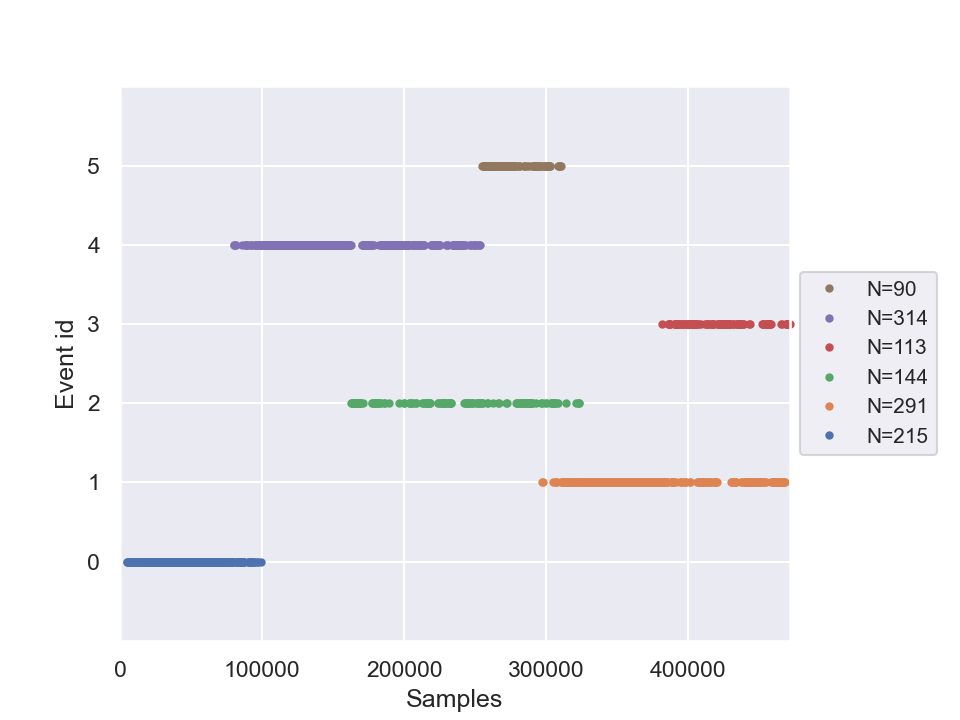

In [179]:
# Метод клатеризации Варда с учётом матрицы связности
K_NEIGHBORS = 25
N_CLUSTERS = 6
df_best_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

cl_method, df_best_metrics = apply_cluster_method(data=psd_rr_ft_sc_PCA_95, cl_method=AgglomerativeClustering, 
                                                      name='w_adj_rr_ft_sc_PCA_95'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = epochs_fix_1s_rr.events
cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


<IPython.core.display.Javascript object>


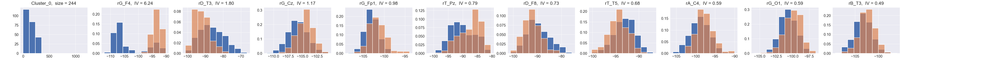

<IPython.core.display.Javascript object>


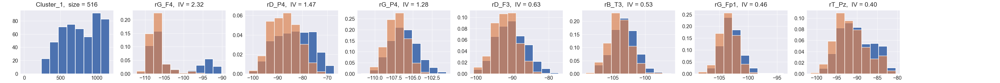

<IPython.core.display.Javascript object>


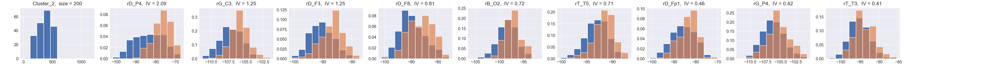

<IPython.core.display.Javascript object>


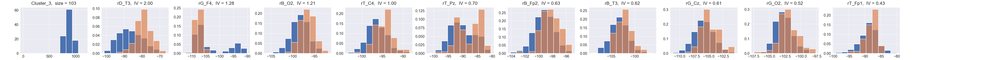

<IPython.core.display.Javascript object>


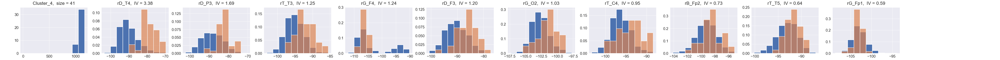

<IPython.core.display.Javascript object>


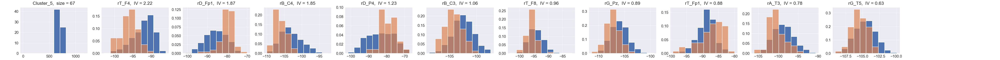

(<Figure size 3300x200 with 11 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 67'}>,
        <AxesSubplot:title={'center':'rT_F4,  IV = 2.22'}>,
        <AxesSubplot:title={'center':'rD_Fp1,  IV = 1.87'}>,
        <AxesSubplot:title={'center':'rB_C4,  IV = 1.85'}>,
        <AxesSubplot:title={'center':'rD_P4,  IV = 1.23'}>,
        <AxesSubplot:title={'center':'rB_C3,  IV = 1.06'}>,
        <AxesSubplot:title={'center':'rT_F8,  IV = 0.96'}>,
        <AxesSubplot:title={'center':'rG_Pz,  IV = 0.89'}>,
        <AxesSubplot:title={'center':'rT_Fp1,  IV = 0.88'}>,
        <AxesSubplot:title={'center':'rA_T3,  IV = 0.78'}>,
        <AxesSubplot:title={'center':'rG_T5,  IV = 0.63'}>], dtype=object))

In [85]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

df_features = df_psd_rr_sp2_alg
cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_rr_sp2_alg, cluster_labels, best_IV_list)    
        

In [91]:
# Формируем икусственные кластеры по результатам кластеризации adj30_ecg_sp_FA6_eucl_6
samples_in_cluster = []
for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    samples_in_cluster.append(cl_samples)
    print('Cluster '+str(i)+': ', samples_in_cluster[i][0], samples_in_cluster[i][-1])
#    print(samples_in_cluster[i])

Cluster 0:  300 1170
Cluster 1:  49 624
Cluster 2:  303 1160
Cluster 3:  0 393
Cluster 4:  655 1152
Cluster 5:  626 764


In [92]:
new_labels = np.zeros(len(cluster_labels)) 
for i in range(len(new_labels)):
    if i < samples_in_cluster[0][0]:
        new_labels[i] = 0
    if (samples_in_cluster[0][0] <= i <= samples_in_cluster[1][-1]):
        new_labels[i] = 1
    if (samples_in_cluster[1][-1] < i <= samples_in_cluster[5][-1]):
        new_labels[i] = 2
    if i > samples_in_cluster[5][-1]:
        new_labels[i] = 3
       

<IPython.core.display.Javascript object>


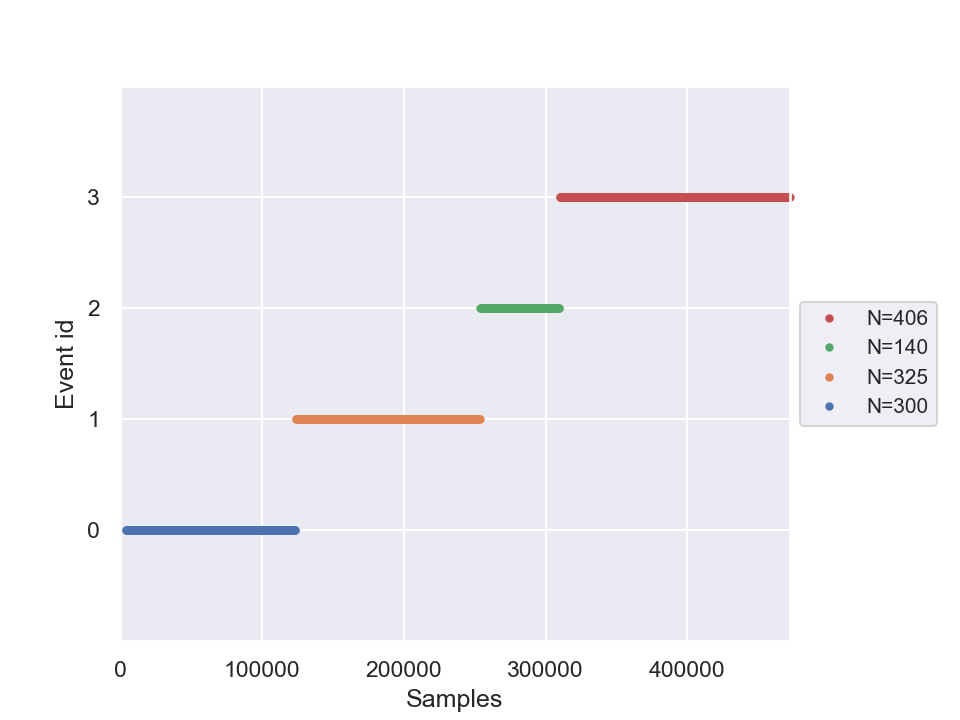

In [93]:
# Plotiing tied to time artificial clusters

#cluster_events = fix_1s_events_ovl
#cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = new_labels
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


In [94]:
# Находим гранииы кластеров
df_features = df_psd_fix_1s_ovl_ft
cluster_labels = new_labels
n_clusters = len(np.unique(cluster_labels))

ts_freq = 500

min_cl_sample = np.zeros(n_clusters)
max_cl_sample = np.zeros(n_clusters)
min_cl_time = np.zeros(n_clusters)
max_cl_time = np.zeros(n_clusters)

for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    min_cl_sample[i] = cl_samples[0]
    max_cl_sample[i] = cl_samples[-1]
    min_cl_time[i] = cluster_events[int(min_cl_sample[i]),0] // ts_freq
    max_cl_time[i] = cluster_events[int(max_cl_sample[i]),0] // ts_freq
    
print('min_cl_sample: ', min_cl_sample)
print('max_cl_sample: ', max_cl_sample)
print('min_cl_time: ', min_cl_time)
print('max_cl_time: ', max_cl_time)

min_cl_sample:  [  0. 300. 625. 765.]
max_cl_sample:  [ 299.  624.  764. 1170.]
min_cl_time:  [  8. 248. 508. 620.]
max_cl_time:  [247. 507. 619. 944.]


,Method,Silh,Cal-Har,Dav-Bold
0,w_adj_rr_sp_FA5_6,0.11,192.07,2.45


<IPython.core.display.Javascript object>


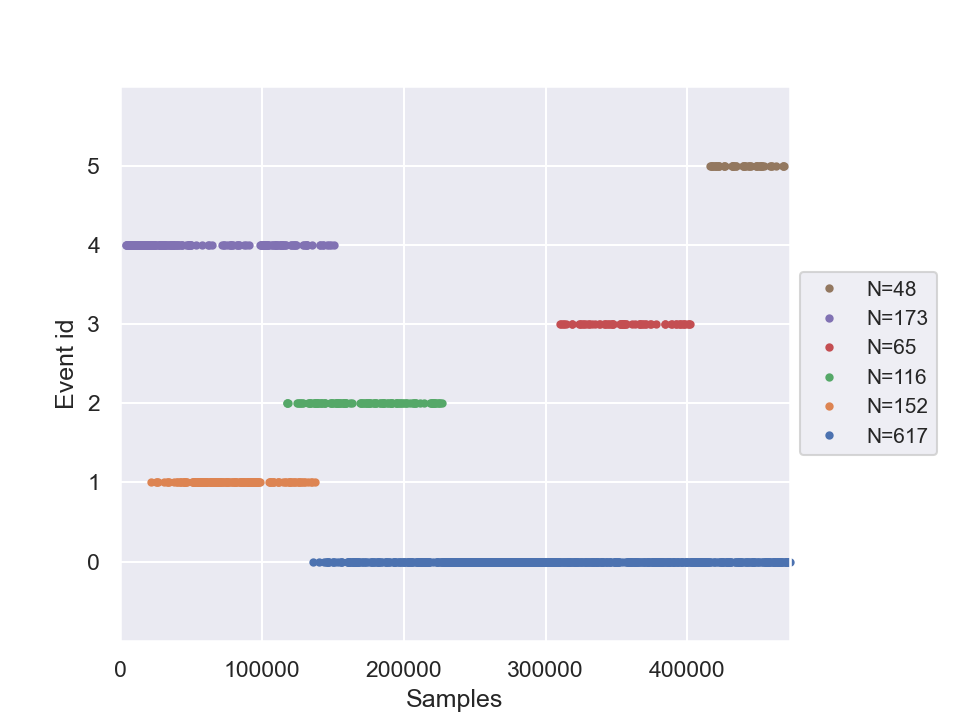

In [86]:
# Метод клатеризации Варда с учётом матрицы связности
K_NEIGHBORS = 20
N_CLUSTERS = 6
df_best_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

cl_method, df_best_metrics = apply_cluster_method(data=psd_fix_1s_rr_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='w_adj_rr_sp_FA5_'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = fix_1s_events_rr
#cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


<IPython.core.display.Javascript object>


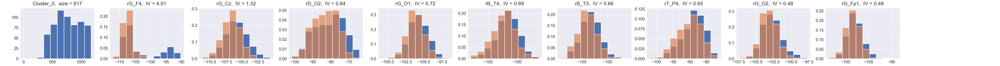

<IPython.core.display.Javascript object>


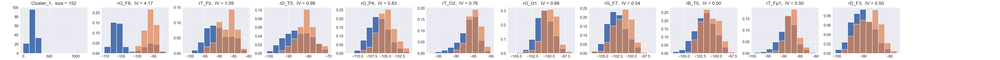

<IPython.core.display.Javascript object>


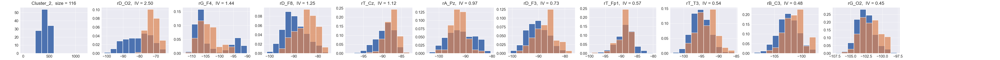

<IPython.core.display.Javascript object>


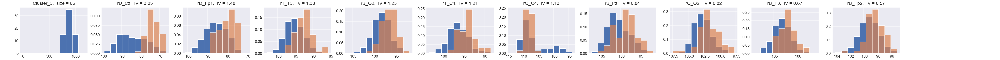

<IPython.core.display.Javascript object>


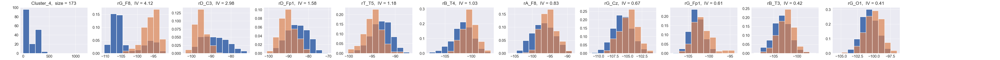

<IPython.core.display.Javascript object>


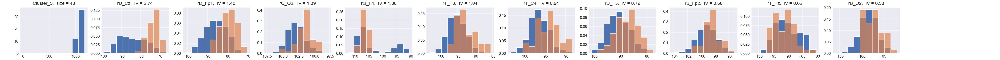

(<Figure size 3300x200 with 11 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 48'}>,
        <AxesSubplot:title={'center':'rD_Cz,  IV = 2.74'}>,
        <AxesSubplot:title={'center':'rD_Fp1,  IV = 1.40'}>,
        <AxesSubplot:title={'center':'rG_O2,  IV = 1.39'}>,
        <AxesSubplot:title={'center':'rG_F4,  IV = 1.38'}>,
        <AxesSubplot:title={'center':'rT_T3,  IV = 1.04'}>,
        <AxesSubplot:title={'center':'rT_C4,  IV = 0.94'}>,
        <AxesSubplot:title={'center':'rD_F3,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'rB_Fp2,  IV = 0.66'}>,
        <AxesSubplot:title={'center':'rT_Pz,  IV = 0.62'}>,
        <AxesSubplot:title={'center':'rB_O2,  IV = 0.58'}>], dtype=object))

In [87]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

df_features = df_psd_fix_1s_rr_ft
cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_fix_1s_rr_ft, cluster_labels, best_IV_list)    
        

,Method,Silh,Cal-Har,Dav-Bold
0,w_adj_rr_sp_FA5_6,0.11,192.07,2.45
1,adj30_fix_1s_ovl_sp_FA6_eucl_6,0.11,253.85,1.91


<IPython.core.display.Javascript object>


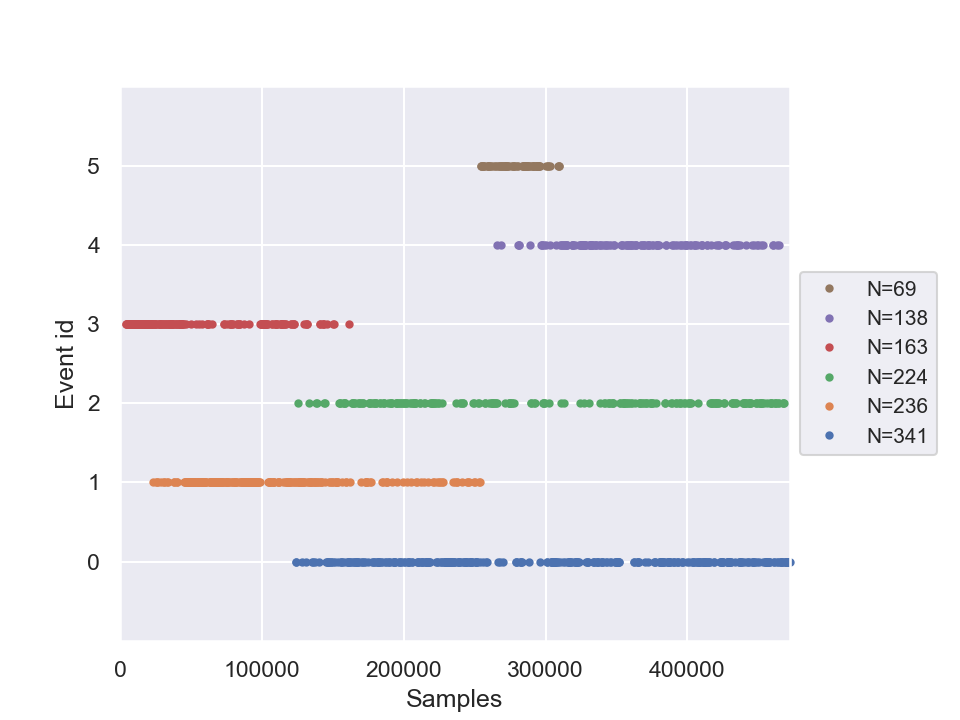

In [88]:
# Метод клатеризации Варда с учётом матрицы связности
K_NEIGHBORS = 30

cl_method, df_best_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = fix_1s_events_ovl
#cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


<IPython.core.display.Javascript object>


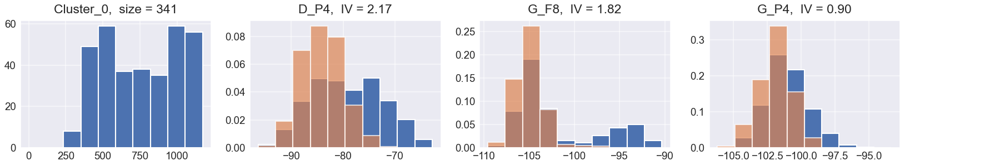

<IPython.core.display.Javascript object>


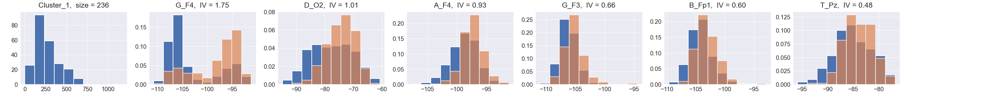

<IPython.core.display.Javascript object>


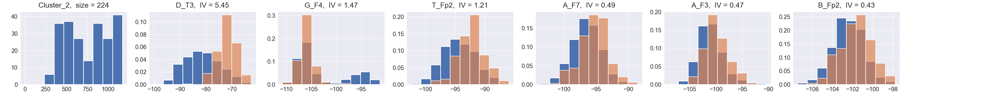

<IPython.core.display.Javascript object>


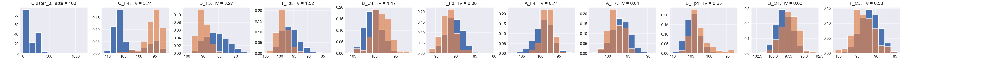

<IPython.core.display.Javascript object>


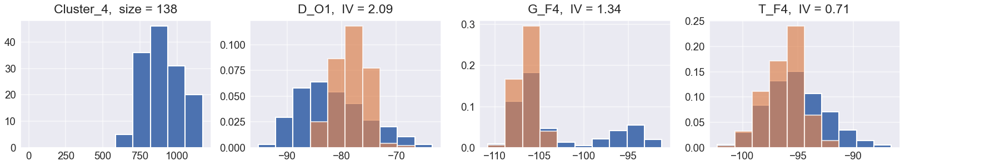

<IPython.core.display.Javascript object>


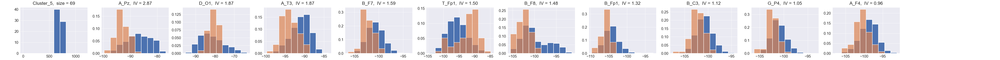

(<Figure size 3300x200 with 11 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 69'}>,
        <AxesSubplot:title={'center':'A_Pz,  IV = 2.87'}>,
        <AxesSubplot:title={'center':'D_O1,  IV = 1.87'}>,
        <AxesSubplot:title={'center':'A_T3,  IV = 1.87'}>,
        <AxesSubplot:title={'center':'B_F7,  IV = 1.59'}>,
        <AxesSubplot:title={'center':'T_Fp1,  IV = 1.50'}>,
        <AxesSubplot:title={'center':'B_F8,  IV = 1.48'}>,
        <AxesSubplot:title={'center':'B_Fp1,  IV = 1.32'}>,
        <AxesSubplot:title={'center':'B_C3,  IV = 1.12'}>,
        <AxesSubplot:title={'center':'G_P4,  IV = 1.05'}>,
        <AxesSubplot:title={'center':'A_F4,  IV = 0.96'}>], dtype=object))

In [89]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

df_features = df_psd_fix_1s_ovl_ft
cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_fix_1s_ovl_ft, cluster_labels, best_IV_list)    
        

In [90]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_bounds=[0.3, 0.4, 1])
    #display(best_corr_list[i])

,D_P4,G_F8,G_P4
D_P4,1.00,-0.13,0.28
G_F8,-0.13,1.00,0.48
G_P4,0.28,0.48,1.00


,G_F4,D_O2,A_F4,G_F3,B_Fp1,T_Pz
G_F4,1.00,-0.16,0.40,0.50,0.46,0.30
D_O2,-0.16,1.00,0.12,0.15,0.05,-0.01
A_F4,0.40,0.12,1.00,0.29,0.33,0.42
G_F3,0.50,0.15,0.29,1.00,0.44,0.12
B_Fp1,0.46,0.05,0.33,0.44,1.00,0.19
T_Pz,0.30,-0.01,0.42,0.12,0.19,1.00


,D_T3,G_F4,T_Fp2,A_F7,A_F3,B_Fp2
D_T3,1.00,-0.38,0.47,0.34,0.30,0.34
G_F4,-0.38,1.00,-0.18,-0.14,0.06,-0.15
T_Fp2,0.47,-0.18,1.00,0.32,0.33,0.35
A_F7,0.34,-0.14,0.32,1.00,0.39,0.27
A_F3,0.30,0.06,0.33,0.39,1.00,0.25
B_Fp2,0.34,-0.15,0.35,0.27,0.25,1.00


,G_F4,D_T3,T_Fz,B_C4,T_F8,A_F4,A_F7,B_Fp1,G_O1,T_C3
G_F4,1.00,-0.38,-0.21,0.47,-0.11,0.40,-0.14,0.46,0.46,-0.14
D_T3,-0.38,1.00,0.37,-0.13,0.40,-0.01,0.34,-0.08,-0.02,0.23
T_Fz,-0.21,0.37,1.00,-0.06,0.42,0.19,0.23,0.05,-0.07,0.38
B_C4,0.47,-0.13,-0.06,1.00,-0.02,0.36,0.02,0.43,0.32,0.15
T_F8,-0.11,0.40,0.42,-0.02,1.00,0.39,0.39,0.03,-0.01,0.34
A_F4,0.40,-0.01,0.19,0.36,0.39,1.00,0.21,0.33,0.24,0.25
A_F7,-0.14,0.34,0.23,0.02,0.39,0.21,1.00,0.08,0.04,0.23
B_Fp1,0.46,-0.08,0.05,0.43,0.03,0.33,0.08,1.00,0.30,0.03
G_O1,0.46,-0.02,-0.07,0.32,-0.01,0.24,0.04,0.30,1.00,-0.01
T_C3,-0.14,0.23,0.38,0.15,0.34,0.25,0.23,0.03,-0.01,1.00


,D_O1,G_F4,T_F4
D_O1,1.00,-0.40,0.30
G_F4,-0.40,1.00,-0.11
T_F4,0.30,-0.11,1.00


,A_Pz,D_O1,A_T3,B_F7,T_Fp1,B_F8,B_Fp1,B_C3,G_P4,A_F4
A_Pz,1.00,-0.14,0.45,0.22,-0.27,0.39,0.22,0.39,0.30,0.42
D_O1,-0.14,1.00,0.23,0.22,0.31,-0.22,-0.07,0.07,0.12,-0.03
A_T3,0.45,0.23,1.00,0.19,0.07,0.03,0.05,0.17,0.11,0.33
B_F7,0.22,0.22,0.19,1.00,0.11,0.30,0.47,0.37,0.37,0.28
T_Fp1,-0.27,0.31,0.07,0.11,1.00,-0.10,0.07,-0.05,-0.05,0.13
B_F8,0.39,-0.22,0.03,0.30,-0.10,1.00,0.48,0.30,0.49,0.46
B_Fp1,0.22,-0.07,0.05,0.47,0.07,0.48,1.00,0.31,0.36,0.33
B_C3,0.39,0.07,0.17,0.37,-0.05,0.30,0.31,1.00,0.33,0.27
G_P4,0.30,0.12,0.11,0.37,-0.05,0.49,0.36,0.33,1.00,0.26
A_F4,0.42,-0.03,0.33,0.28,0.13,0.46,0.33,0.27,0.26,1.00


In [91]:
# Формируем икусственные кластеры по результатам кластеризации adj30_ecg_sp_FA6_eucl_6

cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

samples_in_cluster = []
for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    samples_in_cluster.append(cl_samples)
    print('Cluster '+str(i)+': ', samples_in_cluster[i][0], samples_in_cluster[i][-1])
#    print(samples_in_cluster[i])

Cluster 0:  300 1170
Cluster 1:  49 624
Cluster 2:  303 1160
Cluster 3:  0 393
Cluster 4:  655 1152
Cluster 5:  626 764


In [92]:
new_labels = np.zeros(len(cluster_labels)) 
for i in range(len(new_labels)):
    if i < samples_in_cluster[0][0]:
        new_labels[i] = 0
    if (samples_in_cluster[0][0] <= i <= samples_in_cluster[1][-1]):
        new_labels[i] = 1
    if (samples_in_cluster[1][-1] < i <= samples_in_cluster[5][-1]):
        new_labels[i] = 2
    if i > samples_in_cluster[5][-1]:
        new_labels[i] = 3
       

<IPython.core.display.Javascript object>


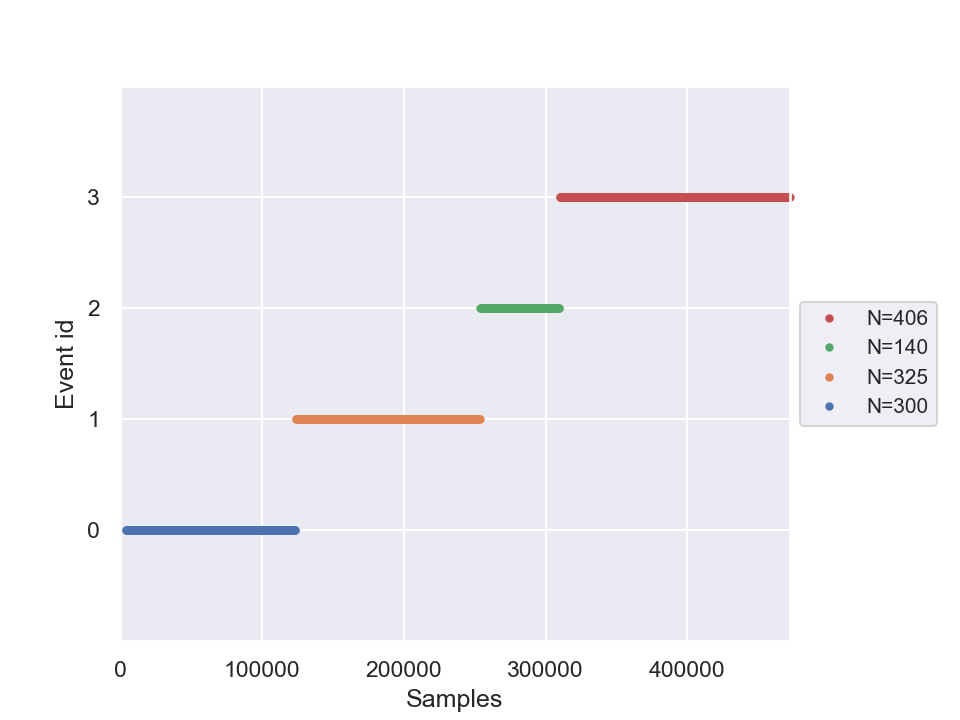

In [93]:
# Plotiing tied to time artificial clusters

#cluster_events = fix_1s_events_ovl
#cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = new_labels
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


In [94]:
# Находим гранииы кластеров
df_features = df_psd_fix_1s_ovl_ft
cluster_labels = new_labels
n_clusters = len(np.unique(cluster_labels))

ts_freq = 500

min_cl_sample = np.zeros(n_clusters)
max_cl_sample = np.zeros(n_clusters)
min_cl_time = np.zeros(n_clusters)
max_cl_time = np.zeros(n_clusters)

for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    min_cl_sample[i] = cl_samples[0]
    max_cl_sample[i] = cl_samples[-1]
    min_cl_time[i] = cluster_events[int(min_cl_sample[i]),0] // ts_freq
    max_cl_time[i] = cluster_events[int(max_cl_sample[i]),0] // ts_freq
    
print('min_cl_sample: ', min_cl_sample)
print('max_cl_sample: ', max_cl_sample)
print('min_cl_time: ', min_cl_time)
print('max_cl_time: ', max_cl_time)

min_cl_sample:  [  0. 300. 625. 765.]
max_cl_sample:  [ 299.  624.  764. 1170.]
min_cl_time:  [  8. 248. 508. 620.]
max_cl_time:  [247. 507. 619. 944.]


<IPython.core.display.Javascript object>


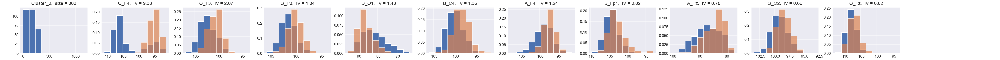

<IPython.core.display.Javascript object>


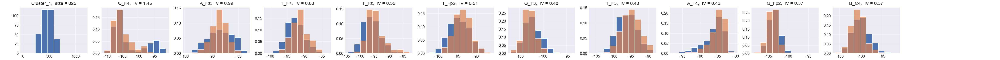

<IPython.core.display.Javascript object>


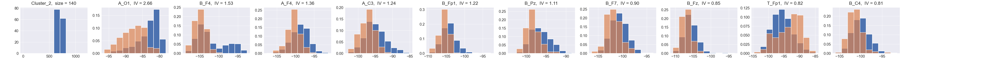

<IPython.core.display.Javascript object>


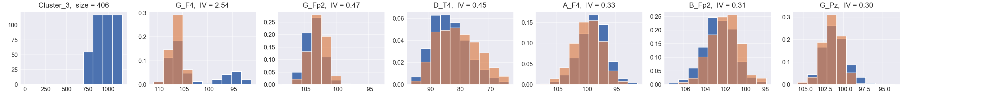

(<Figure size 2100x200 with 7 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_3,  size = 406'}>,
        <AxesSubplot:title={'center':'G_F4,  IV = 2.54'}>,
        <AxesSubplot:title={'center':'G_Fp2,  IV = 0.47'}>,
        <AxesSubplot:title={'center':'D_T4,  IV = 0.45'}>,
        <AxesSubplot:title={'center':'A_F4,  IV = 0.33'}>,
        <AxesSubplot:title={'center':'B_Fp2,  IV = 0.31'}>,
        <AxesSubplot:title={'center':'G_Pz,  IV = 0.30'}>], dtype=object))

In [95]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.6, IV_threshold=0.3)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_fix_1s_ovl_ft, cluster_labels, best_IV_list)    
        

In [96]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    print('Cluster '+str(i))
    display_corr_matrix(best_corr_list[i], corr_bounds=[0.3, 0.45, 1])
    #display(best_corr_list[i])

Cluster 0


,G_F4,G_T3,G_P3,D_O1,B_C4,A_F4,B_Fp1,A_Pz,G_O2,G_Fz
G_F4,1.00,0.58,0.57,-0.40,0.47,0.40,0.46,0.34,0.36,0.39
G_T3,0.58,1.00,0.59,0.07,0.40,0.29,0.41,0.19,0.56,0.39
G_P3,0.57,0.59,1.00,-0.13,0.41,0.23,0.34,0.29,0.59,0.51
D_O1,-0.40,0.07,-0.13,1.00,-0.09,-0.03,-0.07,-0.14,0.18,0.01
B_C4,0.47,0.40,0.41,-0.09,1.00,0.36,0.43,0.43,0.29,0.27
A_F4,0.40,0.29,0.23,-0.03,0.36,1.00,0.33,0.42,0.22,0.23
B_Fp1,0.46,0.41,0.34,-0.07,0.43,0.33,1.00,0.22,0.31,0.36
A_Pz,0.34,0.19,0.29,-0.14,0.43,0.42,0.22,1.00,0.20,0.14
G_O2,0.36,0.56,0.59,0.18,0.29,0.22,0.31,0.20,1.00,0.34
G_Fz,0.39,0.39,0.51,0.01,0.27,0.23,0.36,0.14,0.34,1.00


Cluster 1


,G_F4,A_Pz,T_F7,T_Fz,T_Fp2,G_T3,T_F3,A_T4,G_Fp2,B_C4
G_F4,1.00,0.34,-0.20,-0.21,-0.18,0.58,-0.12,0.13,-0.01,0.47
A_Pz,0.34,1.00,0.04,-0.20,-0.14,0.19,-0.02,0.59,0.01,0.43
T_F7,-0.20,0.04,1.00,0.36,0.50,0.03,0.58,0.31,0.07,-0.03
T_Fz,-0.21,-0.20,0.36,1.00,0.56,-0.07,0.54,0.04,0.07,-0.06
T_Fp2,-0.18,-0.14,0.50,0.56,1.00,0.00,0.56,0.14,0.14,-0.07
G_T3,0.58,0.19,0.03,-0.07,0.00,1.00,0.06,0.09,0.21,0.40
T_F3,-0.12,-0.02,0.58,0.54,0.56,0.06,1.00,0.09,0.08,0.02
A_T4,0.13,0.59,0.31,0.04,0.14,0.09,0.09,1.00,-0.01,0.21
G_Fp2,-0.01,0.01,0.07,0.07,0.14,0.21,0.08,-0.01,1.00,0.11
B_C4,0.47,0.43,-0.03,-0.06,-0.07,0.40,0.02,0.21,0.11,1.00


Cluster 2


,A_O1,B_F4,A_F4,A_C3,B_Fp1,B_Pz,B_F7,B_Fz,T_Fp1,B_C4
A_O1,1.00,0.22,0.44,0.52,0.19,0.51,0.20,0.17,-0.16,0.28
B_F4,0.22,1.00,0.51,0.09,0.51,0.27,0.26,0.23,-0.12,0.56
A_F4,0.44,0.51,1.00,0.31,0.33,0.32,0.28,0.28,0.13,0.36
A_C3,0.52,0.09,0.31,1.00,0.09,0.59,0.17,0.14,-0.08,0.31
B_Fp1,0.19,0.51,0.33,0.09,1.00,0.22,0.47,0.32,0.07,0.43
B_Pz,0.51,0.27,0.32,0.59,0.22,1.00,0.27,0.16,-0.14,0.59
B_F7,0.20,0.26,0.28,0.17,0.47,0.27,1.00,0.24,0.11,0.26
B_Fz,0.17,0.23,0.28,0.14,0.32,0.16,0.24,1.00,0.06,0.30
T_Fp1,-0.16,-0.12,0.13,-0.08,0.07,-0.14,0.11,0.06,1.00,-0.08
B_C4,0.28,0.56,0.36,0.31,0.43,0.59,0.26,0.30,-0.08,1.00


Cluster 3


,G_F4,G_Fp2,D_T4,A_F4,B_Fp2,G_Pz
G_F4,1.00,-0.01,-0.36,0.40,-0.15,0.55
G_Fp2,-0.01,1.00,0.20,0.00,0.41,0.21
D_T4,-0.36,0.20,1.00,-0.01,0.34,-0.16
A_F4,0.40,0.00,-0.01,1.00,0.10,0.21
B_Fp2,-0.15,0.41,0.34,0.10,1.00,0.02
G_Pz,0.55,0.21,-0.16,0.21,0.02,1.00


##  plot_psd_topomap

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


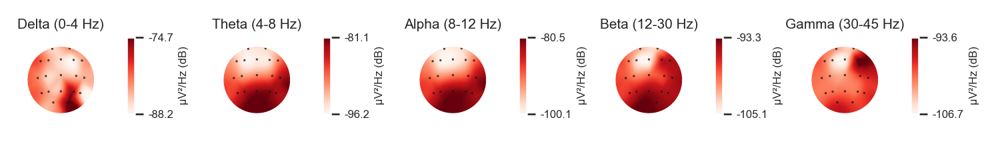

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


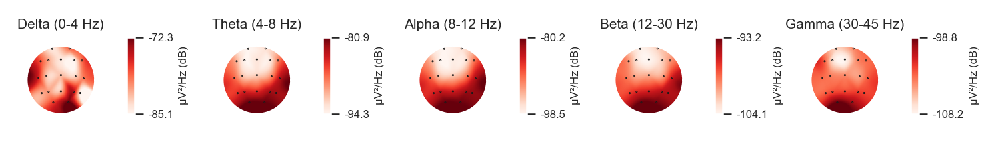

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


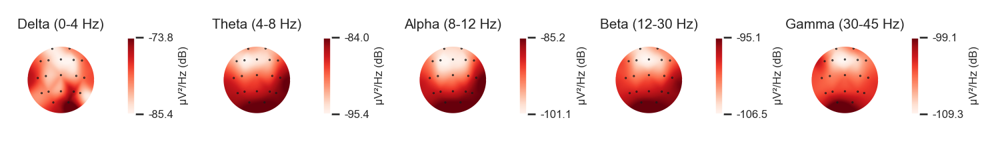

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


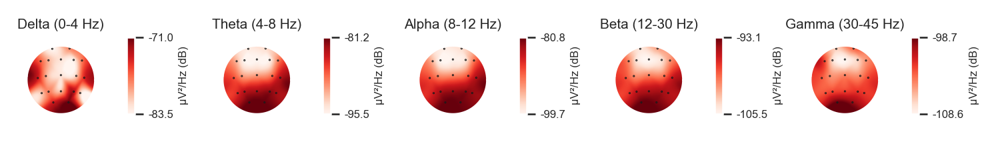

In [98]:
for i in range(n_clusters):
    epochs_cl = epochs_fix_1s_ovl[int(min_cl_sample[i]):int(max_cl_sample[i])+1]
    epochs_cl.plot_psd_topomap()

# Base State vs Change State

## Extract Base state distance features 

In [70]:
# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 199

df_psd_stg1_alg_orig = df_psd_ft_alg_best.loc[stage1_start:stage1_end]
#df_psd_stg1_alg_orig = df_psd_ft_sc_pca_best.loc[stage1_start:stage1_end]
#display(df_psd_stg1_alg_best)

space_stg1_alg_orig = df_psd_stg1_alg_orig.to_numpy().transpose(1,0)
print(space_stg1_alg_orig.shape)

(44, 200)


In [71]:
# Extreme percentiles (0.1%)
filt_df = df_psd_stg1_alg_orig
low = .001
high = .999
quant_df = filt_df.quantile([low, high])
#print(quant_df)
#print(filt_df.describe())

filt_df = filt_df.apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
filt_df.dropna(inplace=True)
#print(filt_df.describe())

df_psd_stg1_alg_filt = filt_df
space_stg1_alg_filt = df_psd_stg1_alg_filt.to_numpy().transpose(1,0)
print(space_stg1_alg_filt.shape)


(44, 140)


In [72]:
# Scaling data to N(0,1)
n_features = len(space_stg1_alg_orig[:,0])
n_vectors_orig = len(space_stg1_alg_orig[0,:])
n_vectors_filt = len(space_stg1_alg_filt[0,:])

space_stg1_alg_orig_sc = StandardScaler().fit_transform(space_stg1_alg_orig)
space_stg1_alg_filt_sc = StandardScaler().fit_transform(space_stg1_alg_filt)


In [73]:
# Flatten space data
# Original
space_stg1_alg_flat_sc = np.zeros(space_stg1_alg_orig_sc.shape)

for i in range(n_vectors_orig):   
    subspace = np.delete(space_stg1_alg_orig_sc, i, axis=1)
    reg = LinearRegression().fit(subspace, space_stg1_alg_orig_sc[:,i])
    space_stg1_alg_flat_sc[:,i] = reg.predict(subspace)

# Filtered
space_stg1_alg_filt_flat_sc = np.zeros(space_stg1_alg_filt_sc.shape)

for i in range(n_vectors_filt):   
    subspace = np.delete(space_stg1_alg_filt_sc, i, axis=1)
    reg = LinearRegression().fit(subspace, space_stg1_alg_filt_sc[:,i])
    space_stg1_alg_filt_flat_sc[:,i] = reg.predict(subspace)


In [74]:
# Calculating PCA attributes
pca = decomposition.PCA(n_components=None, svd_solver='full')

# Original PCA attributes
subsp_stg1_alg_orig_sc = pca.fit_transform(space_stg1_alg_orig_sc)
expl_var_ratio_orig = pca.explained_variance_ratio_
singular_values_orig = pca.singular_values_
good_fit_measure_orig = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_orig[i] = ((singular_values_orig[i]**2 / max((singular_values_orig[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_orig - i) / (n_features + n_vectors_orig - 2*i)))
# Filtered PCA attributes
subsp_stg1_alg_filt_sc = pca.fit_transform(space_stg1_alg_filt_sc)
expl_var_ratio_filt = pca.explained_variance_ratio_
singular_values_filt = pca.singular_values_
good_fit_measure_filt = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_filt[i] = ((singular_values_filt[i]**2 / max((singular_values_filt[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_filt - i) / (n_features + n_vectors_filt - 2*i)))
# Original flatten PCA attributes
subsp_stg1_alg_flat_sc = pca.fit_transform(space_stg1_alg_flat_sc)
expl_var_ratio_flat = pca.explained_variance_ratio_
singular_values_flat = pca.singular_values_
good_fit_measure_flat = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_flat[i] = ((singular_values_flat[i]**2 / max((singular_values_flat[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_orig - i) / (n_features + n_vectors_orig - 2*i)))
# Filtered flatten PCA attributes
subsp_stg1_alg_filt_flat_sc = pca.fit_transform(space_stg1_alg_filt_flat_sc)
expl_var_ratio_filt_flat = pca.explained_variance_ratio_
singular_values_filt_flat = pca.singular_values_
good_fit_measure_filt_flat = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_filt_flat[i] = ((singular_values_filt_flat[i]**2 / max((singular_values_filt_flat[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_filt - i) / (n_features + n_vectors_filt - 2*i)))

print([round(x,2) for x in good_fit_measure_orig])
print([round(x,2) for x in good_fit_measure_filt])

[221.59, 10.56, 6.22, 6.71, 4.75, 4.02, 3.54, 3.83, 4.16, 3.86, 3.03, 2.93, 2.72, 2.65, 2.69, 2.73, 2.39, 2.31, 2.13, 2.08, 2.05, 2.1, 1.96, 1.89, 1.78, 1.82, 1.82, 1.77, 1.73, 1.69, 1.77, 1.64, 1.66, 1.58, 1.52, 1.52, 1.58, 1.65, 1.61, 1.54, 1.68, 2.11, 1.58, 0.0]
[222.81, 10.14, 5.67, 5.65, 4.36, 3.77, 3.91, 3.63, 3.73, 3.5, 3.0, 2.75, 2.69, 2.74, 2.64, 2.42, 2.24, 2.12, 2.18, 2.12, 1.91, 1.86, 1.95, 1.95, 1.89, 1.83, 1.78, 1.9, 1.81, 1.75, 1.75, 1.55, 1.65, 1.75, 1.79, 1.53, 1.55, 1.71, 1.72, 1.51, 1.7, 1.88, 0.79, 0.0]


In [75]:
# Plotting PCA attributes

# Singular values
fig, ax = plt.subplots() 
ax.plot(singular_values_orig, label='original')
ax.plot(singular_values_filt, label='filtered')
#ax.plot(singular_values_flat, label='flatten')
#ax.plot(singular_values_filt_flat, label='filt_flat')
ax.set_title("Singular values") 
ax.legend()

# Goodness of fit measure
fig, ax = plt.subplots() 
ax.plot(good_fit_measure_orig[:10], label='original')
ax.plot(good_fit_measure_filt[:10], label='filtered')
#ax.plot(good_fit_measure_flat, label='flatten')
#ax.plot(good_fit_measure_filt_flat, label='filt_flat')
ax.set_title("Goodness of fit measure") 
ax.legend()

# Explained variance ratio
fig, ax = plt.subplots() 
ax.plot(expl_var_ratio_orig, label='original')
ax.plot(expl_var_ratio_filt, label='filtered')
#ax.plot(expl_var_ratio_flat, label='flatten')
#ax.plot(expl_var_ratio_filt_flat, label='filt_flat')
ax.set_title("Explained variance ratio") 
ax.legend()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Change State vectors

## Algorithm best decision

In [76]:
base_state_sc = subsp_stg1_alg_filt_sc[:,:2]
#base_state_sc = subsp_stg1_alg_orig_sc[:,:2]
print(base_state_sc.shape)

space_alg_best = df_psd_ft_alg_best.to_numpy().transpose(1,0)

space_alg_best_sc = StandardScaler().fit_transform(space_alg_best)
print(space_alg_best_sc.shape)

(44, 2)
(44, 1171)


In [77]:
n_vectors = len(space_alg_best_sc[0,:])
change_state_sc = np.zeros(space_alg_best_sc.shape)
dist_to_base_state = np.zeros(n_vectors)

for i in range(n_vectors):
    y_true = space_alg_best_sc[:,i]
    reg = LinearRegression().fit(base_state_sc, y_true)
    y_pred = reg.predict(base_state_sc)
    change_state_sc[:,i] = y_true - y_pred
    dist_to_base_state[i] = metrics.mean_squared_error(y_true, y_pred, squared = False)
print(dist_to_base_state)

[0.48036358 0.55823333 0.4752683  ... 0.46025699 0.5245043  0.49127723]


In [78]:
fig, ax = plt.subplots() 
ax.plot(dist_to_base_state, label='distance')
ax.set_title("Distance to base state") 
ax.legend()

<IPython.core.display.Javascript object>

## PCA best decision

In [79]:
base_state_sc = subsp_stg1_alg_filt_sc[:,:3]
#base_state_sc = subsp_stg1_alg_orig_sc[:,:3]
print(base_state_sc.shape)

space_alg_best = df_psd_ft_sc_pca_best.to_numpy().transpose(1,0)

space_alg_best_sc = StandardScaler().fit_transform(space_alg_best)
print(space_alg_best_sc.shape)

(44, 3)
(41, 1171)


In [80]:
n_vectors = len(space_alg_best_sc[0,:])
change_state_sc = np.zeros(space_alg_best_sc.shape)
dist_to_base_state = np.zeros(n_vectors)

for i in range(n_vectors):
    y_true = space_alg_best_sc[:,i]
    reg = LinearRegression().fit(base_state_sc, y_true)
    y_pred = reg.predict(base_state_sc)
    change_state_sc[:,i] = y_true - y_pred
    dist_to_base_state[i] = metrics.mean_squared_error(y_true, y_pred, squared = False)
print(dist_to_base_state)

ValueError: Found input variables with inconsistent numbers of samples: [44, 41]

In [ ]:
fig, ax = plt.subplots() 
ax.plot(dist_to_base_state, label='distance')
ax.set_title("Distance to base state") 
ax.legend()

# TDA features

## Persistent Homology

In [351]:
# Filtering raw_data
tda_bands = [(0.9, 4, 'Delta (0.9-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'), (8, 14, 'Alpha (8-14 Hz)'), (14, 20, 'Beta1 (14-20 Hz)'), 
             (20, 25, 'Beta2 (20-25 Hz)'), (25, 30, 'Gamma1 (25-30 Hz)'), (30, 35, 'Gamma2 (30-35 Hz)'), (35, 40, 'Gamma3 (35-40 Hz)')]

# Re-referenced data
#data_rr_filt = reref_data.copy().filter(l_freq=tda_bands[0][0], h_freq=tda_bands[4][1])
data_rr_filt_tda_sp = []
for i in range(len(tda_bands)):
    data_rr_filt_tda_sp.append(reref_data.copy().filter(l_freq=tda_bands[i][0], h_freq=tda_bands[i][1]))
    

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1835 samples (3.670 sec)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8

In [362]:
# Epoching data by tda spectrum

ts_ft_rr_tda = epochs_fix_1s_rr.get_data()
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_rr_tda_sp = []
ts_ft_rr_tda_sp = []
pcl_ft_rr_tda_sp = []

for i in range(len(tda_bands)):   
    epochs_fix_rr_tda_sp.append(mne.Epochs(data_rr_filt_tda_sp[i], fix_1s_events_rr.astype(int), **kwargs))
    epochs_fix_rr_tda_sp[i] = epochs_fix_rr_tda_sp[i][2:-2]
    ts_ft_rr_tda_sp.append(epochs_fix_rr_tda_sp[i].get_data())

#epochs_fix_rr_tda_sp[0].get_data().shape

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 e

In [360]:
# Point cloud in full range
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda = attractor.fit_transform(ts_ft_rr_tda)
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda[:,i,:], sample=100)


Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [361]:
# Point cloud in full range
# Part 2

for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda[:,i,:], sample=100)


Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [363]:
# Point clouds in Delta range (0-4 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 15
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[0]))
print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[0][:,i,:], sample=100)

Point clouds in Delta range (0-4 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [364]:
# Point clouds in Delta range (0-4 Hz)
# Part 2

print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[0][:,i,:], sample=100)

Point clouds in Delta range (0-4 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [365]:
# Point clouds in Theta range (4-8 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[1]))
print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[1][:,i,:], sample=100)

Point clouds in Theta range (4-8 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [366]:
# Point clouds in Theta range (4-8 Hz)
# Part 2

print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[1][:,i,:], sample=100)

Point clouds in Theta range (4-8 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [367]:
# Point clouds in Alpha range (8-14 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[2]))
print("Point clouds in Alpha range (8-14 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[2][:,i,:], sample=100)

Point clouds in Alpha range (8-14 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [368]:
# Point clouds in Alpha range (8-12 Hz)
# Part 2

print("Point clouds in Alpha range (8-12 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[2][:,i,:], sample=100)

Point clouds in Alpha range (8-12 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [369]:
# Point clouds in Beta 1 range (14-20 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 8
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[3]))
print("Point clouds in Beta 1 range (14-20 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[3][:,i,:], sample=100)

Point clouds in Beta 1 range (14-20 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [370]:
# Point clouds in Beta 1 range (14-20 Hz)
# Part 2

print("Point clouds in Beta 1 range (14-20 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[3][:,i,:], sample=100)

Point clouds in Beta 1 range (14-20 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [373]:
# Point clouds in Beta 2 range (20-25 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 6
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[4]))
print("Point clouds in Beta 2 range (20-25 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[4][:,i,:], sample=100)

Point clouds in Beta 2 range (20-25 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [372]:
# Point clouds in Beta 2 range (20-25 Hz)
# Part 2

print("Point clouds in Beta 2 range (20-25 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[4][:,i,:], sample=100)

Point clouds in Beta 2 range (20-25 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [82]:
# Point clouds in Gamma 1 range (25-30 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 4
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[5]))
print("Point clouds in Gamma 1 range (25-30 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[5][:,i,:], sample=100)

Point clouds in Gamma 1 range (25-30 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [374]:
# Point clouds in Gamma 1 range (25-30 Hz)
# Part 2

print("Point clouds in Gamma 1 range (25-30 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[5][:,i,:], sample=100)

Point clouds in Gamma 1 range (25-30 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [375]:
# Point clouds in Gamma 2 range (30-35 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[6]))
print("Point clouds in Gamma 2 range (30-35 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[6][:,i,:], sample=100)

Point clouds in Gamma 2 range (30-35 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [200]:
# Point clouds in Gamma 2 range (30-35 Hz)
# Part 2

print("Point clouds in Gamma 2 range (30-35 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[6][:,i,:], sample=100)

Point clouds in Gamma 2 range (30-35 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [376]:
# Point clouds in Gamma 3 range (35-40 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 2 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False, 
    stride=stride,
)

pcl_ft_rr_tda_sp.append(attractor.fit_transform(ts_ft_rr_tda_sp[7]))
print("Point clouds in Gamma 3 range (35-40 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[7][:,i,:], sample=100)

Point clouds in Gamma 3 range (35-40 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [377]:
# Point clouds in Gamma 3 range (35-40 Hz)
# Part 2

print("Point clouds in Gamma 3 range (35-40 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", ch_names[i])
    attractor.fit_transform_plot(ts_ft_rr_tda_sp[7][:,i,:], sample=100)

Point clouds in Gamma 3 range (35-40 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [70]:
homology_dimensions = [1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, 
    n_jobs=-1,
)

In [379]:
#if not os.path.exists('work_data/pd_fix_1s_ovl_list'):
#    os.mkdir('work_data/pd_fix_1s_ovl_list')
    
pd_ft_rr_tda_raw = []
for i in range(n_channels): 
  pd_ft_rr_tda_raw.append(np.load('work_data/pd_fix_1s_ovl_list/pd_fix_1s_ovl_'+str(i)+'.npy'))
  print(pd_ft_rr_tda_raw[i].shape)
print(len(pd_ft_rr_tda_raw))

(1171, 142, 3)
(1171, 142, 3)
(1171, 148, 3)
(1171, 142, 3)
(1171, 139, 3)
(1171, 158, 3)
(1171, 149, 3)
(1171, 143, 3)
(1171, 141, 3)
(1171, 144, 3)
(1171, 143, 3)
(1171, 145, 3)
(1171, 138, 3)
(1171, 132, 3)
(1171, 131, 3)
(1171, 132, 3)
(1171, 148, 3)
(1171, 137, 3)
(1171, 132, 3)
19


In [384]:
ampl_landscape = []
for i in range(n_channels): 
    ampl_landscape.append(Amplitude(metric='landscape').fit_transform(pd_ft_rr_tda_raw[i]))
#    print(ampl_landscape[i].shape)
plot(ampl_landscape[0][:,0])

NameError: name 'plot' is not defined

In [80]:
pcl_epochs_fix_1s_ovl_smpl = pcl_epochs_fix_1s_ovl_gamma3[100,0,:,:]
pcl_epochs_fix_1s_ovl_smpl = pcl_epochs_fix_1s_ovl_smpl[None, :, :]
print(pcl_epochs_fix_1s_ovl_smpl.shape)

pd_fix_1s_ovl_full = persistence.fit_transform(pcl_epochs_fix_1s_ovl_smpl)

print("Persistence diagram for signal")
persistence.plot(pd_fix_1s_ovl_full)

(1, 248, 3)
Persistence diagram for signal


In [ ]:
print(m10_all_ch_per_diag[0].shape)
print(m10_all_ch_per_diag[1].shape)
print(m10_all_ch_per_diag[2].shape)

#m10_all_ch_per_diag = np.array(m10_all_ch_per_diag)

print("Persistence diagram for periodic signal")
persistence.fit_transform_plot(m10_all_ch_point_cl[10])

In [ ]:
for i in range(n_channels): 
    m10_all_ch_point_cl.append(attractor.fit_transform(ts_epochs_ecg[i]))
m10_all_ch_point_cl = np.array(m10_all_ch_point_cl)

print(m10_all_ch_point_cl.shape)
for i in range(n_channels):
attractor.fit_transform_plot(m10_all_ch_ts[10])

In [308]:
ts_epochs_ecg[:,0:1].shape

(1231, 1, 451)

In [ ]:
m10_sample_ts = epochs.get_data(picks=0, item=0).reshape(epochs.get_data().shape[2])
time_delay, dimension = takens_embedding_optimal_parameters(m10_sample_ts,10, 10)
print('time_delay = ', time_delay)
print('dimension = ', dimension)

In [ ]:
embedding_dimension = 3
embedding_time_delay = 8
stride = 3

embedder_sample = SingleTakensEmbedding(
    parameters_type="fixed",
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    stride=stride,
)

In [ ]:
m10_sample_point_cl = embedder_sample.fit_transform(m10_sample_ts)
print(f"Shape of embedded time series: {m10_sample_point_cl.shape}")
plot_point_cloud(m10_sample_point_cl)

In [ ]:
# Change array type for next step
print(m10_sample_point_cl.shape)
m10_sample_point_cl = m10_sample_point_cl[None, :, :]
print(m10_sample_point_cl.shape)


In [ ]:
# Build persistent diagram
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, n_jobs=6
)

m10_sample_per_diag = persistence.fit_transform(m10_sample_point_cl)

print("Persistence diagram for signal")
persistence.fit_transform_plot(m10_sample_point_cl)

In [ ]:
# Getting Betti Sequence
betti_sequence = BettiCurve()

m10_sample_betti_seq = betti_sequence.fit_transform(m10_sample_per_diag)
betti_sequence.fit_transform_plot(m10_sample_per_diag)


## The Mapper

In [62]:
# TDA magic
from gtda.mapper import (
    CubicalCover,
    OneDimensionalCover,
    make_mapper_pipeline,
    Projection,
    plot_static_mapper_graph,
    plot_interactive_mapper_graph,
    MapperInteractivePlotter
)

# ML tools
#from sklearn import datasets
#from sklearn.decomposition import PCA

In [63]:
from gtda.mapper.filter import Eccentricity, Entropy, Projection
from gtda.mapper.cover import CubicalCover

# scikit-learn method
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.cluster import DBSCAN
# giotto-tda method
from gtda.mapper.cluster import FirstSimpleGap

In [ ]:
random(0,1)

In [291]:
# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 200
psd_stage1_FA = psd_spectr_FA_ward[stage1_start:stage1_end,:]
print(psd_stage1_FA.shape)

df_psd_stage1_FA = pd.DataFrame(psd_stage1_FA)

# Extreme percintiles
filt_df = df_psd_stage1_FA
low = .001
high = .999
quant_df = filt_df.quantile([low, high])
#print(quant_df)
#print(filt_df.describe())

filt_df = filt_df.apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
filt_df.dropna(inplace=True)
#print(filt_df.describe())
df_psd_stage1_FA = filt_df
psd_stage1_FA = df_psd_stage1_FA.to_numpy()
print(psd_stage1_FA.shape)




(300, 30)
               0           1           2           3           4           5   \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -88.811978  -87.101361  -87.451282  -81.699731  -90.857029  -87.381034   
std      5.046802    3.843172    3.831441    6.782903    4.545158    5.786116   
min    -99.355885  -95.062399  -95.273706  -95.334921 -102.154442  -98.282974   
25%    -92.299793  -90.013119  -90.311207  -87.107271  -94.416076  -91.979662   
50%    -88.944551  -87.750365  -87.820703  -82.689916  -91.064747  -88.002790   
75%    -85.452116  -84.539105  -85.011787  -76.086330  -88.117178  -82.909703   
max    -75.584338  -76.369810  -75.030732  -65.319549  -78.410912  -73.616225   

               6           7           8           9           10          11  \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -94.486107  -84.223846  -91.797508  -81.357876  -90.033669  -89.237246   
std      3.262762

In [71]:
import random as rd
from sklearn.linear_model import LinearRegression

X = np.array([[1, 1], [1, 2], [2, 2], [2, 3]])
# y = 1 * x_0 + 2 * x_1 + 3
y = np.dot(X, np.array([1, 2])) + 3
for i in range(len(y)):
    z[i] = y[i] + rd.random()*0.2 - 0.1
print(z)
reg = LinearRegression().fit(X, z)
print(reg.score(X, z))
print(reg.coef_)
print(reg.intercept_)
reg.predict(np.array([[1, 1]]))

[ 6.01803258  8.08215988  9.09491566 10.95615712]
0.9991907095356735
[1.01275578 1.96268437]
3.093313885904446


array([6.06875404])

In [58]:
stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='correlation')
#stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='euclidean')
#print(psd_spectr_FA_ward[psd_spectr_FA_ward stage1_dist.shape])
print(stage1_dist)
Xt = np.amin(stage1_dist, axis = 1)

print(len(Xt))
print(Xt.shape)

t = np.zeros(len(Xt))
for i in range(len(Xt)):
    t[i] = i
Xt = np.column_stack((Xt, t))
    
print(Xt.shape)       
#sns.displot(df_Xt, x=df_Xt.index, col='Zero', kde=True)

#print(psd_stage1_FA)
#print(psd_spectr_FA_ward)

NameError: name 'pairwise_distances' is not defined

In [376]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
       
        return Xt


In [385]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
 
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))

        return Xt_t


In [377]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centrality(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
       
        return Xt


In [384]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centr_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
        
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))
       
        return Xt_t


In [387]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
# filter_func = decomposition.PCA(n_components=1)

# filter_func = L_inf_centrality()
# filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
filter_func = stage1_min_dist_time()

# Define cover
cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
# cover = OneDimensionalCover(n_intervals=8, overlap_frac=0.3)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=3, connectivity=knn_con_matr)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 1.90000e+01]
 [4.71229e+05 0.00000e+00 1.90000e+01]
 [4.71594e+05 0.00000e+00 1.90000e+01]]
1231
25


<ipython-input-388-f5cf836bee5c>:17: RuntimeWarning:

More events than default colors available. You should pass a list of unique colors.



<IPython.core.display.Javascript object>


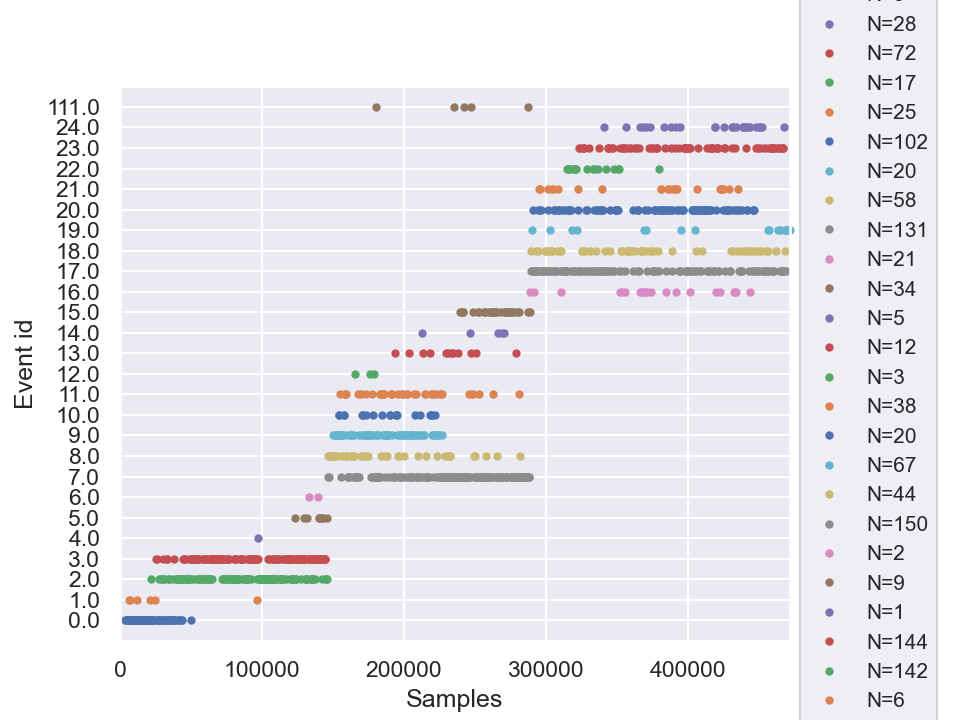

In [388]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(cluster_events)
print(len(cluster_events))
print(len(graph.vs))

fig = mne.viz.plot_events(cluster_events)            

In [547]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
filter_func = decomposition.PCA(n_components=1)

filter_func = L_inf_centrality()
filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 6.00000e+00]
 [4.71594e+05 0.00000e+00 6.00000e+00]]
1231
10


<IPython.core.display.Javascript object>


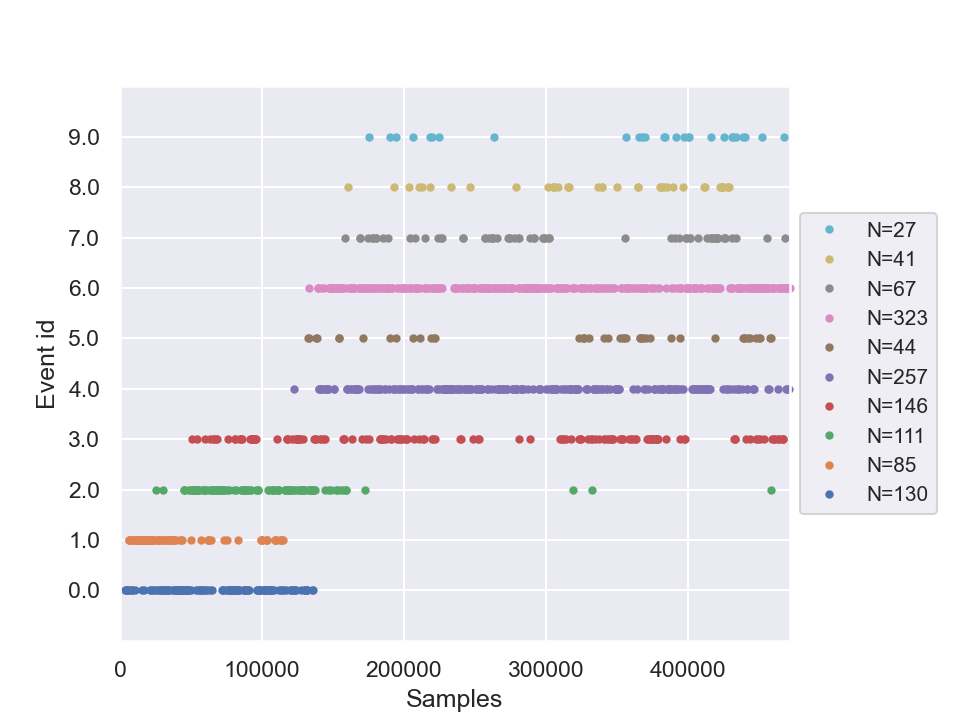

In [548]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            
m_PCA_corr_kmeans_labels = cluster_events[:,2]


fig = mne.viz.plot_events(cluster_events)            

In [549]:
print(len(ecctr_corr_ward_knn_labels))
print(ecctr_corr_ward_knn_labels)

1231
[0. 0. 0. ... 4. 6. 6.]


# Testing different mappers

In [599]:
# Define filter function

#filter_func = Eccentricity(metric='euclidean')
#filter_func = Eccentricity(metric='correlation')
#filter_func = Entropy()
#filter_func = decomposition.PCA(n_components=1)

#filter_func = L_inf_centrality(metric='euclidean')
#filter_func = L_inf_centrality(metric='correlation')

#filter_func = stage1_min_dist(metric='euclidean')
filter_func = stage1_min_dist(metric='correlation')

# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

10


<IPython.core.display.Javascript object>


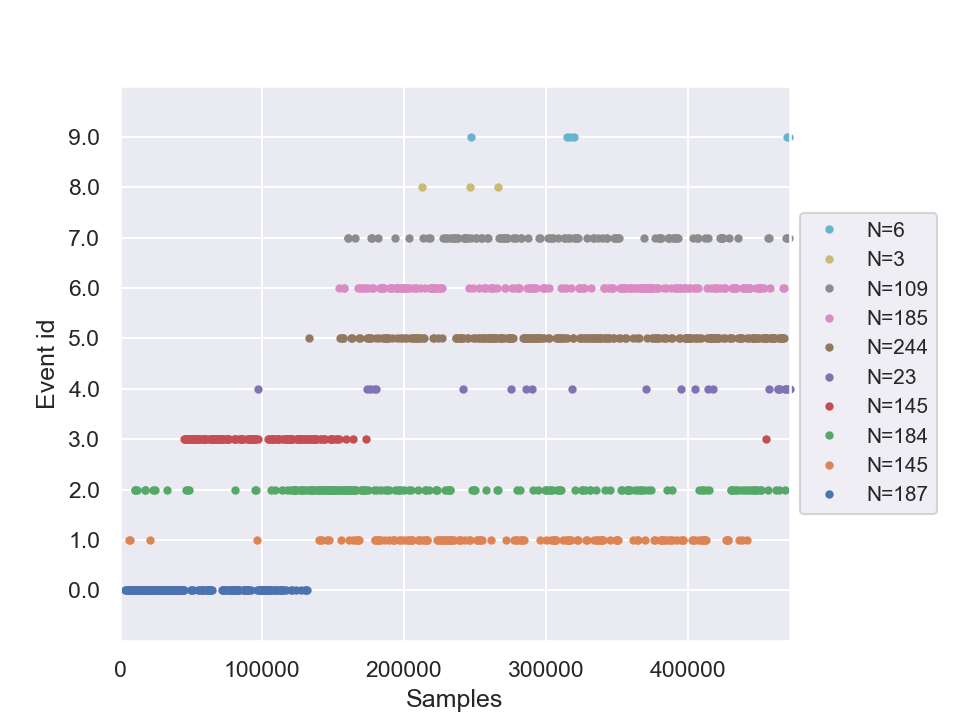

In [600]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            

#m_ecc_eucl_kmeans_labels = cluster_events[:,2]
#m_ecc_corr_kmeans_labels = cluster_events[:,2]
#m_ecc_eucl_ward_knn_labels = cluster_events[:,2]
#m_ecc_corr_ward_knn_labels = cluster_events[:,2]

#m_entropy_kmeans_labels = cluster_events[:,2]
#m_entropy_ward_labels = cluster_events[:,2]
#m_entropy_ward_knn_labels = cluster_events[:,2]

#m_PCA_1_kmeans_labels = cluster_events[:,2]
#m_PCA_1_ward_knn_labels = cluster_events[:,2]

#m_linf_eucl_kmeans_labels = cluster_events[:,2]
#m_linf_corr_kmeans_labels = cluster_events[:,2]
#m_linf_eucl_ward_knn_labels = cluster_events[:,2]
#m_linf_corr_ward_knn_labels = cluster_events[:,2]

#m_st1_dist_eucl_kmeans_labels = cluster_events[:,2]
#m_st1_dist_corr_kmeans_labels = cluster_events[:,2]
#m_st1_dist_eucl_ward_knn_labels = cluster_events[:,2]
m_st1_dist_corr_ward_knn_labels = cluster_events[:,2]

fig = mne.viz.plot_events(cluster_events)            

In [ ]:
# Calculate cluster centers and their distance matrix




In [535]:
# Функция для расчёта оценок качетва кластеризации
from sklearn import metrics

def bench_cl_metrics_noground(name, data, labels_pred):
#    t0 = time()
#    estimator = cluster_method.fit(data)
#    fit_time = time() - t0
    results = [name]

    # Define the metrics which require only data and predicted labels
    cluster_metrics_without_ground = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics_without_ground]

    # Show the results
    formatter_result = (
        "{:9s}\t{:.3f}\t{:.3f}\t\t{:.3f}"
    )
    print(formatter_result.format(*results))

In [601]:
# Сравнение методов кластеризации на основе оценок качества

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

cluster_method = KMeans(n_clusters=6, random_state=0)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="kmeans_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

for linkage in ("ward", "average"):#, "complete", "single"):
    cluster_method = AgglomerativeClustering(linkage=linkage, n_clusters=6)
    fit_method = cluster_method.fit(psd_spectr_FA_ward)
    bench_cl_metrics_noground(name=linkage+"_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="ward_adj_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

# Mapper results
bench_cl_metrics_noground(name="m_ecc_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_ecc_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_entropy_kmeans", data=psd_spectr_FA_ward, labels_pred=m_entropy_kmeans_labels)
bench_cl_metrics_noground(name="m_entropy_ward", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_labels)
bench_cl_metrics_noground(name="m_entropy_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_knn_labels)

bench_cl_metrics_noground(name="m_PCA_1_kmeans", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_kmeans_labels)
bench_cl_metrics_noground(name="m_PCA_1_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_ward_knn_labels)

bench_cl_metrics_noground(name="m_linf_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_linf_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_st1_dist_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_ward_knn_labels)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_FA_ward	0.208	405.352		1.476
ward_FA_ward	0.172	335.804		1.461
average_FA_ward	0.165	217.656		1.185
ward_adj_FA_ward	0.115	243.752		2.549
m_ecc_eucl_kmeans	0.050	145.221		2.839
m_ecc_corr_kmeans	0.096	116.481		2.572
m_ecc_eucl_ward_knn	0.011	95.898		4.343
m_ecc_corr_ward_knn	-0.016	49.940		2.905
m_entropy_kmeans	0.095	206.360		1.823
m_entropy_ward	0.088	198.893		1.770
m_entropy_ward_knn	0.081	186.860		1.890
m_PCA_1_kmeans	0.120	242.065		1.816
m_PCA_1_ward_knn	0.117	236.747		1.759
m_linf_eucl_kmeans	0.050	162.660		2.835
m_linf_corr_kmeans	0.001	122.914		3.774
m_linf_eucl_ward_knn	0.028	137.765		2.911
m_linf_corr_ward_knn	-0.015	101.670		3.460
m_st1_dist_eucl_kmeans	0.059	170.591		2.952
m_st1_dist_corr_kmeans	0.044	148.635		3.003
m_st1_dist_eucl_ward_knn	0.036	147.915		3.054
m_st1_dist_corr_ward_knn	0.039	129.092		3.630
_______________

In [541]:
fit_method.labels_

array([3, 3, 3, ..., 2, 2, 2], dtype=int64)

# Testing

In [113]:
nparr = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
nparreven = nparr[np.where(nparr % 2 == 0)]
nparreven

npbool = nparr < 5
(nparr == 5).astype(int)

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0])

In [292]:
print(epochs_ecg.get_data().shape)

(1231, 19, 451)


In [ ]:
psd_ecg_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_ecg_ft)
print(psd_ecg_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_ecg_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_ecg_ft_PCA = pd.DataFrame(psd_ecg_ft_PCA, columns=comp_names)
display(df_psd_ecg_ft_PCA)

#display_corr_matrix(df_psd_ecg_ft_PCA.corr(),  [0.6, 0.8, 1])